## COP and COG estimation by derivative method
Trying to estimate COP and COG were used linear function wich didn't give the results expected, therefore we tried to make different approaches and one of them is the next function:
COP= COG-(4/g*3*d²derivadasegundaTeta)

## Python libraries

First, let's import the necessary Python libraries and configure the environment:

In [1]:
import numpy as np
#from scipy.signal import butter, filtfilt
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline
#import seaborn as sns
#sns.set_context("notebook", font_scale=1.3,
#                rc={'lines.linewidth': 1.5, 'lines.markersize': 14, 'axes.titlesize': 'x-large'})
#matplotlib.rc('legend', numpoints=1, fontsize=14)
#import glob
import sys, os
sys.path.insert(1, r'./Functions')
# IPython widgets:
from IPython.display import display
import ipywidgets
from ipywidgets import FloatProgress, interactive

Versions of the Python libraries used:

In [2]:
#!pip install version_information
%load_ext version_information
%version_information numpy, scipy, pandas, matplotlib, seaborn

ModuleNotFoundError: No module named 'version_information'

## Meta data

The file `PDSinfo.txt` contains meta data about the subjects and the experimental trials. The file has a header plus 588 rows per 29 columns (there are 12 rows for each of the 49 subjects).   
Let's use the power of the [pandas](http://pandas.pydata.org/) library to load and explore the meta data:

In [3]:
# GitHub URL:
#path2 = 'C:\Users\ferna\Downloads\IC- dados\Dados'
# local directory:
path2 = r'https://raw.githubusercontent.com/BMClab/datasets/master/PDS/data/'
fname = os.path.join(path2, 'PDSinfo.txt')
PDSinfo = pd.read_csv(fname, sep='\t', header=0, index_col=None, engine='c', encoding='utf-8')
print(fname)
print("Information of %s subjects loaded (%s rows, %s columns)."
      %(len(pd.unique(PDSinfo.Subject)), PDSinfo.shape[0], PDSinfo.shape[1]))

https://raw.githubusercontent.com/BMClab/datasets/master/PDS/data/PDSinfo.txt
Information of 49 subjects loaded (588 rows, 29 columns).


In [4]:
a=PDSinfo[PDSinfo['Subject']==44].index.tolist()
e=PDSinfo[PDSinfo['Subject']==44].index.tolist()[2]
print(a)
print(e)

[516, 517, 518, 519, 520, 521, 522, 523, 524, 525, 526, 527]
518


Here are the first 12 rows and first 10 columns of meta data:

## COP and COG displacements

## For Every Subject

In [42]:
fs = 100 # Hz
COPX = np.zeros((49, 60*fs-30))
COPZ = np.zeros((49, 60*fs-30))

COPXreal = np.zeros((49, 60*fs-30))
COPZreal = np.zeros((49, 60*fs-30))




for s in range (1,50):
    a = PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d = np.sqrt(COGX**2+COGY**2+COGZ**2)
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.cos(angulox)
    cosz=np.cos(anguloz)
    matrizangx = angulox.values[30:]
    matrizangz = anguloz.values[30:]
    
    
    Jb=(4/3)*(mass.values[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    
    for i in range(0, len(matrizangx)-1):
        d1x[i]=(matrizangx[i+1]-matrizangx[i])/dt
        d1z[i]=(matrizangz[i+1]-matrizangz[i])/dt
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    
    for i in range(0, len(d1x)-1):
        d2x[i]=(d1x[i+1] - d1x[i])/dt
        d2z[i]=(d1z[i+1] - d1z[i])/dt
   
    
    
    COPX[s,:] = d.values[30:]*sinx.values[30:] + Jb/(mass.values[s]*9.8)*(sinx.values[30:]*d1x**2-cosx.values[30:]*d2x)
    COPZ[s,:] = d.values[30:]*sinz.values[30:] + Jb/(mass.values[s]*9.8)*(sinz.values[30:]*d1z**2-cosz.values[30:]*d2z)
    
    COPXreal[s,:]=grf['COPNET_X'].values[30:]
    COPZreal[s,:]=grf['COPNET_Z'].values[30:]
    
    
errorX = COPX - COPXreal
errorZ = COPZ - COPZreal
    

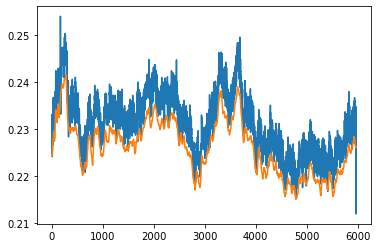

In [47]:
s = 13
errorX[s]
plt.plot(COPX[s])
plt.plot(COPXreal[s])

# Correlation between COPX and Angle x

126.3
[ 9.31819792e-07 -1.18878976e-03  6.22089316e-04 ...  9.90683862e-04
  9.90626557e-04  9.90535387e-04]


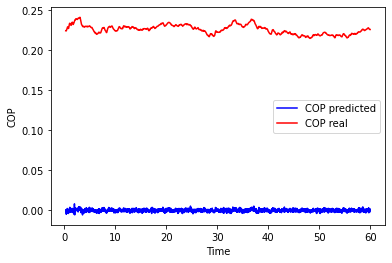

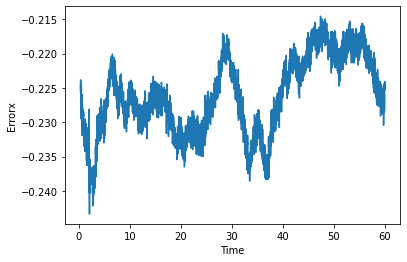

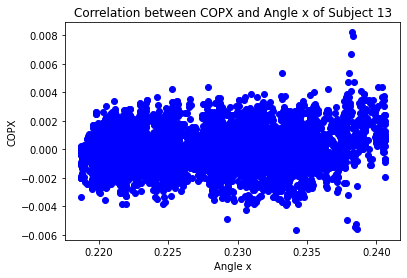

[[1.         0.12558501]
 [0.12558501 1.        ]]


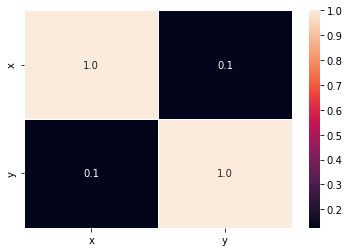

In [9]:
import pandas as pd 
import seaborn as sns
for s in range (13,14):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    print(COPXmatrix)
    plt.figure()
    #plt.plot(t[30:],matrizangx,color='red')
    plt.plot(t[30:],COPXmatrix,color='blue',label='COP predicted')
    plt.plot(t[30:],COPXrealmatrix,color='red',label='COP real')
    plt.xlabel("Time")
    plt.ylabel("COP")
    plt.legend()
    plt.show()
    plt.figure()
    plt.plot(t[30:],errorx,linestyle='-')
    plt.xlabel('Time')
    plt.ylabel('Errorx')
    plt.show()
    plt.figure()
    data={'x':matrizangx,
         'y': COPXmatrix
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df)
    plt.xlabel("Angle x")
    plt.ylabel("COPX")
    plt.title("Correlation between COPX and Angle x of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(matrizangx,COPXmatrix)
    print(r)
    plt.figure()
    data={'x':matrizangx,
          'y': COPXmatrix
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

## Correlation between COPX and anglez

74.3


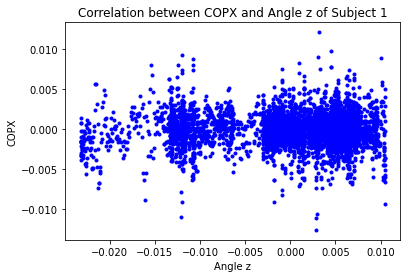

[[1.        0.0141787]
 [0.0141787 1.       ]]


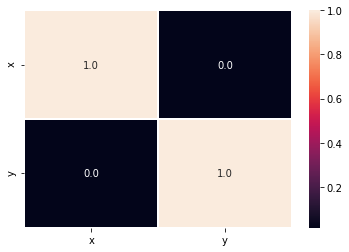

74.3


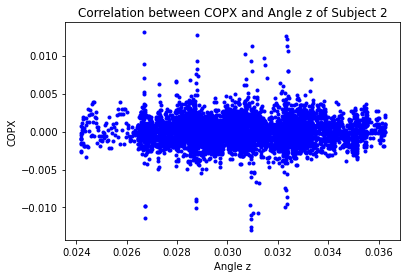

[[ 1.         -0.00310292]
 [-0.00310292  1.        ]]


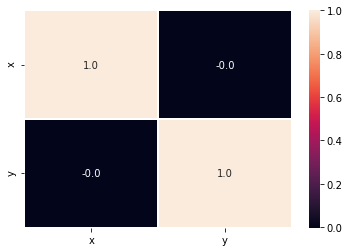

74.3


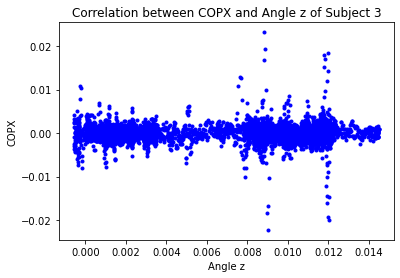

[[1.         0.00486895]
 [0.00486895 1.        ]]


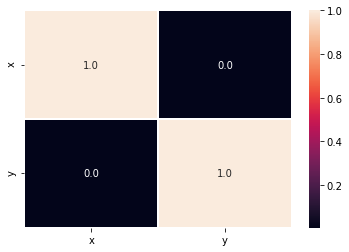

74.3


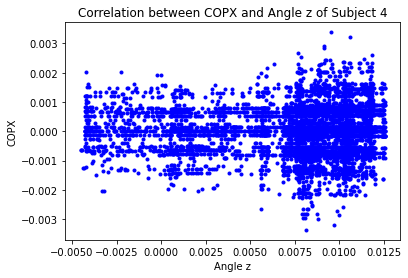

[[1.       0.014436]
 [0.014436 1.      ]]


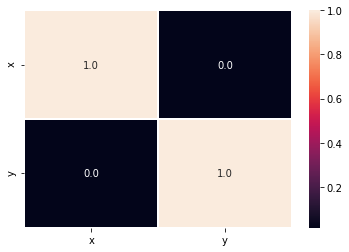

74.3


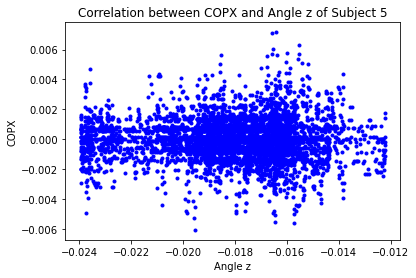

[[ 1.         -0.00491406]
 [-0.00491406  1.        ]]


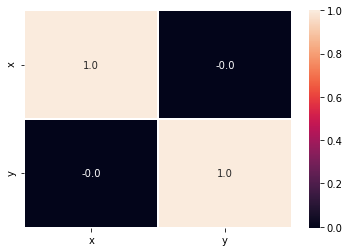

74.3


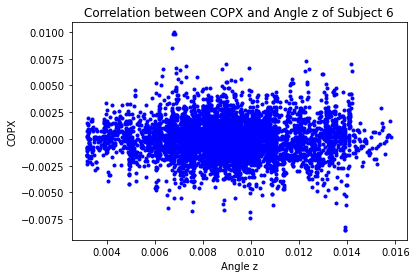

[[ 1.         -0.00722077]
 [-0.00722077  1.        ]]


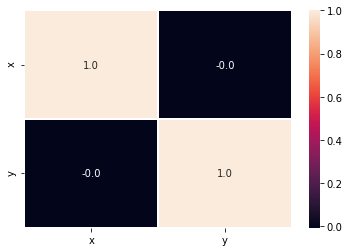

74.3


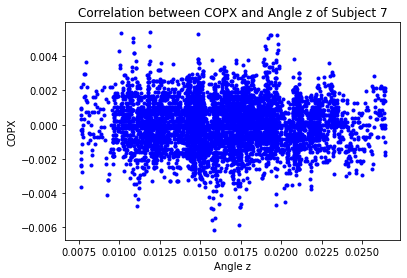

[[ 1.       -0.007383]
 [-0.007383  1.      ]]


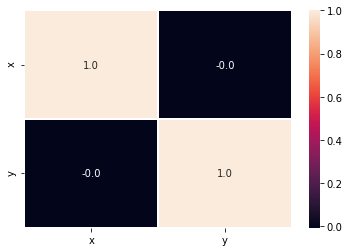

74.3


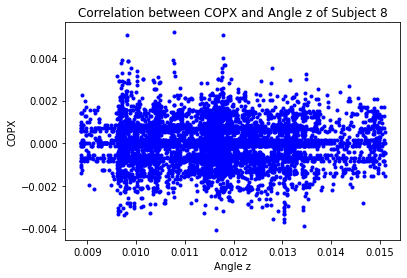

[[ 1.         -0.01103223]
 [-0.01103223  1.        ]]


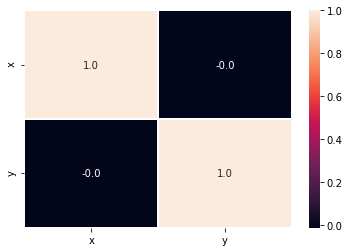

74.3


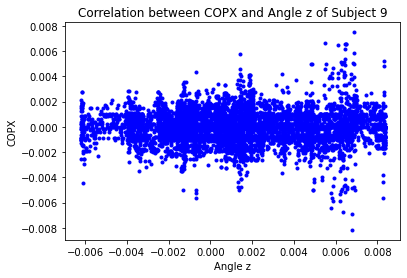

[[1.         0.01021801]
 [0.01021801 1.        ]]


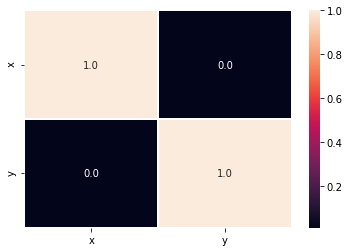

74.3


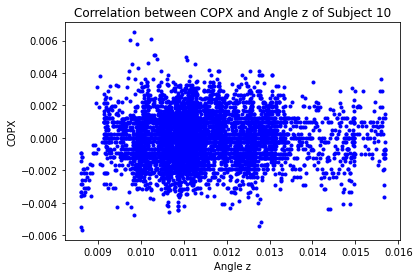

[[1.         0.03506676]
 [0.03506676 1.        ]]


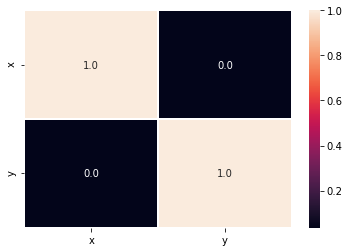

74.3


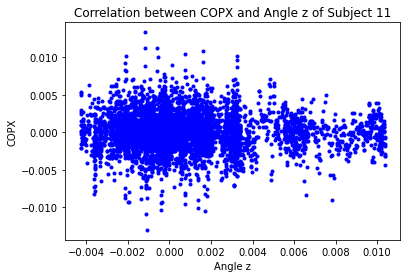

[[ 1.         -0.00874344]
 [-0.00874344  1.        ]]


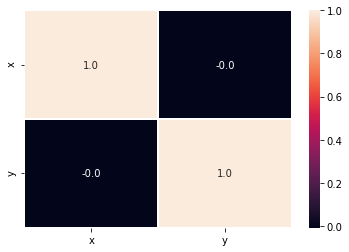

126.3


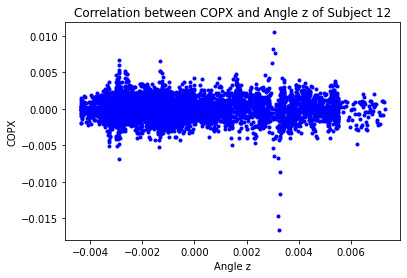

[[ 1.         -0.02193704]
 [-0.02193704  1.        ]]


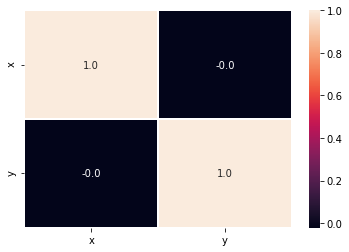

126.3


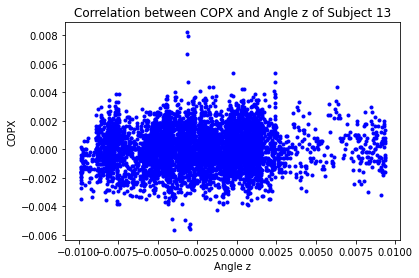

[[1.         0.05802817]
 [0.05802817 1.        ]]


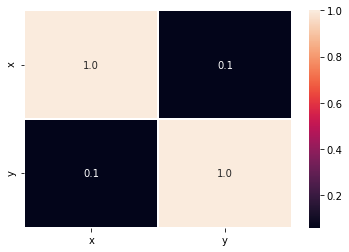

126.3


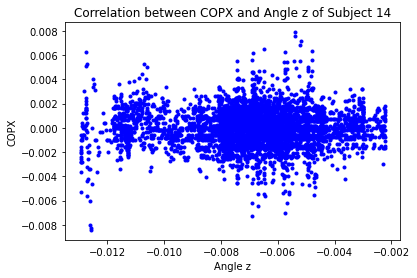

[[1.         0.00203098]
 [0.00203098 1.        ]]


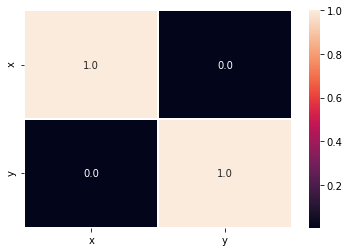

126.3


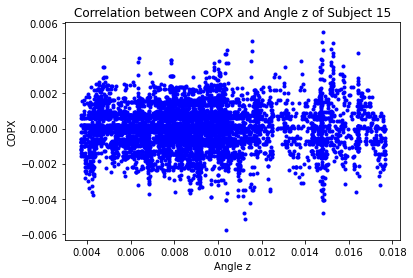

[[1.         0.01574463]
 [0.01574463 1.        ]]


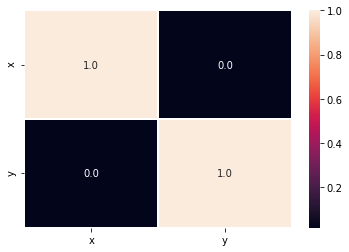

126.3


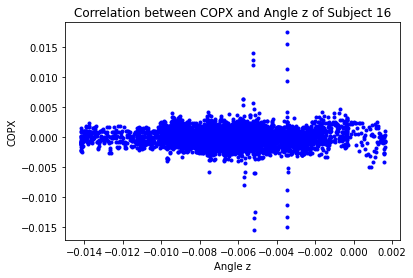

[[ 1.         -0.00785605]
 [-0.00785605  1.        ]]


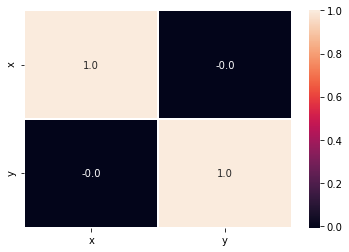

126.3


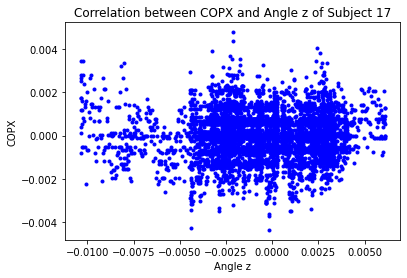

[[1.         0.03591312]
 [0.03591312 1.        ]]


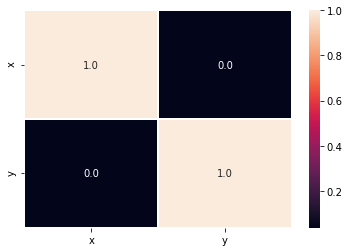

126.3


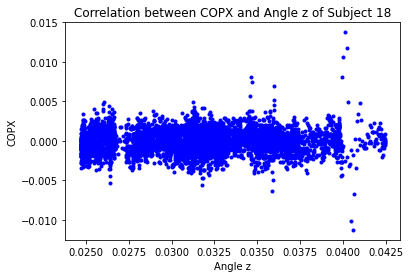

[[1.         0.00949251]
 [0.00949251 1.        ]]


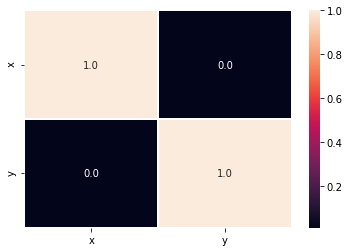

126.3


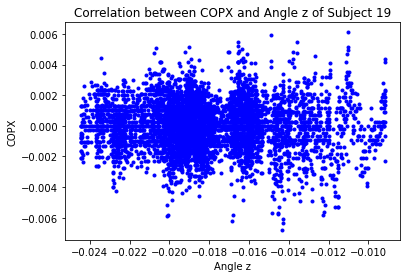

[[ 1.         -0.02428848]
 [-0.02428848  1.        ]]


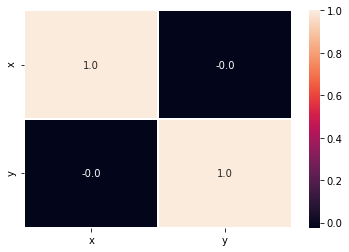

126.3


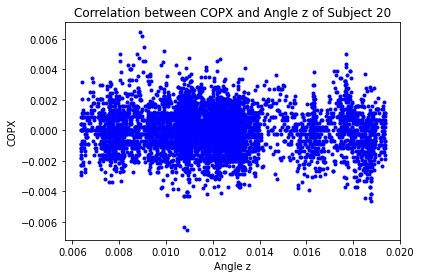

[[ 1.         -0.05297976]
 [-0.05297976  1.        ]]


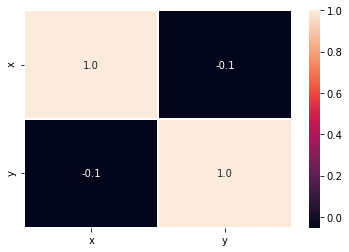

126.3


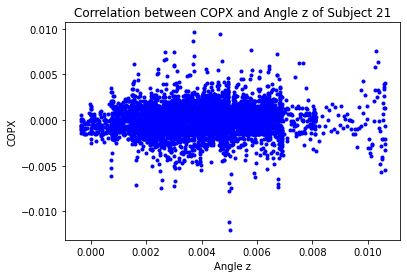

[[1.         0.04694297]
 [0.04694297 1.        ]]


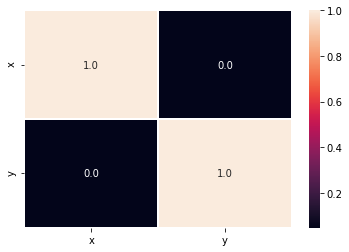

126.3


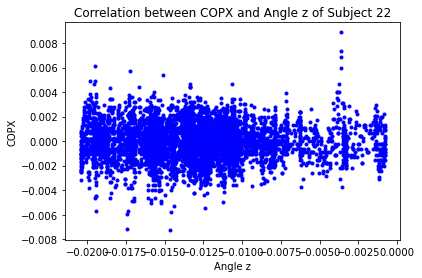

[[ 1.         -0.00556154]
 [-0.00556154  1.        ]]


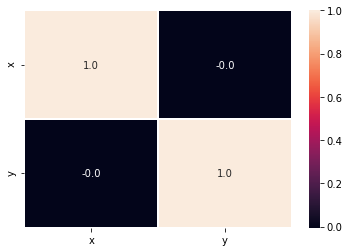

126.3


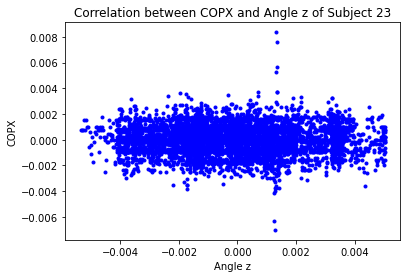

[[ 1.         -0.00239373]
 [-0.00239373  1.        ]]


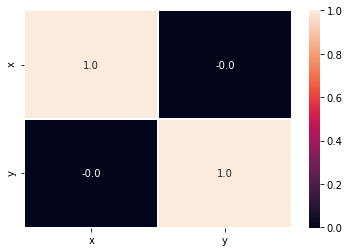

52.9


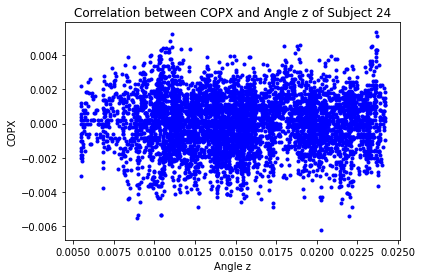

[[1.         0.00379317]
 [0.00379317 1.        ]]


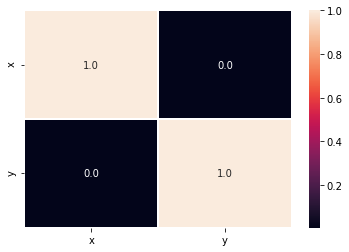

52.9


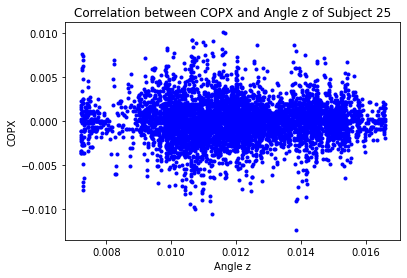

[[1.         0.00585841]
 [0.00585841 1.        ]]


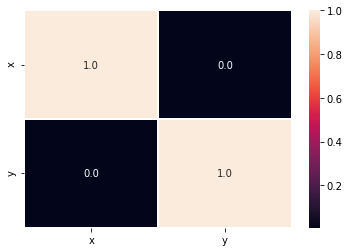

52.9


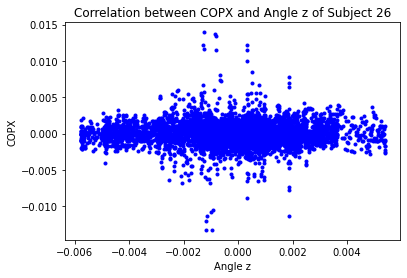

[[ 1.         -0.00677974]
 [-0.00677974  1.        ]]


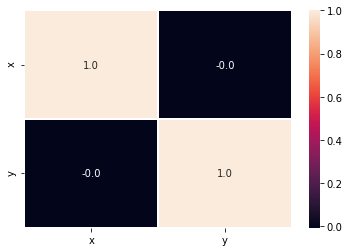

52.9


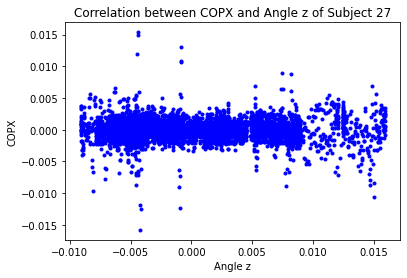

[[ 1.         -0.02020506]
 [-0.02020506  1.        ]]


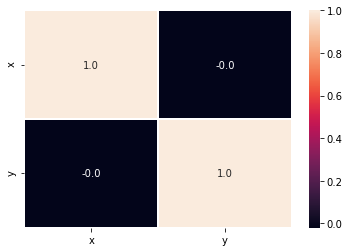

52.9


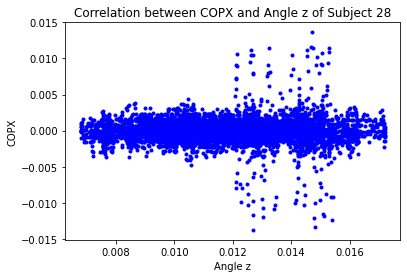

[[ 1.000000e+00 -7.989761e-07]
 [-7.989761e-07  1.000000e+00]]


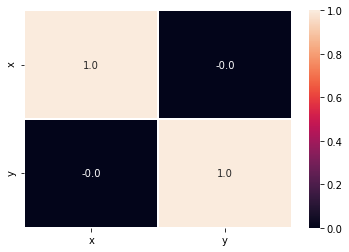

52.9


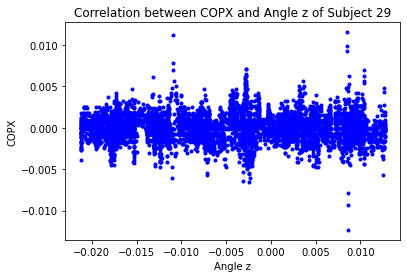

[[ 1.         -0.00947523]
 [-0.00947523  1.        ]]


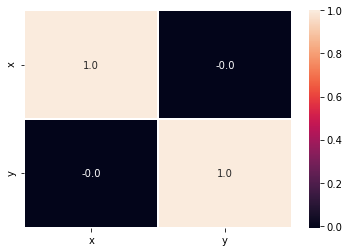

52.9


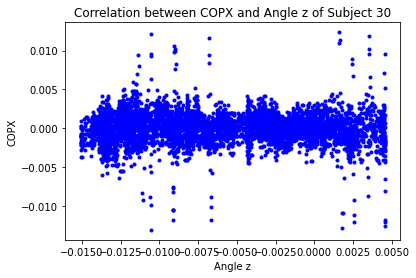

[[ 1.         -0.01857827]
 [-0.01857827  1.        ]]


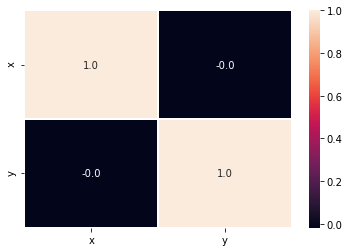

52.9


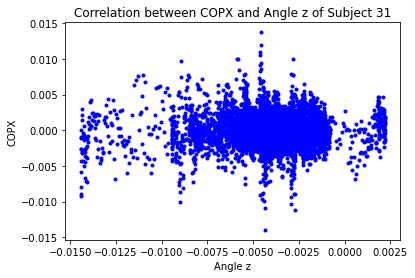

[[1.         0.03271981]
 [0.03271981 1.        ]]


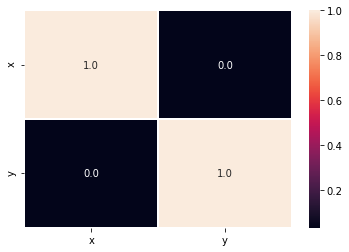

52.9


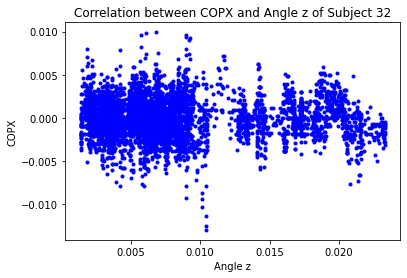

[[ 1.         -0.01969137]
 [-0.01969137  1.        ]]


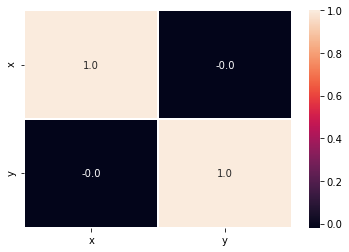

52.9


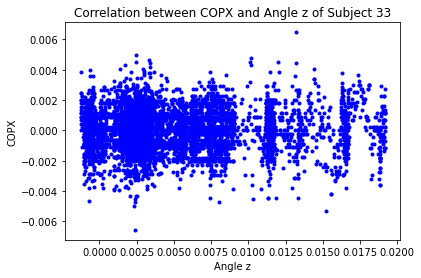

[[1.         0.00289298]
 [0.00289298 1.        ]]


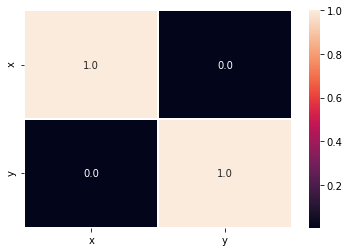

52.9


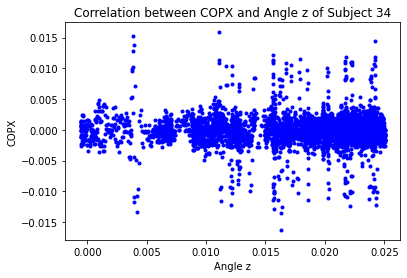

[[ 1.         -0.00861156]
 [-0.00861156  1.        ]]


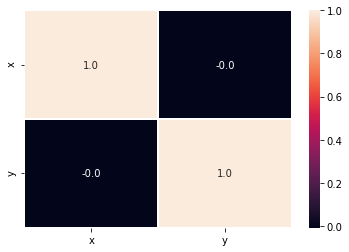

52.9


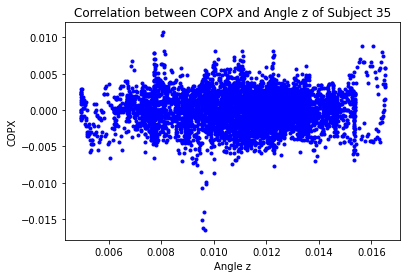

[[1.        0.0113009]
 [0.0113009 1.       ]]


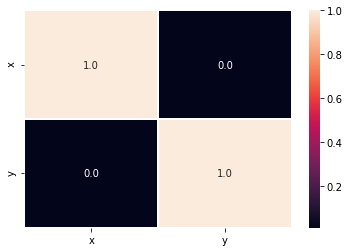

75.85


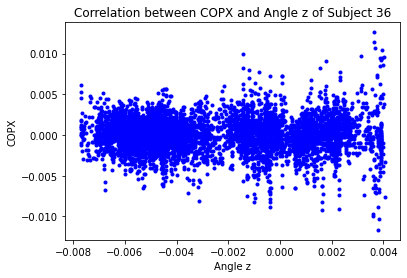

[[ 1.         -0.01057827]
 [-0.01057827  1.        ]]


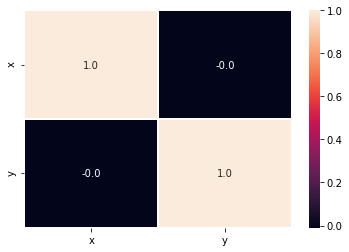

75.85


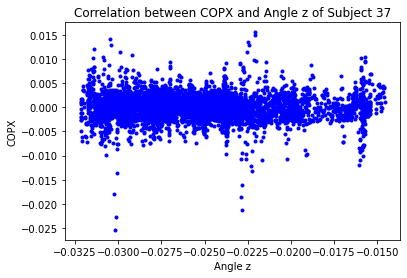

[[ 1.         -0.04040862]
 [-0.04040862  1.        ]]


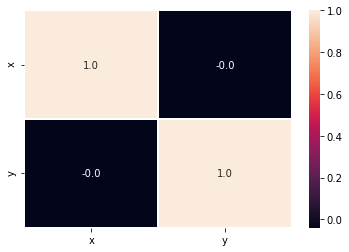

75.85


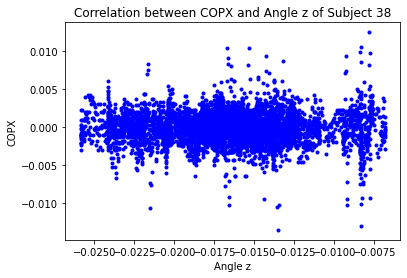

[[1.         0.00266326]
 [0.00266326 1.        ]]


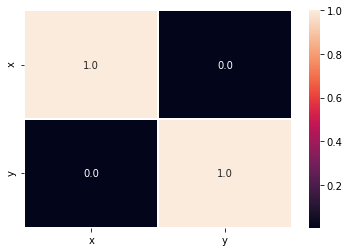

75.85


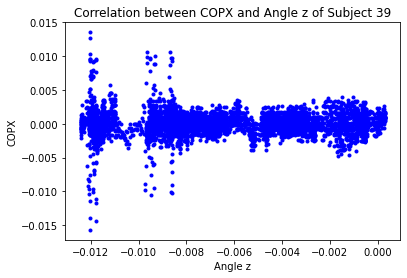

[[ 1.         -0.00206959]
 [-0.00206959  1.        ]]


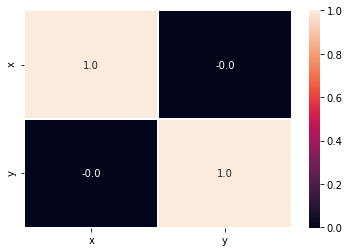

75.85


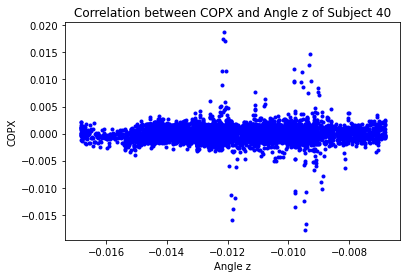

[[ 1.00000000e+00 -4.46244736e-04]
 [-4.46244736e-04  1.00000000e+00]]


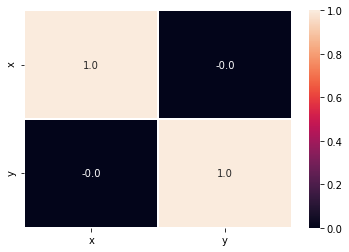

75.85


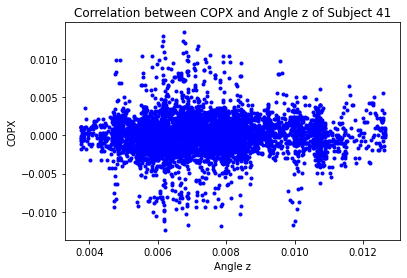

[[1.         0.02117534]
 [0.02117534 1.        ]]


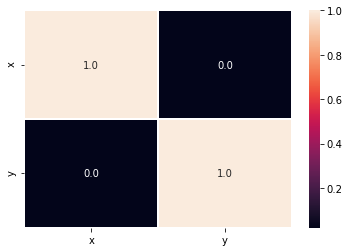

75.85


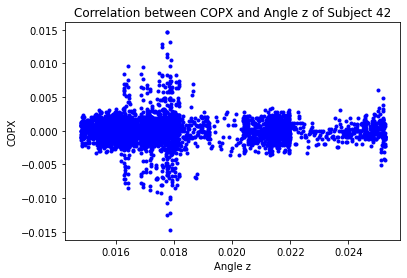

[[ 1.         -0.00263891]
 [-0.00263891  1.        ]]


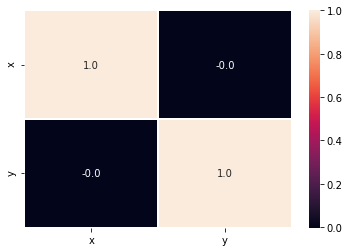

75.85


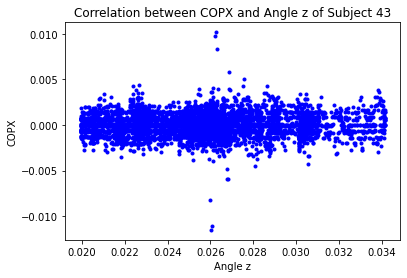

[[1.         0.02473687]
 [0.02473687 1.        ]]


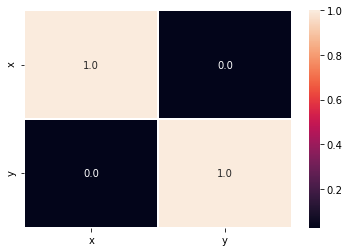

75.85


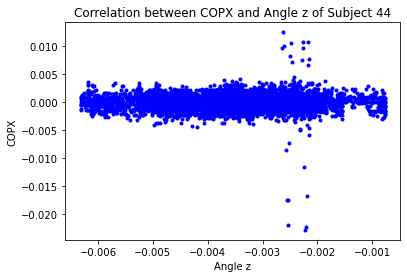

[[1.00000000e+00 7.17605543e-04]
 [7.17605543e-04 1.00000000e+00]]


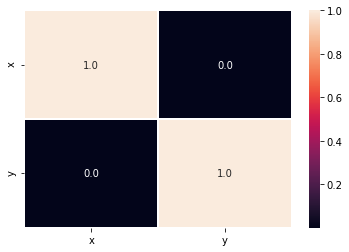

75.85


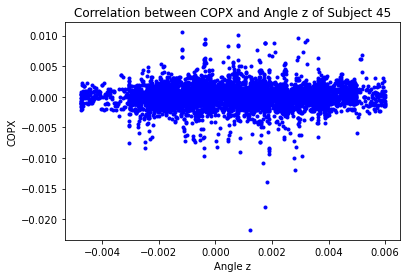

[[1.         0.01213877]
 [0.01213877 1.        ]]


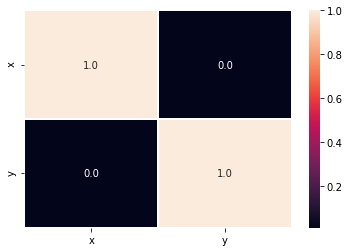

75.85


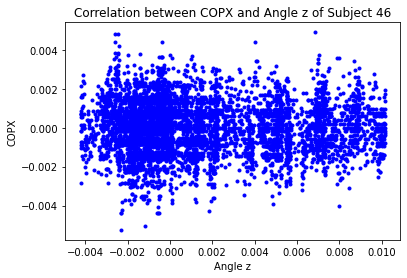

[[ 1.         -0.00675348]
 [-0.00675348  1.        ]]


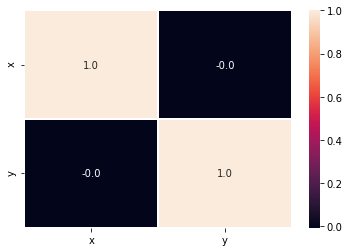

75.85


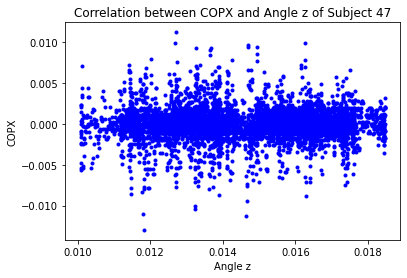

[[1.         0.00731069]
 [0.00731069 1.        ]]


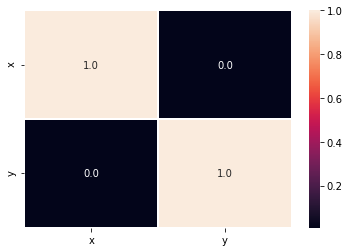

61.05


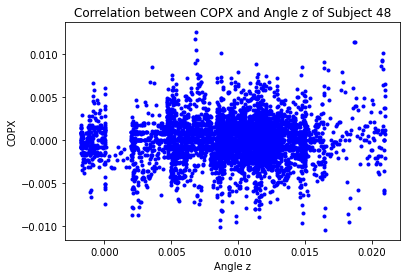

[[1.         0.03147997]
 [0.03147997 1.        ]]


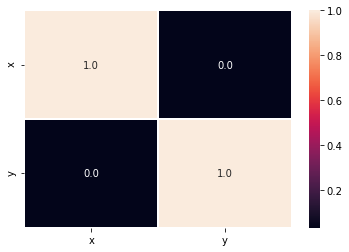

61.05


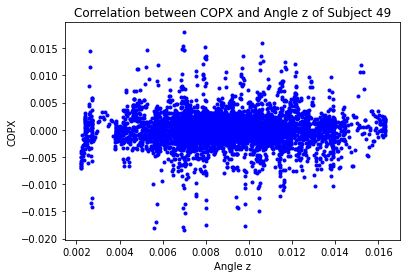

[[1.         0.01333935]
 [0.01333935 1.        ]]


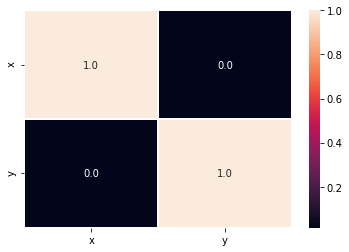

In [9]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    plt.figure()
    data={'x':matrizangz,
         'y': COPXmatrix
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Angle z")
    plt.ylabel("COPX")
    plt.title("Correlation between COPX and Angle z of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(matrizangz,COPXmatrix)
    print(r)
    plt.figure()
    data={'x':matrizangz,
          'y': COPXmatrix
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

## Correlation between error x and angle x

74.3


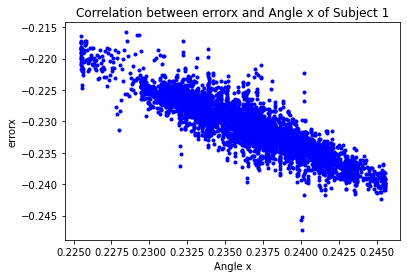

[[ 1.         -0.89493622]
 [-0.89493622  1.        ]]


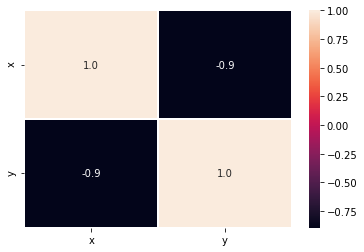

74.3


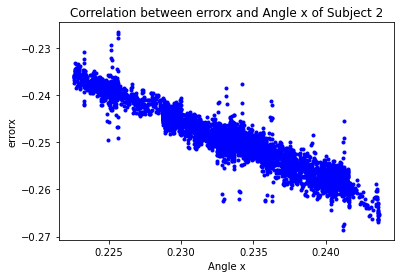

[[ 1.         -0.94736561]
 [-0.94736561  1.        ]]


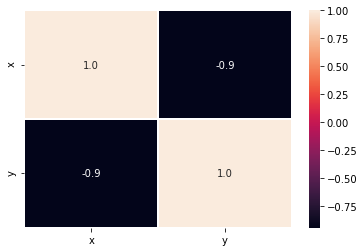

74.3


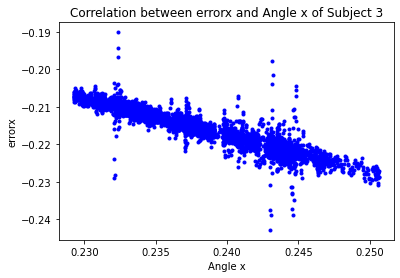

[[ 1.        -0.9387128]
 [-0.9387128  1.       ]]


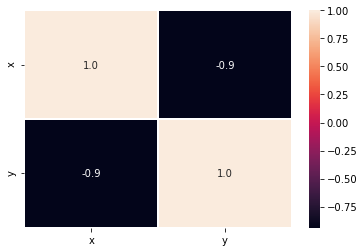

74.3


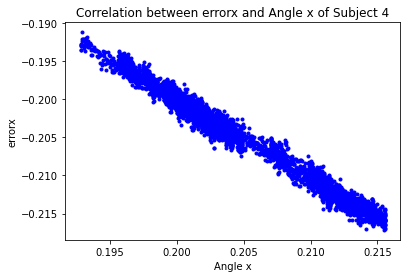

[[ 1.         -0.99024696]
 [-0.99024696  1.        ]]


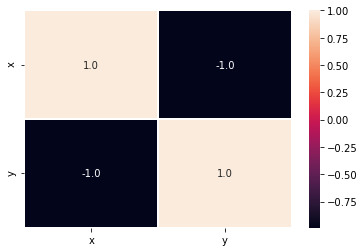

74.3


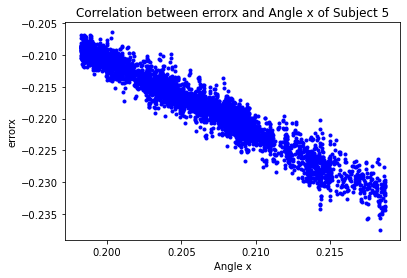

[[ 1.         -0.96755159]
 [-0.96755159  1.        ]]


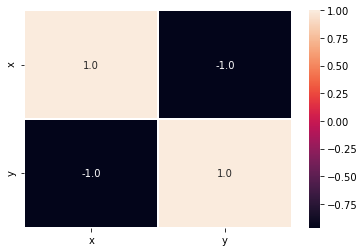

74.3


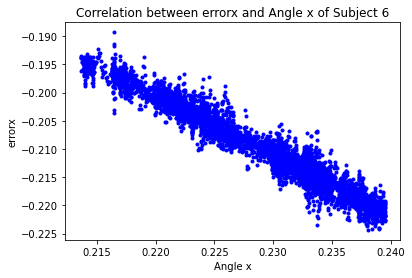

[[ 1.         -0.97591929]
 [-0.97591929  1.        ]]


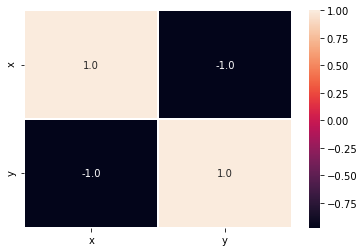

74.3


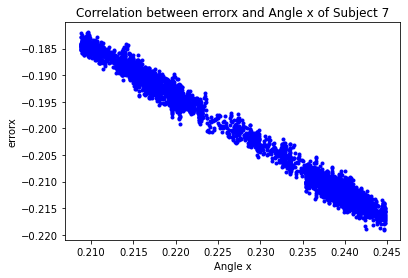

[[ 1.         -0.99381827]
 [-0.99381827  1.        ]]


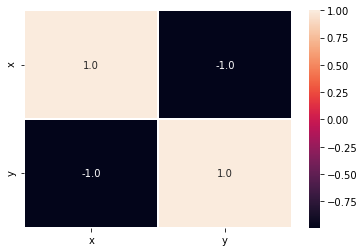

74.3


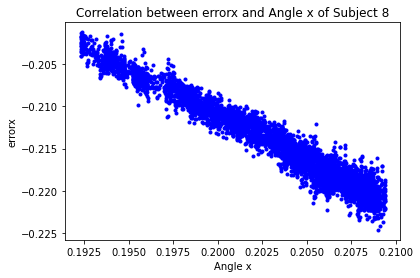

[[ 1.         -0.97577213]
 [-0.97577213  1.        ]]


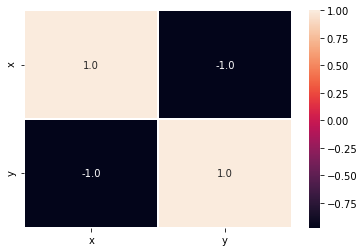

74.3


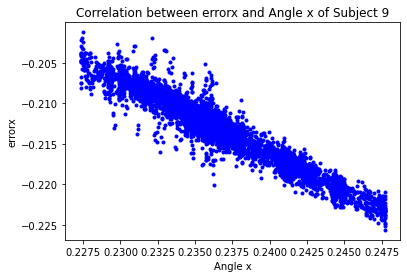

[[ 1.         -0.95875351]
 [-0.95875351  1.        ]]


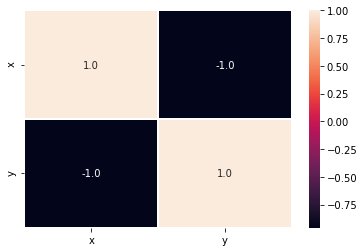

74.3


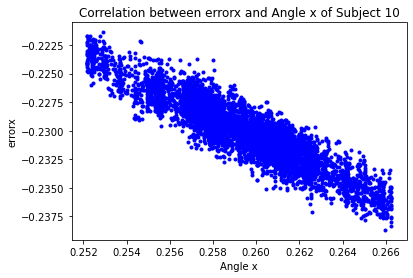

[[ 1.         -0.91295357]
 [-0.91295357  1.        ]]


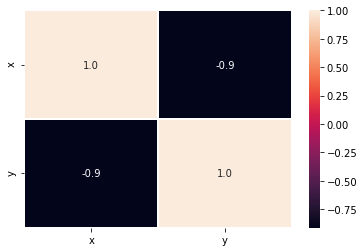

74.3


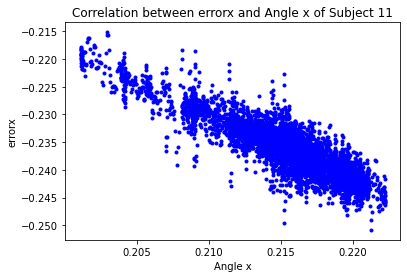

[[ 1.         -0.89215682]
 [-0.89215682  1.        ]]


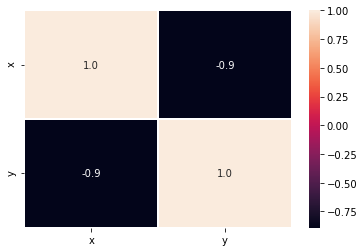

126.3


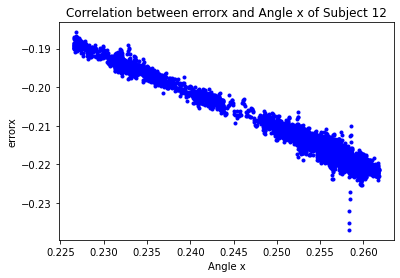

[[ 1.         -0.98795764]
 [-0.98795764  1.        ]]


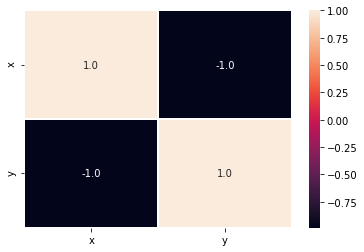

126.3


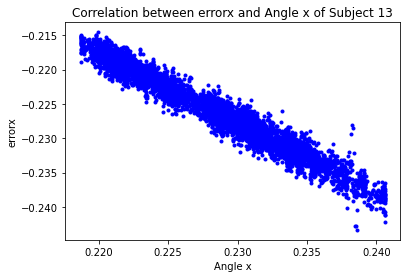

[[ 1.         -0.97597713]
 [-0.97597713  1.        ]]


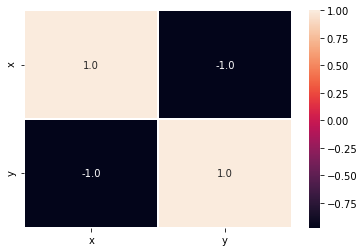

126.3


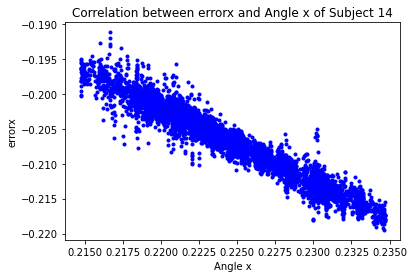

[[ 1.         -0.96689547]
 [-0.96689547  1.        ]]


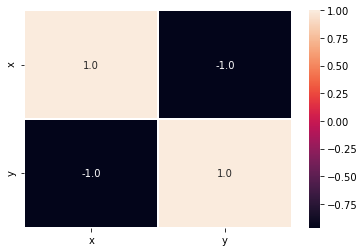

126.3


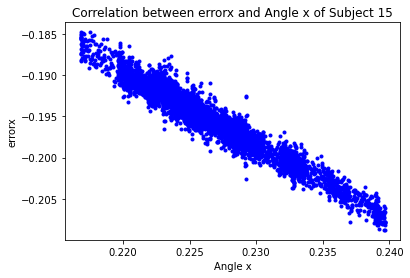

[[ 1.         -0.97262173]
 [-0.97262173  1.        ]]


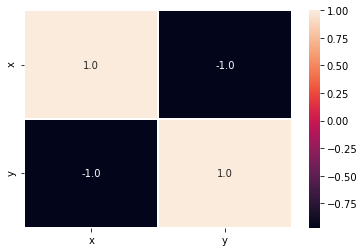

126.3


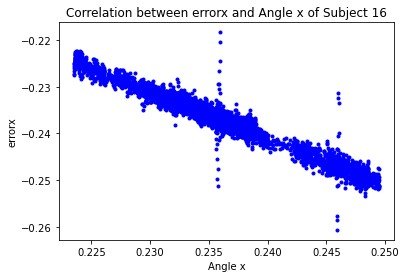

[[ 1.         -0.97779119]
 [-0.97779119  1.        ]]


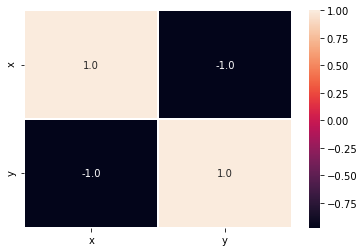

126.3


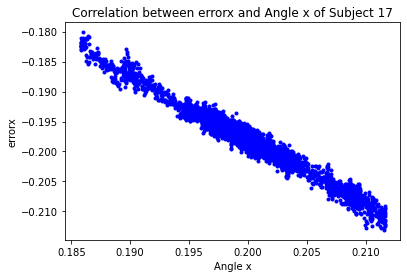

[[ 1.         -0.98204674]
 [-0.98204674  1.        ]]


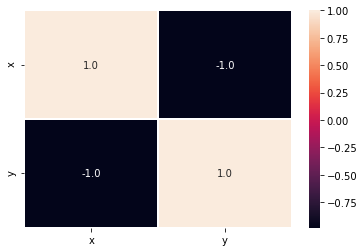

126.3


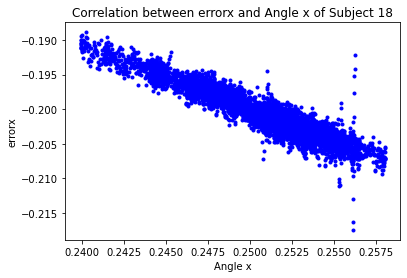

[[ 1.         -0.94143958]
 [-0.94143958  1.        ]]


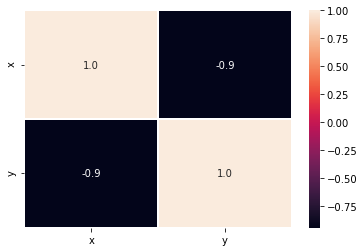

126.3


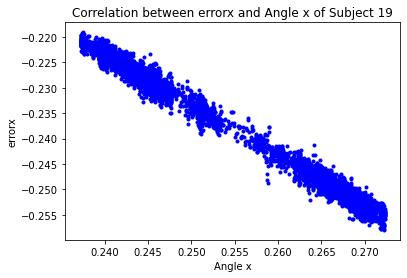

[[ 1.        -0.9934854]
 [-0.9934854  1.       ]]


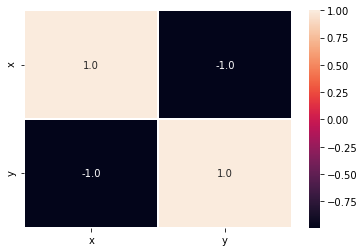

126.3


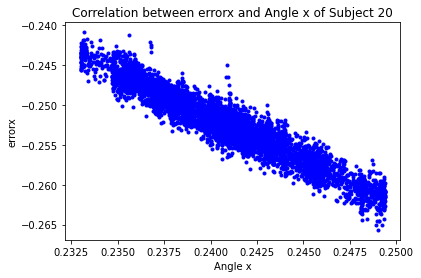

[[ 1.         -0.95490794]
 [-0.95490794  1.        ]]


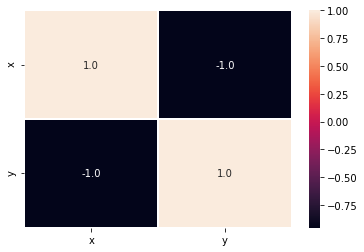

126.3


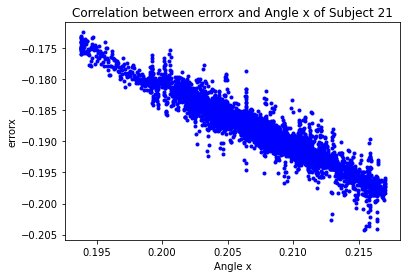

[[ 1.         -0.94755325]
 [-0.94755325  1.        ]]


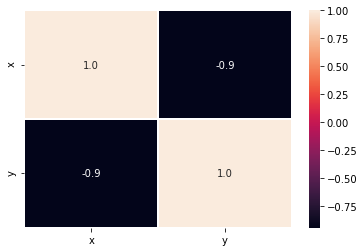

126.3


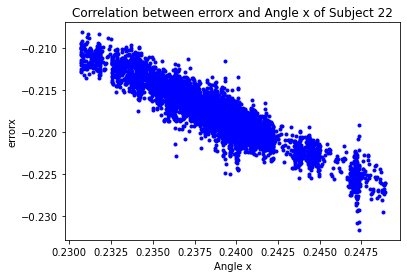

[[ 1.         -0.92276602]
 [-0.92276602  1.        ]]


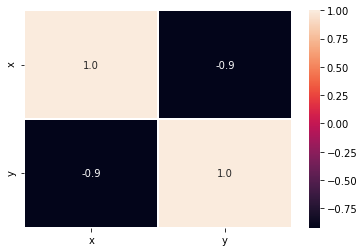

126.3


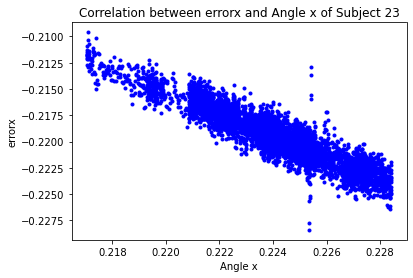

[[ 1.         -0.92534244]
 [-0.92534244  1.        ]]


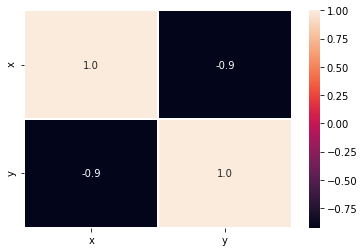

52.9


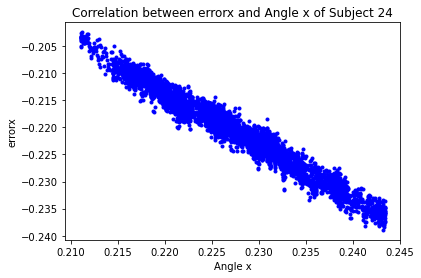

[[ 1.         -0.98101858]
 [-0.98101858  1.        ]]


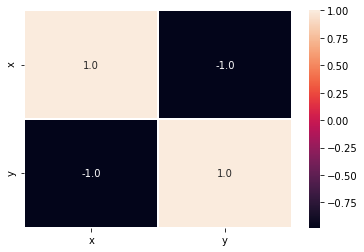

52.9


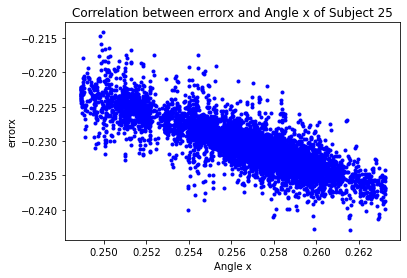

[[ 1.        -0.8333562]
 [-0.8333562  1.       ]]


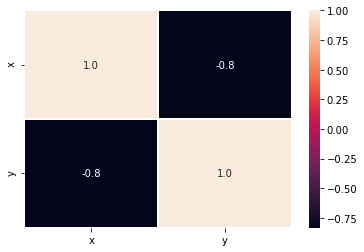

52.9


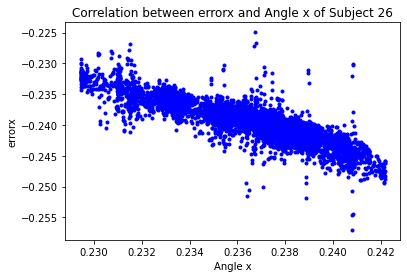

[[ 1.         -0.86498608]
 [-0.86498608  1.        ]]


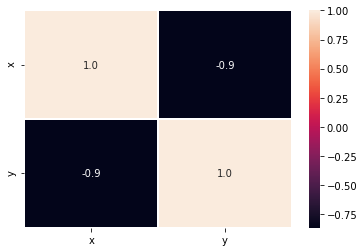

52.9


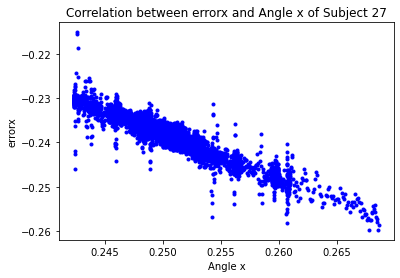

[[ 1.         -0.93338816]
 [-0.93338816  1.        ]]


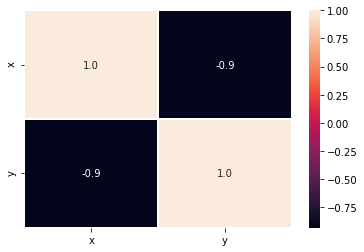

52.9


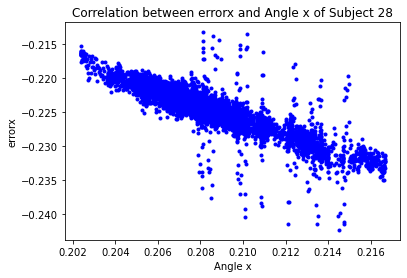

[[ 1.         -0.87768252]
 [-0.87768252  1.        ]]


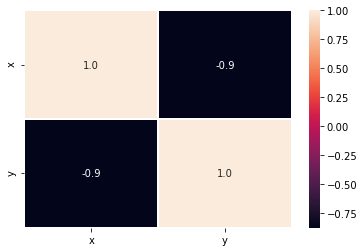

52.9


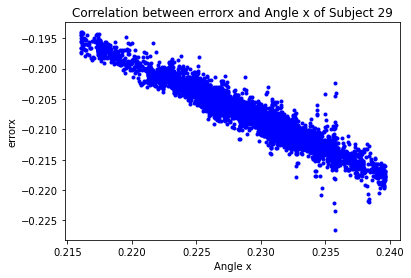

[[ 1.         -0.96060528]
 [-0.96060528  1.        ]]


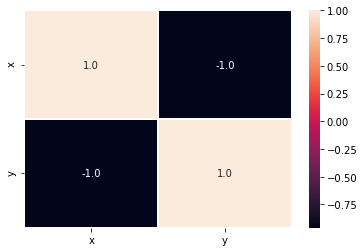

52.9


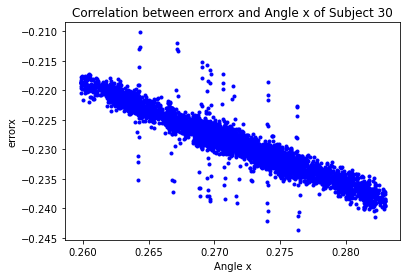

[[ 1.         -0.95104791]
 [-0.95104791  1.        ]]


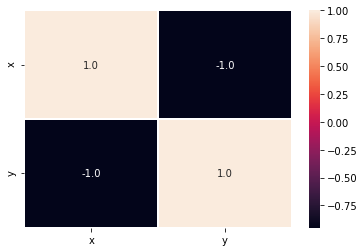

52.9


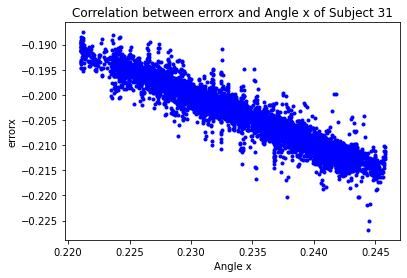

[[ 1.         -0.95281591]
 [-0.95281591  1.        ]]


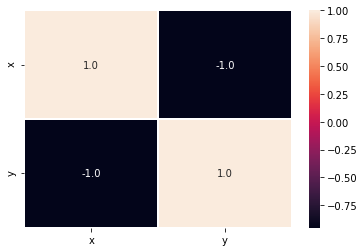

52.9


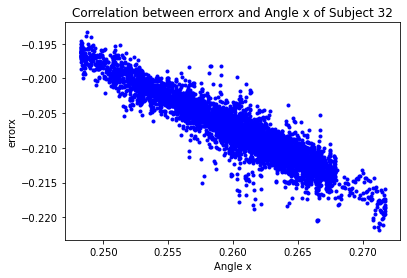

[[ 1.         -0.93460181]
 [-0.93460181  1.        ]]


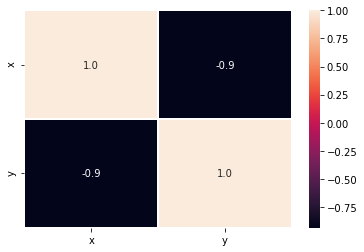

52.9


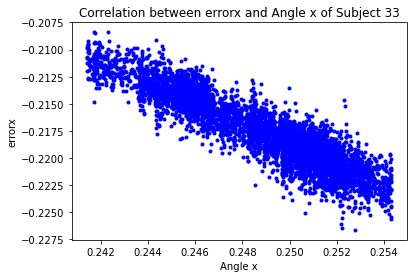

[[ 1.         -0.91452952]
 [-0.91452952  1.        ]]


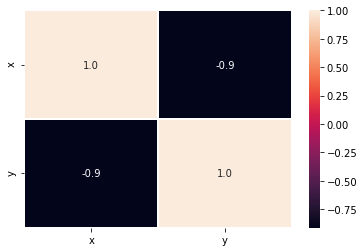

52.9


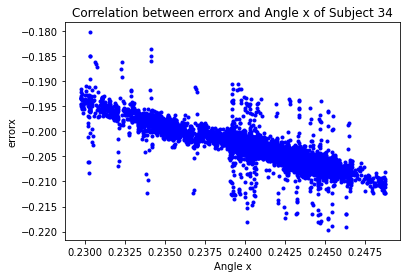

[[ 1.         -0.86122189]
 [-0.86122189  1.        ]]


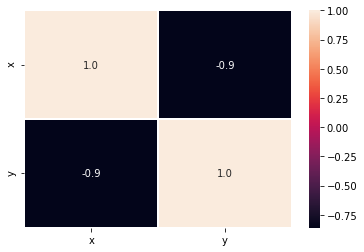

52.9


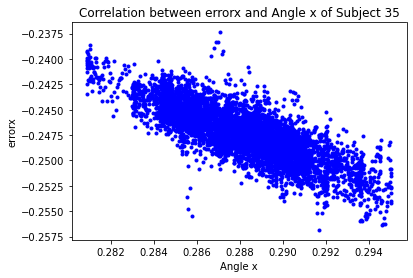

[[ 1.         -0.80603363]
 [-0.80603363  1.        ]]


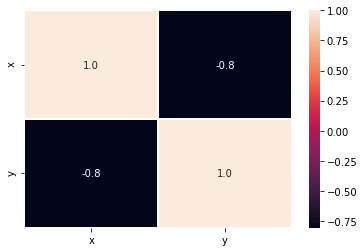

75.85


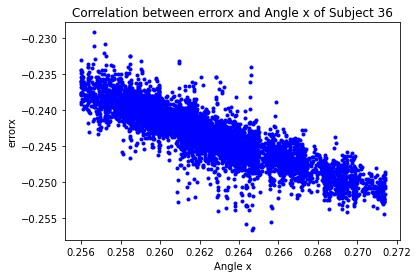

[[ 1.         -0.87441508]
 [-0.87441508  1.        ]]


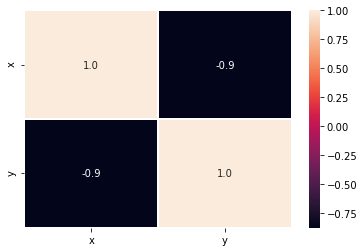

75.85


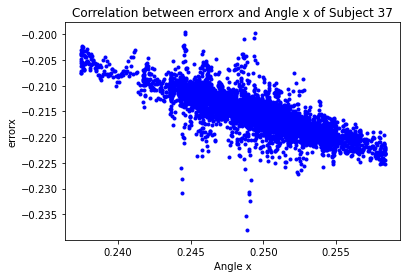

[[ 1.         -0.81105819]
 [-0.81105819  1.        ]]


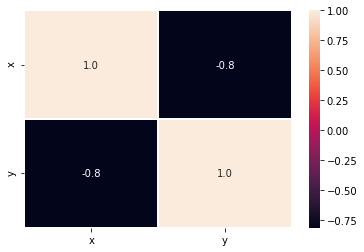

75.85


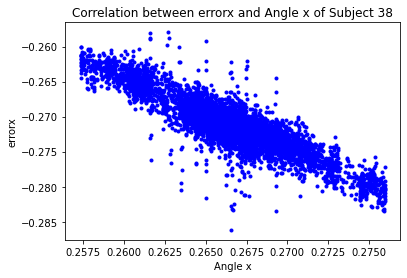

[[ 1.         -0.88956388]
 [-0.88956388  1.        ]]


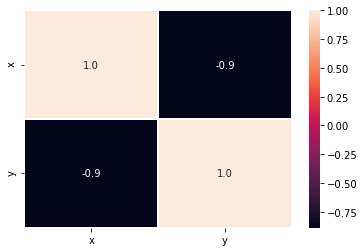

75.85


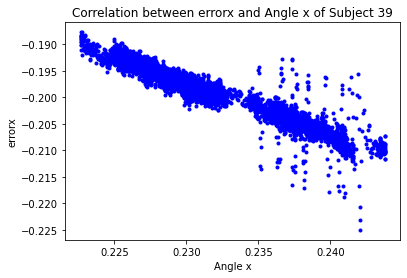

[[ 1.         -0.95032255]
 [-0.95032255  1.        ]]


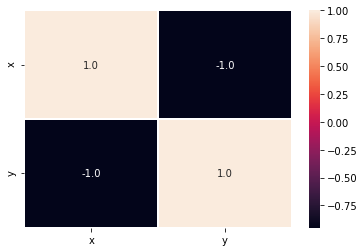

75.85


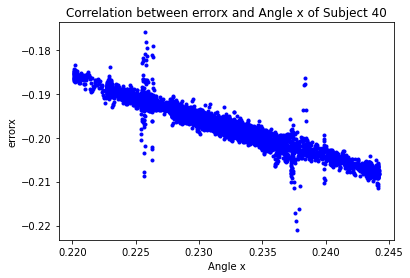

[[ 1.         -0.95277335]
 [-0.95277335  1.        ]]


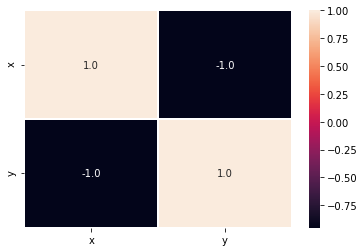

75.85


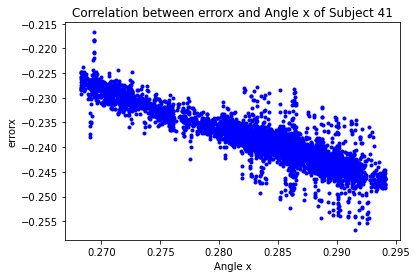

[[ 1.         -0.89857719]
 [-0.89857719  1.        ]]


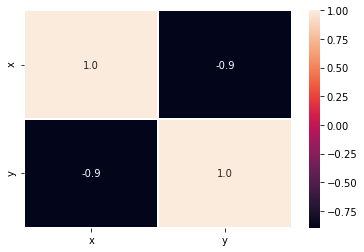

75.85


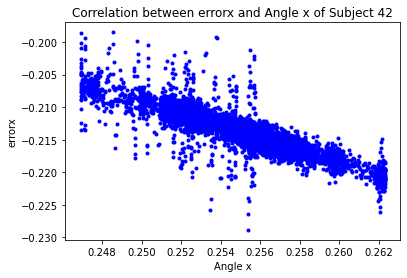

[[ 1.         -0.87364525]
 [-0.87364525  1.        ]]


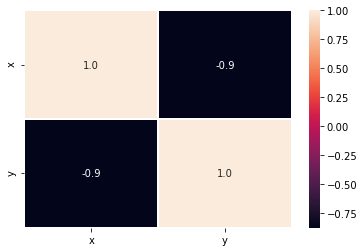

75.85


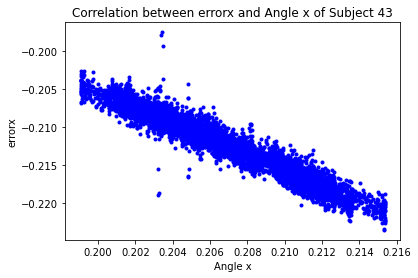

[[ 1.        -0.9634483]
 [-0.9634483  1.       ]]


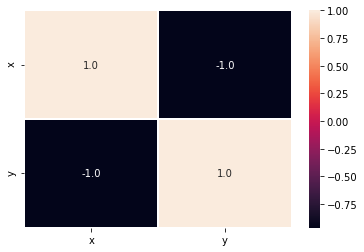

75.85


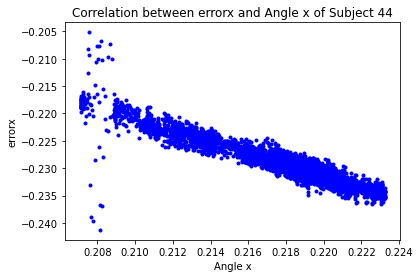

[[ 1.         -0.93099698]
 [-0.93099698  1.        ]]


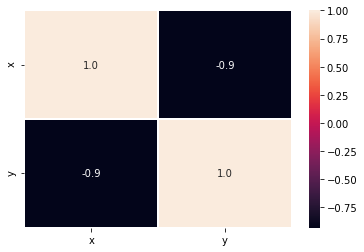

75.85


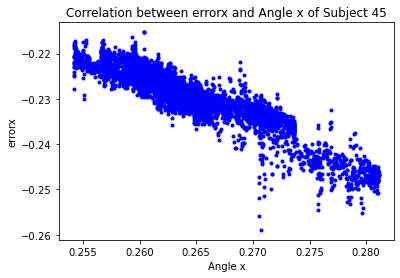

[[ 1.         -0.91846103]
 [-0.91846103  1.        ]]


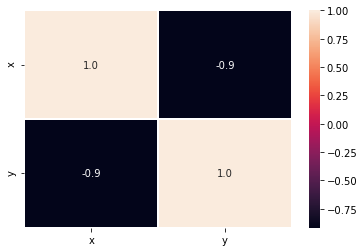

75.85


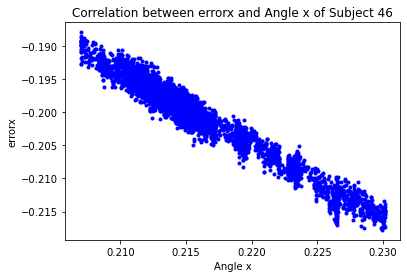

[[ 1.         -0.97676099]
 [-0.97676099  1.        ]]


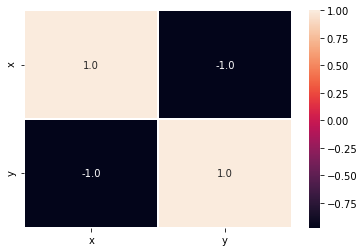

75.85


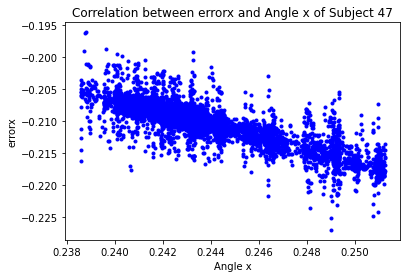

[[ 1.         -0.82015522]
 [-0.82015522  1.        ]]


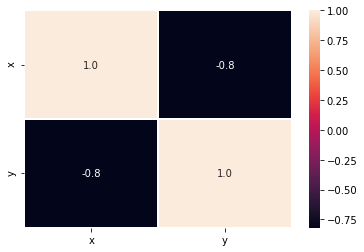

61.05


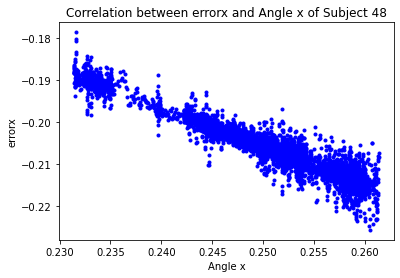

[[ 1.         -0.96252661]
 [-0.96252661  1.        ]]


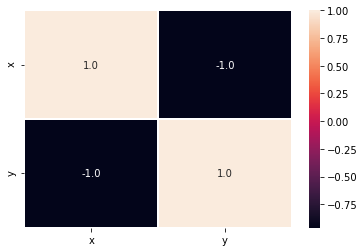

61.05


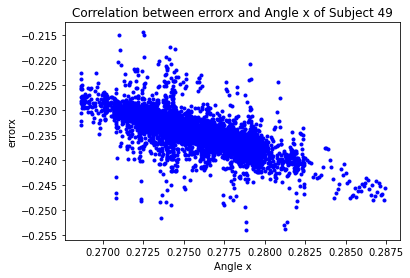

[[ 1.         -0.71906755]
 [-0.71906755  1.        ]]


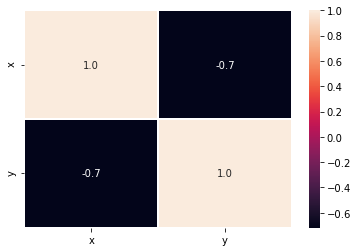

In [10]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    plt.figure()
    data={'x':matrizangx,
         'y': errorx
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Angle x")
    plt.ylabel("errorx")
    plt.title("Correlation between errorx and Angle x of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(matrizangx,errorx)
    print(r)
    plt.figure()
    data={'x':matrizangx,
          'y':errorx
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

## Correlation between errorx and anglez

74.3


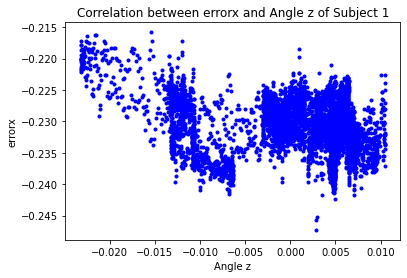

[[ 1.         -0.89493622]
 [-0.89493622  1.        ]]


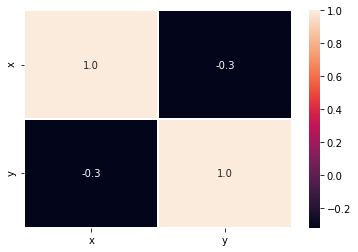

74.3


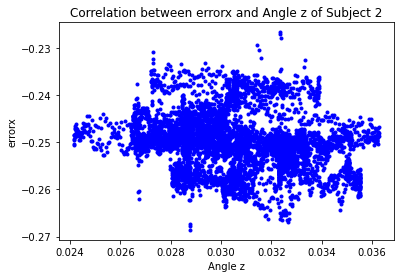

[[ 1.         -0.94736561]
 [-0.94736561  1.        ]]


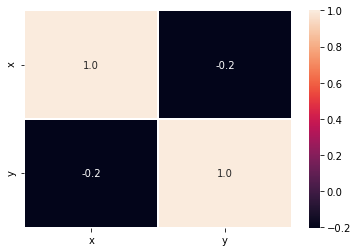

74.3


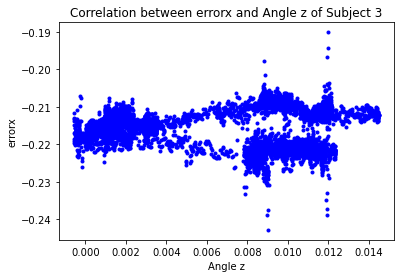

[[ 1.        -0.9387128]
 [-0.9387128  1.       ]]


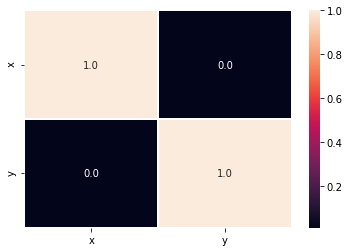

74.3


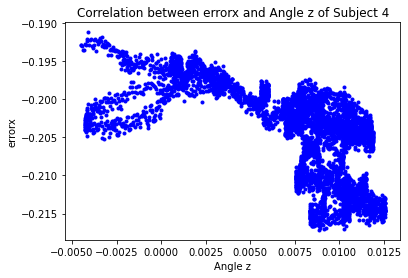

[[ 1.         -0.99024696]
 [-0.99024696  1.        ]]


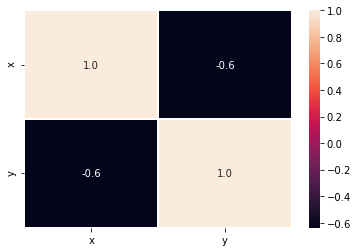

74.3


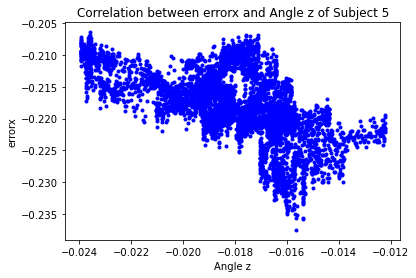

[[ 1.         -0.96755159]
 [-0.96755159  1.        ]]


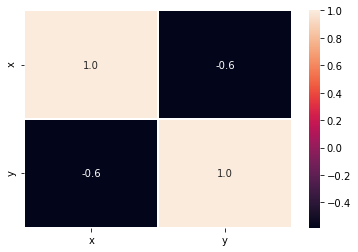

74.3


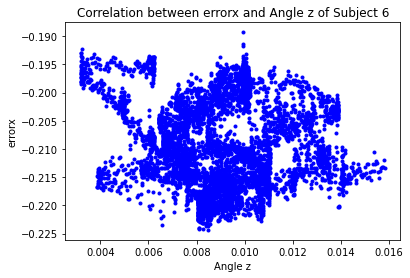

[[ 1.         -0.97591929]
 [-0.97591929  1.        ]]


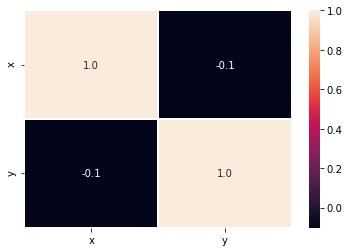

74.3


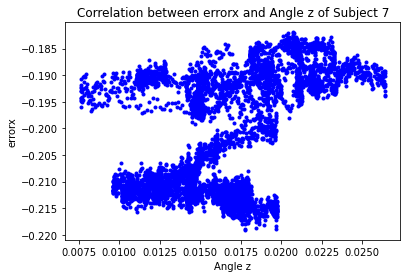

[[ 1.         -0.99381827]
 [-0.99381827  1.        ]]


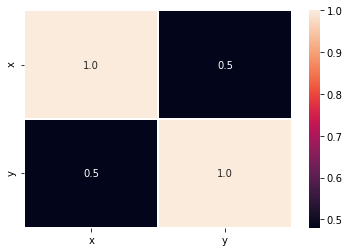

74.3


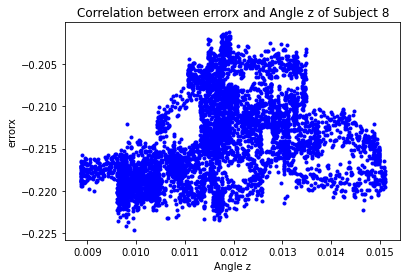

[[ 1.         -0.97577213]
 [-0.97577213  1.        ]]


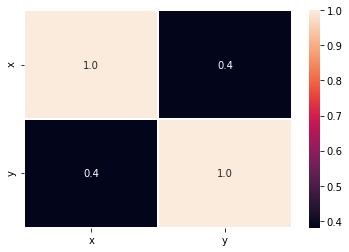

74.3


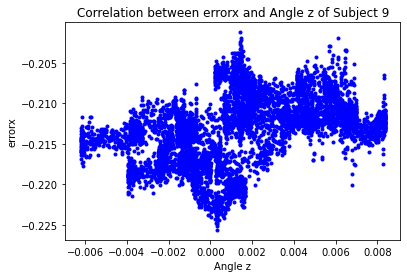

[[ 1.         -0.95875351]
 [-0.95875351  1.        ]]


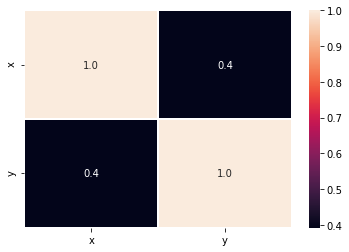

74.3


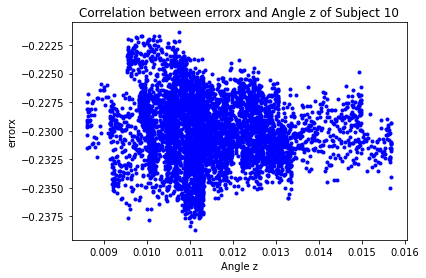

[[ 1.         -0.91295357]
 [-0.91295357  1.        ]]


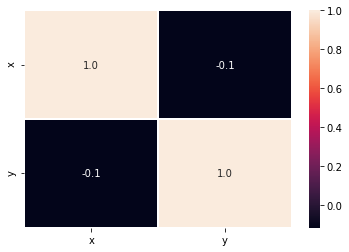

74.3


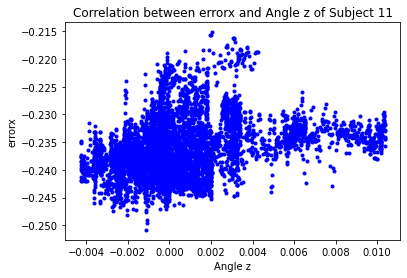

[[ 1.         -0.89215682]
 [-0.89215682  1.        ]]


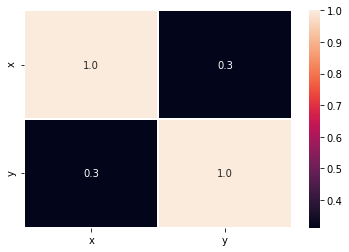

126.3


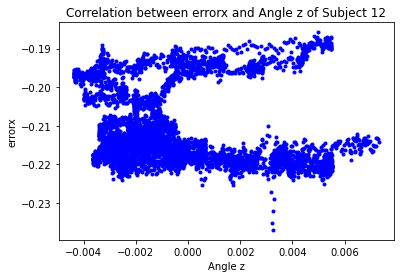

[[ 1.         -0.98795764]
 [-0.98795764  1.        ]]


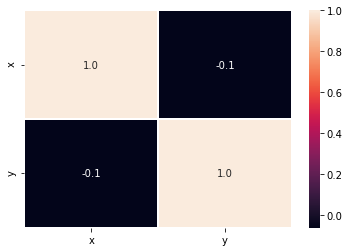

126.3


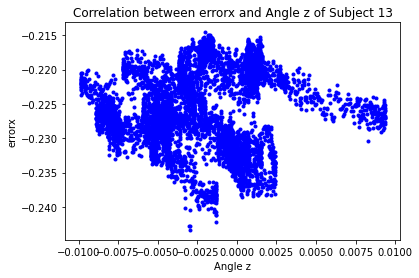

[[ 1.         -0.97597713]
 [-0.97597713  1.        ]]


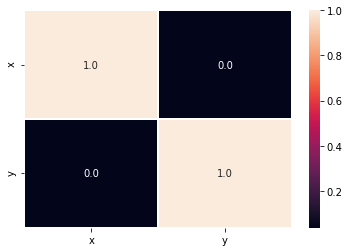

126.3


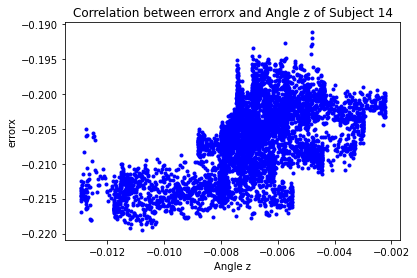

[[ 1.         -0.96689547]
 [-0.96689547  1.        ]]


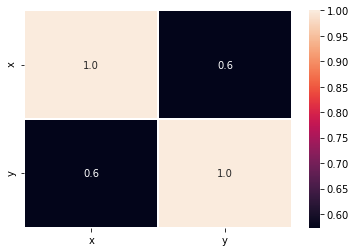

126.3


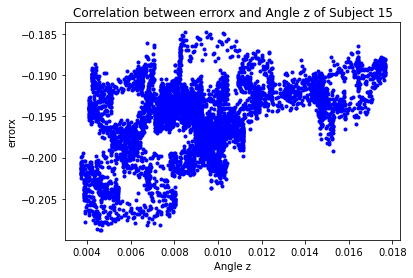

[[ 1.         -0.97262173]
 [-0.97262173  1.        ]]


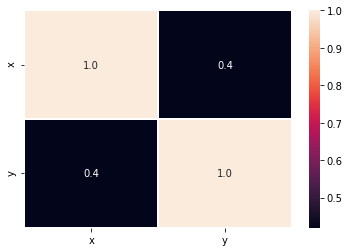

126.3


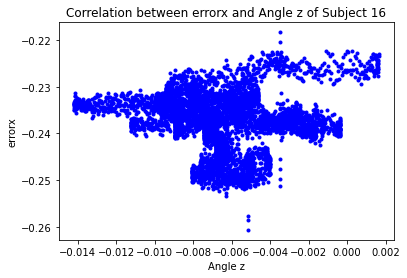

[[ 1.         -0.97779119]
 [-0.97779119  1.        ]]


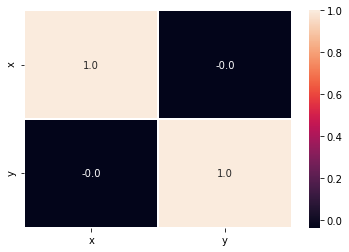

126.3


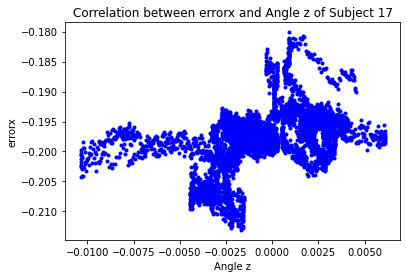

[[ 1.         -0.98204674]
 [-0.98204674  1.        ]]


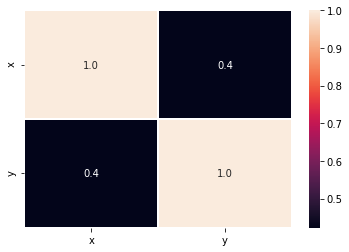

126.3


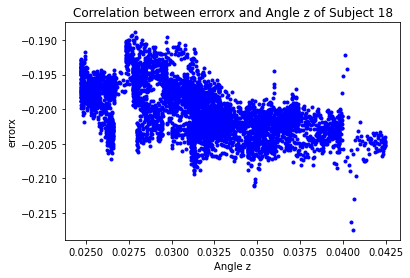

[[ 1.         -0.94143958]
 [-0.94143958  1.        ]]


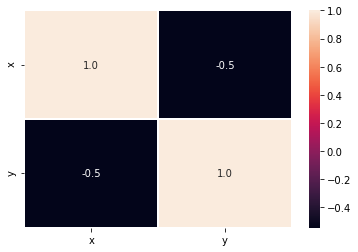

126.3


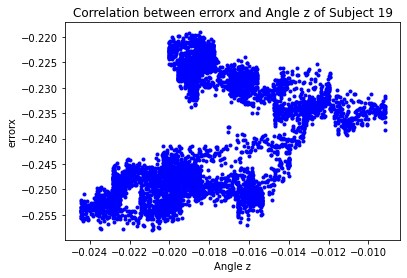

[[ 1.        -0.9934854]
 [-0.9934854  1.       ]]


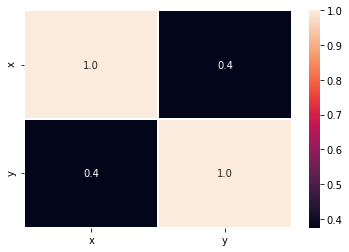

126.3


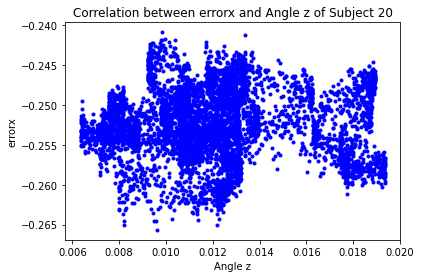

[[ 1.         -0.95490794]
 [-0.95490794  1.        ]]


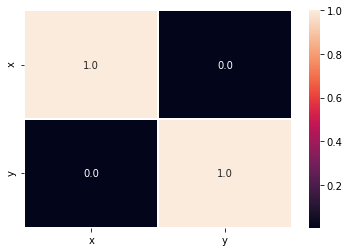

126.3


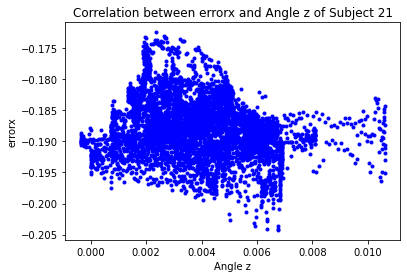

[[ 1.         -0.94755325]
 [-0.94755325  1.        ]]


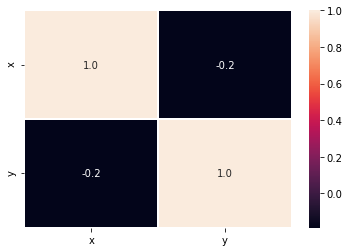

126.3


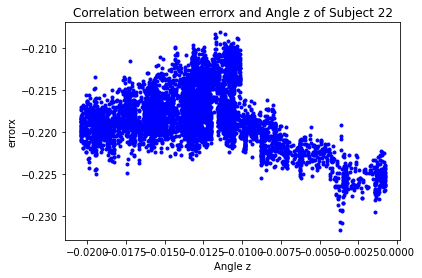

[[ 1.         -0.92276602]
 [-0.92276602  1.        ]]


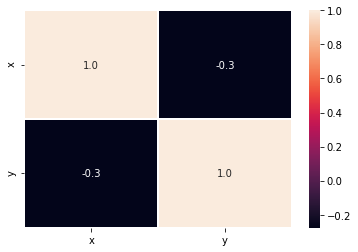

126.3


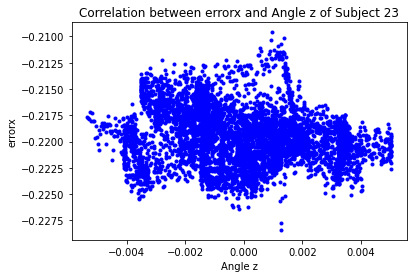

[[ 1.         -0.92534244]
 [-0.92534244  1.        ]]


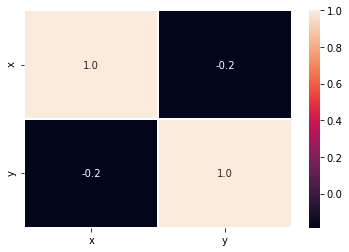

52.9


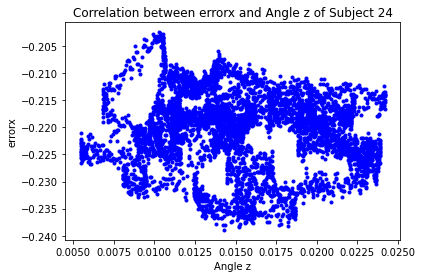

[[ 1.         -0.98101858]
 [-0.98101858  1.        ]]


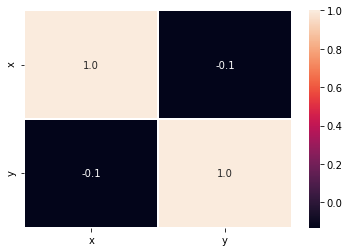

52.9


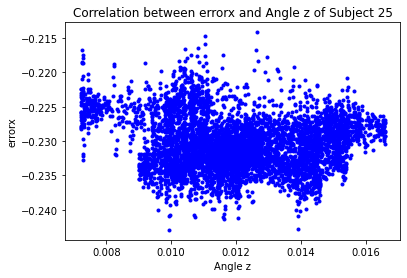

[[ 1.        -0.8333562]
 [-0.8333562  1.       ]]


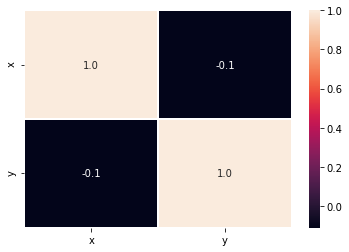

52.9


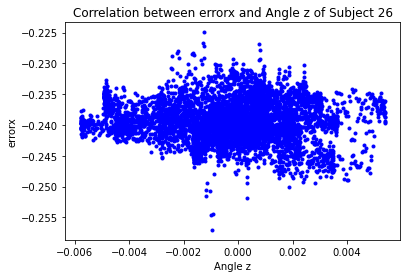

[[ 1.         -0.86498608]
 [-0.86498608  1.        ]]


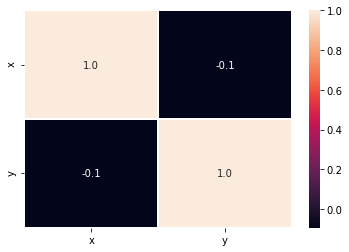

52.9


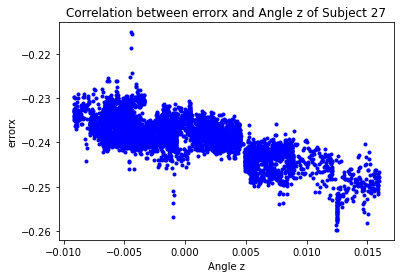

[[ 1.         -0.93338816]
 [-0.93338816  1.        ]]


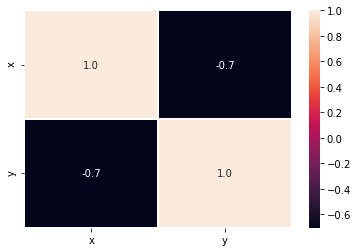

52.9


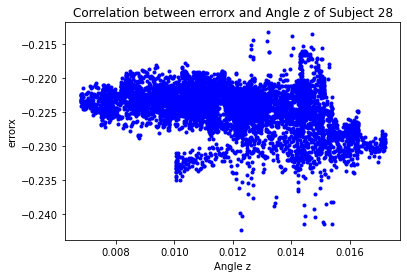

[[ 1.         -0.87768252]
 [-0.87768252  1.        ]]


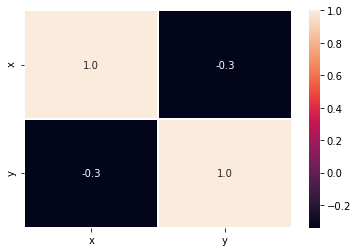

52.9


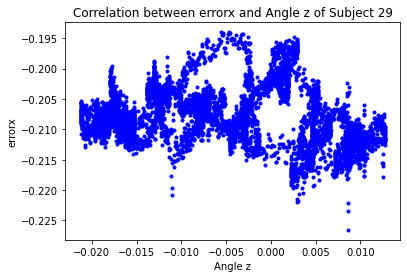

[[ 1.         -0.96060528]
 [-0.96060528  1.        ]]


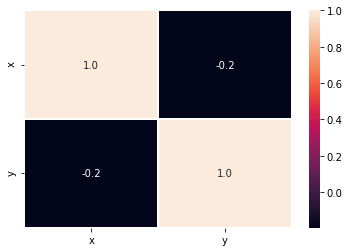

52.9


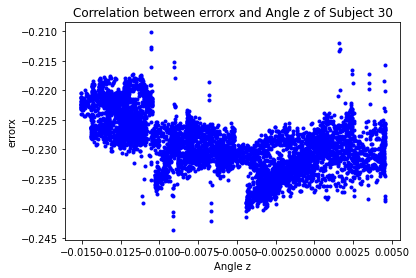

[[ 1.         -0.95104791]
 [-0.95104791  1.        ]]


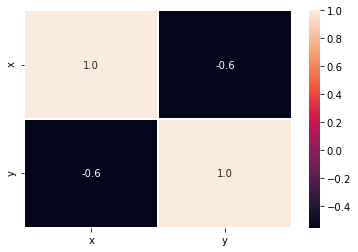

52.9


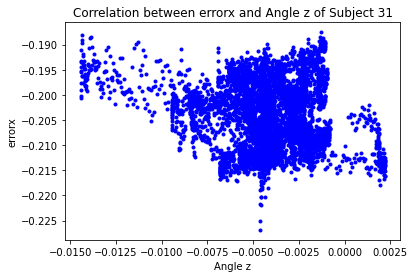

[[ 1.         -0.95281591]
 [-0.95281591  1.        ]]


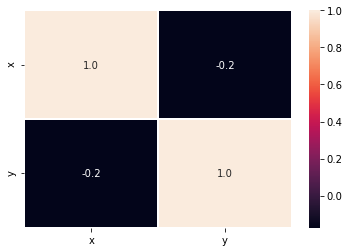

52.9


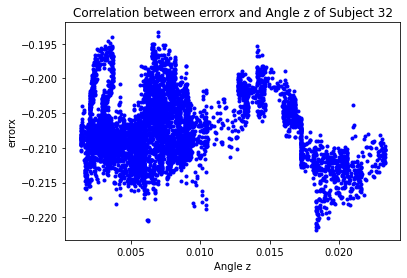

[[ 1.         -0.93460181]
 [-0.93460181  1.        ]]


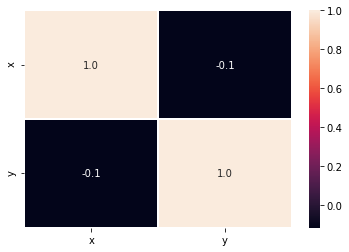

52.9


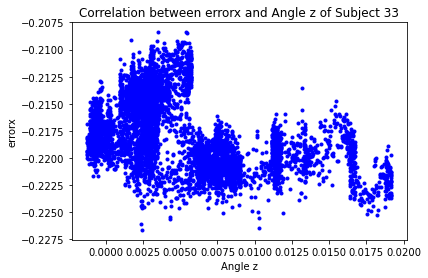

[[ 1.         -0.91452952]
 [-0.91452952  1.        ]]


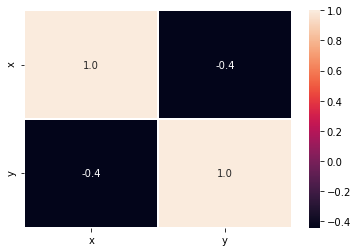

52.9


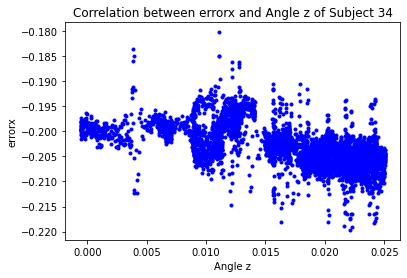

[[ 1.         -0.86122189]
 [-0.86122189  1.        ]]


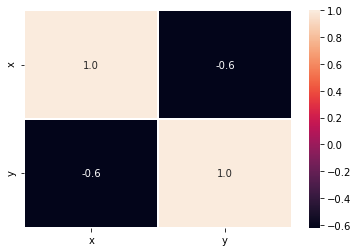

52.9


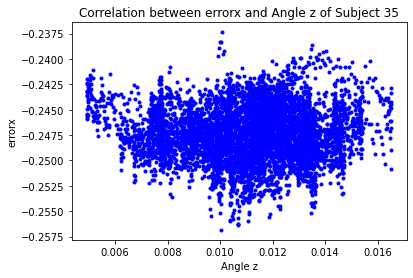

[[ 1.         -0.80603363]
 [-0.80603363  1.        ]]


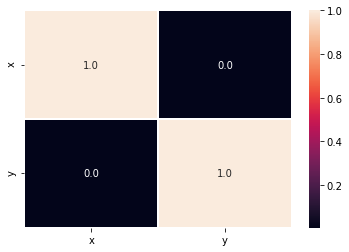

75.85


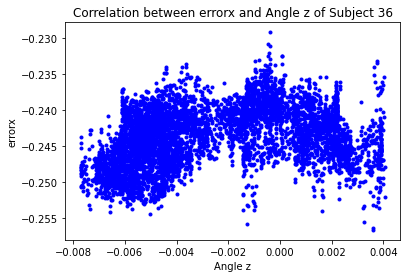

[[ 1.         -0.87441508]
 [-0.87441508  1.        ]]


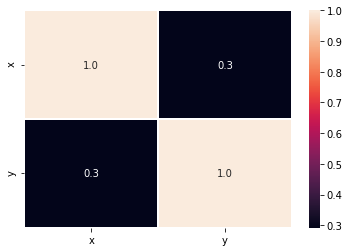

75.85


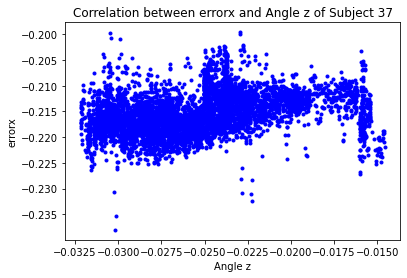

[[ 1.         -0.81105819]
 [-0.81105819  1.        ]]


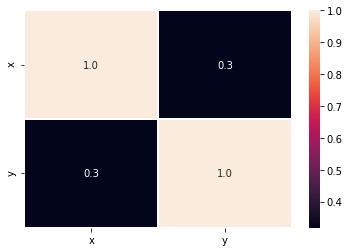

75.85


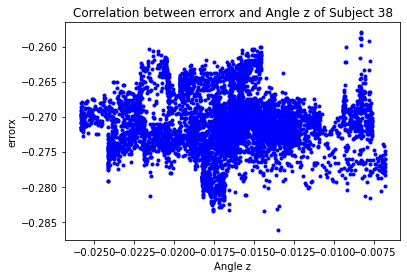

[[ 1.         -0.88956388]
 [-0.88956388  1.        ]]


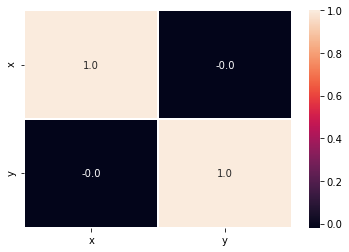

75.85


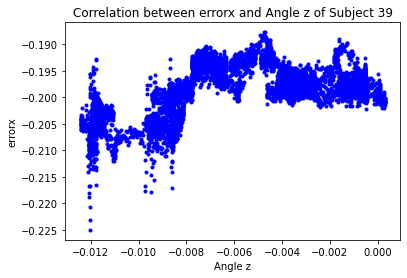

[[ 1.         -0.95032255]
 [-0.95032255  1.        ]]


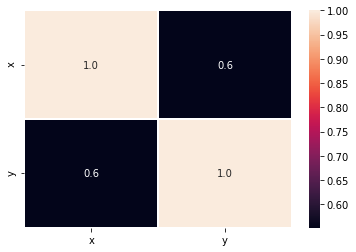

75.85


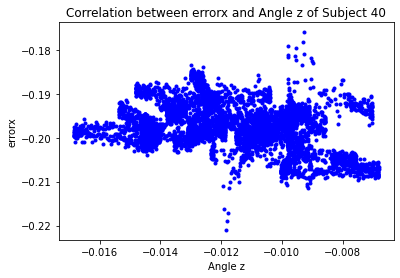

[[ 1.         -0.95277335]
 [-0.95277335  1.        ]]


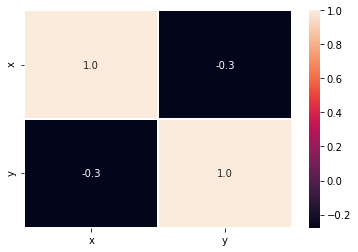

75.85


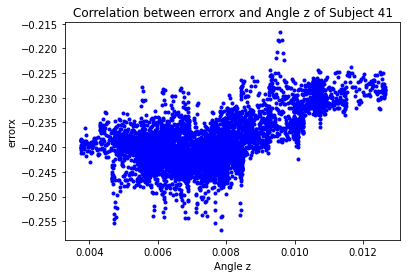

[[ 1.         -0.89857719]
 [-0.89857719  1.        ]]


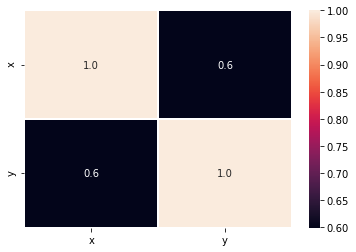

75.85


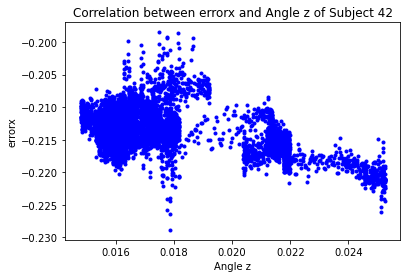

[[ 1.         -0.87364525]
 [-0.87364525  1.        ]]


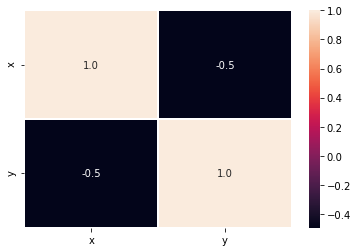

75.85


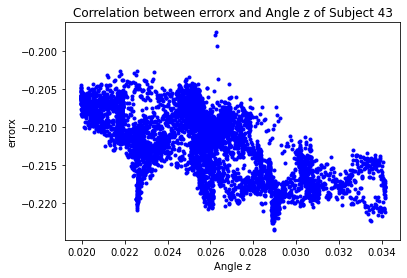

[[ 1.        -0.9634483]
 [-0.9634483  1.       ]]


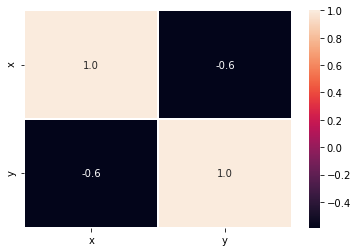

75.85


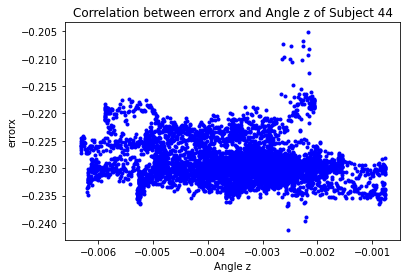

[[ 1.         -0.93099698]
 [-0.93099698  1.        ]]


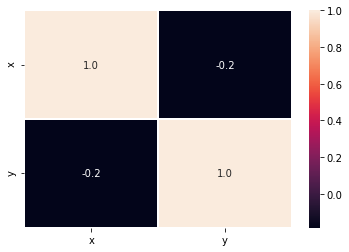

75.85


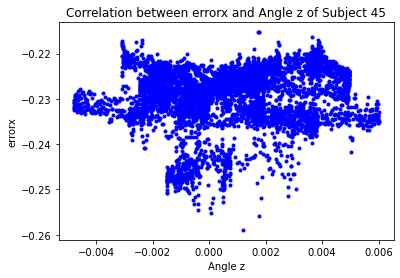

[[ 1.         -0.91846103]
 [-0.91846103  1.        ]]


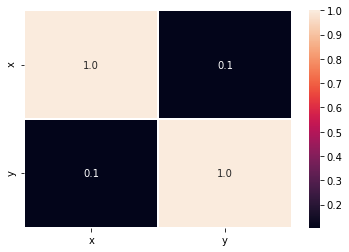

75.85


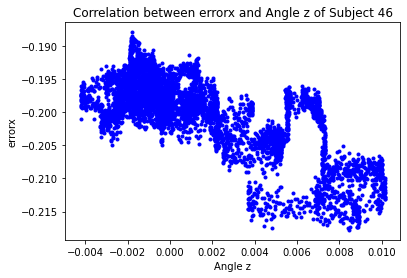

[[ 1.         -0.97676099]
 [-0.97676099  1.        ]]


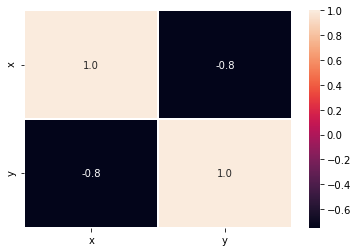

75.85


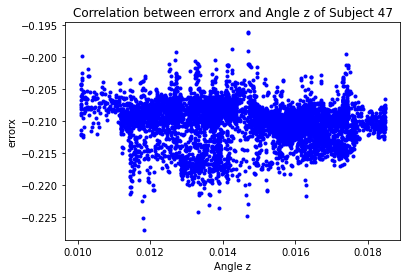

[[ 1.         -0.82015522]
 [-0.82015522  1.        ]]


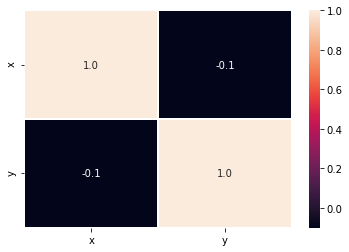

61.05


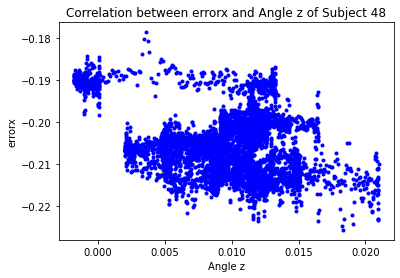

[[ 1.         -0.96252661]
 [-0.96252661  1.        ]]


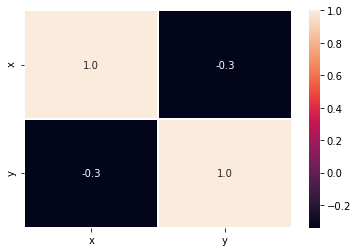

61.05


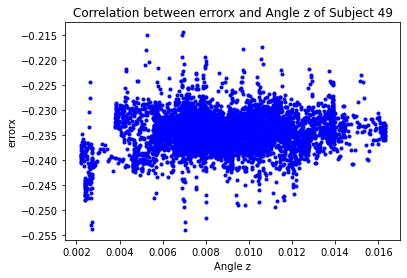

[[ 1.         -0.71906755]
 [-0.71906755  1.        ]]


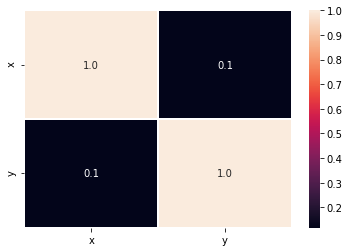

In [11]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    plt.figure()
    data={'x':matrizangz,
         'y': errorx
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Angle z")
    plt.ylabel("errorx")
    plt.title("Correlation between errorx and Angle z of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(matrizangx,errorx)
    print(r)
    plt.figure()
    data={'x':matrizangz,
          'y':errorx
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()

## Error x and sen and cos

74.3
[-0.00062795 -0.00183479  0.00101439 ...  0.00066651  0.00066671
  0.00066699]


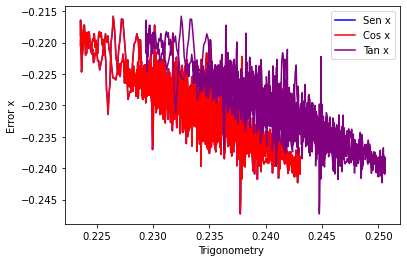

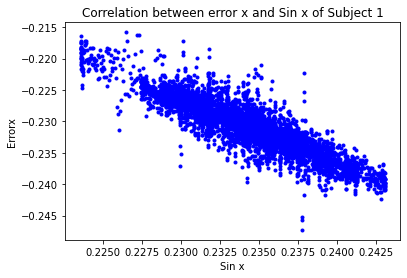

[[ 1.         -0.89492755]
 [-0.89492755  1.        ]]


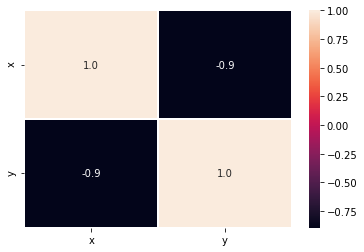

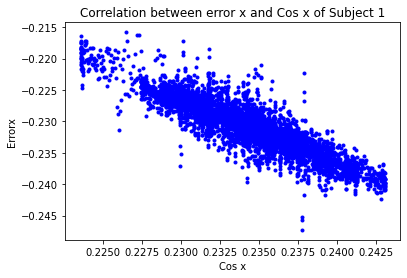

[[ 1.         -0.89492755]
 [-0.89492755  1.        ]]


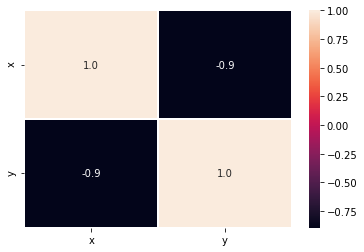

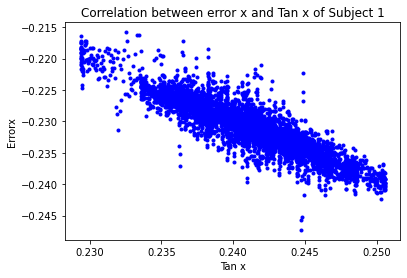

[[ 1.         -0.89495258]
 [-0.89495258  1.        ]]


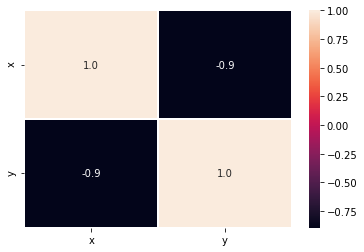

74.3
[ 0.00250586  0.00228543  0.00436475 ... -0.00020834 -0.00020832
 -0.00020829]


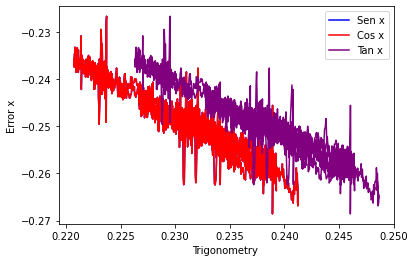

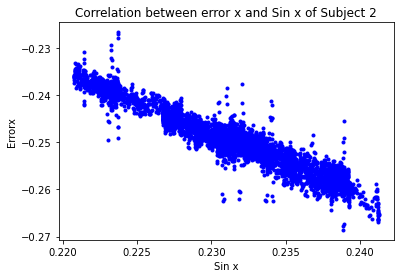

[[ 1.         -0.94737088]
 [-0.94737088  1.        ]]


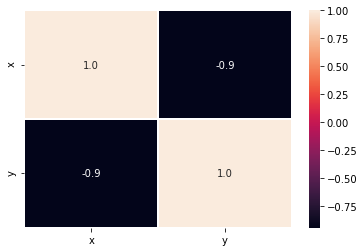

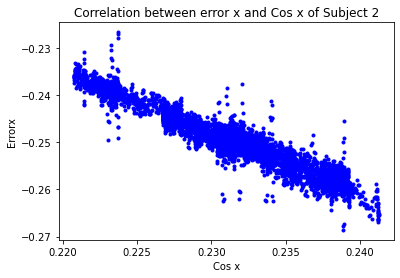

[[ 1.         -0.94737088]
 [-0.94737088  1.        ]]


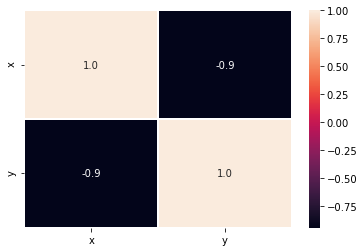

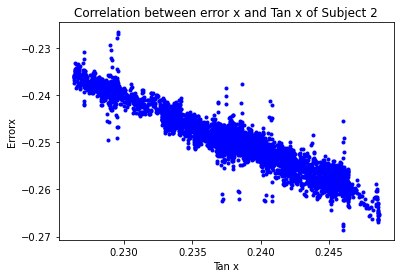

[[ 1.        -0.9473537]
 [-0.9473537  1.       ]]


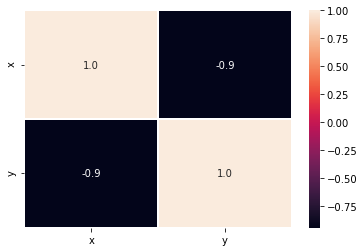

74.3
[-0.00114536  0.00023421 -0.00022916 ... -0.00162697 -0.00162677
 -0.00162653]


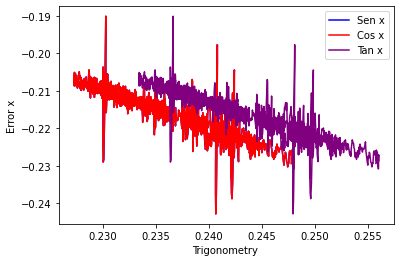

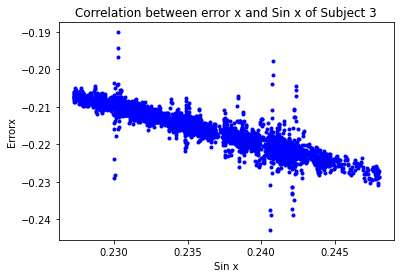

[[ 1.         -0.93871445]
 [-0.93871445  1.        ]]


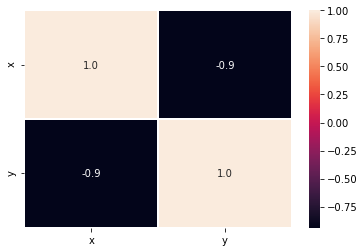

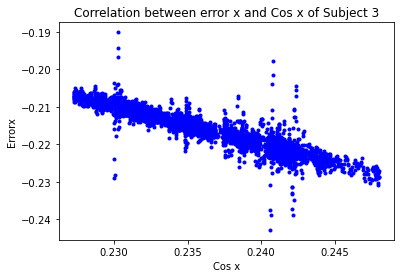

[[ 1.         -0.93871445]
 [-0.93871445  1.        ]]


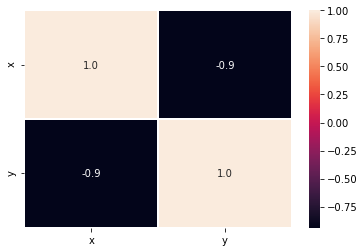

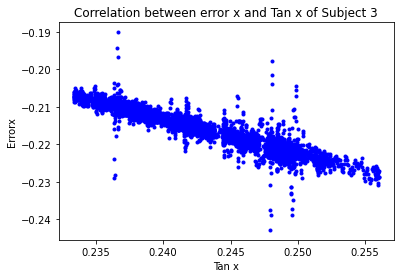

[[ 1.         -0.93870854]
 [-0.93870854  1.        ]]


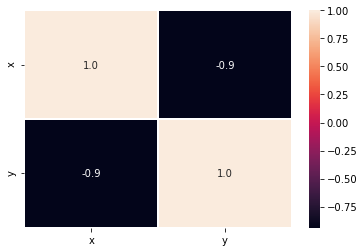

74.3
[ 0.00053299 -0.0008076  -0.00013609 ... -0.00062584 -0.00062579
 -0.00062574]


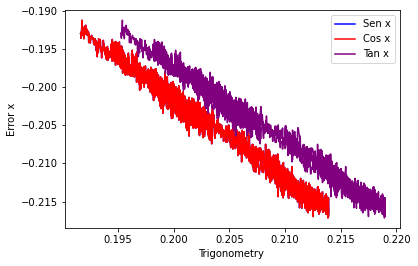

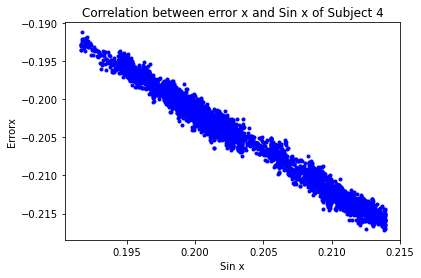

[[ 1.         -0.99025617]
 [-0.99025617  1.        ]]


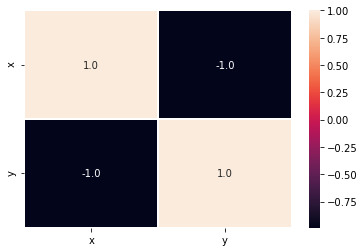

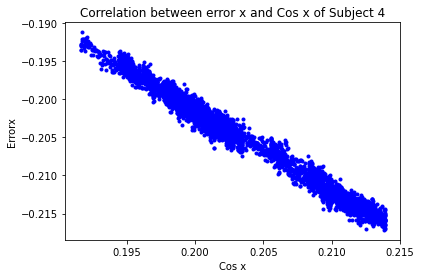

[[ 1.         -0.99025617]
 [-0.99025617  1.        ]]


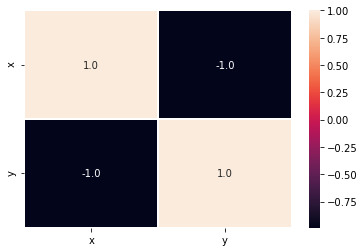

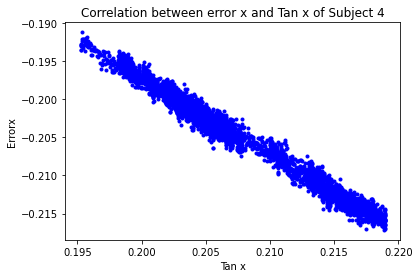

[[ 1.         -0.99022764]
 [-0.99022764  1.        ]]


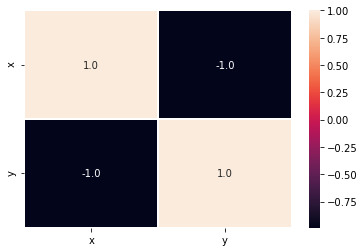

74.3
[-8.41091400e-04  1.24201421e-03  3.49235426e-03 ...  2.52872664e-06
  2.52844447e-06  2.52807104e-06]


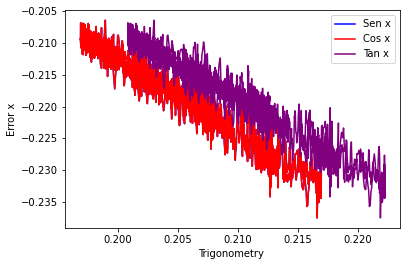

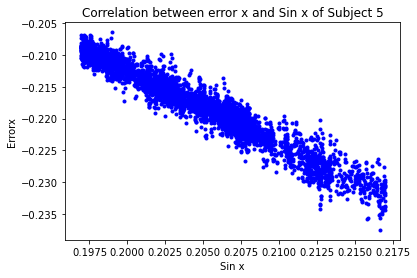

[[ 1.         -0.96753715]
 [-0.96753715  1.        ]]


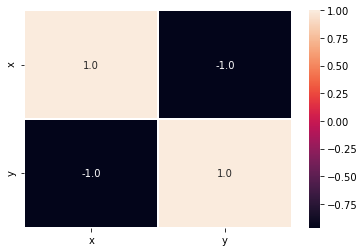

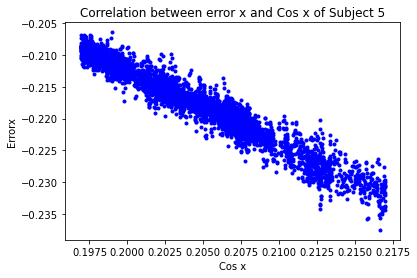

[[ 1.         -0.96753715]
 [-0.96753715  1.        ]]


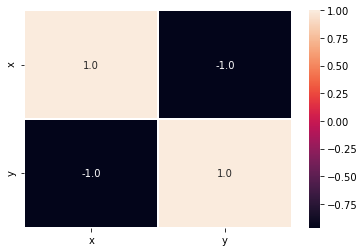

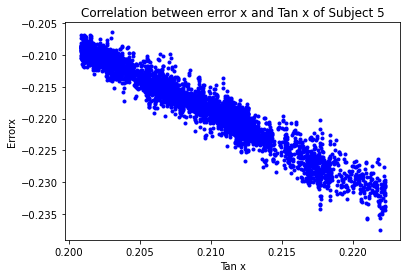

[[ 1.         -0.96757937]
 [-0.96757937  1.        ]]


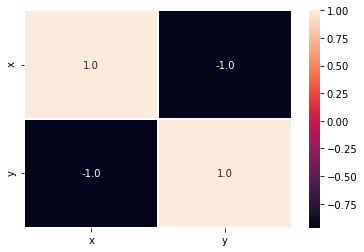

74.3
[ 0.00020194  0.00162995  0.00040663 ... -0.00056806 -0.00056801
 -0.00056795]


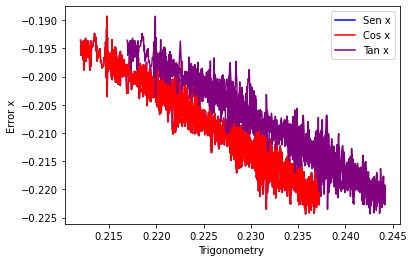

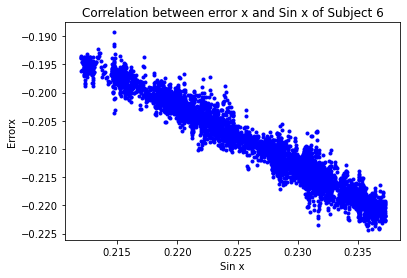

[[ 1.        -0.9758951]
 [-0.9758951  1.       ]]


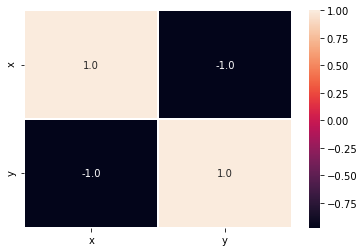

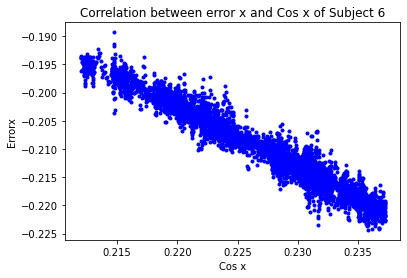

[[ 1.        -0.9758951]
 [-0.9758951  1.       ]]


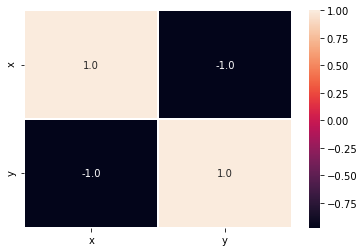

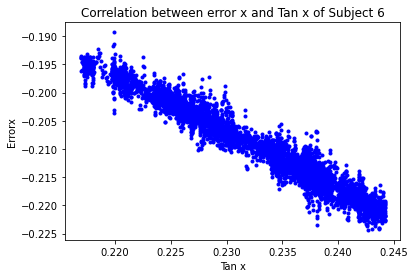

[[ 1.       -0.975966]
 [-0.975966  1.      ]]


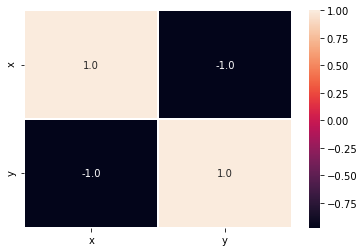

74.3
[ 0.00042813  0.002284    0.00165237 ... -0.00125035 -0.00125038
 -0.00125042]


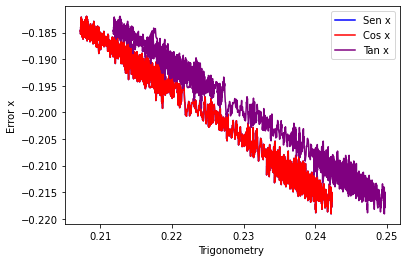

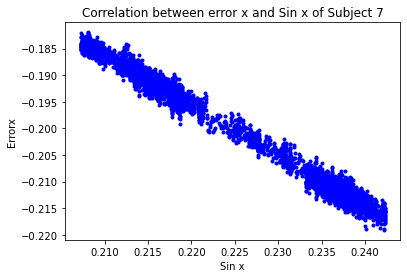

[[ 1.         -0.99381921]
 [-0.99381921  1.        ]]


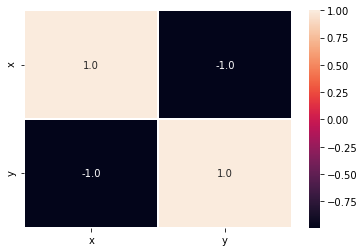

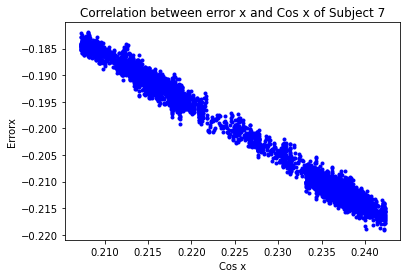

[[ 1.         -0.99381921]
 [-0.99381921  1.        ]]


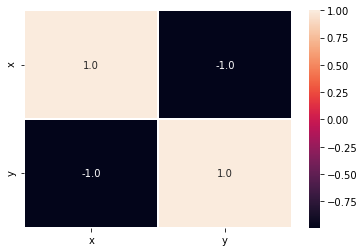

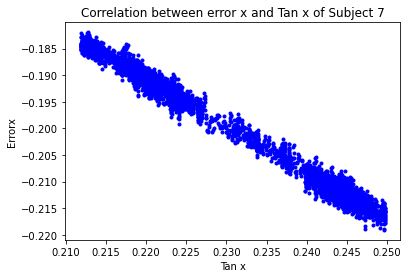

[[ 1.         -0.99381463]
 [-0.99381463  1.        ]]


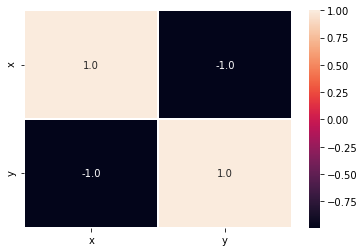

74.3
[ 2.85924872e-04  2.20309765e-07 -1.40623847e-04 ...  6.79396742e-04
  6.79389463e-04  6.79374813e-04]


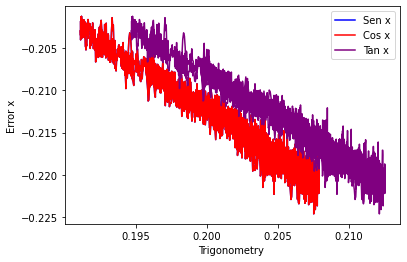

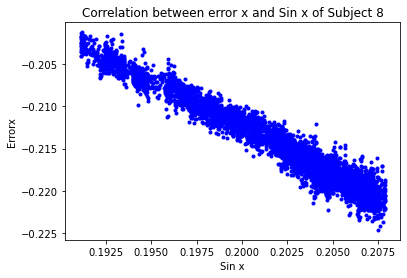

[[ 1.         -0.97576258]
 [-0.97576258  1.        ]]


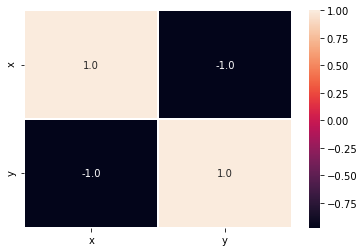

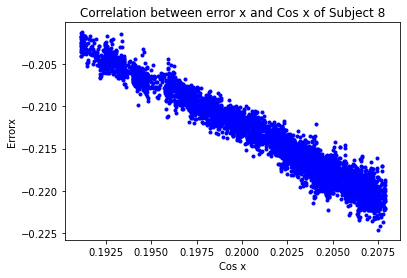

[[ 1.         -0.97576258]
 [-0.97576258  1.        ]]


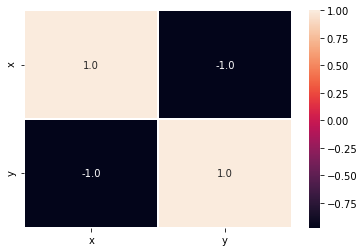

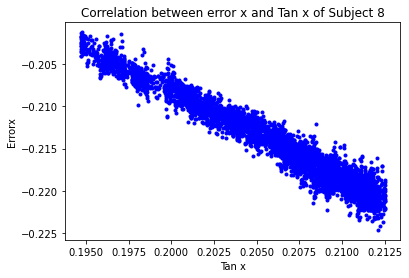

[[ 1.         -0.97579061]
 [-0.97579061  1.        ]]


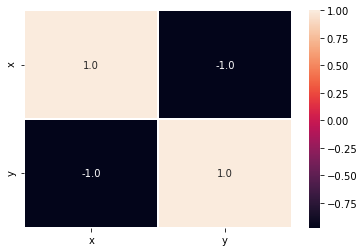

74.3
[-9.94463860e-04 -8.05185257e-04  8.43084681e-07 ...  8.34291748e-04
  8.34275595e-04  8.34246105e-04]


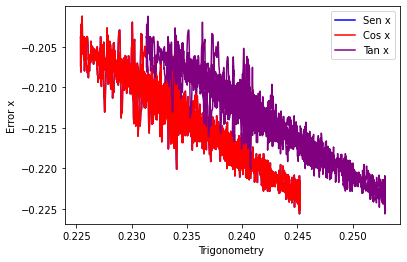

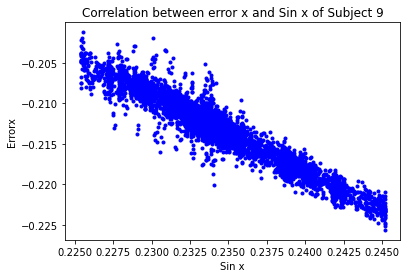

[[ 1.        -0.9587482]
 [-0.9587482  1.       ]]


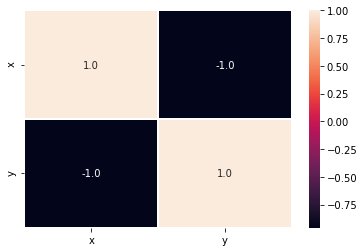

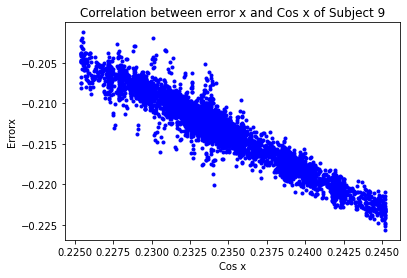

[[ 1.        -0.9587482]
 [-0.9587482  1.       ]]


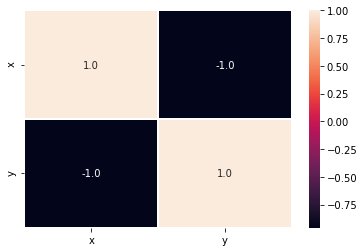

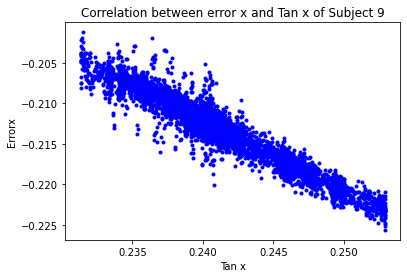

[[ 1.        -0.9587628]
 [-0.9587628  1.       ]]


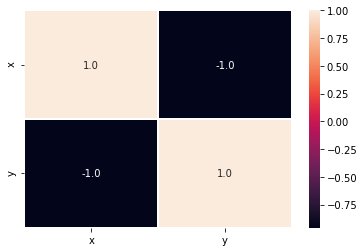

74.3
[-4.86232280e-06  7.03859861e-04  6.96670113e-04 ... -2.48830933e-04
 -2.48851854e-04 -2.48881818e-04]


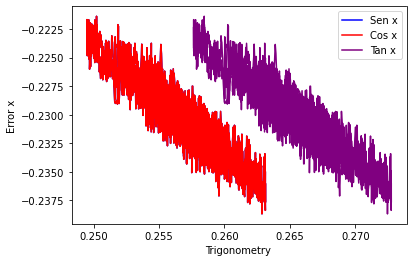

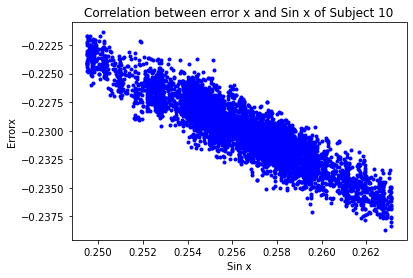

[[ 1.        -0.9129518]
 [-0.9129518  1.       ]]


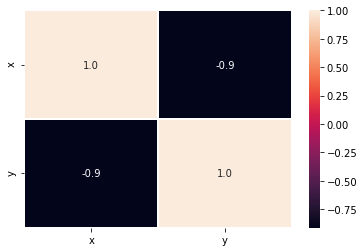

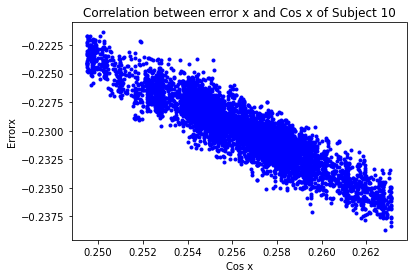

[[ 1.        -0.9129518]
 [-0.9129518  1.       ]]


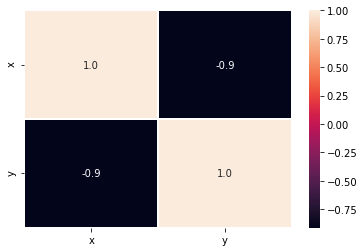

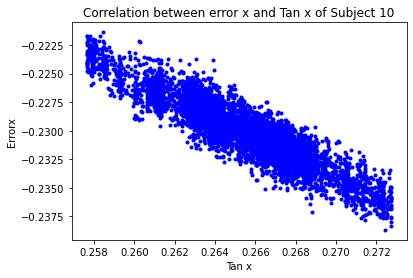

[[ 1.         -0.91295638]
 [-0.91295638  1.        ]]


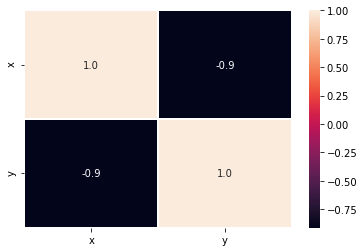

74.3
[ 0.00043958  0.00587328  0.00570288 ... -0.00068528 -0.00068542
 -0.00068562]


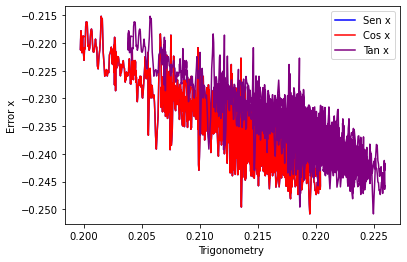

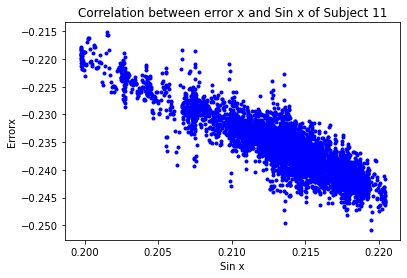

[[ 1.         -0.89215496]
 [-0.89215496  1.        ]]


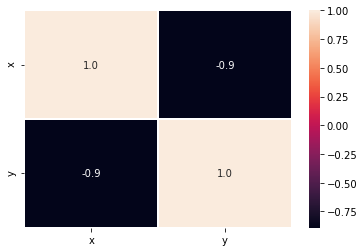

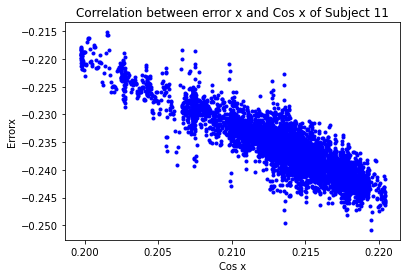

[[ 1.         -0.89215496]
 [-0.89215496  1.        ]]


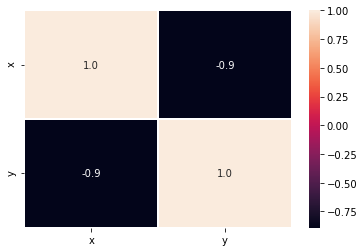

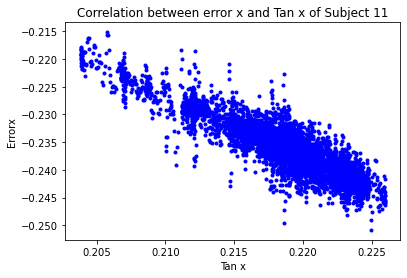

[[ 1.        -0.8921595]
 [-0.8921595  1.       ]]


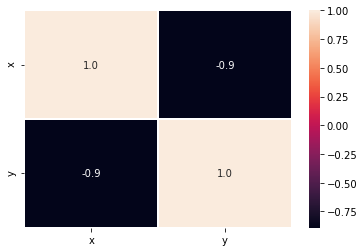

126.3
[-1.57732491e-06  9.04061315e-04  1.13748604e-03 ... -2.04883131e-04
 -2.04841728e-04 -2.04784523e-04]


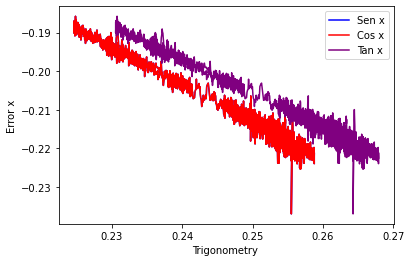

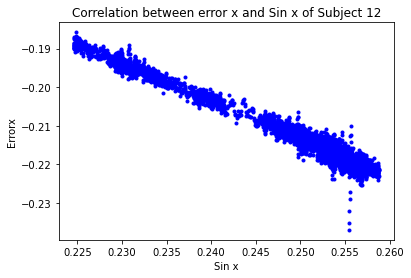

[[ 1.         -0.98793567]
 [-0.98793567  1.        ]]


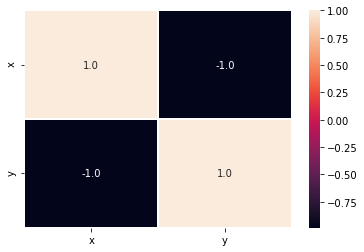

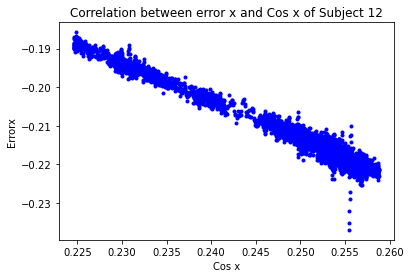

[[ 1.         -0.98793567]
 [-0.98793567  1.        ]]


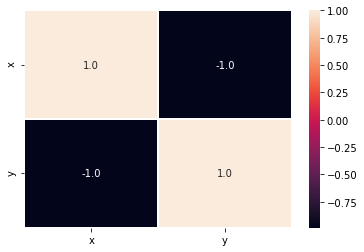

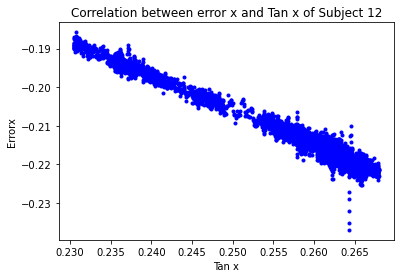

[[ 1.         -0.98799908]
 [-0.98799908  1.        ]]


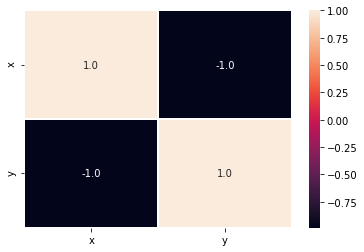

126.3
[ 9.31819792e-07 -1.18878976e-03  6.22089316e-04 ...  9.90683862e-04
  9.90626557e-04  9.90535387e-04]


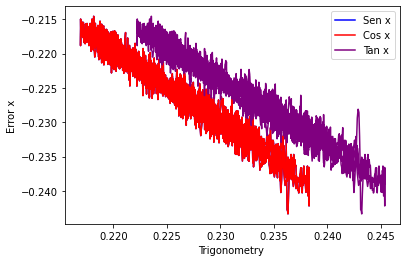

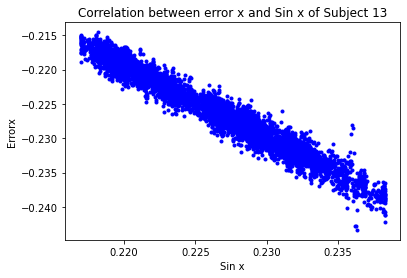

[[ 1.        -0.9759712]
 [-0.9759712  1.       ]]


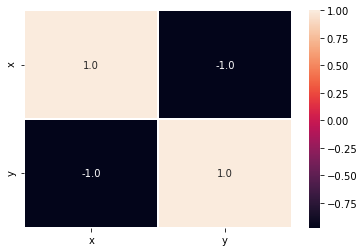

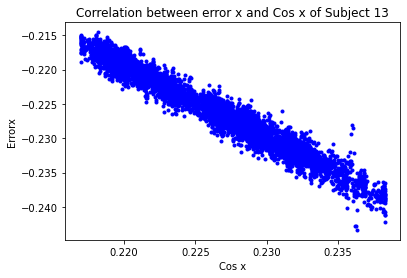

[[ 1.        -0.9759712]
 [-0.9759712  1.       ]]


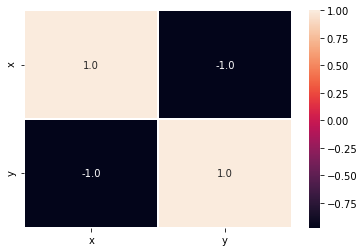

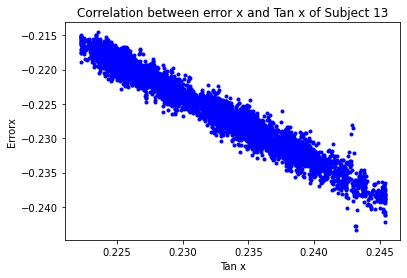

[[ 1.        -0.9759878]
 [-0.9759878  1.       ]]


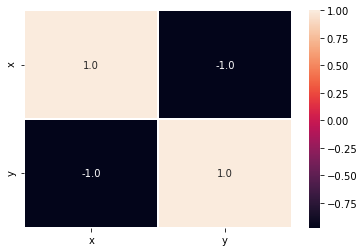

126.3
[0.00200588 0.00143426 0.00162029 ... 0.00074051 0.00074047 0.00074042]


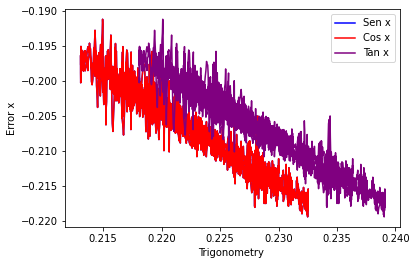

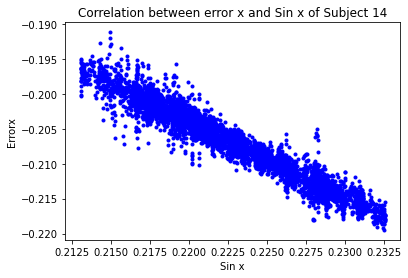

[[ 1.         -0.96689381]
 [-0.96689381  1.        ]]


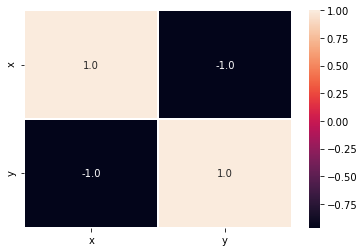

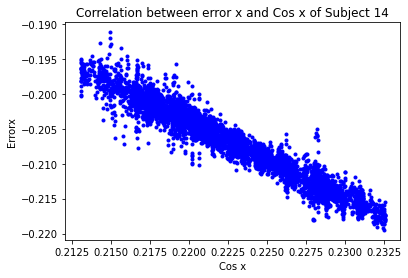

[[ 1.         -0.96689381]
 [-0.96689381  1.        ]]


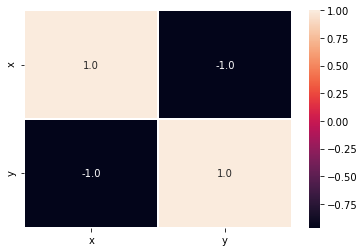

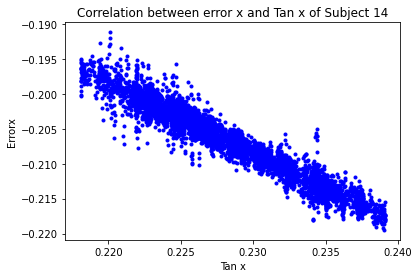

[[ 1.         -0.96689793]
 [-0.96689793  1.        ]]


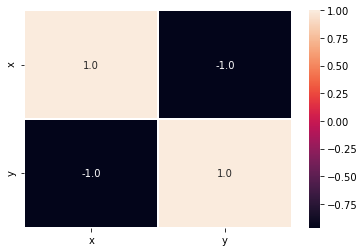

126.3
[-2.26522963e-04 -1.65036030e-04  2.25142887e-03 ...  2.77190723e-08
  2.77198876e-08  2.77208353e-08]


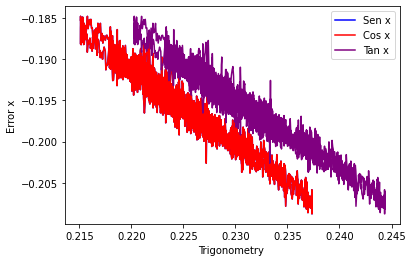

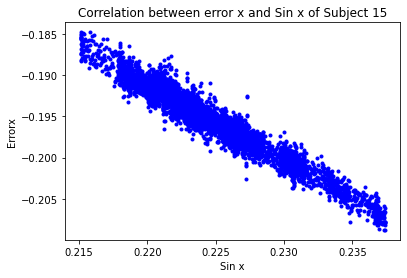

[[ 1.         -0.97262653]
 [-0.97262653  1.        ]]


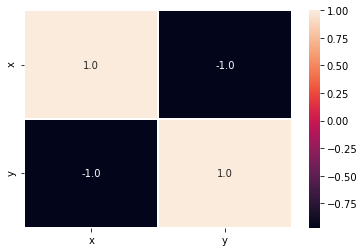

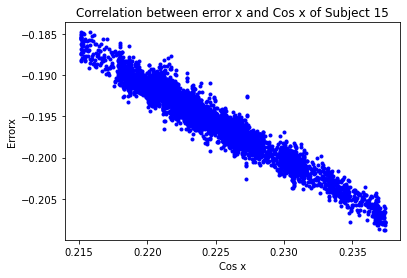

[[ 1.         -0.97262653]
 [-0.97262653  1.        ]]


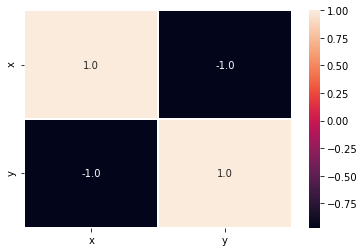

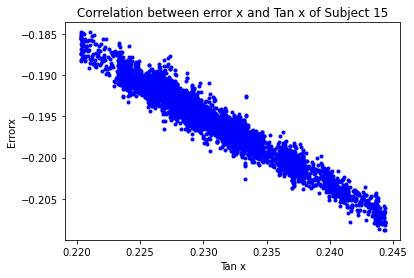

[[ 1.         -0.97261073]
 [-0.97261073  1.        ]]


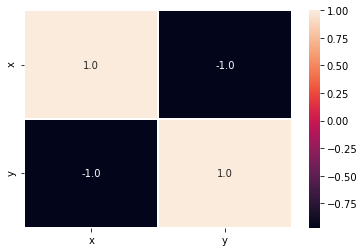

126.3
[-2.33845776e-04 -2.32789918e-04 -2.33842259e-04 ...  4.03384392e-06
  4.03347395e-06  4.03296088e-06]


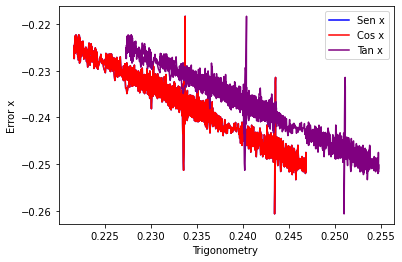

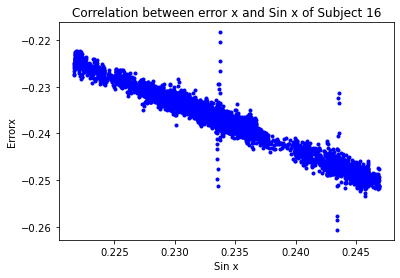

[[ 1.         -0.97778803]
 [-0.97778803  1.        ]]


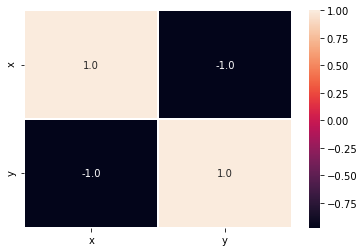

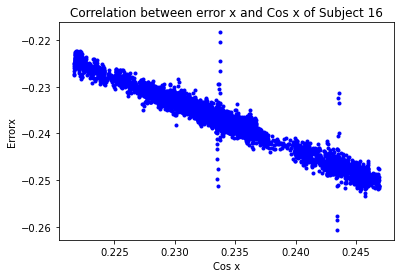

[[ 1.         -0.97778803]
 [-0.97778803  1.        ]]


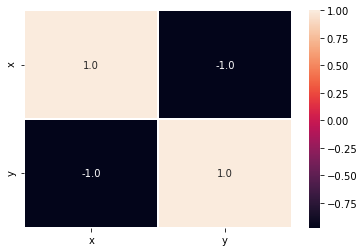

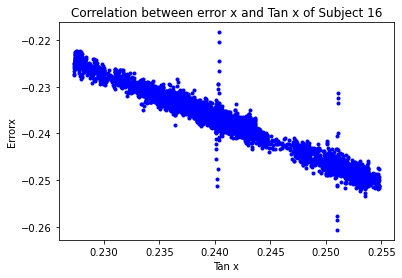

[[ 1.         -0.97779518]
 [-0.97779518  1.        ]]


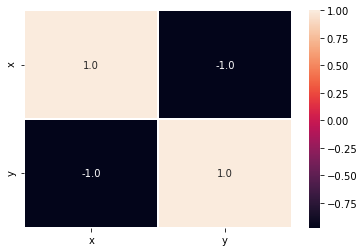

126.3
[ 3.38936963e-06  1.51466815e-04 -6.95949657e-04 ... -4.86398730e-04
 -4.86534091e-04 -4.86716271e-04]


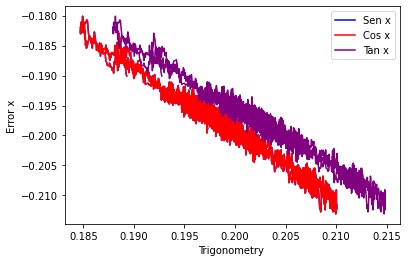

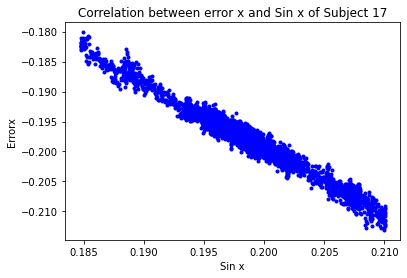

[[ 1.         -0.98204449]
 [-0.98204449  1.        ]]


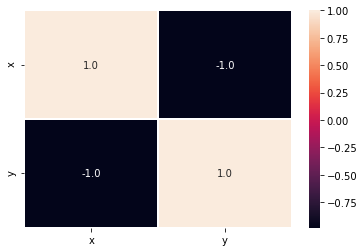

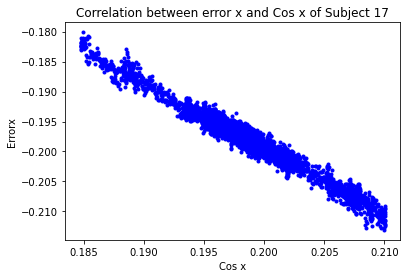

[[ 1.         -0.98204449]
 [-0.98204449  1.        ]]


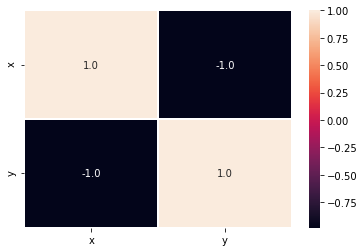

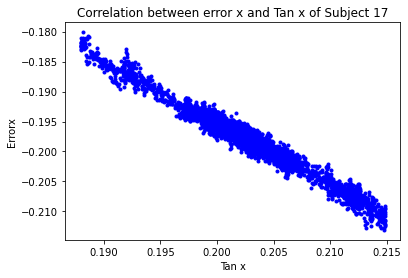

[[ 1.         -0.98204936]
 [-0.98204936  1.        ]]


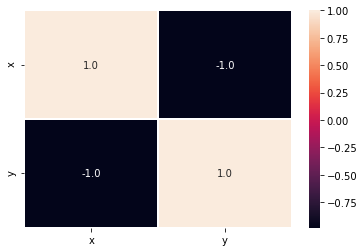

126.3
[ 0.00111058  0.00088068  0.00112563 ... -0.00086259 -0.00086261
 -0.00086264]


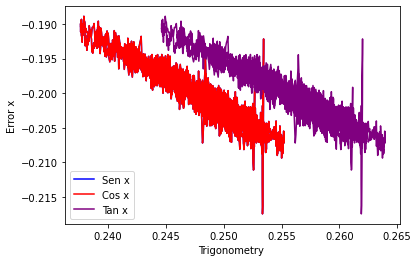

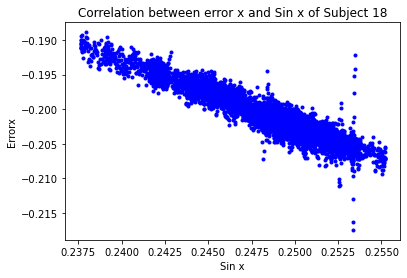

[[ 1.         -0.94143846]
 [-0.94143846  1.        ]]


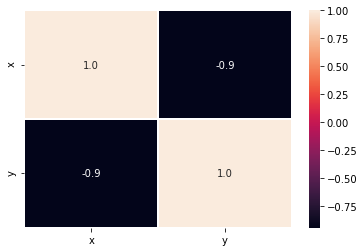

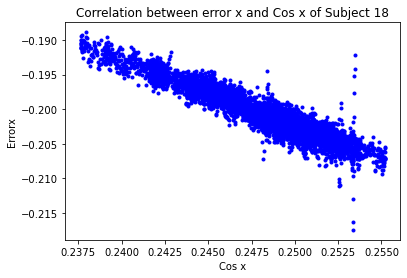

[[ 1.         -0.94143846]
 [-0.94143846  1.        ]]


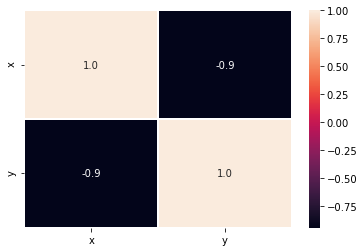

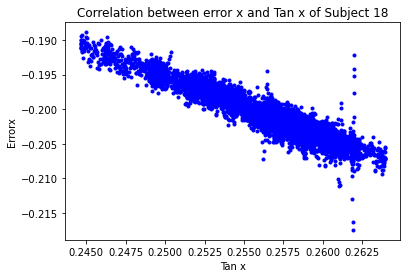

[[ 1.         -0.94144087]
 [-0.94144087  1.        ]]


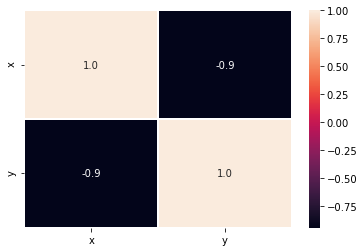

126.3
[ 0.00251436  0.00224008  0.00421654 ... -0.00039767 -0.00039775
 -0.00039786]


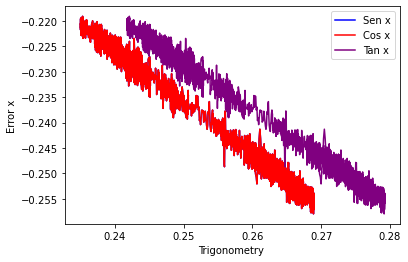

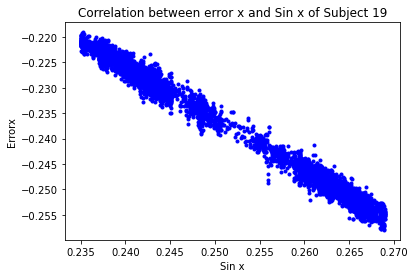

[[ 1.        -0.9934841]
 [-0.9934841  1.       ]]


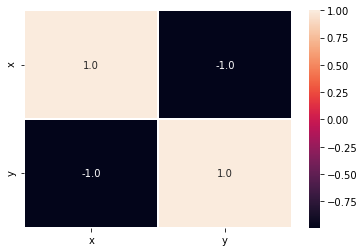

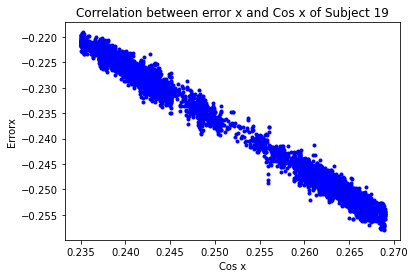

[[ 1.        -0.9934841]
 [-0.9934841  1.       ]]


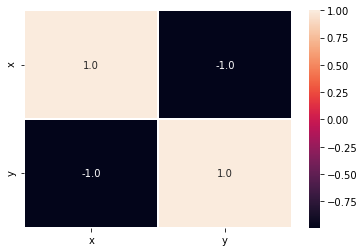

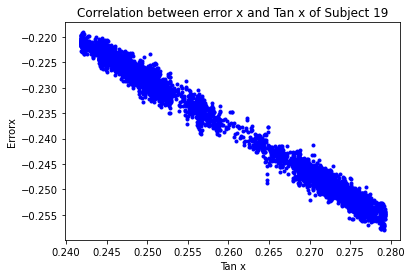

[[ 1.         -0.99348574]
 [-0.99348574  1.        ]]


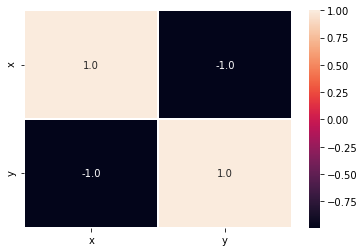

126.3
[-0.00114876 -0.00068501 -0.00022313 ...  0.00021031  0.0002103
  0.00021028]


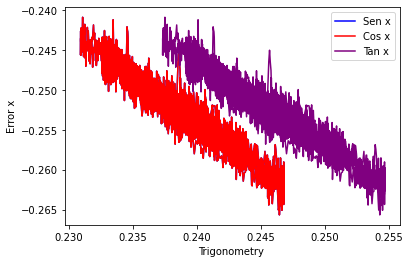

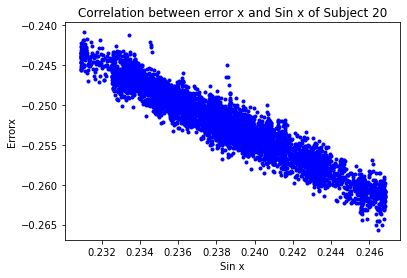

[[ 1.       -0.954912]
 [-0.954912  1.      ]]


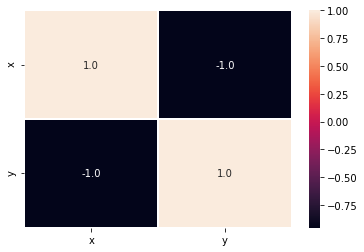

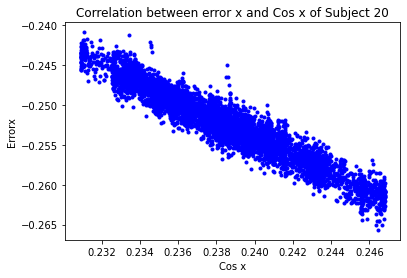

[[ 1.       -0.954912]
 [-0.954912  1.      ]]


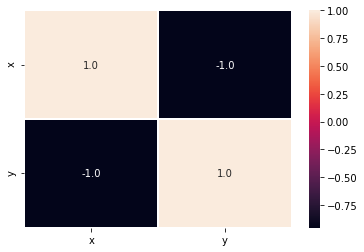

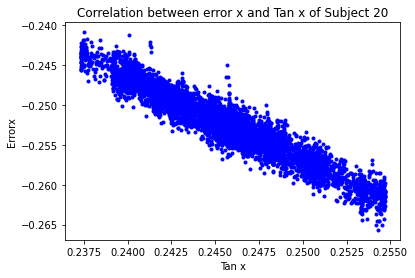

[[ 1.       -0.954899]
 [-0.954899  1.      ]]


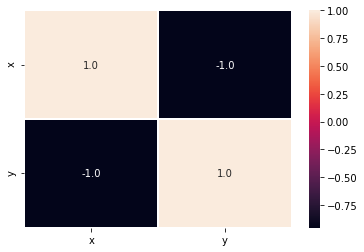

126.3
[ 0.00015677  0.00087944  0.00144457 ... -0.0002993  -0.00029929
 -0.00029928]


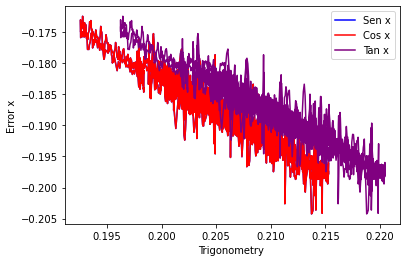

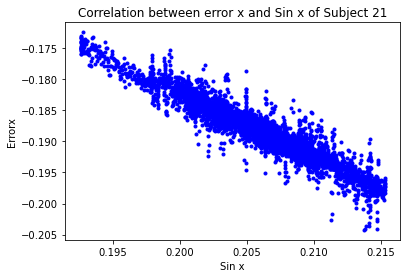

[[ 1.         -0.94755205]
 [-0.94755205  1.        ]]


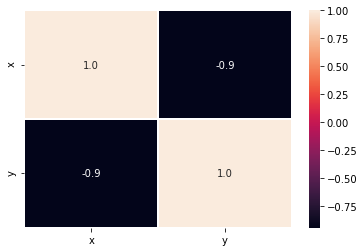

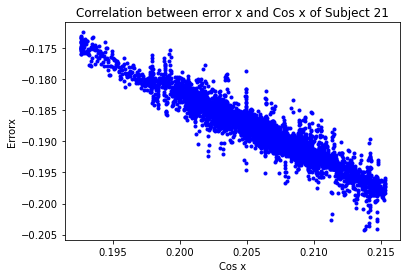

[[ 1.         -0.94755205]
 [-0.94755205  1.        ]]


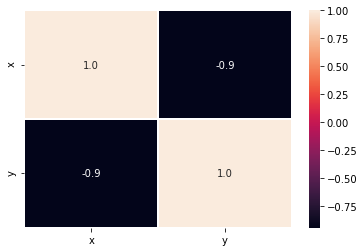

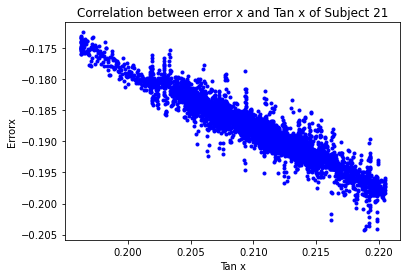

[[ 1.         -0.94755434]
 [-0.94755434  1.        ]]


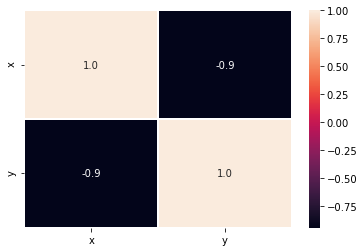

126.3
[ 2.02365423e-03  8.97753611e-04  2.02382804e-03 ... -2.98725578e-06
 -2.98778049e-06 -2.98870067e-06]


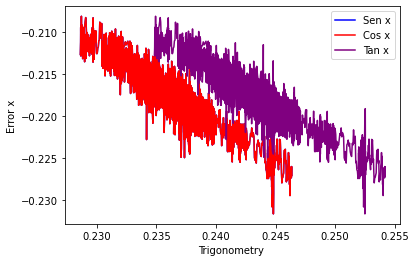

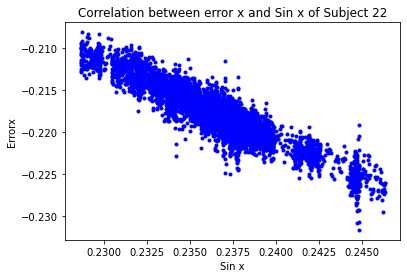

[[ 1.         -0.92278509]
 [-0.92278509  1.        ]]


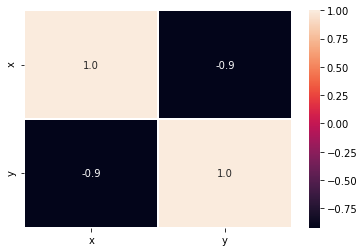

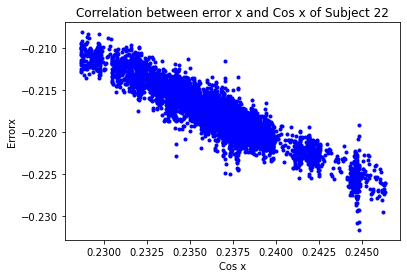

[[ 1.         -0.92278509]
 [-0.92278509  1.        ]]


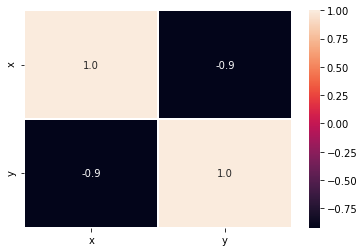

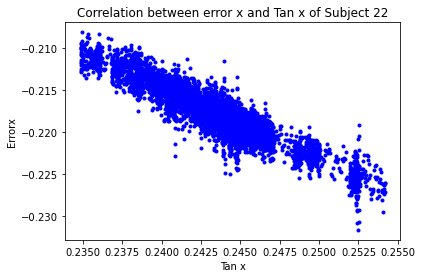

[[ 1.         -0.92272665]
 [-0.92272665  1.        ]]


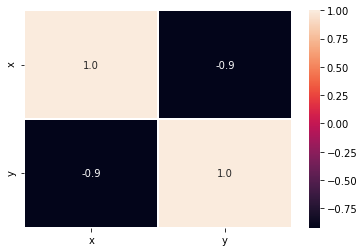

126.3
[-0.00142235 -0.00099119 -0.00142234 ...  0.00078366  0.00078364
  0.0007836 ]


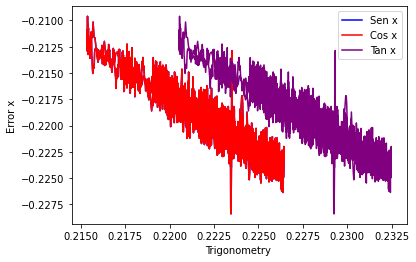

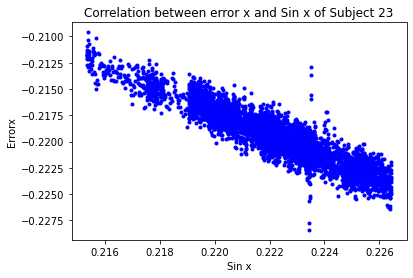

[[ 1.        -0.9253439]
 [-0.9253439  1.       ]]


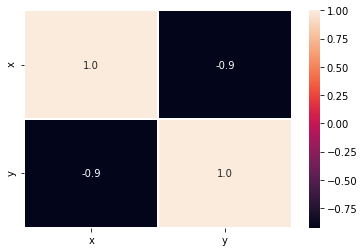

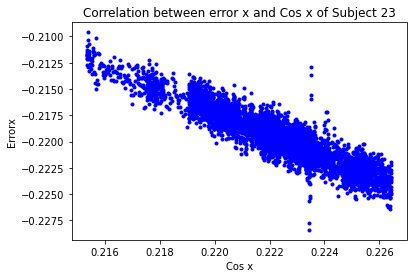

[[ 1.        -0.9253439]
 [-0.9253439  1.       ]]


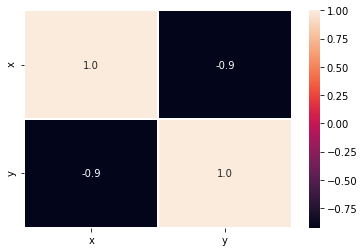

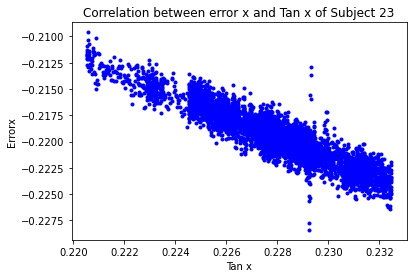

[[ 1.         -0.92533917]
 [-0.92533917  1.        ]]


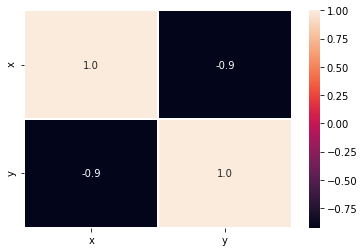

52.9
[0.00037378 0.00178077 0.00196912 ... 0.00041847 0.00041832 0.00041811]


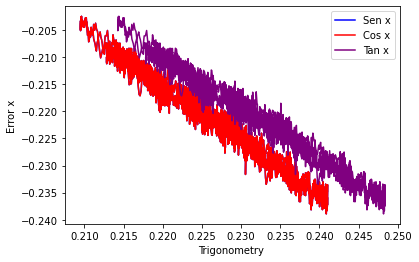

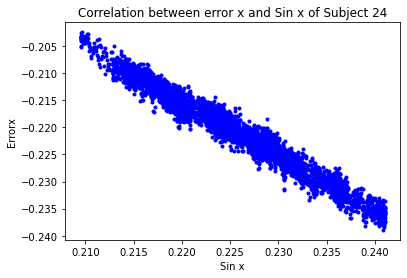

[[ 1.         -0.98100425]
 [-0.98100425  1.        ]]


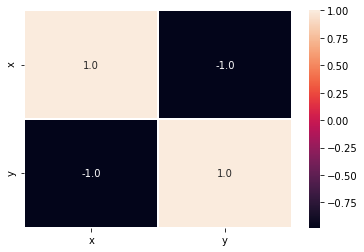

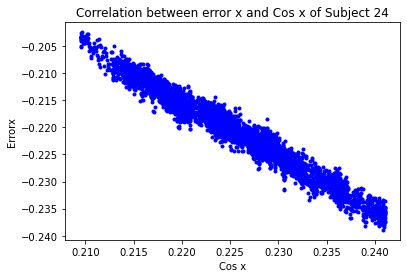

[[ 1.         -0.98100425]
 [-0.98100425  1.        ]]


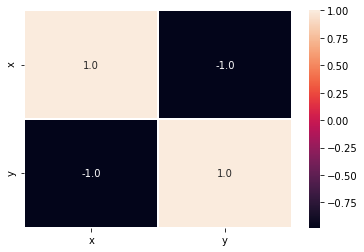

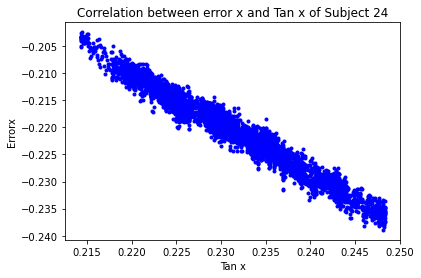

[[ 1.         -0.98104437]
 [-0.98104437  1.        ]]


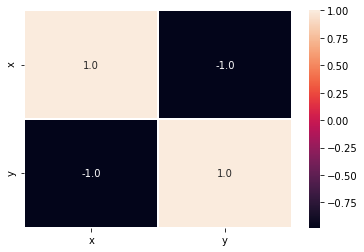

52.9
[2.20048971e-03 3.16095813e-03 2.90296228e-03 ... 2.76927244e-08
 2.76928517e-08 2.76930553e-08]


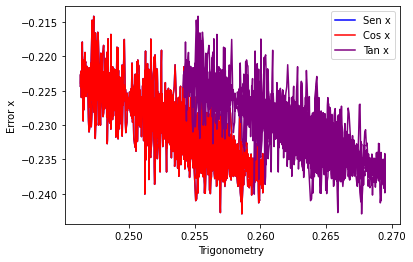

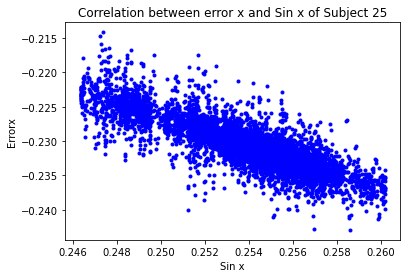

[[ 1.         -0.83335422]
 [-0.83335422  1.        ]]


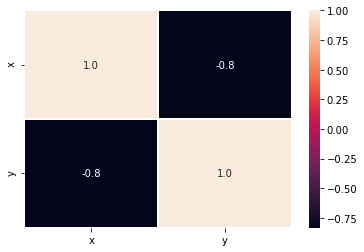

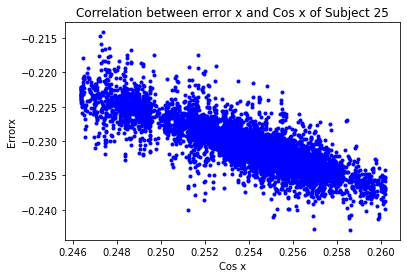

[[ 1.         -0.83335422]
 [-0.83335422  1.        ]]


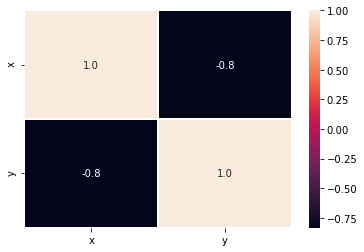

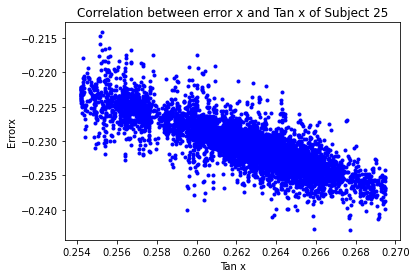

[[ 1.         -0.83335956]
 [-0.83335956  1.        ]]


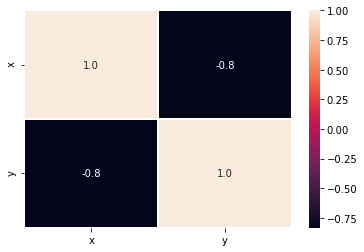

52.9
[0.00262089 0.00111268 0.00370495 ... 0.00123841 0.00123839 0.00123836]


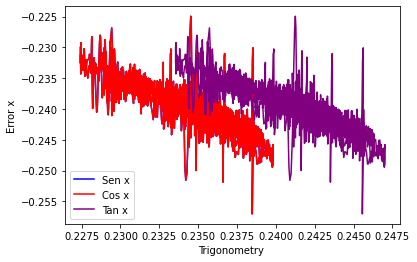

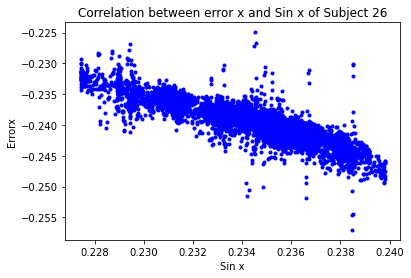

[[ 1.         -0.86495507]
 [-0.86495507  1.        ]]


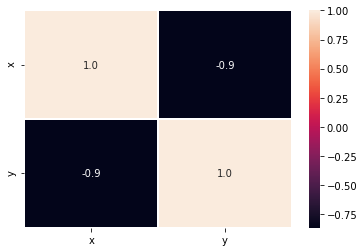

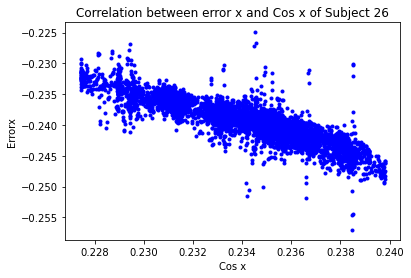

[[ 1.         -0.86495507]
 [-0.86495507  1.        ]]


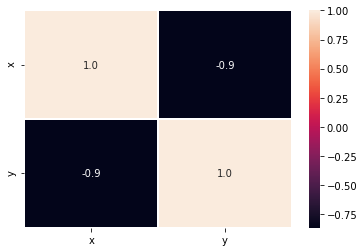

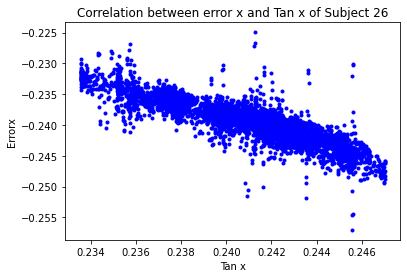

[[ 1.         -0.86504775]
 [-0.86504775  1.        ]]


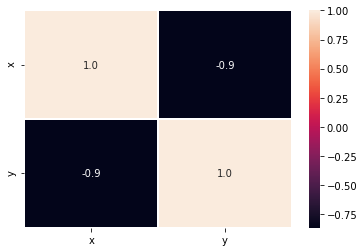

52.9
[ 0.00103392 -0.00028314  0.00205582 ...  0.00023084  0.00023085
  0.00023087]


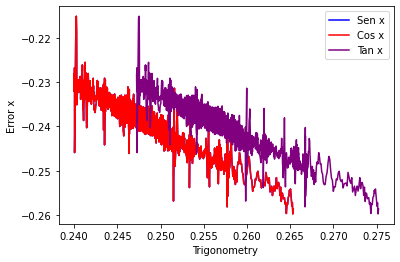

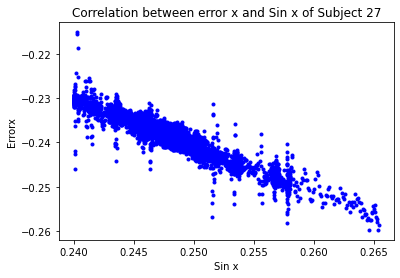

[[ 1.         -0.93338252]
 [-0.93338252  1.        ]]


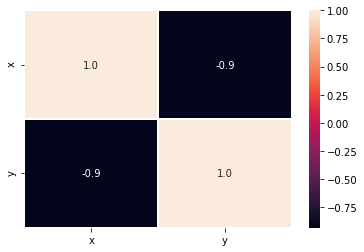

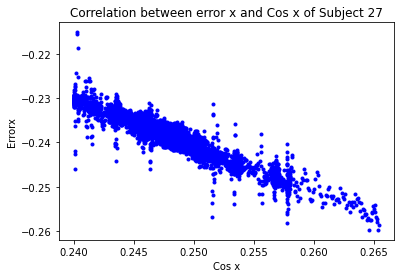

[[ 1.         -0.93338252]
 [-0.93338252  1.        ]]


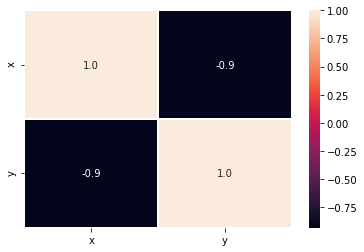

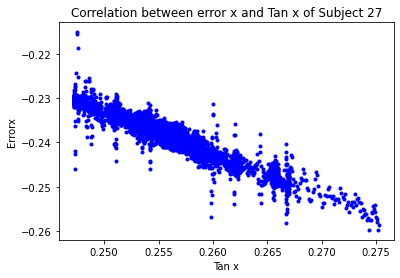

[[ 1.         -0.93339673]
 [-0.93339673  1.        ]]


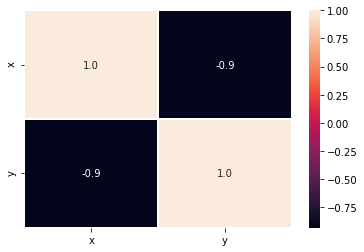

52.9
[-0.00130157 -0.00130383 -0.00161987 ...  0.00070539  0.00070535
  0.00070529]


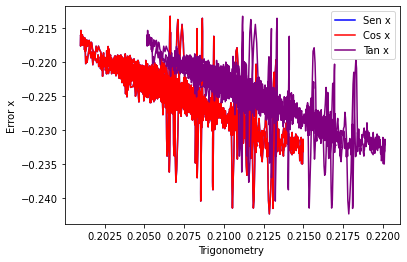

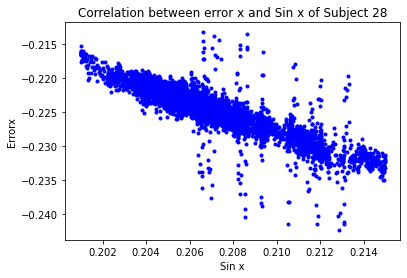

[[ 1.         -0.87769153]
 [-0.87769153  1.        ]]


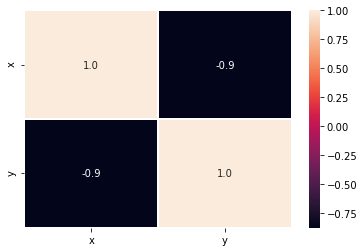

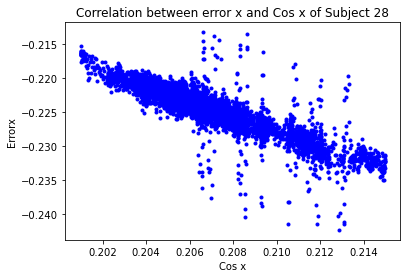

[[ 1.         -0.87769153]
 [-0.87769153  1.        ]]


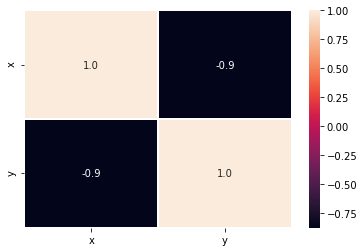

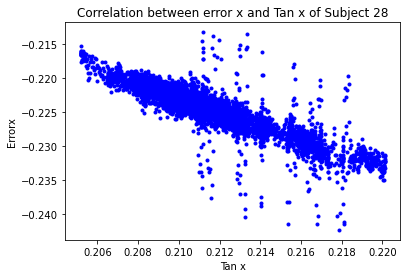

[[ 1.        -0.8776641]
 [-0.8776641  1.       ]]


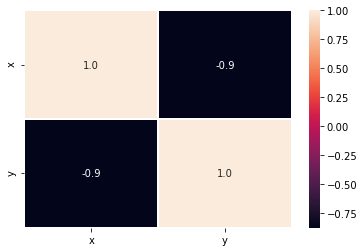

52.9
[ 0.00080459  0.00080411  0.00080364 ... -0.00152081 -0.00152133
 -0.00152207]


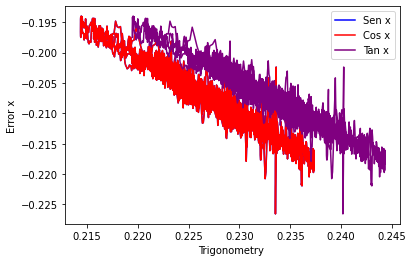

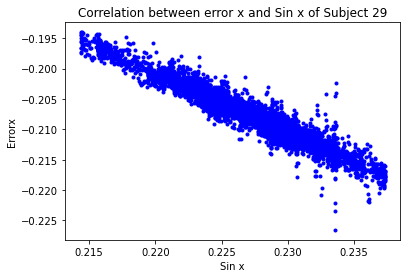

[[ 1.         -0.96060473]
 [-0.96060473  1.        ]]


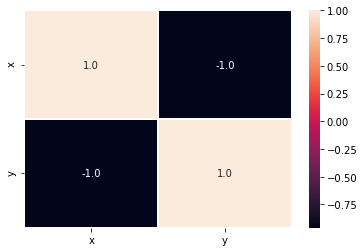

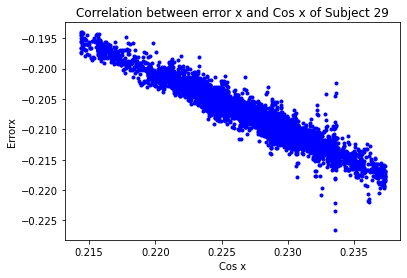

[[ 1.         -0.96060473]
 [-0.96060473  1.        ]]


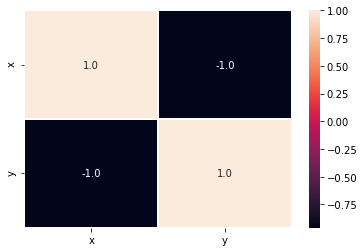

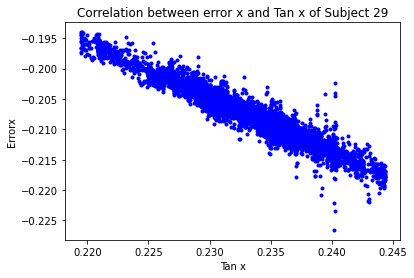

[[ 1.         -0.96060479]
 [-0.96060479  1.        ]]


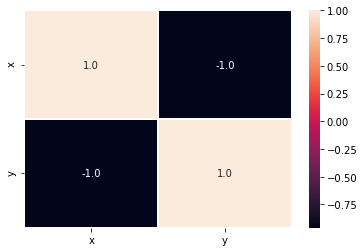

52.9
[ 1.33152377e-03 -3.17222877e-07  1.63082518e-03 ...  9.81761181e-04
  9.81690504e-04  9.81578524e-04]


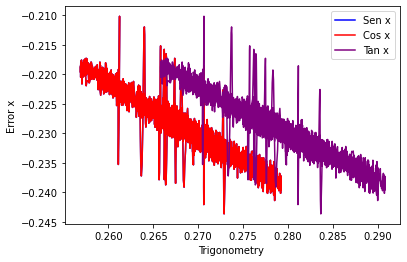

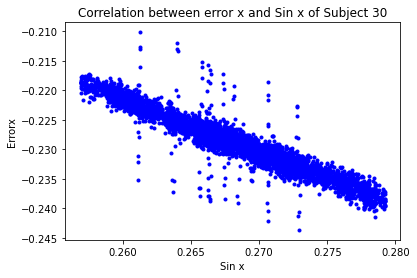

[[ 1.         -0.95107019]
 [-0.95107019  1.        ]]


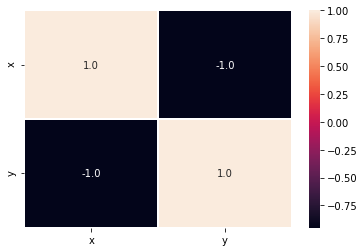

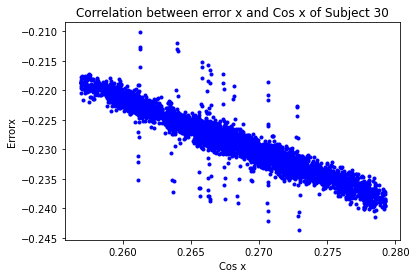

[[ 1.         -0.95107019]
 [-0.95107019  1.        ]]


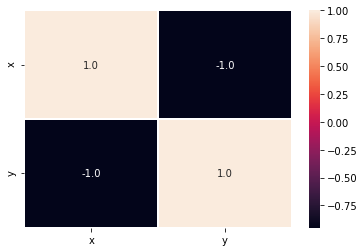

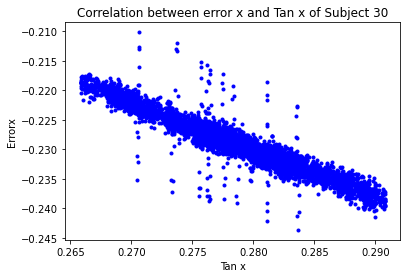

[[ 1.         -0.95100118]
 [-0.95100118  1.        ]]


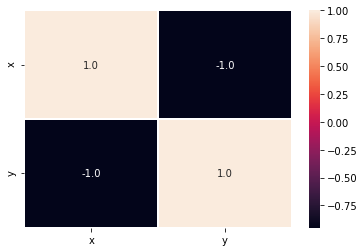

52.9
[-0.00460512 -0.00441523 -0.00380602 ...  0.00139619  0.00139644
  0.00139676]


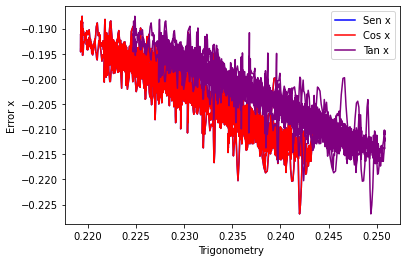

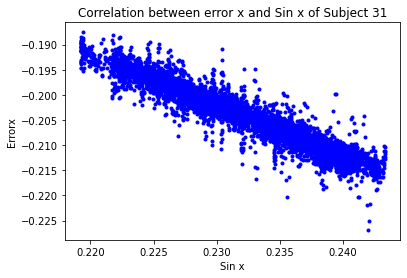

[[ 1.         -0.95281214]
 [-0.95281214  1.        ]]


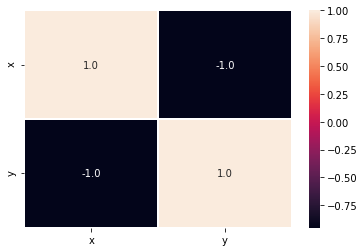

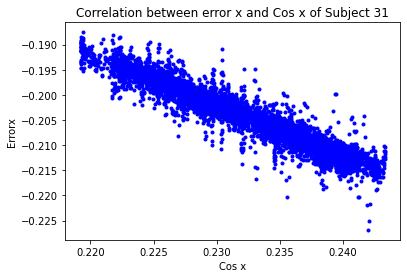

[[ 1.         -0.95281214]
 [-0.95281214  1.        ]]


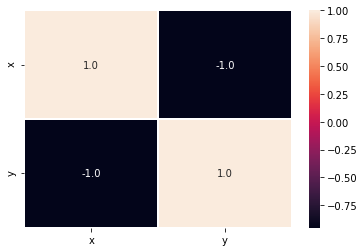

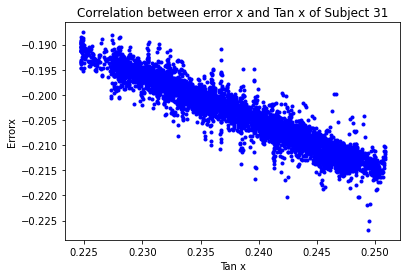

[[ 1.         -0.95282198]
 [-0.95282198  1.        ]]


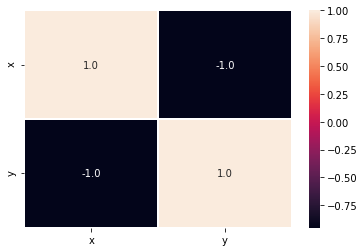

52.9
[ 0.00096849 -0.00023811 -0.00066757 ... -0.00183837 -0.00183851
 -0.00183874]


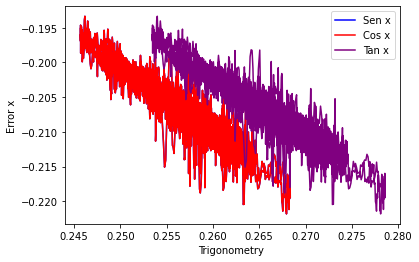

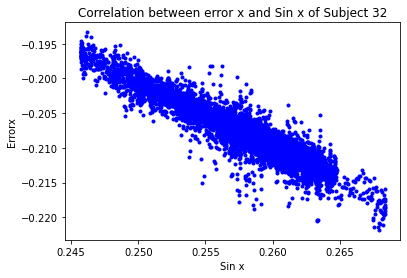

[[ 1.         -0.93460601]
 [-0.93460601  1.        ]]


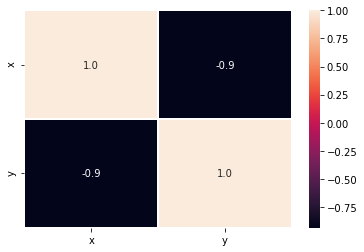

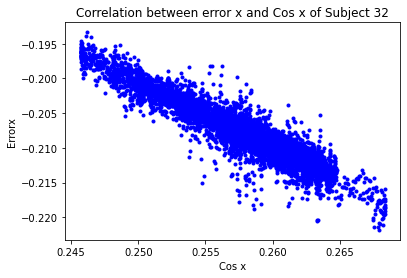

[[ 1.         -0.93460601]
 [-0.93460601  1.        ]]


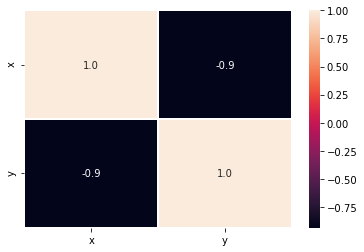

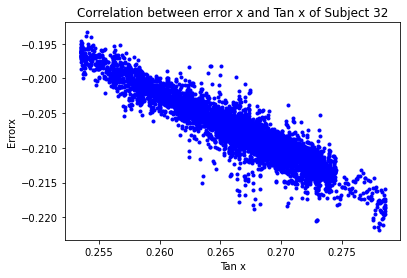

[[ 1.         -0.93459183]
 [-0.93459183  1.        ]]


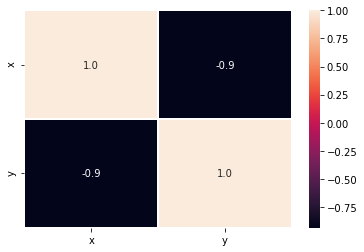

52.9
[-0.00069392  0.00068588 -0.00046576 ... -0.00020688 -0.00020688
 -0.00020687]


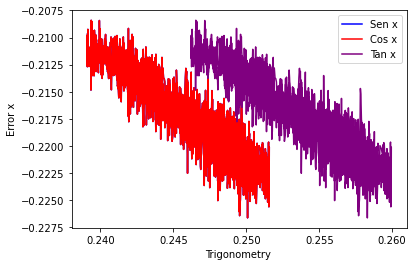

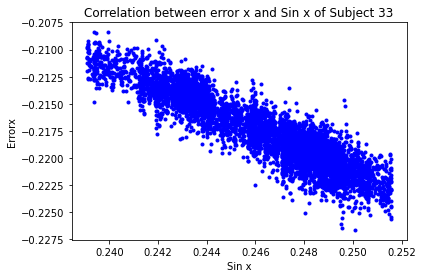

[[ 1.         -0.91452528]
 [-0.91452528  1.        ]]


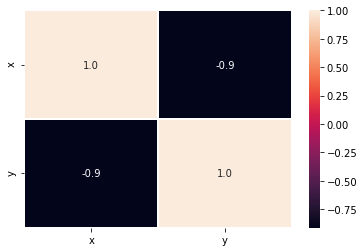

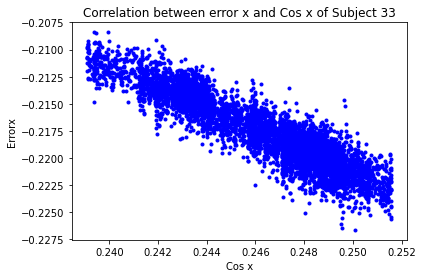

[[ 1.         -0.91452528]
 [-0.91452528  1.        ]]


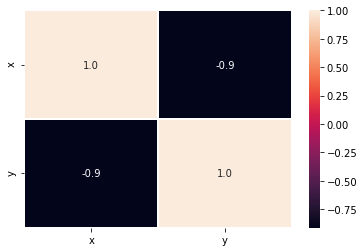

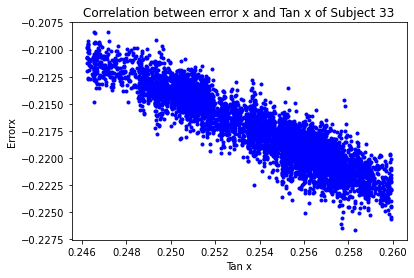

[[ 1.         -0.91453756]
 [-0.91453756  1.        ]]


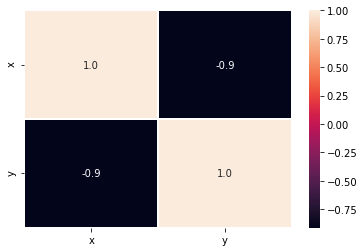

52.9
[-0.01178569 -0.01096075 -0.00434326 ...  0.00168401  0.00168443
  0.001685  ]


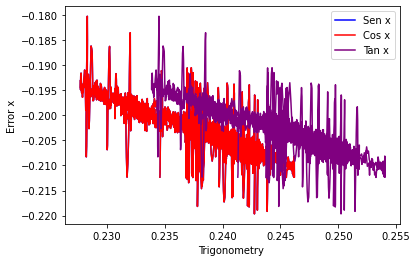

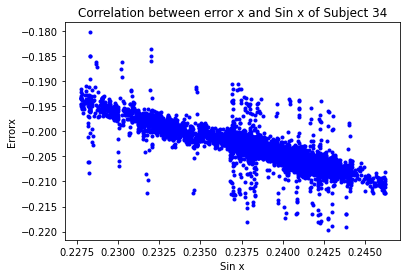

[[ 1.         -0.86121516]
 [-0.86121516  1.        ]]


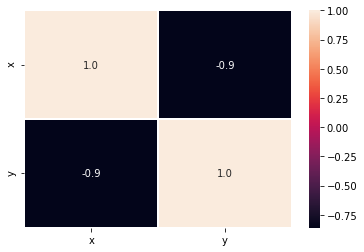

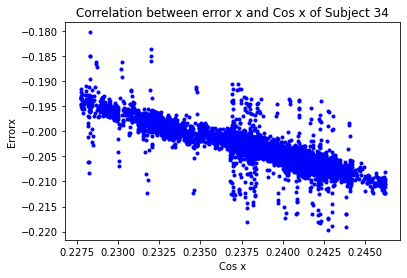

[[ 1.         -0.86121516]
 [-0.86121516  1.        ]]


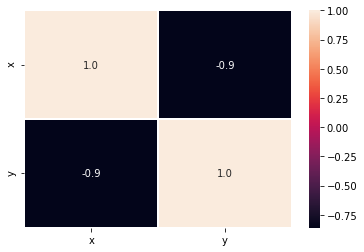

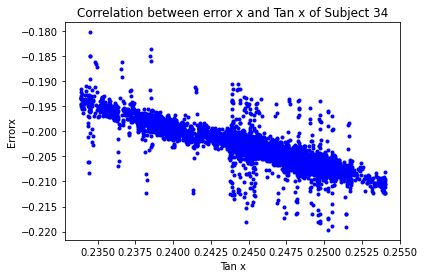

[[ 1.         -0.86123464]
 [-0.86123464  1.        ]]


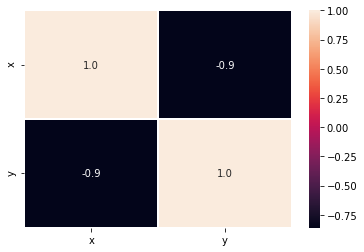

52.9
[ 3.29540281e-04  1.38905677e-07  2.55830973e-03 ... -4.53703589e-06
 -4.53710854e-06 -4.53723315e-06]


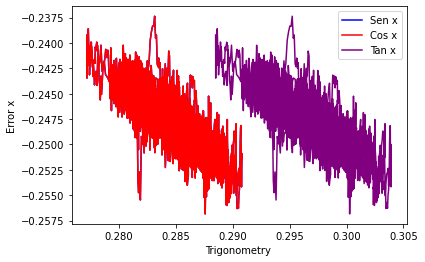

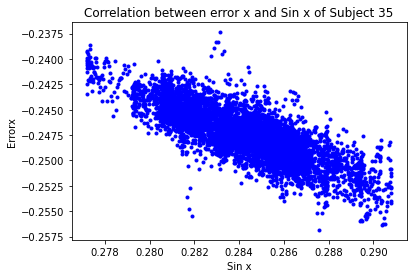

[[ 1.         -0.80603997]
 [-0.80603997  1.        ]]


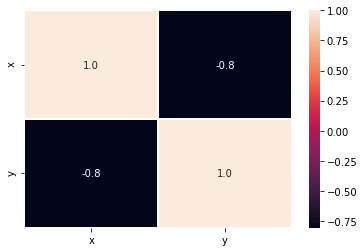

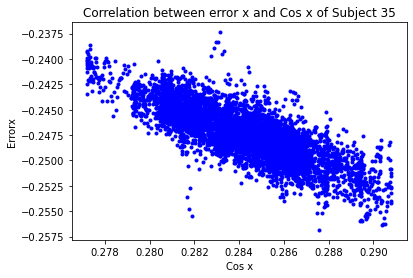

[[ 1.         -0.80603997]
 [-0.80603997  1.        ]]


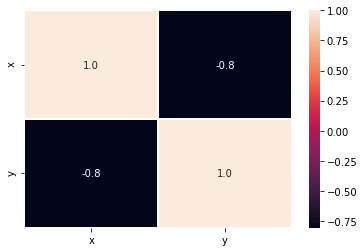

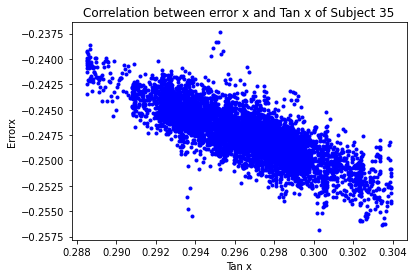

[[ 1.         -0.80602033]
 [-0.80602033  1.        ]]


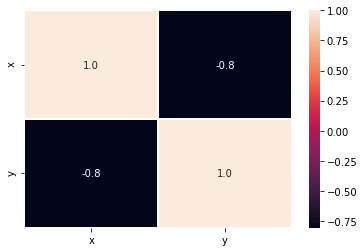

75.85
[-0.00759797 -0.00330673  0.00386649 ...  0.00191159  0.0019116
  0.00191159]


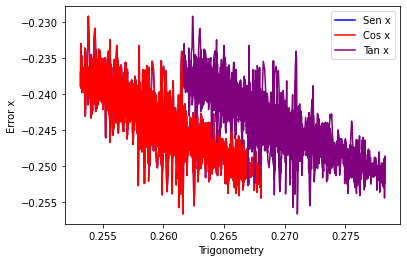

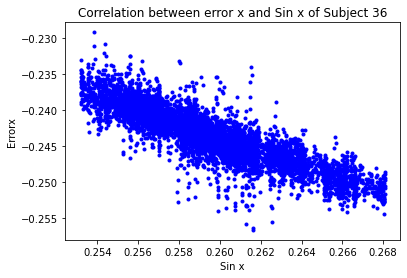

[[ 1.         -0.87444055]
 [-0.87444055  1.        ]]


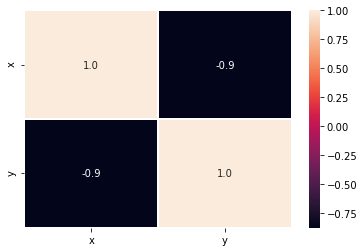

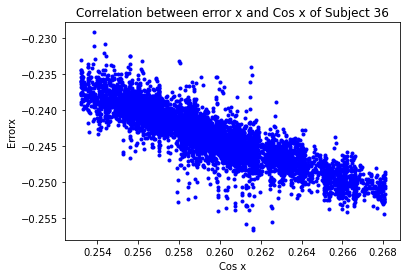

[[ 1.         -0.87444055]
 [-0.87444055  1.        ]]


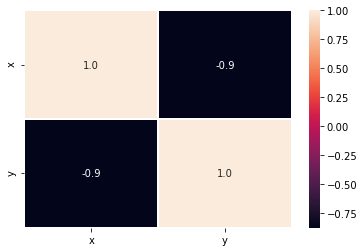

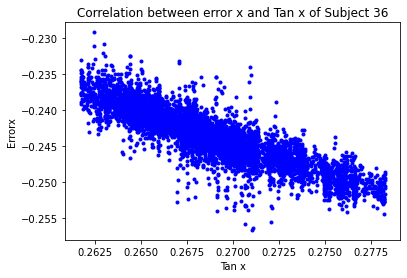

[[ 1.         -0.87436334]
 [-0.87436334  1.        ]]


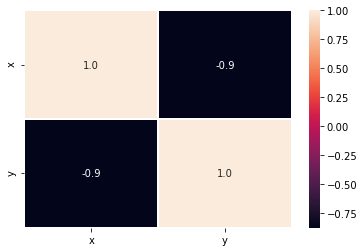

75.85
[ 0.00114163  0.004138    0.00206866 ... -0.00156783 -0.00156747
 -0.00156698]


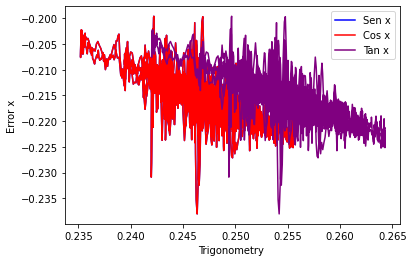

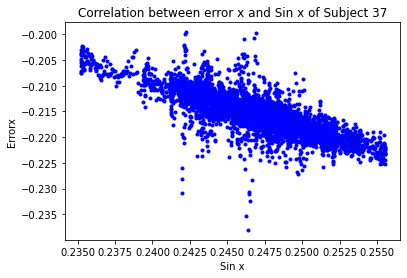

[[ 1.         -0.81107155]
 [-0.81107155  1.        ]]


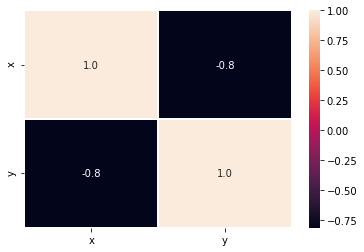

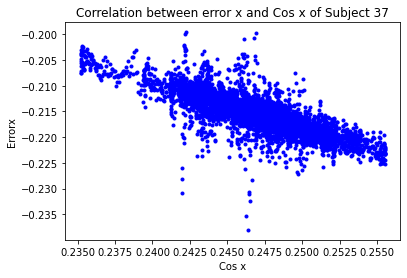

[[ 1.         -0.81107155]
 [-0.81107155  1.        ]]


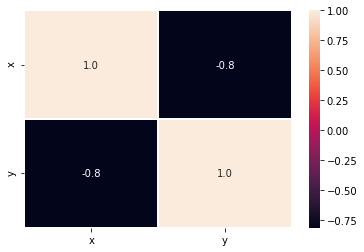

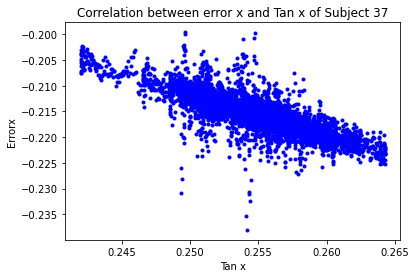

[[ 1.        -0.8110303]
 [-0.8110303  1.       ]]


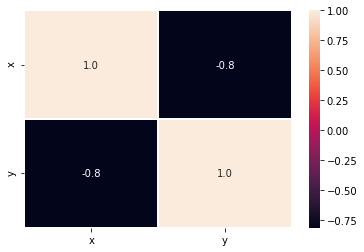

75.85
[-0.00098419 -0.00098931 -0.00125243 ...  0.00238367  0.0023837
  0.0023837 ]


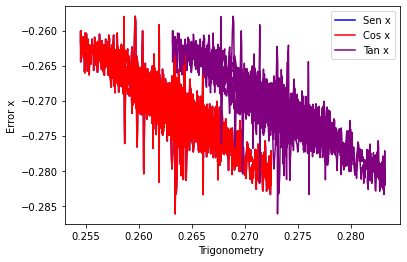

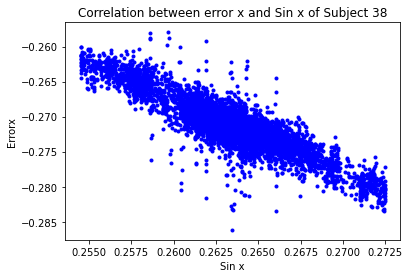

[[ 1.         -0.88958228]
 [-0.88958228  1.        ]]


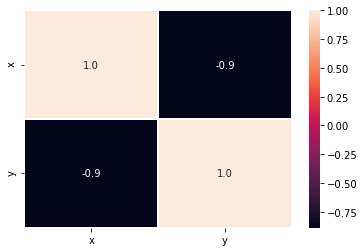

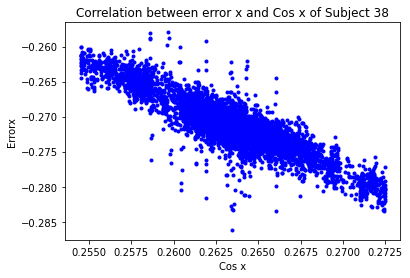

[[ 1.         -0.88958228]
 [-0.88958228  1.        ]]


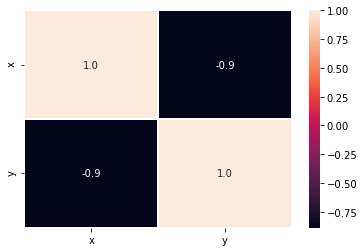

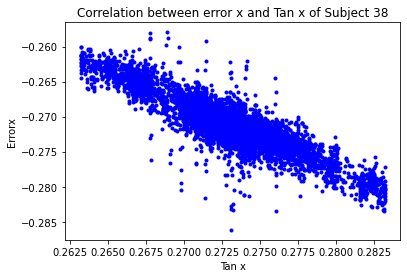

[[ 1.        -0.8895257]
 [-0.8895257  1.       ]]


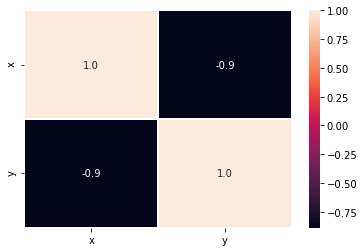

75.85
[-0.00160655 -0.00056865 -0.00018943 ...  0.0008693   0.00086929
  0.00086927]


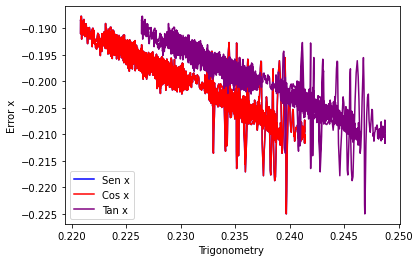

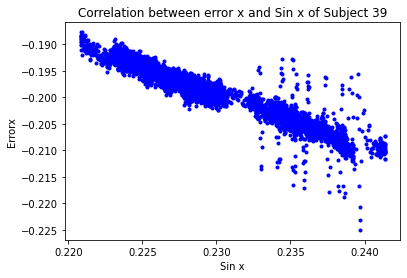

[[ 1.         -0.95034157]
 [-0.95034157  1.        ]]


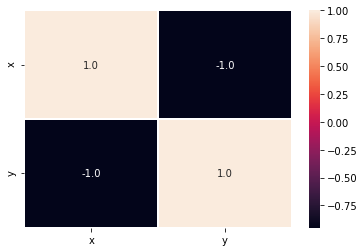

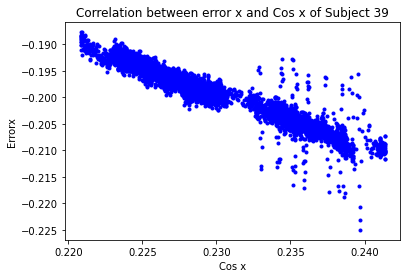

[[ 1.         -0.95034157]
 [-0.95034157  1.        ]]


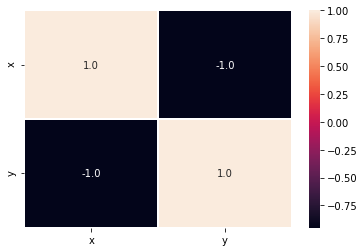

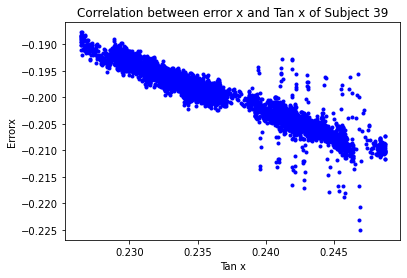

[[ 1.         -0.95028353]
 [-0.95028353  1.        ]]


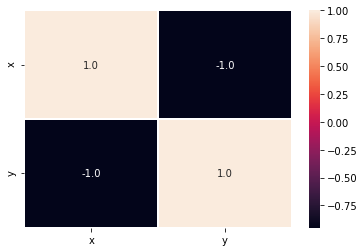

75.85
[ 1.32064406e-06  7.70183879e-04  9.47374020e-04 ... -1.73715057e-04
 -1.73725011e-04 -1.73739318e-04]


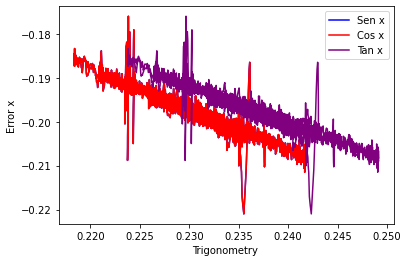

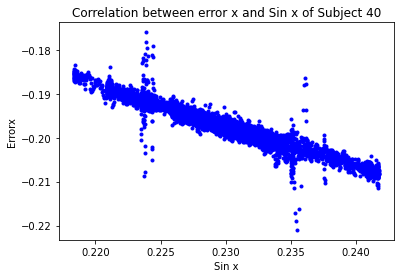

[[ 1.         -0.95279695]
 [-0.95279695  1.        ]]


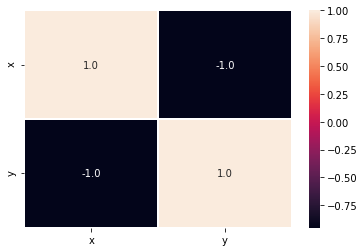

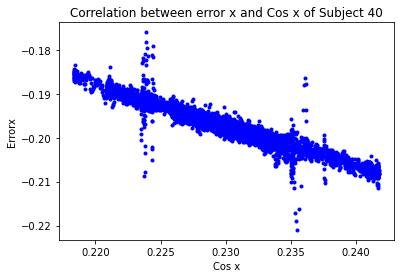

[[ 1.         -0.95279695]
 [-0.95279695  1.        ]]


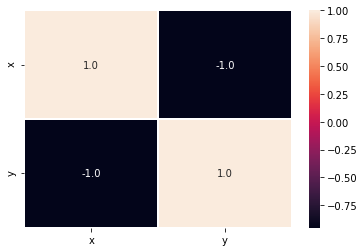

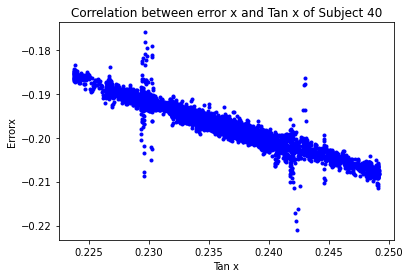

[[ 1.         -0.95272423]
 [-0.95272423  1.        ]]


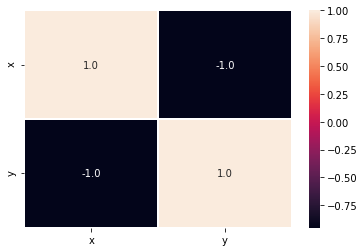

75.85
[ 8.91113432e-06 -2.22366067e-03  9.17484196e-06 ... -1.19976798e-03
 -1.19981300e-03 -1.19989033e-03]


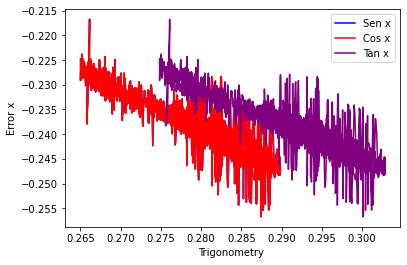

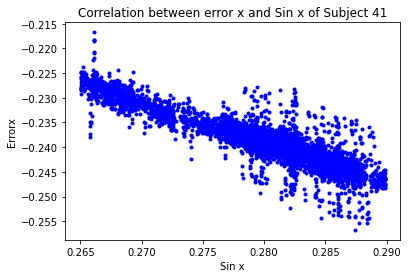

[[ 1.         -0.89857495]
 [-0.89857495  1.        ]]


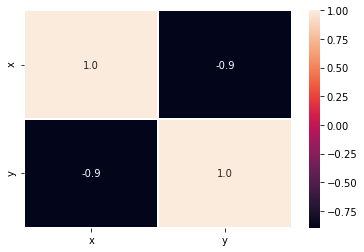

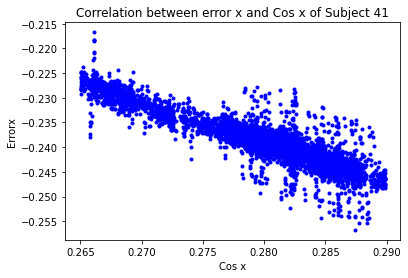

[[ 1.         -0.89857495]
 [-0.89857495  1.        ]]


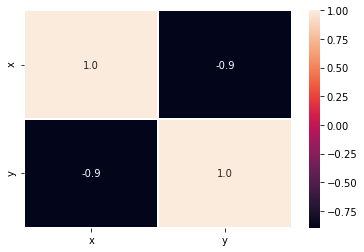

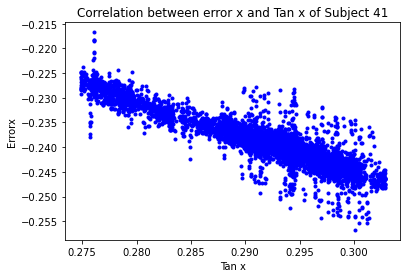

[[ 1.         -0.89857927]
 [-0.89857927  1.        ]]


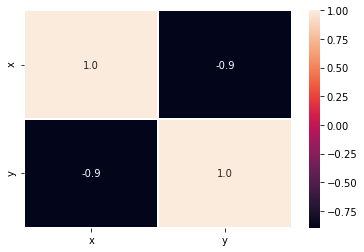

75.85
[-0.00096911  0.00052354 -0.00071761 ... -0.00090305 -0.00090313
 -0.00090324]


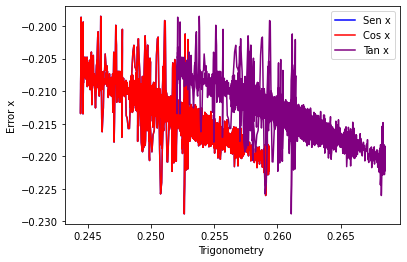

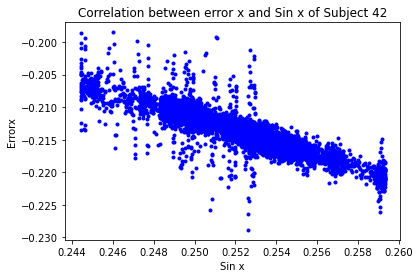

[[ 1.         -0.87363973]
 [-0.87363973  1.        ]]


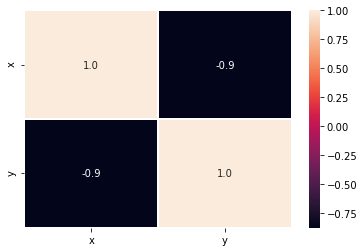

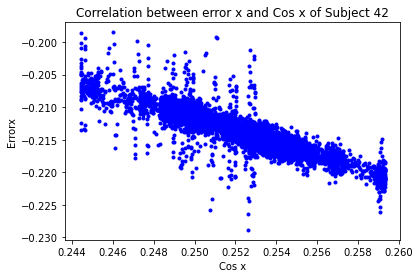

[[ 1.         -0.87363973]
 [-0.87363973  1.        ]]


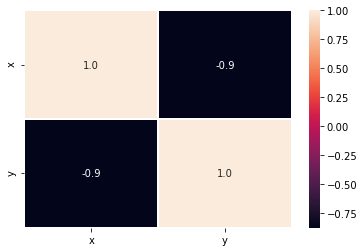

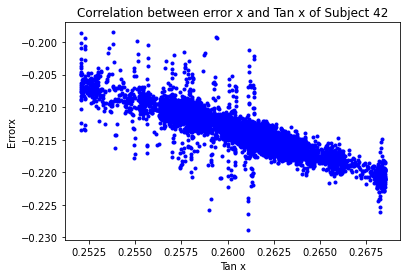

[[ 1.         -0.87365538]
 [-0.87365538  1.        ]]


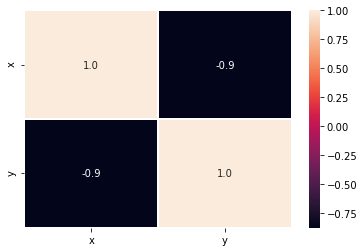

75.85
[-2.89992441e-04  7.13955756e-04  5.71243687e-04 ... -2.73884065e-06
 -2.73848917e-06 -2.73799807e-06]


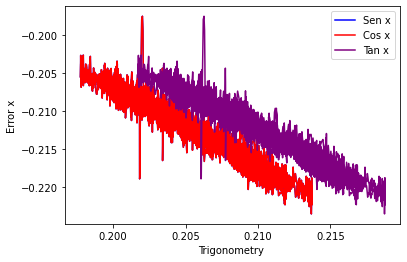

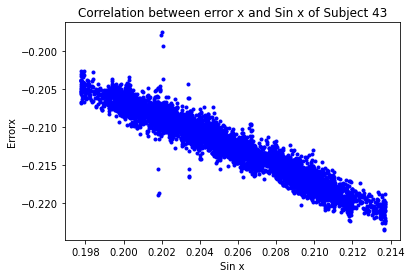

[[ 1.         -0.96343733]
 [-0.96343733  1.        ]]


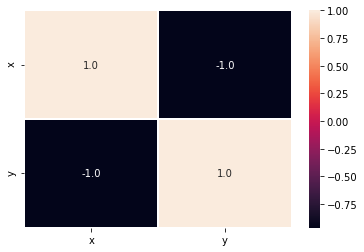

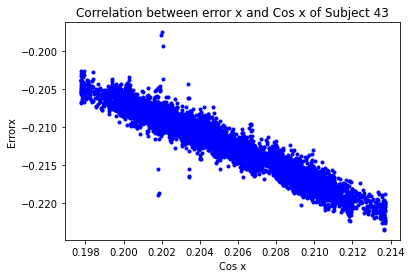

[[ 1.         -0.96343733]
 [-0.96343733  1.        ]]


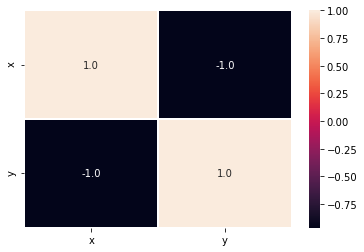

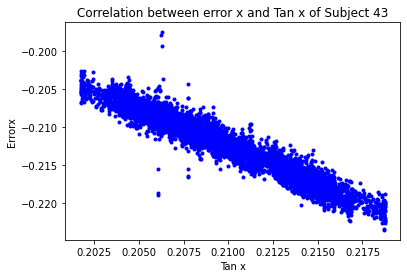

[[ 1.         -0.96346976]
 [-0.96346976  1.        ]]


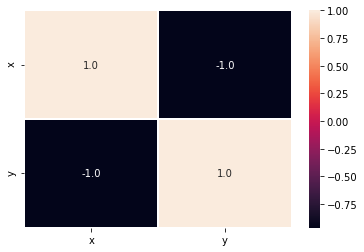

75.85
[ 0.00015061 -0.00055425 -0.00055553 ...  0.0005984   0.00059822
  0.00059797]


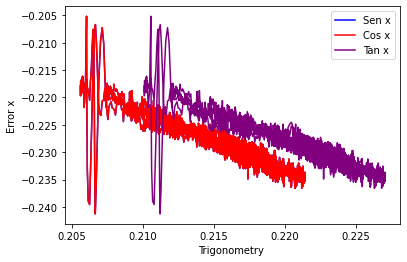

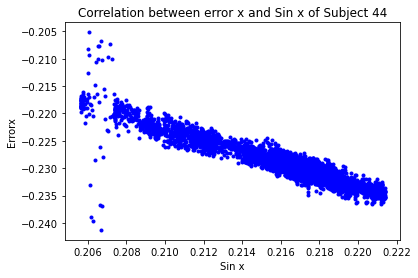

[[ 1.         -0.93099298]
 [-0.93099298  1.        ]]


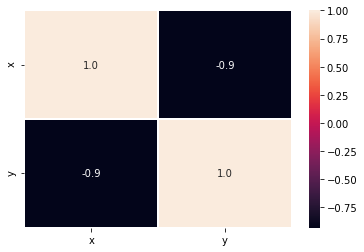

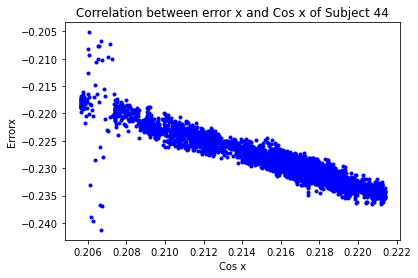

[[ 1.         -0.93099298]
 [-0.93099298  1.        ]]


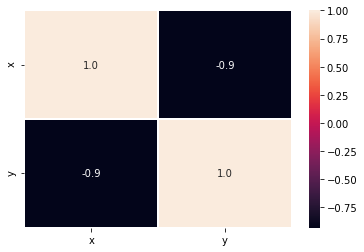

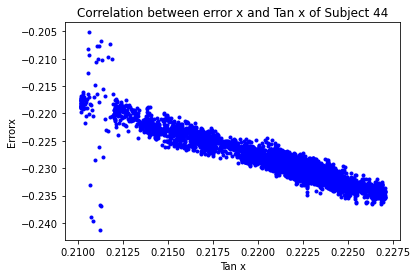

[[ 1.        -0.9310044]
 [-0.9310044  1.       ]]


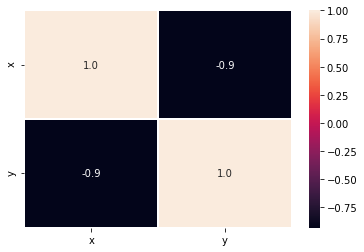

75.85
[-2.17702345e-02 -6.16317339e-03  3.05174706e-03 ...  9.05307372e-07
  9.05431200e-07  9.05572802e-07]


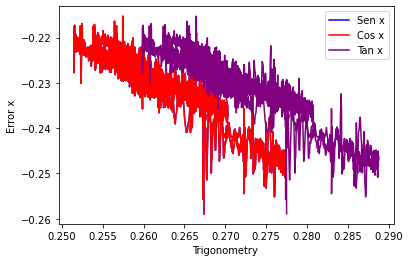

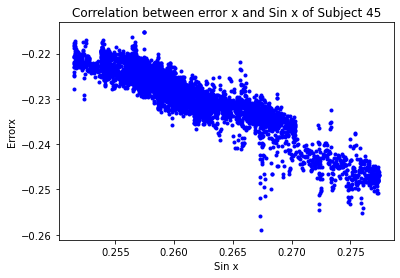

[[ 1.         -0.91836531]
 [-0.91836531  1.        ]]


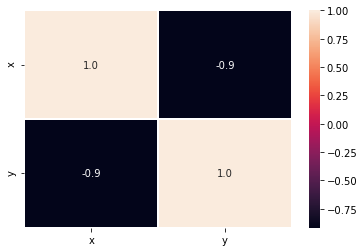

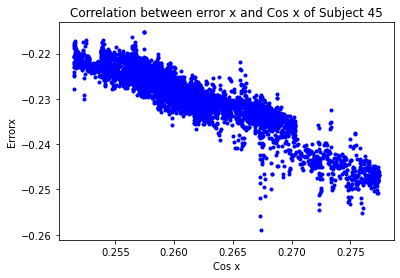

[[ 1.         -0.91836531]
 [-0.91836531  1.        ]]


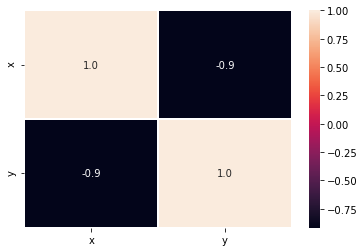

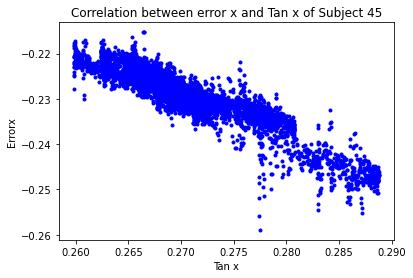

[[ 1.         -0.91864999]
 [-0.91864999  1.        ]]


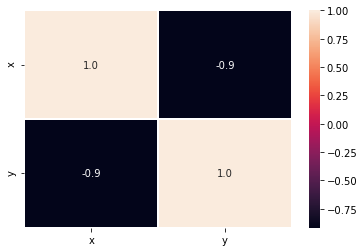

75.85
[-0.00172322 -0.00077161 -0.00137303 ...  0.00015119  0.00015117
  0.00015115]


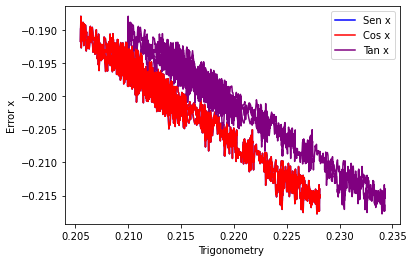

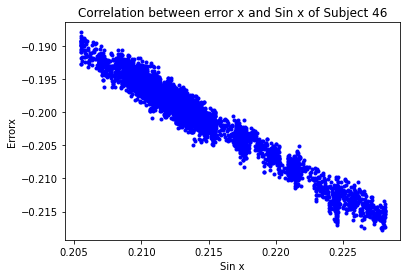

[[ 1.         -0.97677381]
 [-0.97677381  1.        ]]


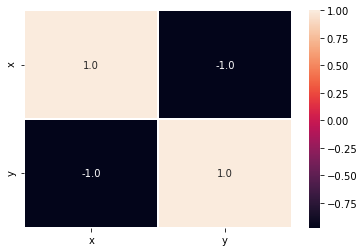

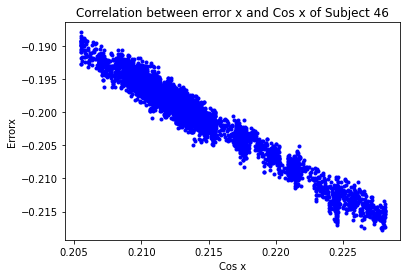

[[ 1.         -0.97677381]
 [-0.97677381  1.        ]]


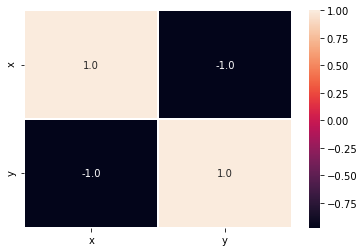

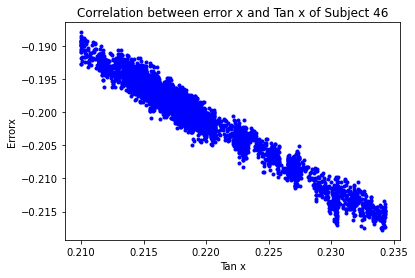

[[ 1.         -0.97673408]
 [-0.97673408  1.        ]]


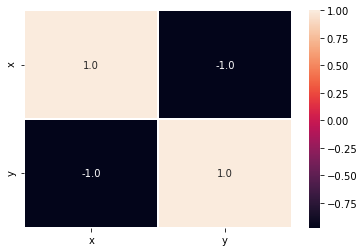

75.85
[ 3.78320705e-06 -2.25276870e-04  6.59448210e-04 ... -1.02632765e-03
 -1.02651370e-03 -1.02678752e-03]


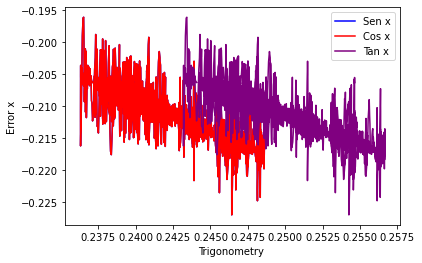

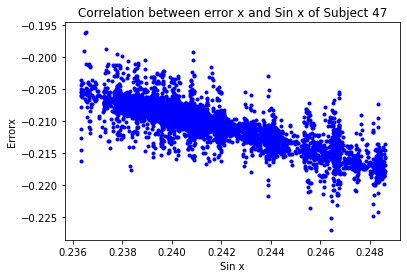

[[ 1.        -0.8201518]
 [-0.8201518  1.       ]]


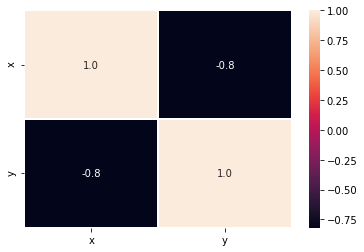

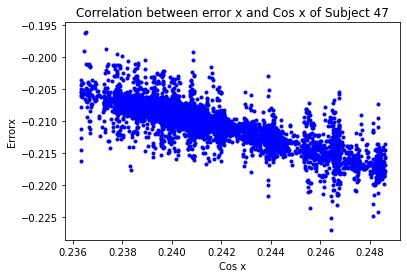

[[ 1.        -0.8201518]
 [-0.8201518  1.       ]]


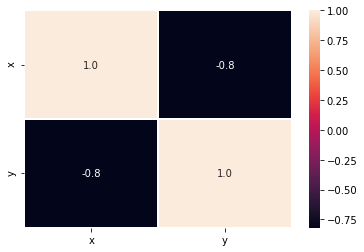

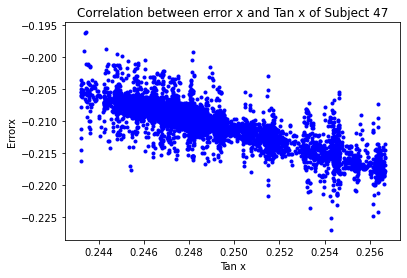

[[ 1.         -0.82016164]
 [-0.82016164  1.        ]]


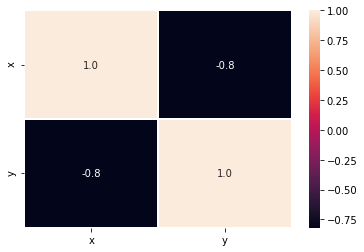

61.05
[-0.0024744  -0.0006725  -0.00294638 ... -0.00236074 -0.0023621
 -0.00236406]


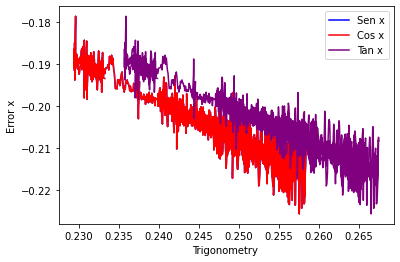

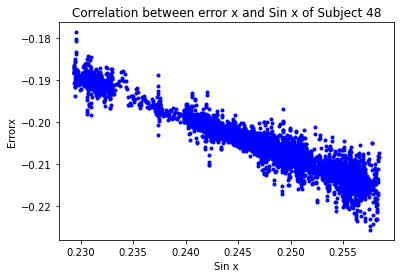

[[ 1.         -0.96252422]
 [-0.96252422  1.        ]]


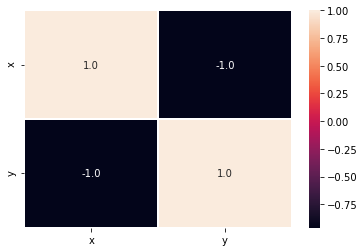

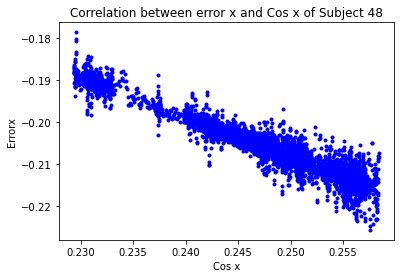

[[ 1.         -0.96252422]
 [-0.96252422  1.        ]]


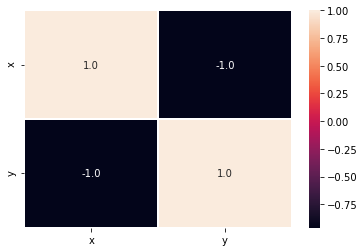

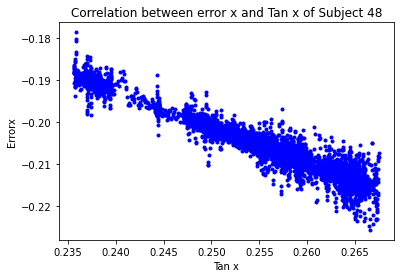

[[ 1.         -0.96252792]
 [-0.96252792  1.        ]]


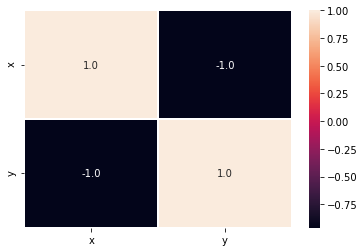

61.05
[ 0.00190906 -0.00064453  0.00046651 ... -0.00208508 -0.00208443
 -0.0020835 ]


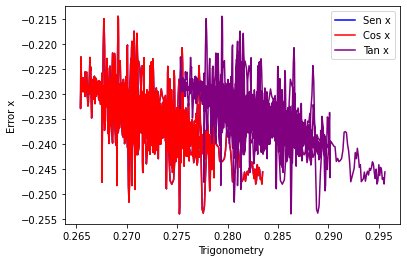

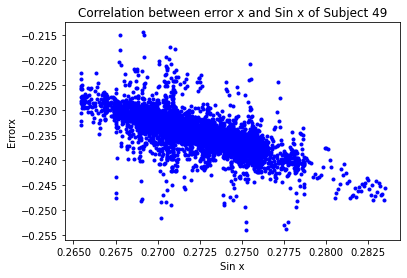

[[ 1.         -0.71905465]
 [-0.71905465  1.        ]]


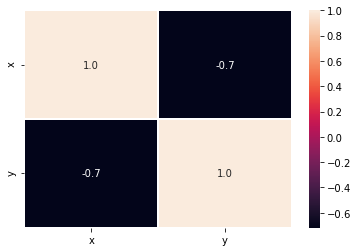

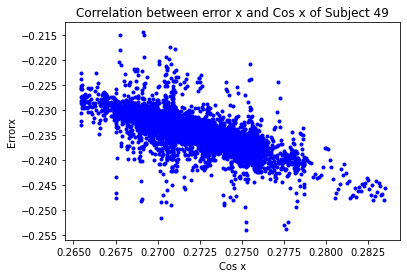

[[ 1.         -0.71905465]
 [-0.71905465  1.        ]]


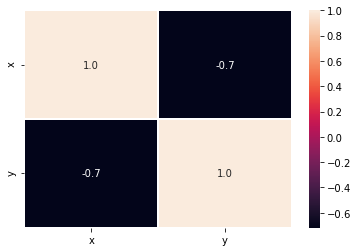

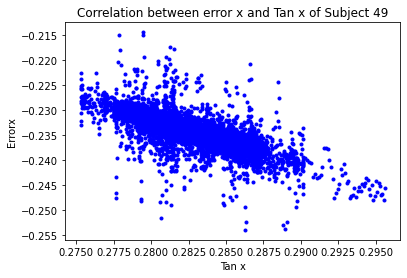

[[ 1.         -0.71909264]
 [-0.71909264  1.        ]]


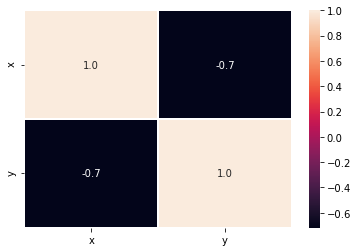

In [12]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    tanx=np.tan(angulox)
    tanz=np.tan(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    print(COPXmatrix)
    plt.figure()
    #plt.plot(t[30:],matrizangx,color='red')
    plt.plot(sinx[30:],errorx,color='blue',label='Sen x')
    plt.plot(cosx[30:],errorx,color='red',label='Cos x')
    plt.plot(tanx[30:],errorx,color='purple',label='Tan x')
    plt.xlabel("Trigonometry ")
    plt.ylabel("Error x")
    plt.legend()
    plt.show()
    data={'x':sinx[30:],
         'y': errorx
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Sin x")
    plt.ylabel("Errorx")
    plt.title("Correlation between error x and Sin x of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(sinx[30:],errorx)
    print(r)
    plt.figure()
    data={'x':sinx[30:],
         'y': errorx
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    data={'x':cosx[30:],
         'y': errorx
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Cos x")
    plt.ylabel("Errorx")
    plt.title("Correlation between error x and Cos x of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(cosx[30:],errorx)
    print(r)
    plt.figure()
    data={'x':cosx[30:],
         'y': errorx
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    data={'x':tanx[30:],
         'y': errorx
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Tan x")
    plt.ylabel("Errorx")
    plt.title("Correlation between error x and Tan x of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(tanx[30:],errorx)
    print(r)
    plt.figure()
    data={'x':tanx[30:],
         'y': errorx
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    

## Correlation Between errprx and senz,cosz and tanz

74.3
[-0.00062795 -0.00183479  0.00101439 ...  0.00066651  0.00066671
  0.00066699]


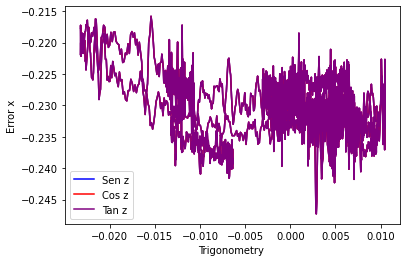

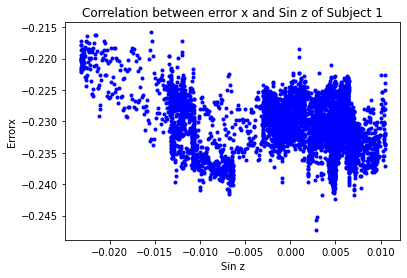

[[ 1.         -0.31860846]
 [-0.31860846  1.        ]]


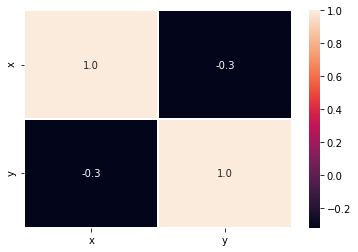

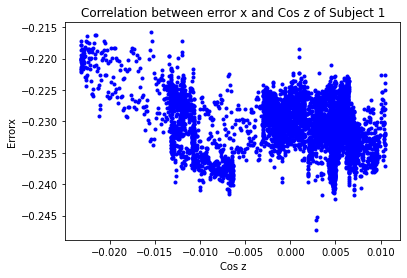

[[ 1.         -0.31860846]
 [-0.31860846  1.        ]]


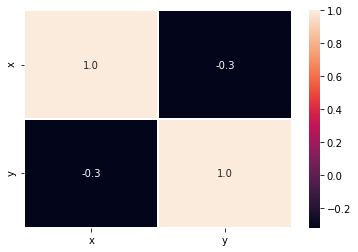

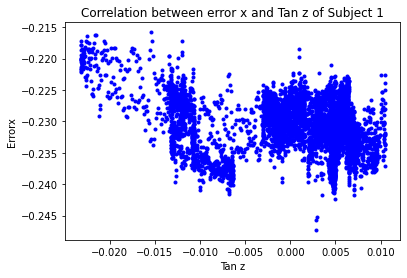

[[ 1.         -0.31862714]
 [-0.31862714  1.        ]]


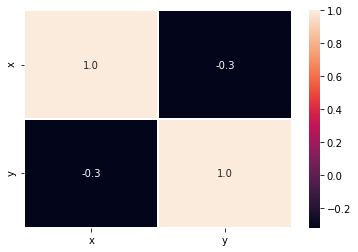

74.3
[ 0.00250586  0.00228543  0.00436475 ... -0.00020834 -0.00020832
 -0.00020829]


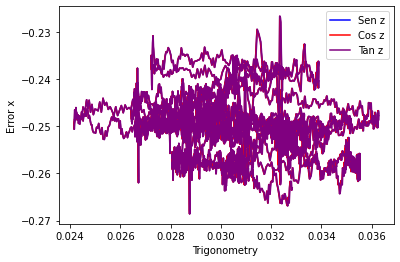

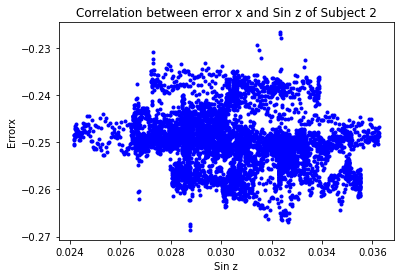

[[ 1.         -0.20228115]
 [-0.20228115  1.        ]]


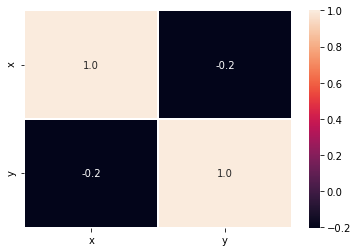

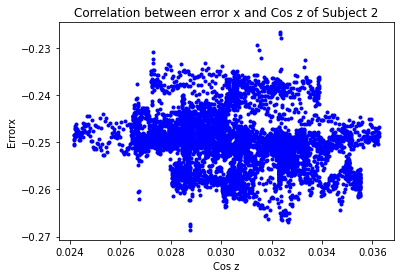

[[ 1.         -0.20228115]
 [-0.20228115  1.        ]]


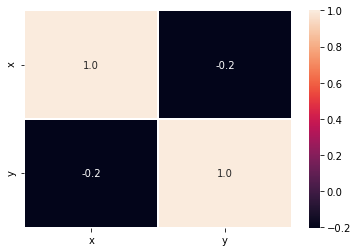

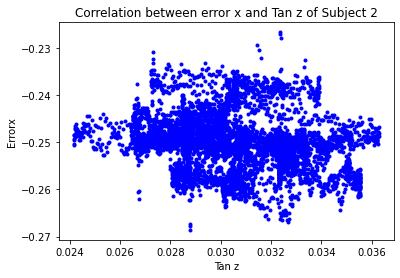

[[ 1.         -0.20228461]
 [-0.20228461  1.        ]]


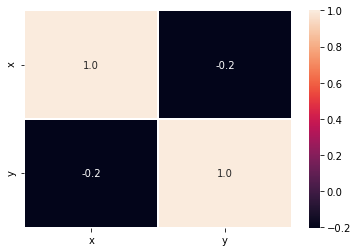

74.3
[-0.00114536  0.00023421 -0.00022916 ... -0.00162697 -0.00162677
 -0.00162653]


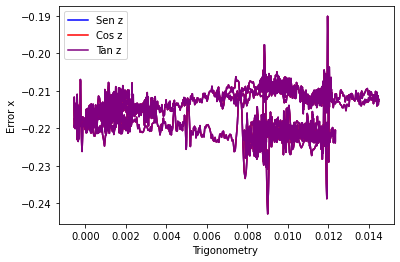

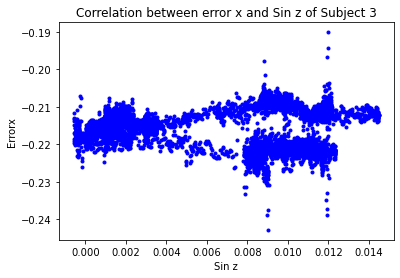

[[1.         0.01189809]
 [0.01189809 1.        ]]


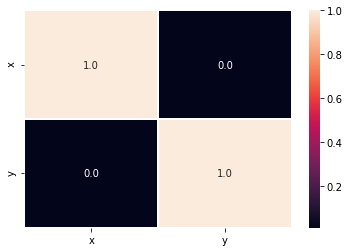

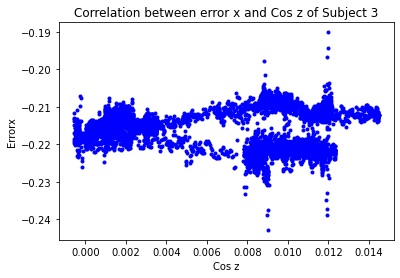

[[1.         0.01189809]
 [0.01189809 1.        ]]


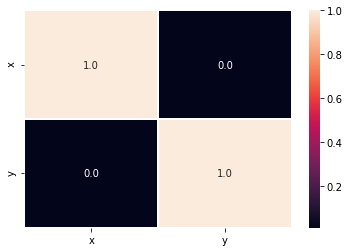

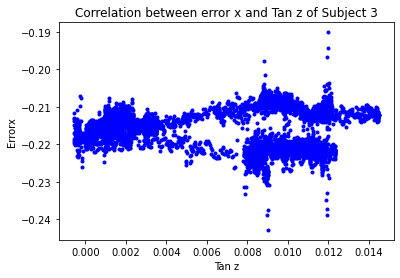

[[1.        0.0119015]
 [0.0119015 1.       ]]


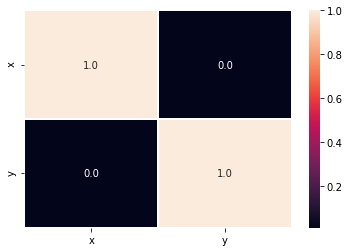

74.3
[ 0.00053299 -0.0008076  -0.00013609 ... -0.00062584 -0.00062579
 -0.00062574]


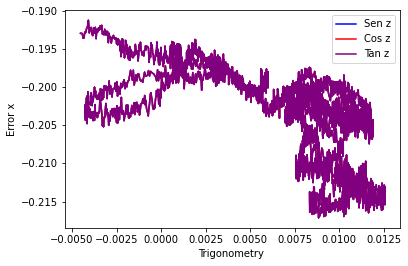

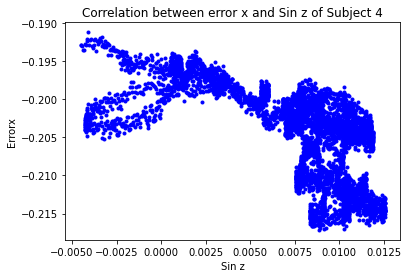

[[ 1.        -0.6386755]
 [-0.6386755  1.       ]]


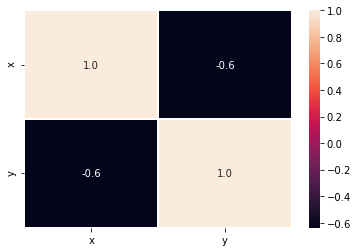

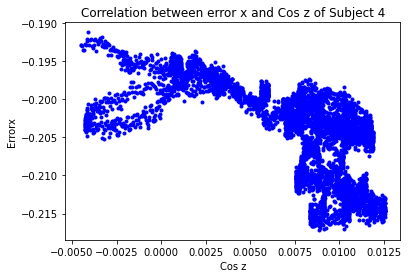

[[ 1.        -0.6386755]
 [-0.6386755  1.       ]]


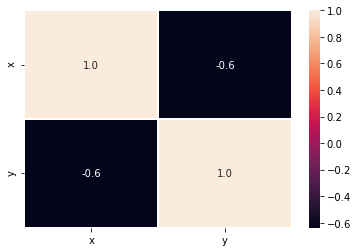

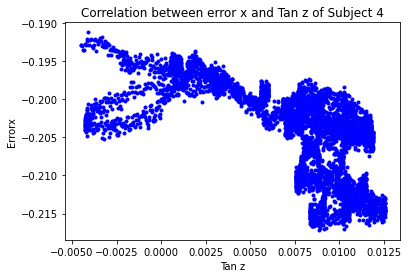

[[ 1.         -0.63868203]
 [-0.63868203  1.        ]]


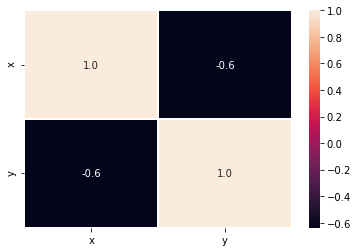

74.3
[-8.41091400e-04  1.24201421e-03  3.49235426e-03 ...  2.52872664e-06
  2.52844447e-06  2.52807104e-06]


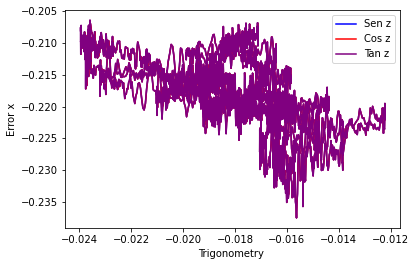

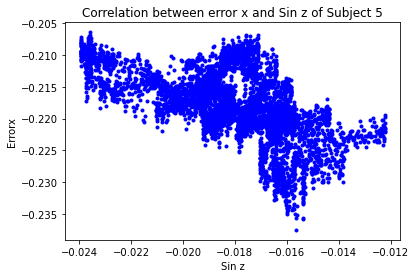

[[ 1.        -0.5852043]
 [-0.5852043  1.       ]]


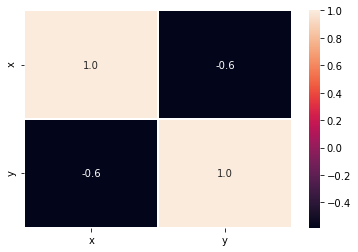

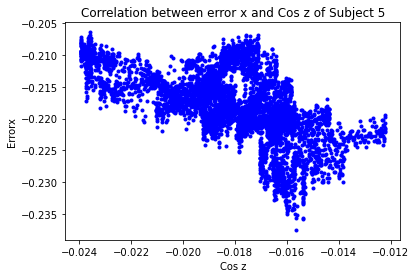

[[ 1.        -0.5852043]
 [-0.5852043  1.       ]]


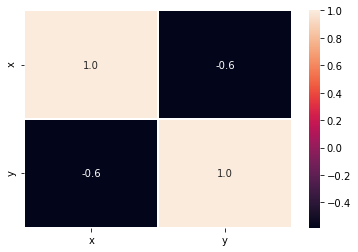

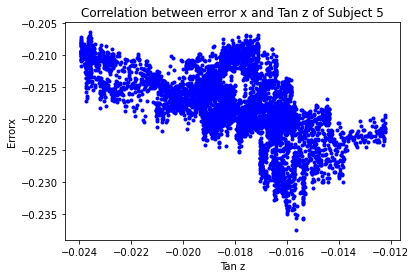

[[ 1.        -0.5851963]
 [-0.5851963  1.       ]]


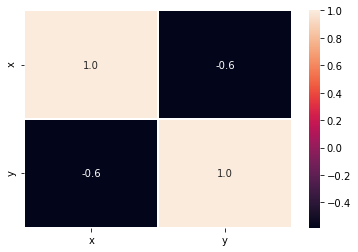

74.3
[ 0.00020194  0.00162995  0.00040663 ... -0.00056806 -0.00056801
 -0.00056795]


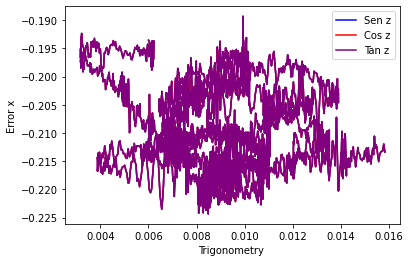

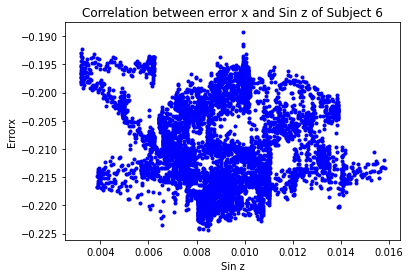

[[ 1.         -0.10251482]
 [-0.10251482  1.        ]]


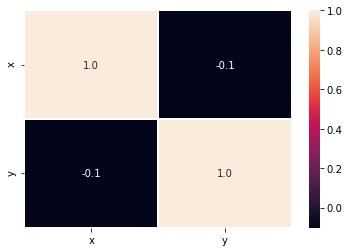

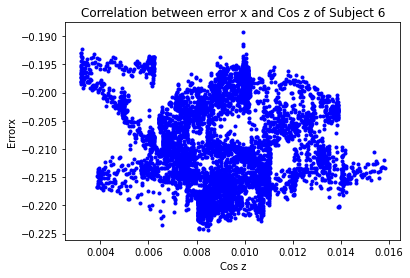

[[ 1.         -0.10251482]
 [-0.10251482  1.        ]]


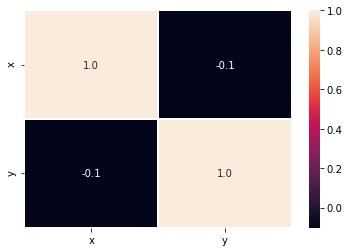

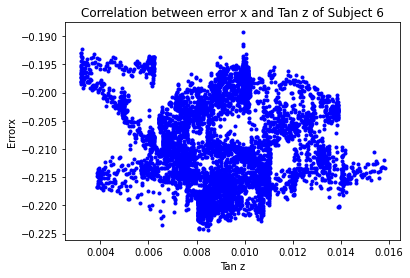

[[ 1.         -0.10250715]
 [-0.10250715  1.        ]]


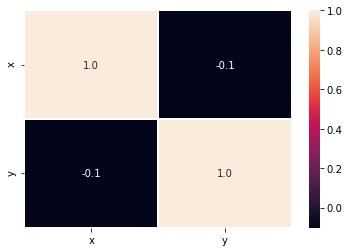

74.3
[ 0.00042813  0.002284    0.00165237 ... -0.00125035 -0.00125038
 -0.00125042]


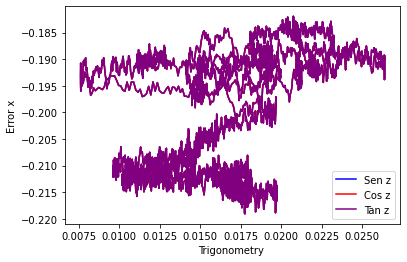

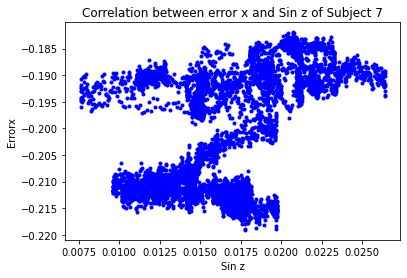

[[1.         0.47969734]
 [0.47969734 1.        ]]


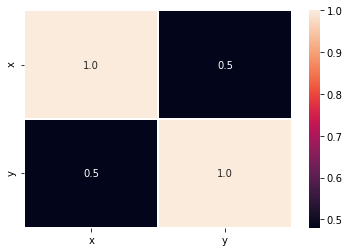

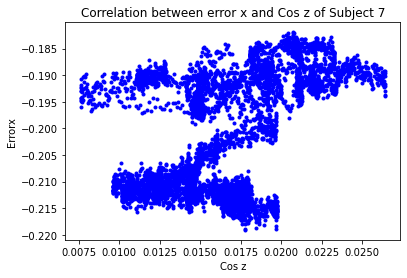

[[1.         0.47969734]
 [0.47969734 1.        ]]


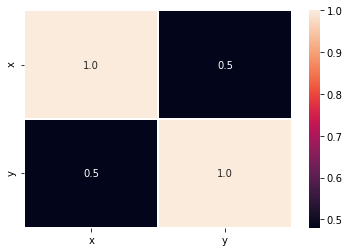

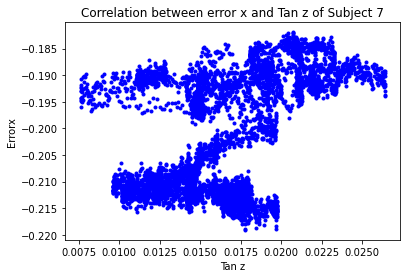

[[1.         0.47972306]
 [0.47972306 1.        ]]


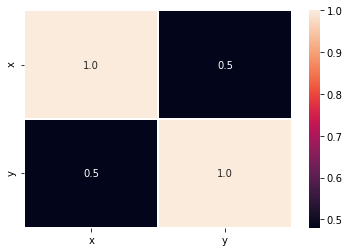

74.3
[ 2.85924872e-04  2.20309765e-07 -1.40623847e-04 ...  6.79396742e-04
  6.79389463e-04  6.79374813e-04]


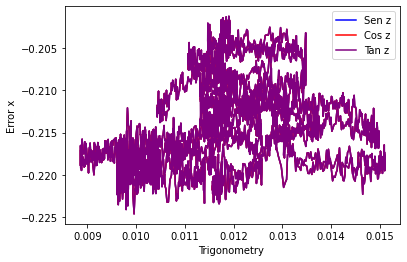

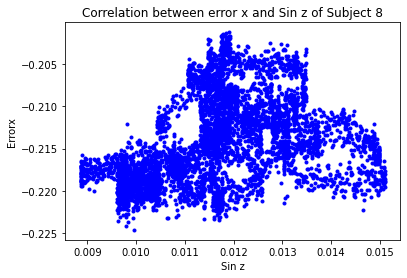

[[1.        0.3798928]
 [0.3798928 1.       ]]


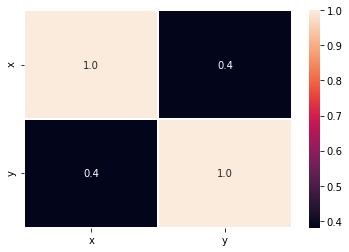

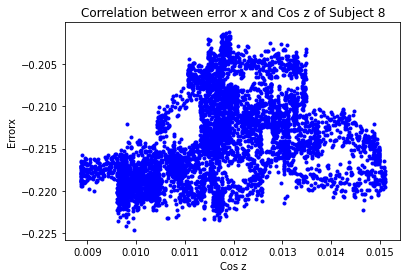

[[1.        0.3798928]
 [0.3798928 1.       ]]


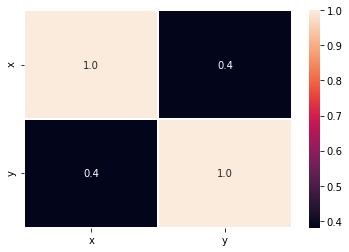

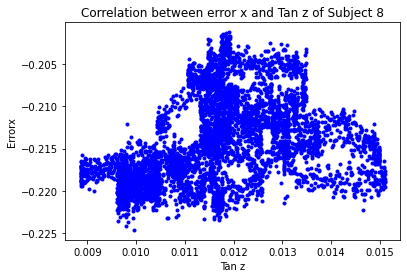

[[1.         0.37987982]
 [0.37987982 1.        ]]


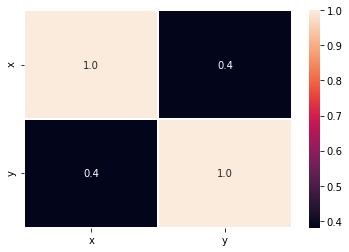

74.3
[-9.94463860e-04 -8.05185257e-04  8.43084681e-07 ...  8.34291748e-04
  8.34275595e-04  8.34246105e-04]


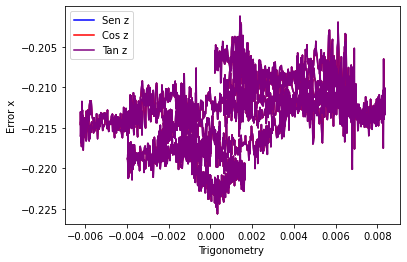

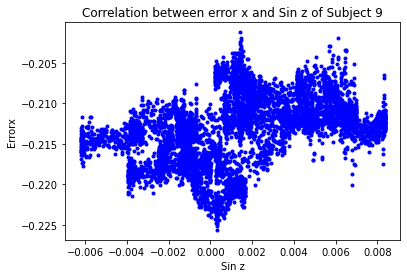

[[1.         0.39136882]
 [0.39136882 1.        ]]


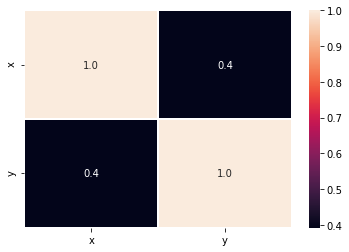

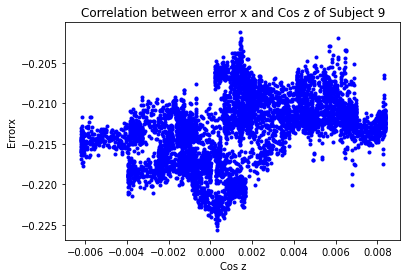

[[1.         0.39136882]
 [0.39136882 1.        ]]


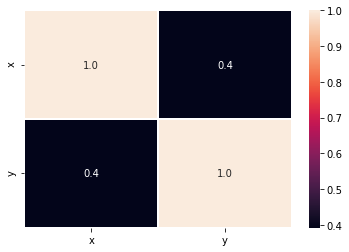

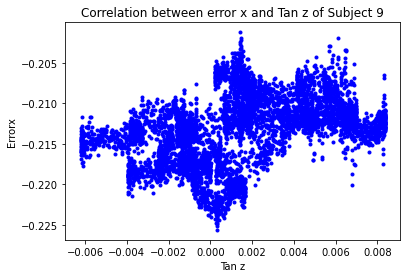

[[1.        0.3913667]
 [0.3913667 1.       ]]


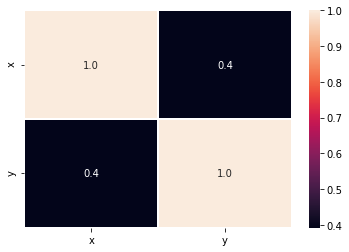

74.3
[-4.86232280e-06  7.03859861e-04  6.96670113e-04 ... -2.48830933e-04
 -2.48851854e-04 -2.48881818e-04]


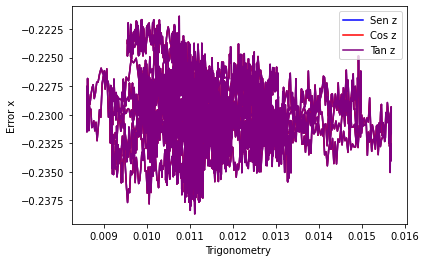

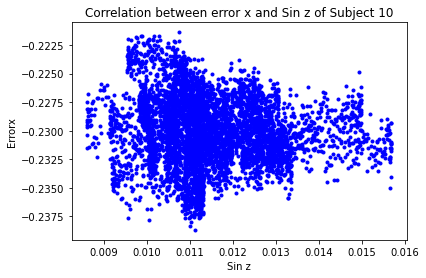

[[ 1.         -0.11720461]
 [-0.11720461  1.        ]]


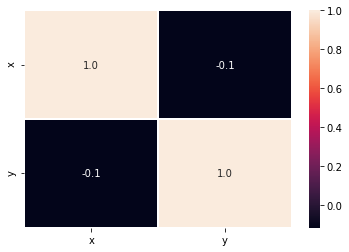

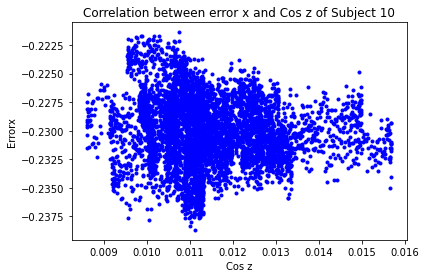

[[ 1.         -0.11720461]
 [-0.11720461  1.        ]]


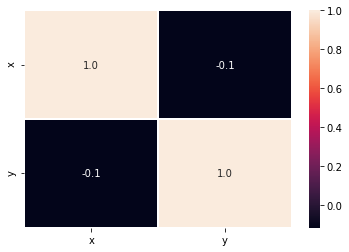

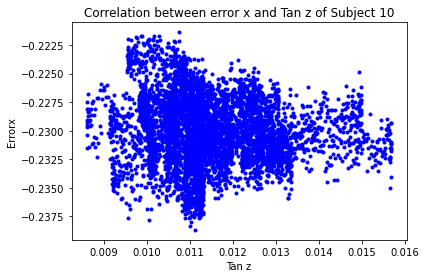

[[ 1.         -0.11720228]
 [-0.11720228  1.        ]]


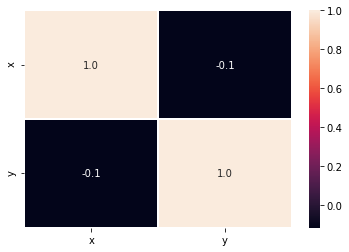

74.3
[ 0.00043958  0.00587328  0.00570288 ... -0.00068528 -0.00068542
 -0.00068562]


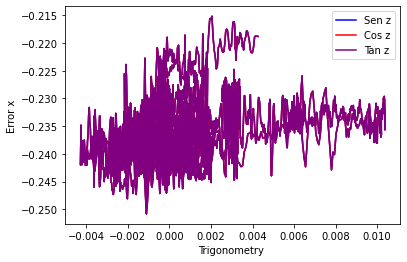

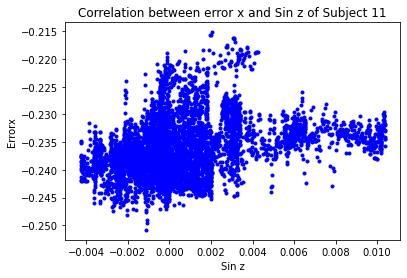

[[1.         0.31162376]
 [0.31162376 1.        ]]


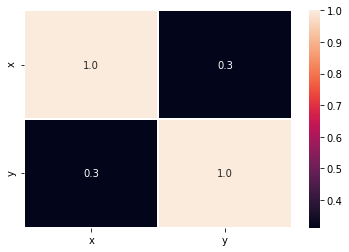

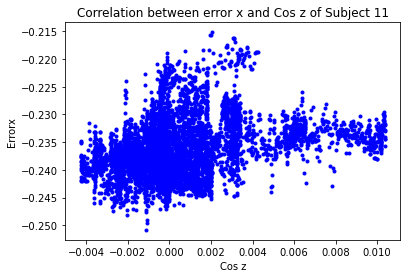

[[1.         0.31162376]
 [0.31162376 1.        ]]


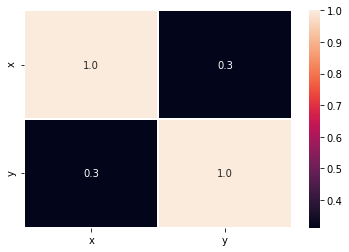

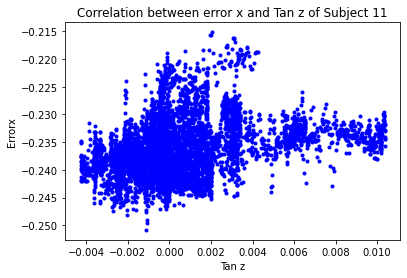

[[1.         0.31162071]
 [0.31162071 1.        ]]


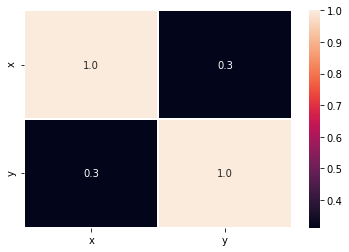

126.3
[-1.57732491e-06  9.04061315e-04  1.13748604e-03 ... -2.04883131e-04
 -2.04841728e-04 -2.04784523e-04]


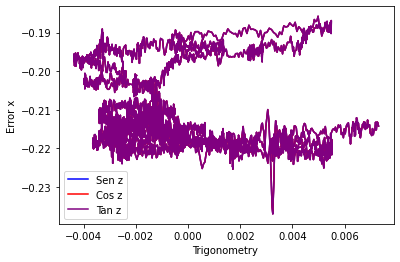

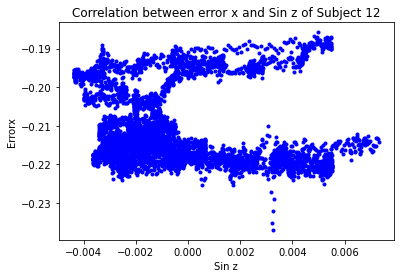

[[ 1.        -0.0632134]
 [-0.0632134  1.       ]]


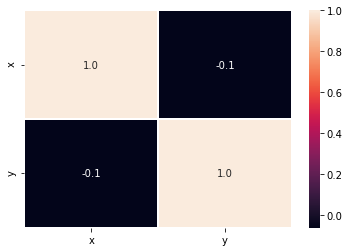

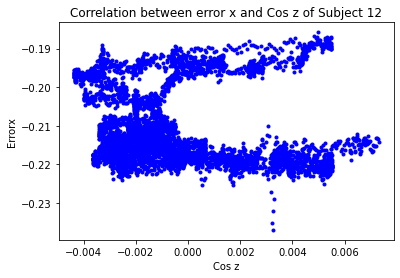

[[ 1.        -0.0632134]
 [-0.0632134  1.       ]]


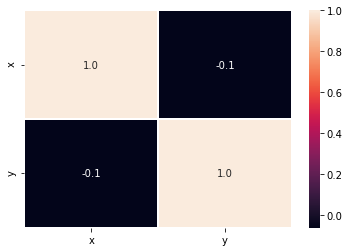

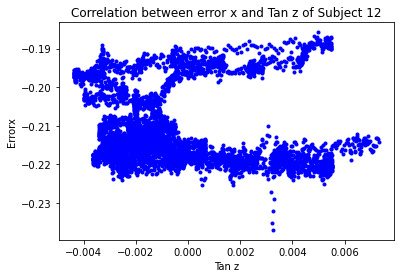

[[ 1.         -0.06321366]
 [-0.06321366  1.        ]]


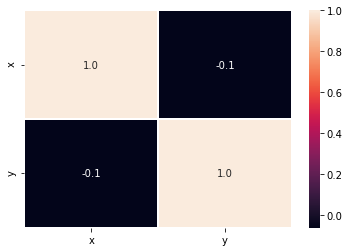

126.3
[ 9.31819792e-07 -1.18878976e-03  6.22089316e-04 ...  9.90683862e-04
  9.90626557e-04  9.90535387e-04]


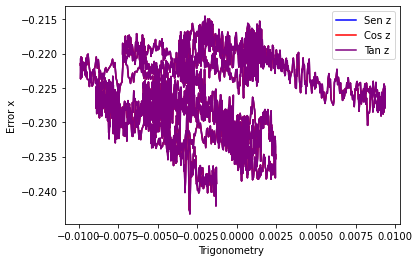

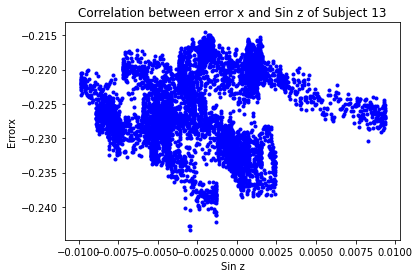

[[1.         0.03597075]
 [0.03597075 1.        ]]


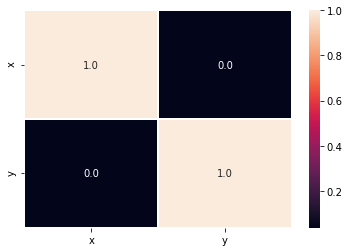

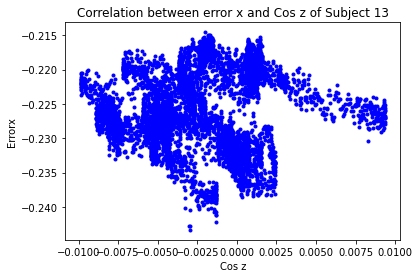

[[1.         0.03597075]
 [0.03597075 1.        ]]


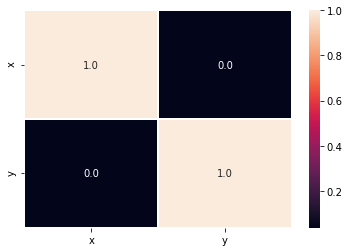

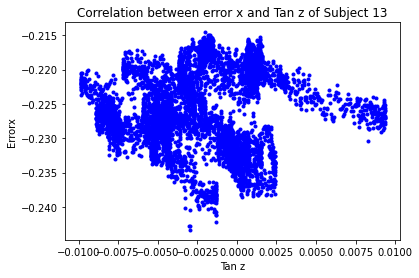

[[1.         0.03597007]
 [0.03597007 1.        ]]


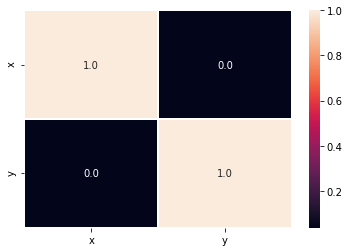

126.3
[0.00200588 0.00143426 0.00162029 ... 0.00074051 0.00074047 0.00074042]


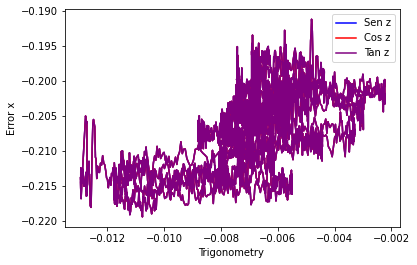

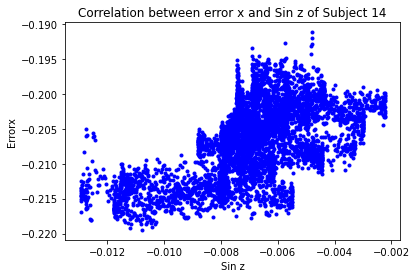

[[1.         0.57297476]
 [0.57297476 1.        ]]


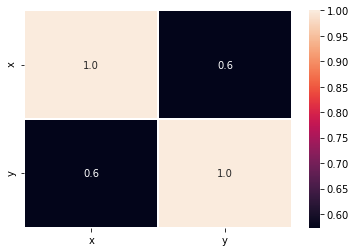

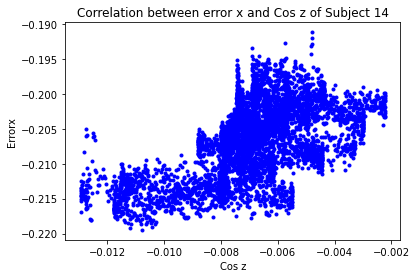

[[1.         0.57297476]
 [0.57297476 1.        ]]


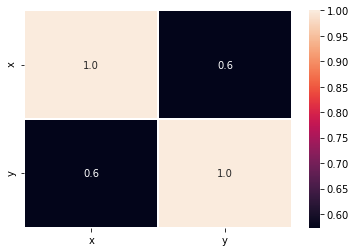

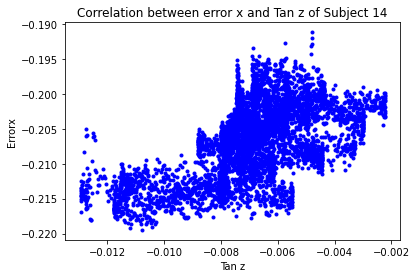

[[1.         0.57297851]
 [0.57297851 1.        ]]


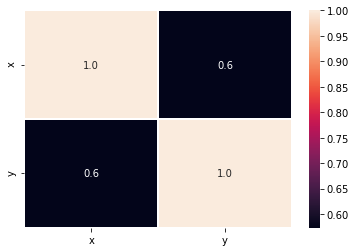

126.3
[-2.26522963e-04 -1.65036030e-04  2.25142887e-03 ...  2.77190723e-08
  2.77198876e-08  2.77208353e-08]


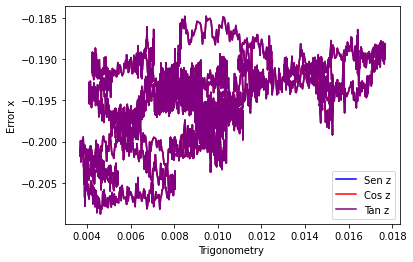

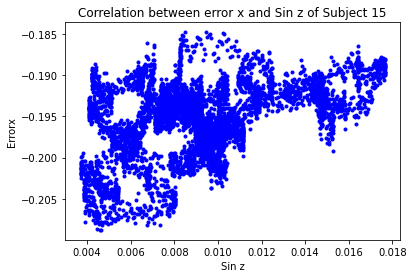

[[1.         0.41920293]
 [0.41920293 1.        ]]


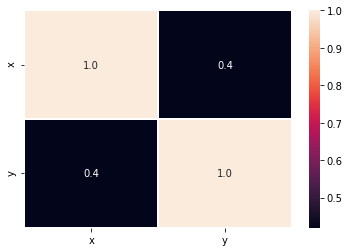

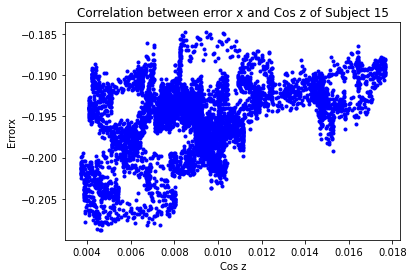

[[1.         0.41920293]
 [0.41920293 1.        ]]


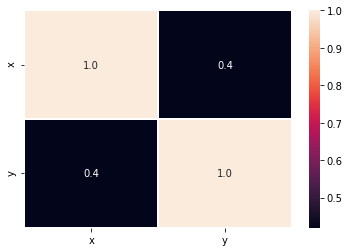

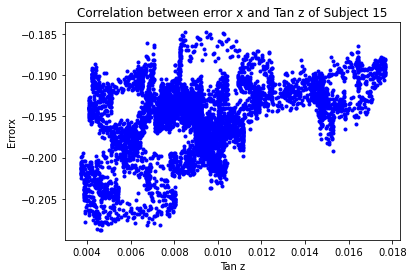

[[1.         0.41920269]
 [0.41920269 1.        ]]


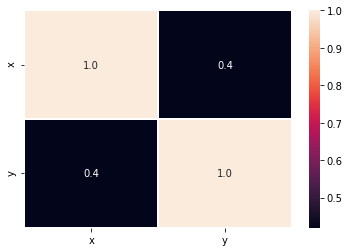

126.3
[-2.33845776e-04 -2.32789918e-04 -2.33842259e-04 ...  4.03384392e-06
  4.03347395e-06  4.03296088e-06]


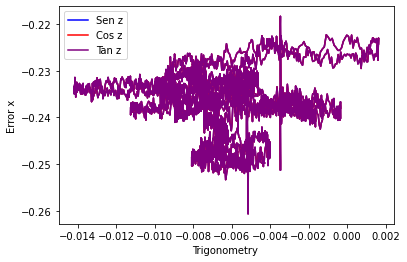

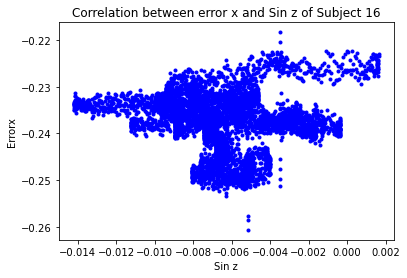

[[ 1.         -0.03870729]
 [-0.03870729  1.        ]]


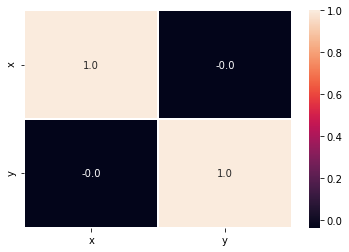

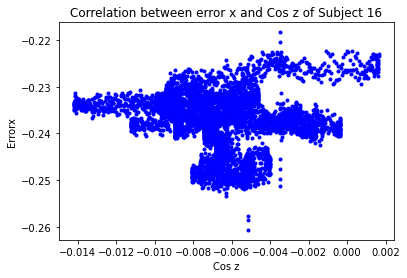

[[ 1.         -0.03870729]
 [-0.03870729  1.        ]]


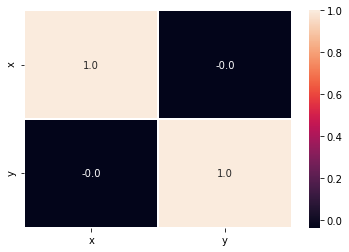

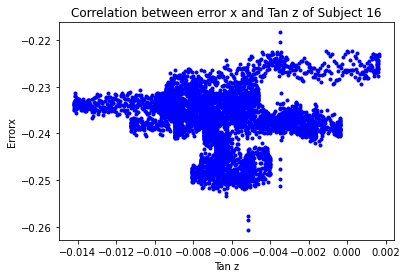

[[ 1.         -0.03871832]
 [-0.03871832  1.        ]]


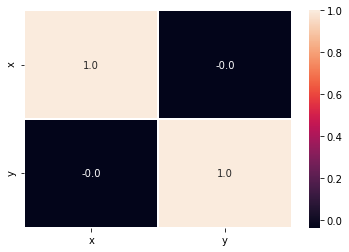

126.3
[ 3.38936963e-06  1.51466815e-04 -6.95949657e-04 ... -4.86398730e-04
 -4.86534091e-04 -4.86716271e-04]


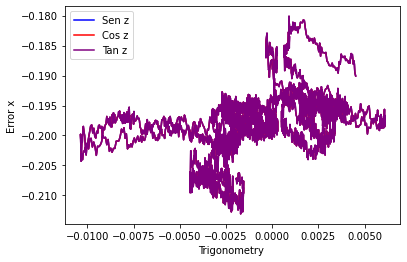

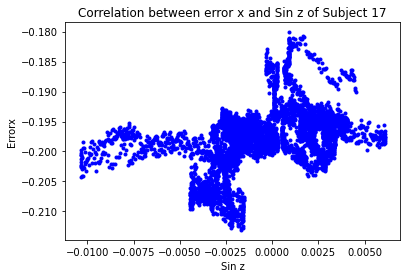

[[1.         0.42222955]
 [0.42222955 1.        ]]


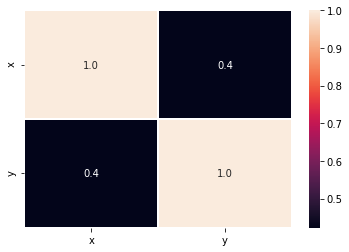

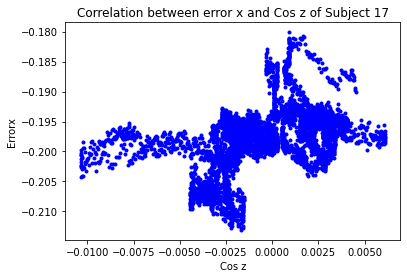

[[1.         0.42222955]
 [0.42222955 1.        ]]


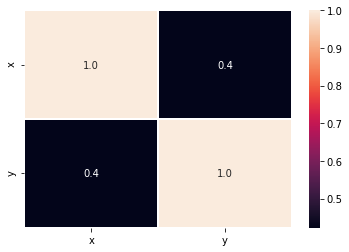

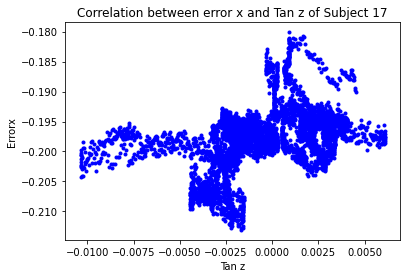

[[1.         0.42222633]
 [0.42222633 1.        ]]


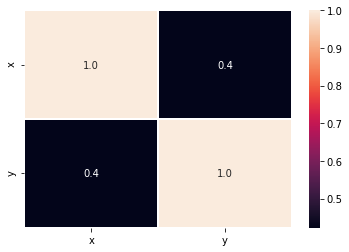

126.3
[ 0.00111058  0.00088068  0.00112563 ... -0.00086259 -0.00086261
 -0.00086264]


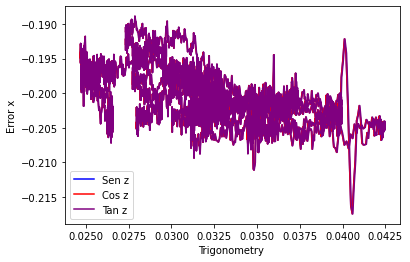

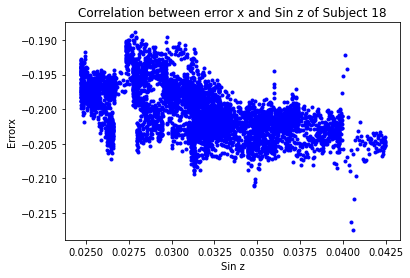

[[ 1.         -0.54421608]
 [-0.54421608  1.        ]]


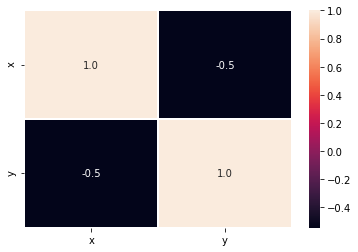

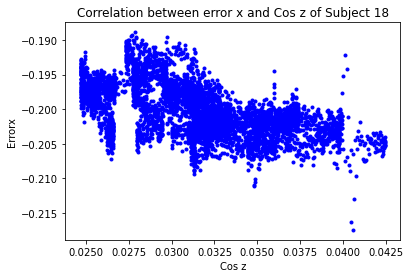

[[ 1.         -0.54421608]
 [-0.54421608  1.        ]]


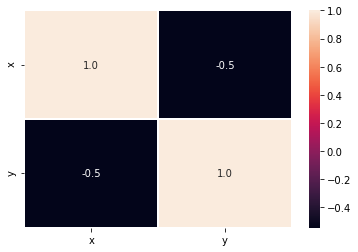

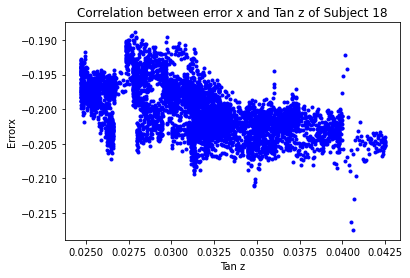

[[ 1.         -0.54420053]
 [-0.54420053  1.        ]]


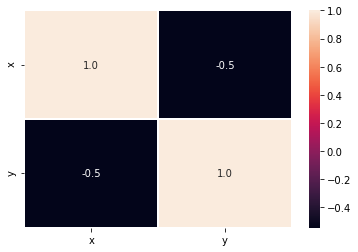

126.3
[ 0.00251436  0.00224008  0.00421654 ... -0.00039767 -0.00039775
 -0.00039786]


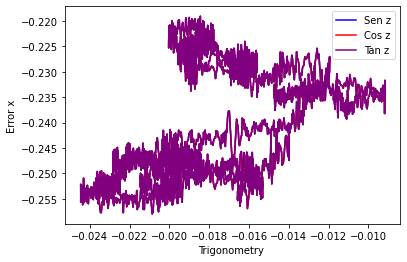

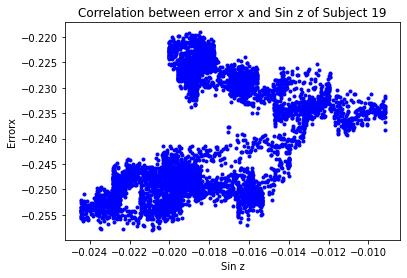

[[1.       0.373951]
 [0.373951 1.      ]]


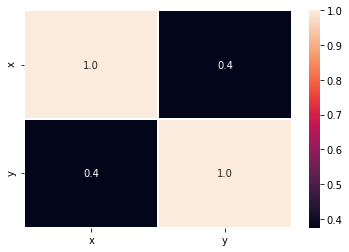

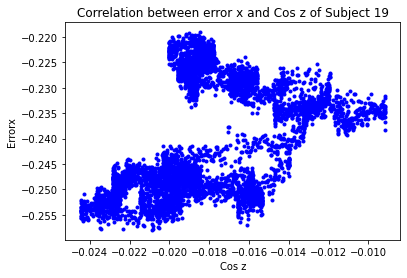

[[1.       0.373951]
 [0.373951 1.      ]]


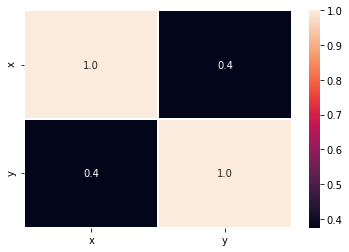

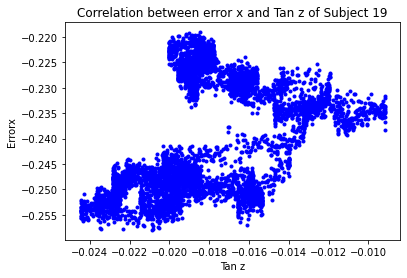

[[1.         0.37398468]
 [0.37398468 1.        ]]


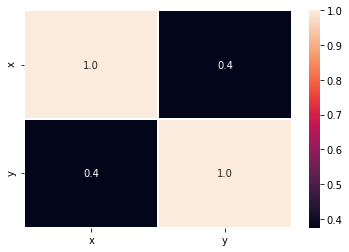

126.3
[-0.00114876 -0.00068501 -0.00022313 ...  0.00021031  0.0002103
  0.00021028]


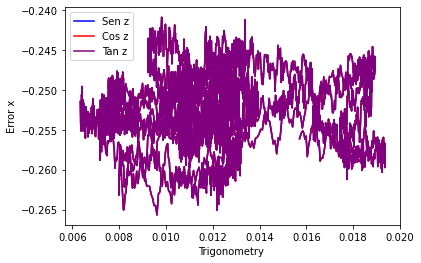

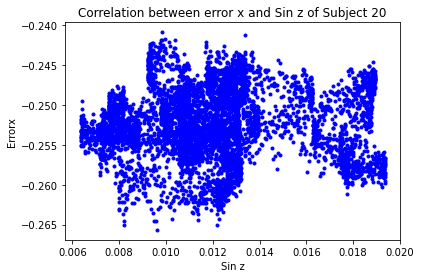

[[1.         0.00217772]
 [0.00217772 1.        ]]


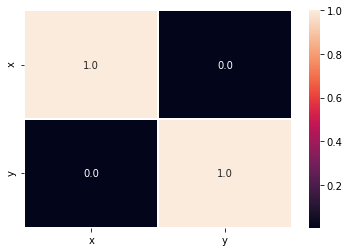

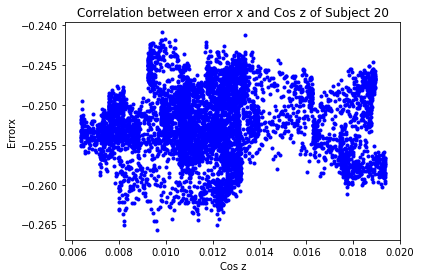

[[1.         0.00217772]
 [0.00217772 1.        ]]


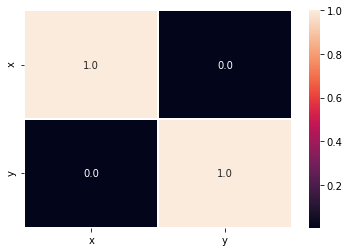

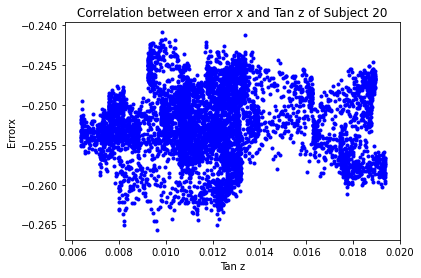

[[1.         0.00217288]
 [0.00217288 1.        ]]


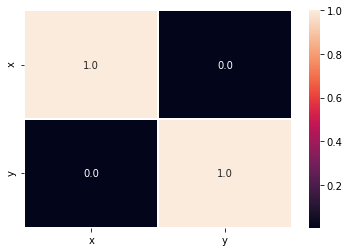

126.3
[ 0.00015677  0.00087944  0.00144457 ... -0.0002993  -0.00029929
 -0.00029928]


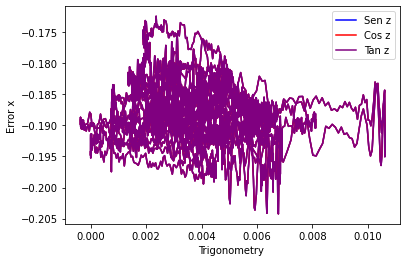

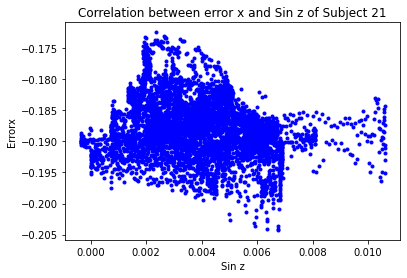

[[ 1.         -0.18851524]
 [-0.18851524  1.        ]]


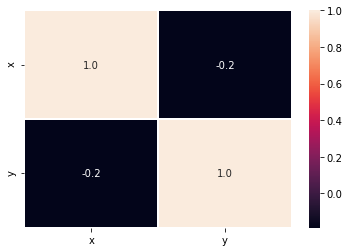

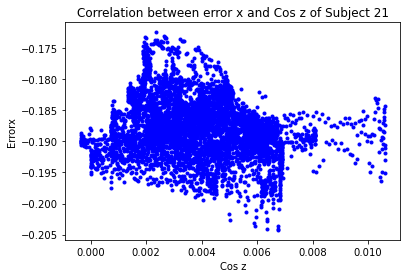

[[ 1.         -0.18851524]
 [-0.18851524  1.        ]]


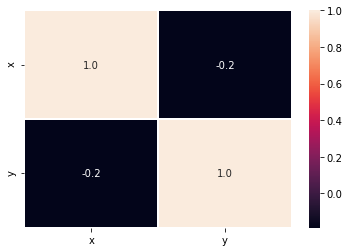

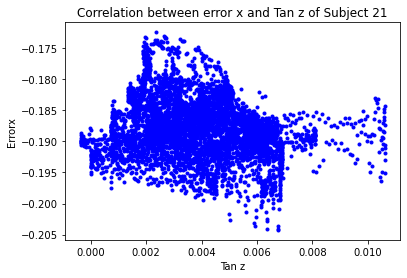

[[ 1.        -0.1885164]
 [-0.1885164  1.       ]]


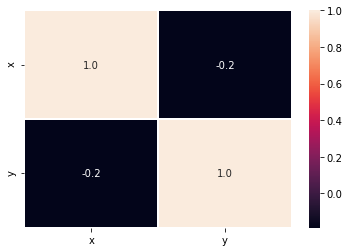

126.3
[ 2.02365423e-03  8.97753611e-04  2.02382804e-03 ... -2.98725578e-06
 -2.98778049e-06 -2.98870067e-06]


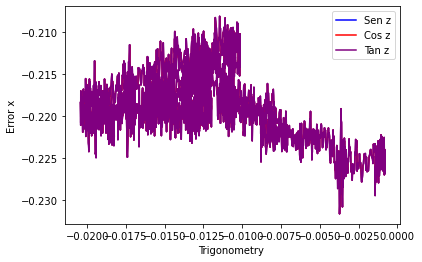

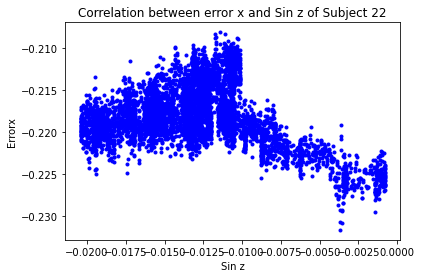

[[ 1.         -0.27707302]
 [-0.27707302  1.        ]]


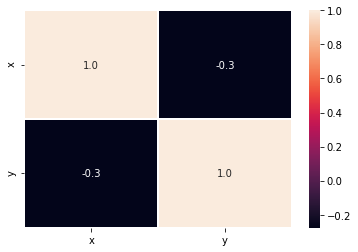

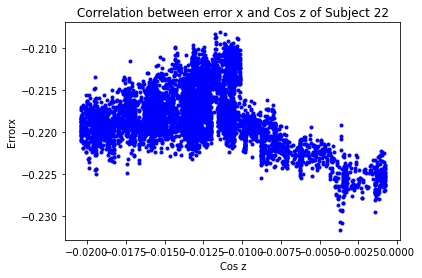

[[ 1.         -0.27707302]
 [-0.27707302  1.        ]]


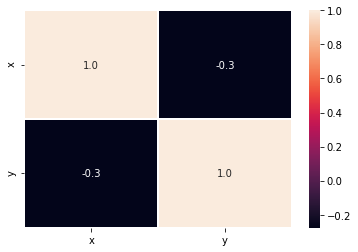

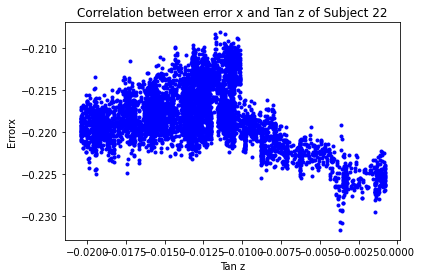

[[ 1.         -0.27701432]
 [-0.27701432  1.        ]]


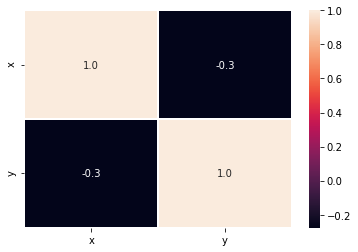

126.3
[-0.00142235 -0.00099119 -0.00142234 ...  0.00078366  0.00078364
  0.0007836 ]


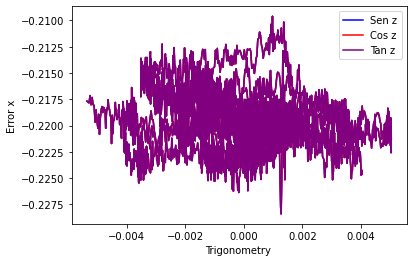

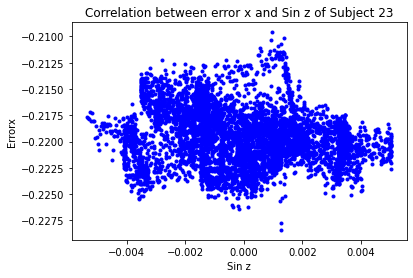

[[ 1.         -0.18720773]
 [-0.18720773  1.        ]]


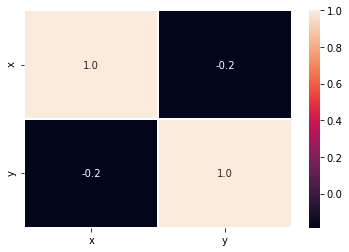

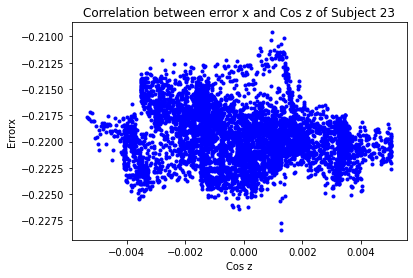

[[ 1.         -0.18720773]
 [-0.18720773  1.        ]]


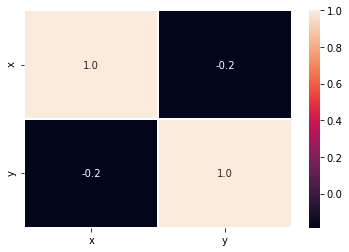

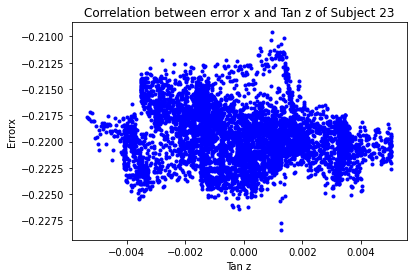

[[ 1.         -0.18720744]
 [-0.18720744  1.        ]]


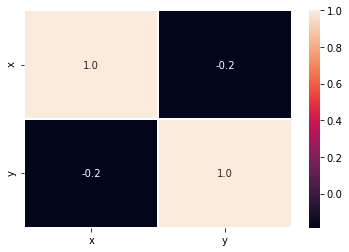

52.9
[0.00037378 0.00178077 0.00196912 ... 0.00041847 0.00041832 0.00041811]


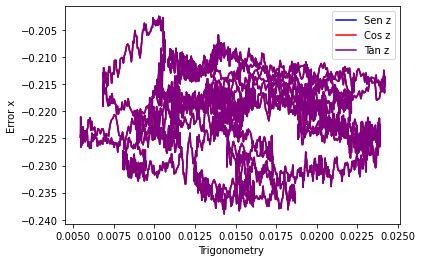

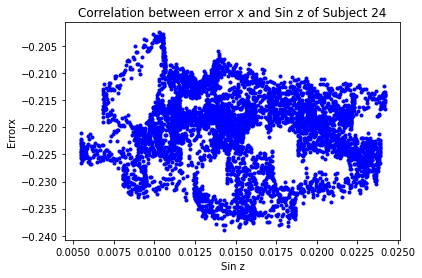

[[ 1.         -0.13183457]
 [-0.13183457  1.        ]]


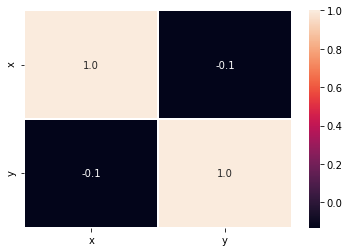

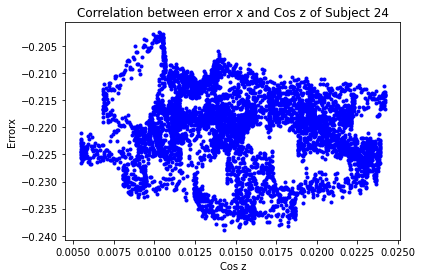

[[ 1.         -0.13183457]
 [-0.13183457  1.        ]]


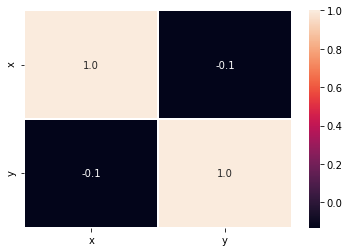

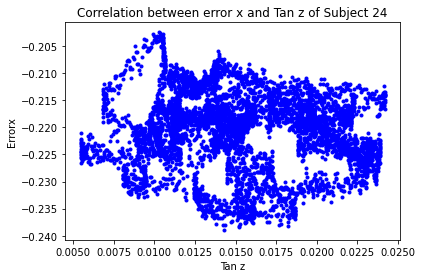

[[ 1.         -0.13184229]
 [-0.13184229  1.        ]]


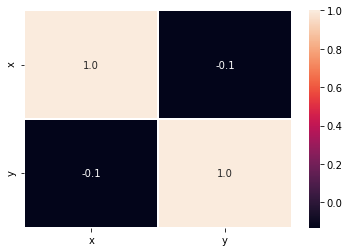

52.9
[2.20048971e-03 3.16095813e-03 2.90296228e-03 ... 2.76927244e-08
 2.76928517e-08 2.76930553e-08]


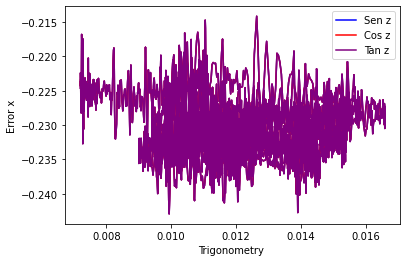

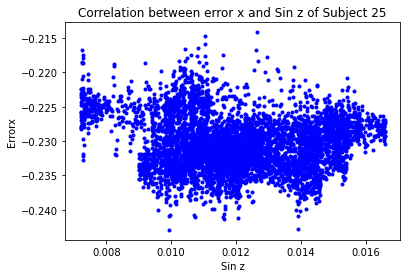

[[ 1.         -0.11170492]
 [-0.11170492  1.        ]]


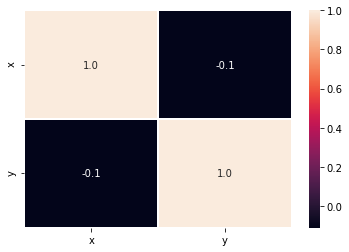

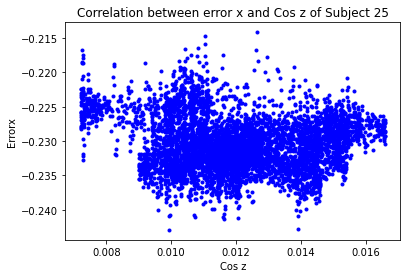

[[ 1.         -0.11170492]
 [-0.11170492  1.        ]]


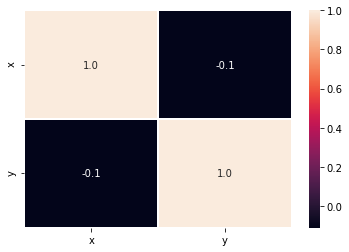

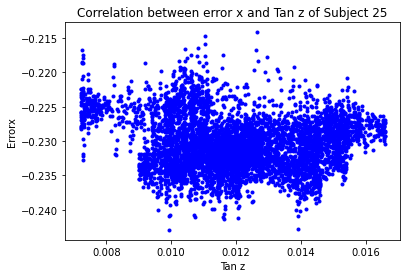

[[ 1.         -0.11169145]
 [-0.11169145  1.        ]]


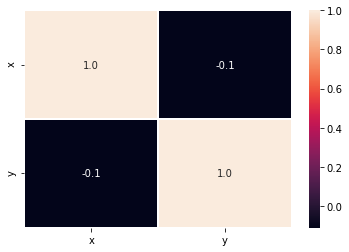

52.9
[0.00262089 0.00111268 0.00370495 ... 0.00123841 0.00123839 0.00123836]


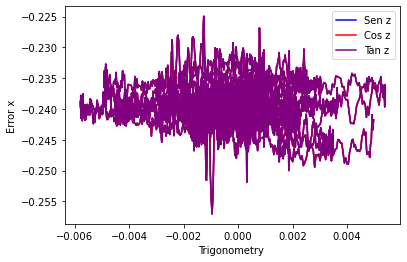

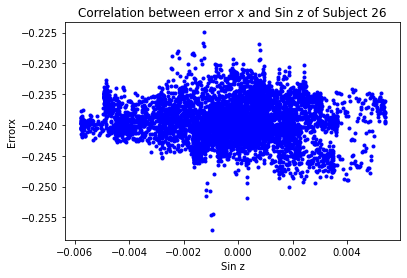

[[ 1.         -0.09471641]
 [-0.09471641  1.        ]]


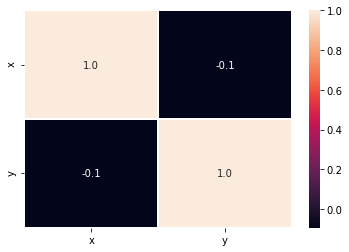

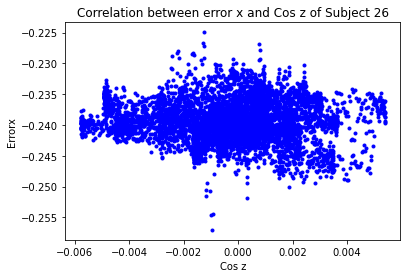

[[ 1.         -0.09471641]
 [-0.09471641  1.        ]]


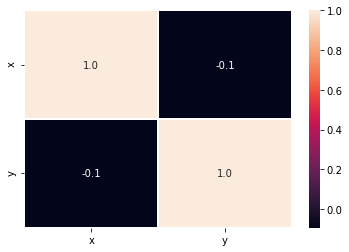

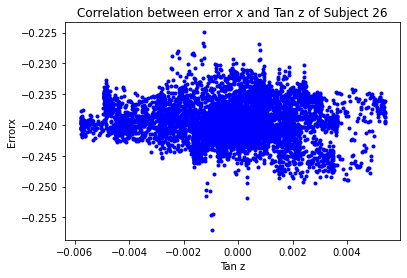

[[ 1.         -0.09471662]
 [-0.09471662  1.        ]]


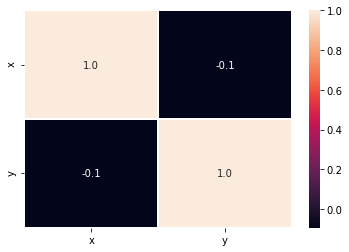

52.9
[ 0.00103392 -0.00028314  0.00205582 ...  0.00023084  0.00023085
  0.00023087]


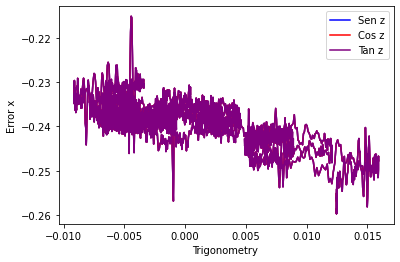

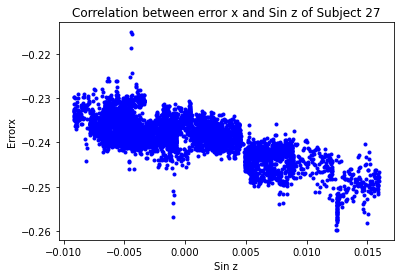

[[ 1.         -0.70447521]
 [-0.70447521  1.        ]]


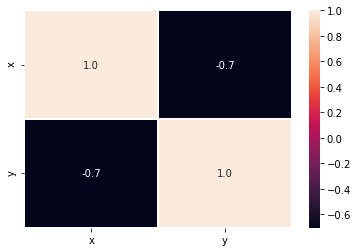

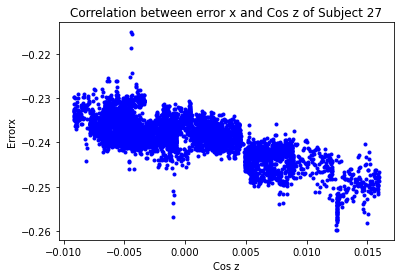

[[ 1.         -0.70447521]
 [-0.70447521  1.        ]]


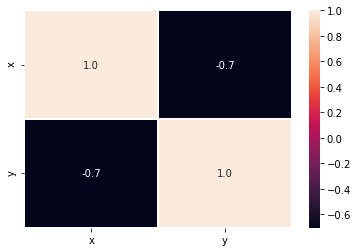

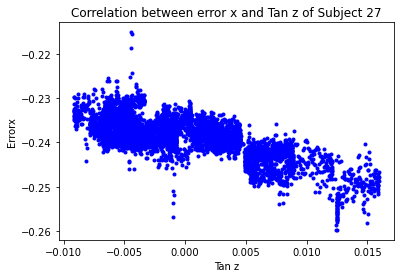

[[ 1.         -0.70448045]
 [-0.70448045  1.        ]]


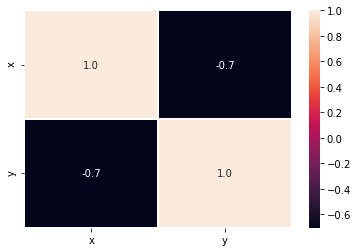

52.9
[-0.00130157 -0.00130383 -0.00161987 ...  0.00070539  0.00070535
  0.00070529]


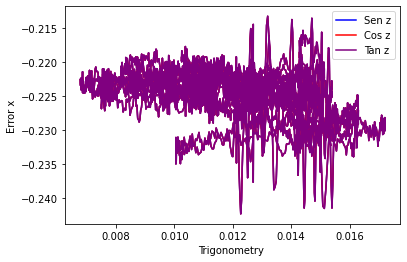

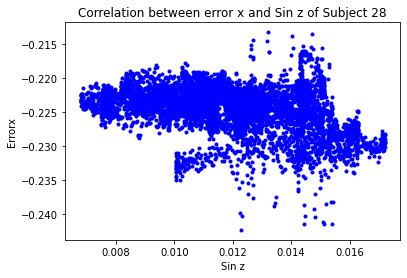

[[ 1.         -0.33998266]
 [-0.33998266  1.        ]]


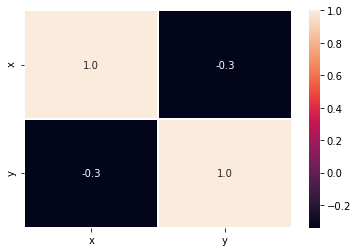

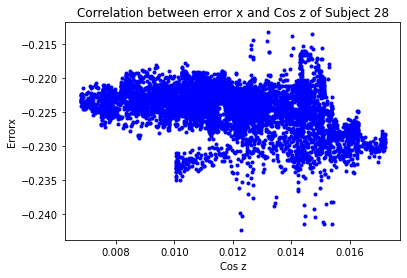

[[ 1.         -0.33998266]
 [-0.33998266  1.        ]]


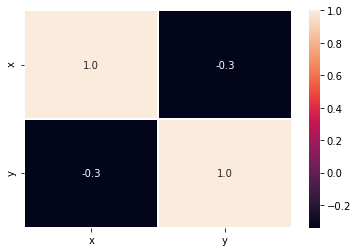

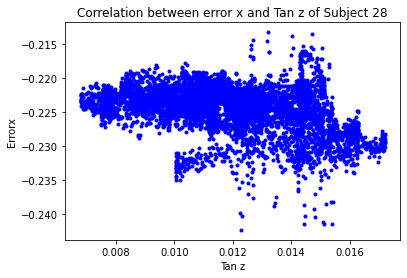

[[ 1.         -0.33999048]
 [-0.33999048  1.        ]]


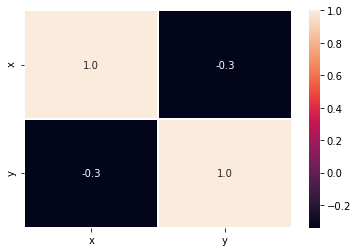

52.9
[ 0.00080459  0.00080411  0.00080364 ... -0.00152081 -0.00152133
 -0.00152207]


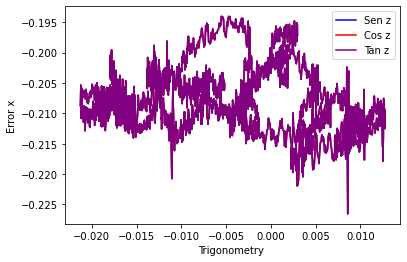

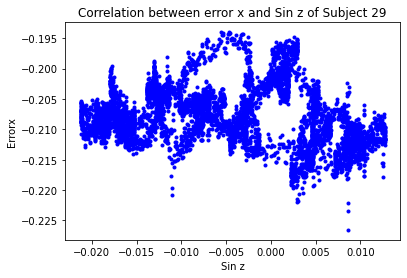

[[ 1.         -0.19678676]
 [-0.19678676  1.        ]]


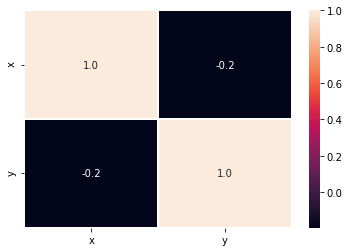

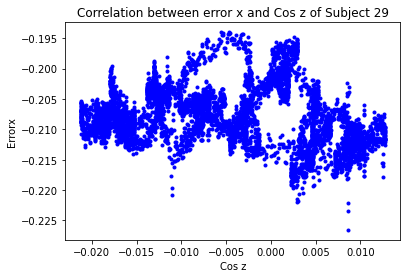

[[ 1.         -0.19678676]
 [-0.19678676  1.        ]]


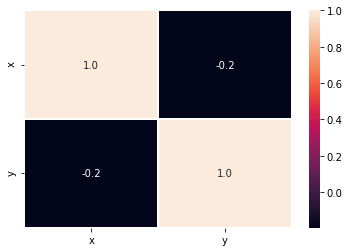

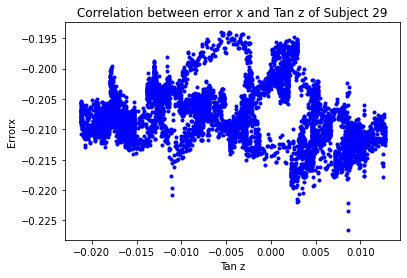

[[ 1.         -0.19676766]
 [-0.19676766  1.        ]]


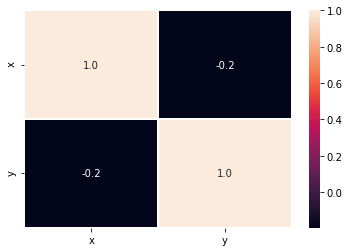

52.9
[ 1.33152377e-03 -3.17222877e-07  1.63082518e-03 ...  9.81761181e-04
  9.81690504e-04  9.81578524e-04]


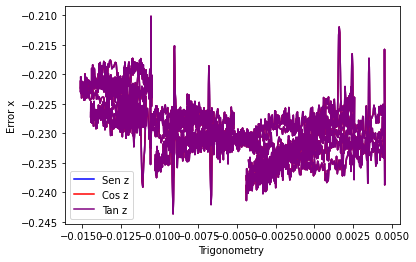

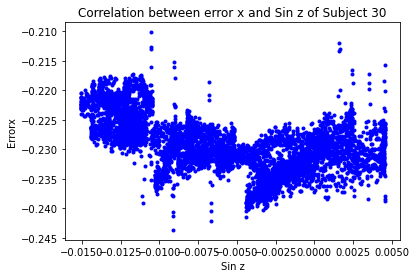

[[ 1.        -0.5558517]
 [-0.5558517  1.       ]]


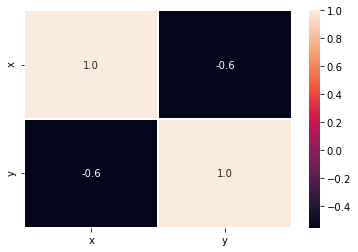

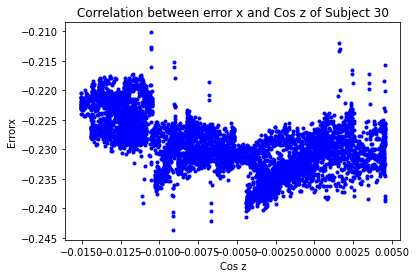

[[ 1.        -0.5558517]
 [-0.5558517  1.       ]]


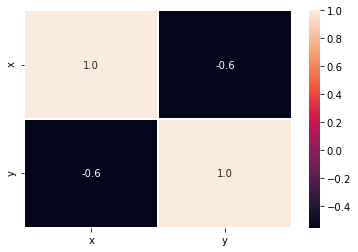

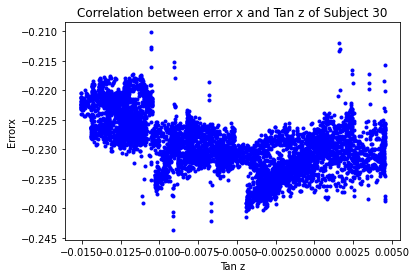

[[ 1.         -0.55586763]
 [-0.55586763  1.        ]]


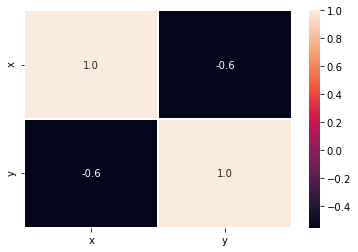

52.9
[-0.00460512 -0.00441523 -0.00380602 ...  0.00139619  0.00139644
  0.00139676]


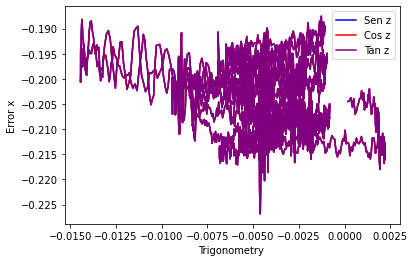

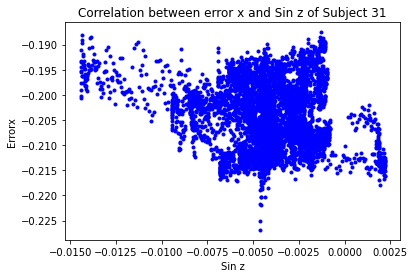

[[ 1.         -0.17360423]
 [-0.17360423  1.        ]]


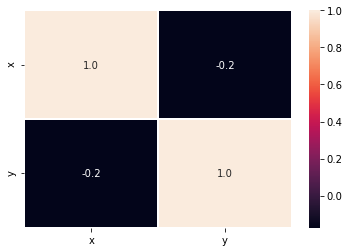

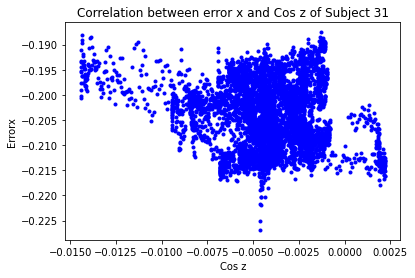

[[ 1.         -0.17360423]
 [-0.17360423  1.        ]]


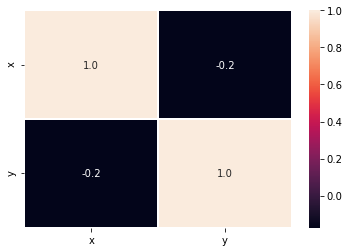

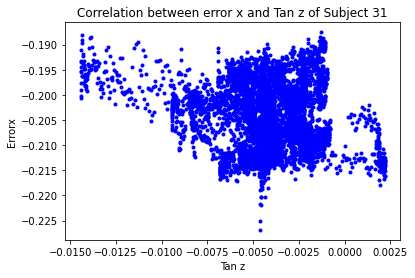

[[ 1.         -0.17360863]
 [-0.17360863  1.        ]]


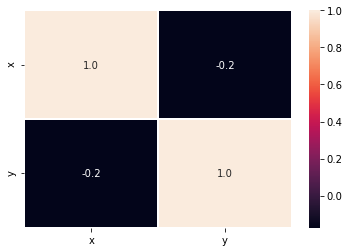

52.9
[ 0.00096849 -0.00023811 -0.00066757 ... -0.00183837 -0.00183851
 -0.00183874]


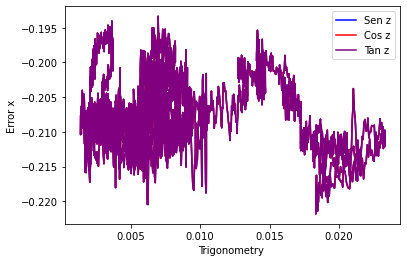

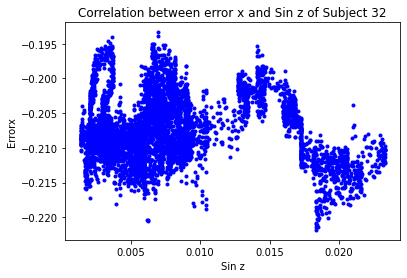

[[ 1.         -0.11739468]
 [-0.11739468  1.        ]]


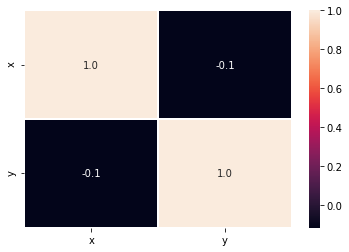

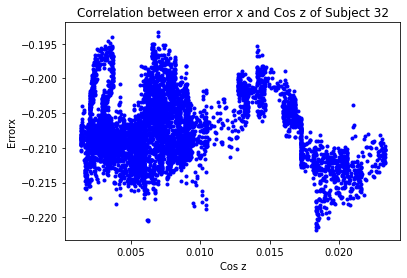

[[ 1.         -0.11739468]
 [-0.11739468  1.        ]]


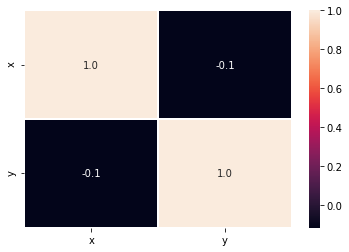

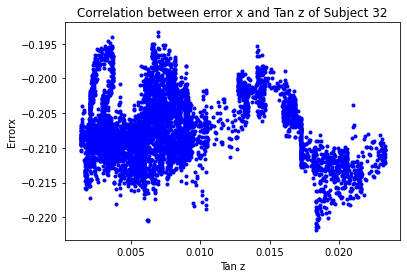

[[ 1.         -0.11742565]
 [-0.11742565  1.        ]]


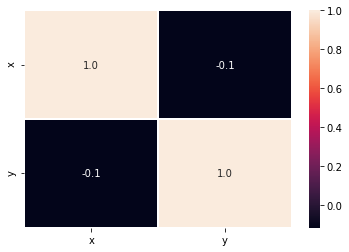

52.9
[-0.00069392  0.00068588 -0.00046576 ... -0.00020688 -0.00020688
 -0.00020687]


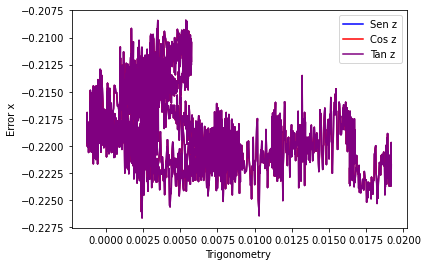

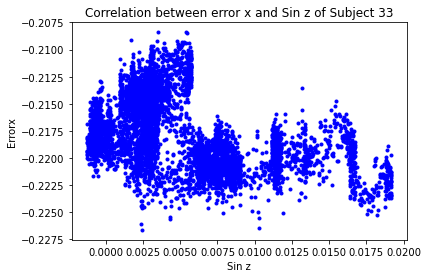

[[ 1.         -0.44340386]
 [-0.44340386  1.        ]]


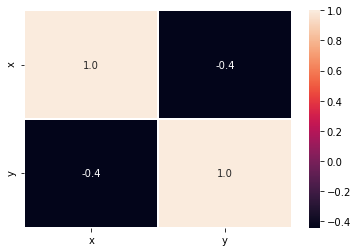

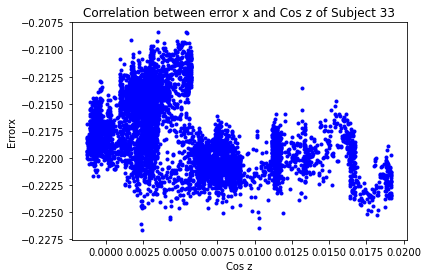

[[ 1.         -0.44340386]
 [-0.44340386  1.        ]]


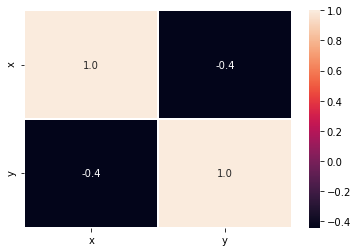

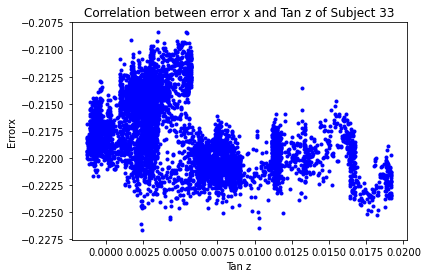

[[ 1.        -0.4434018]
 [-0.4434018  1.       ]]


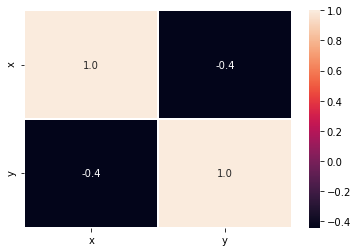

52.9
[-0.01178569 -0.01096075 -0.00434326 ...  0.00168401  0.00168443
  0.001685  ]


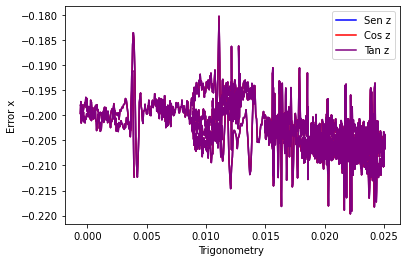

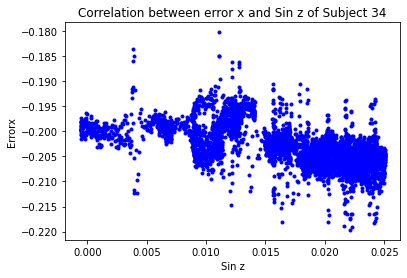

[[ 1.         -0.62116897]
 [-0.62116897  1.        ]]


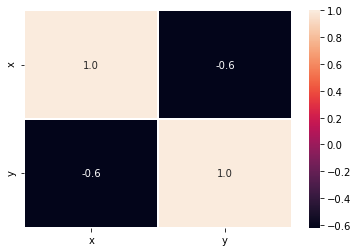

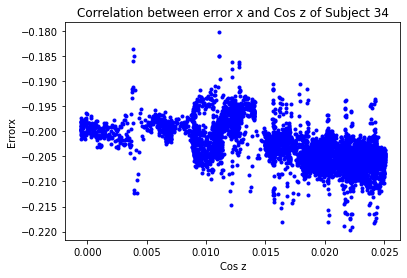

[[ 1.         -0.62116897]
 [-0.62116897  1.        ]]


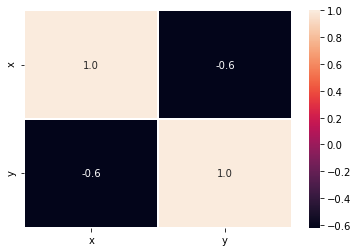

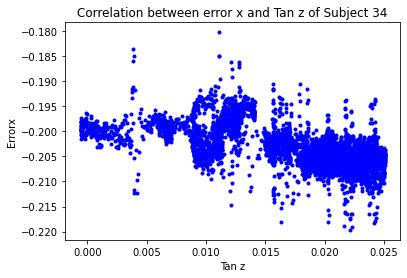

[[ 1.         -0.62118825]
 [-0.62118825  1.        ]]


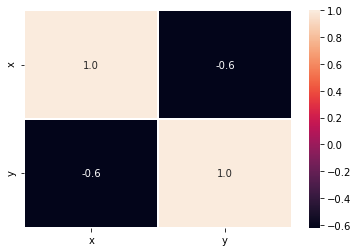

52.9
[ 3.29540281e-04  1.38905677e-07  2.55830973e-03 ... -4.53703589e-06
 -4.53710854e-06 -4.53723315e-06]


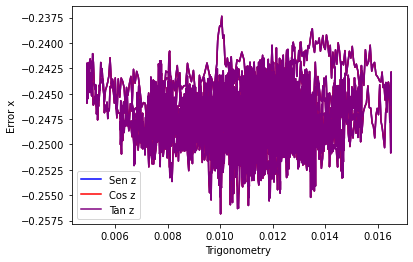

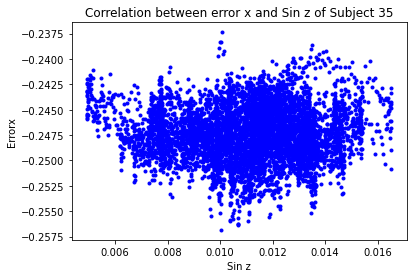

[[1.        0.0045971]
 [0.0045971 1.       ]]


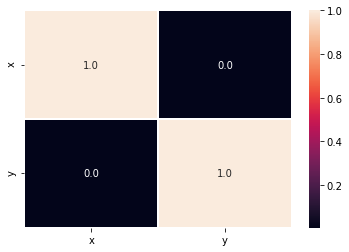

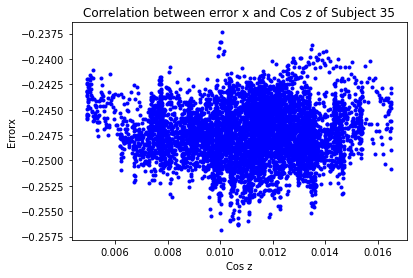

[[1.        0.0045971]
 [0.0045971 1.       ]]


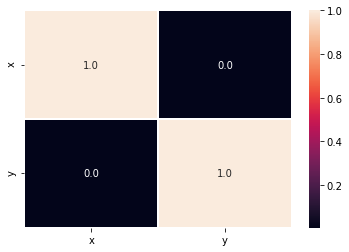

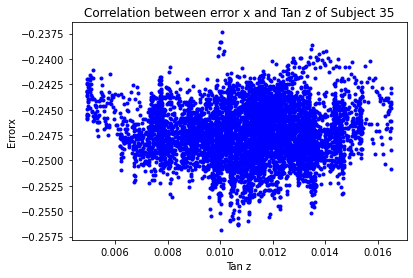

[[1.         0.00460358]
 [0.00460358 1.        ]]


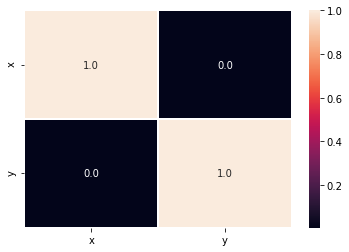

75.85
[-0.00759797 -0.00330673  0.00386649 ...  0.00191159  0.0019116
  0.00191159]


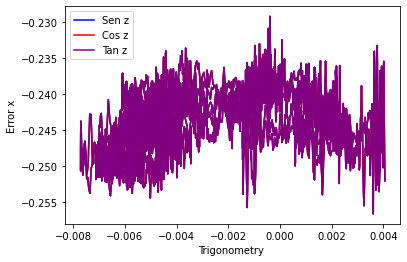

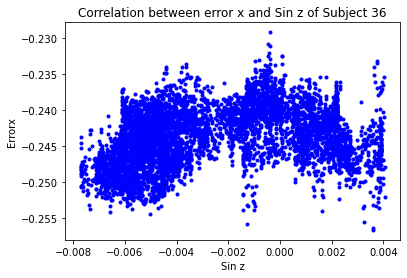

[[1.         0.29195527]
 [0.29195527 1.        ]]


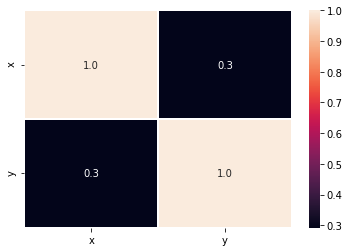

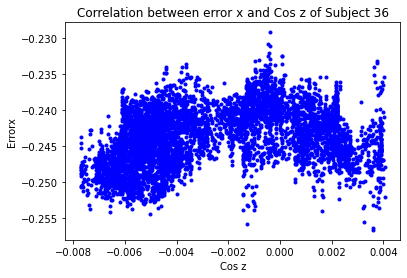

[[1.         0.29195527]
 [0.29195527 1.        ]]


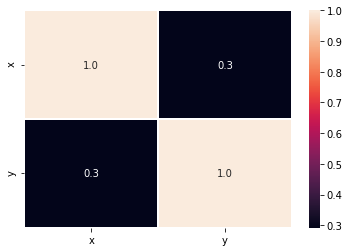

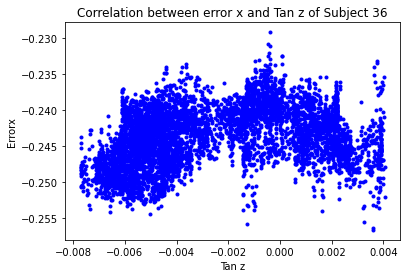

[[1.         0.29195783]
 [0.29195783 1.        ]]


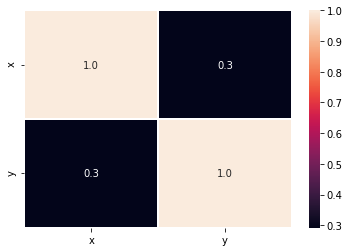

75.85
[ 0.00114163  0.004138    0.00206866 ... -0.00156783 -0.00156747
 -0.00156698]


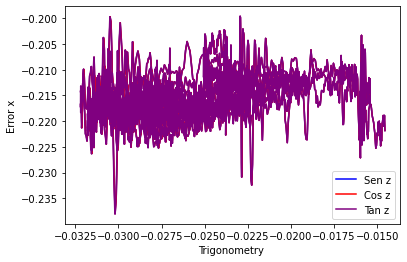

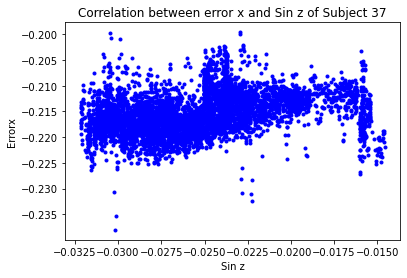

[[1.         0.31763764]
 [0.31763764 1.        ]]


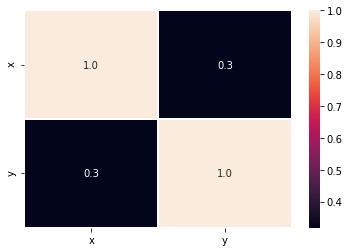

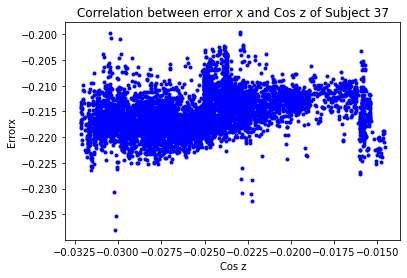

[[1.         0.31763764]
 [0.31763764 1.        ]]


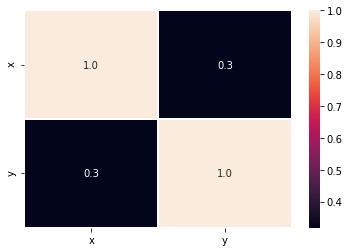

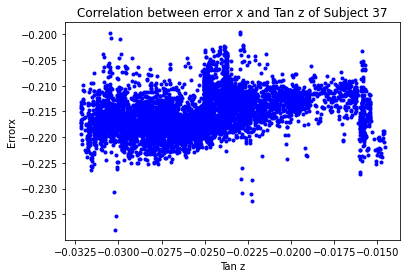

[[1.         0.31765544]
 [0.31765544 1.        ]]


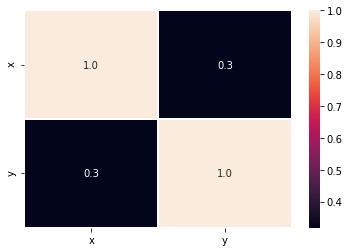

75.85
[-0.00098419 -0.00098931 -0.00125243 ...  0.00238367  0.0023837
  0.0023837 ]


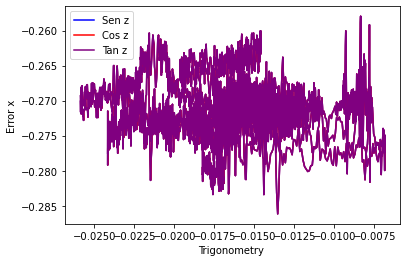

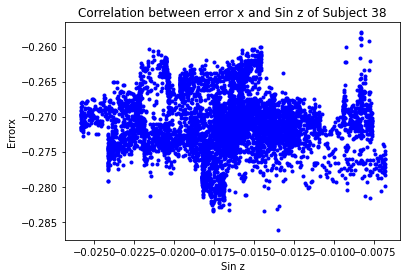

[[ 1.         -0.01996977]
 [-0.01996977  1.        ]]


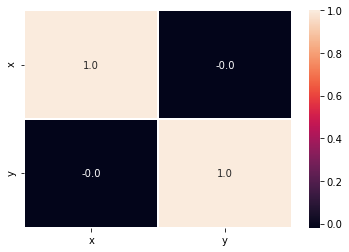

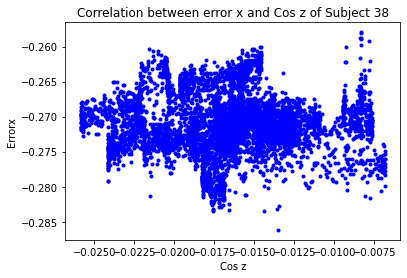

[[ 1.         -0.01996977]
 [-0.01996977  1.        ]]


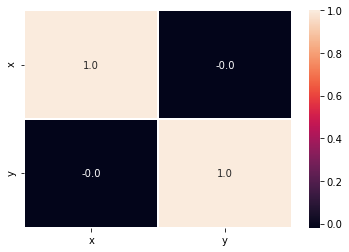

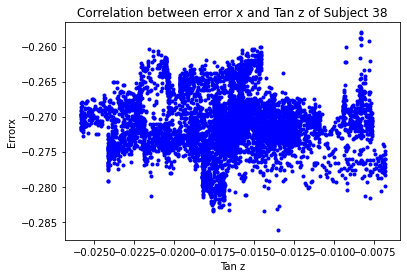

[[ 1.         -0.01996738]
 [-0.01996738  1.        ]]


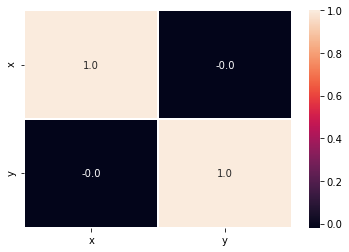

75.85
[-0.00160655 -0.00056865 -0.00018943 ...  0.0008693   0.00086929
  0.00086927]


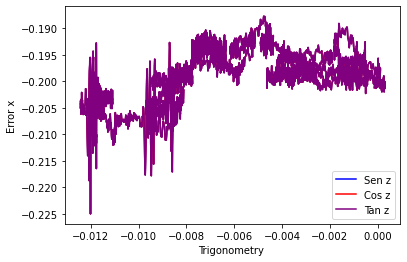

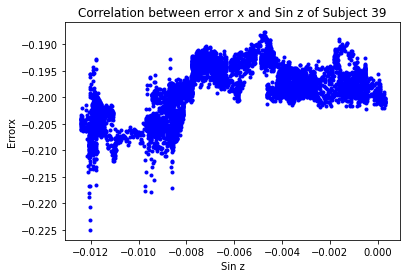

[[1.         0.55151475]
 [0.55151475 1.        ]]


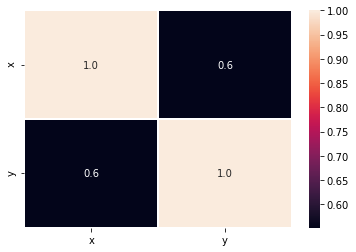

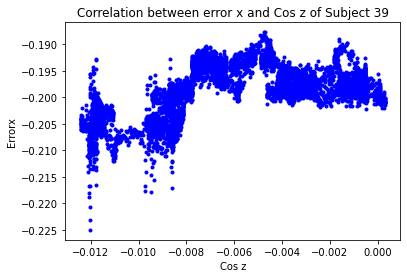

[[1.         0.55151475]
 [0.55151475 1.        ]]


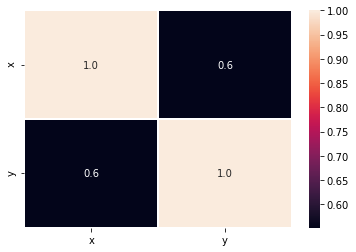

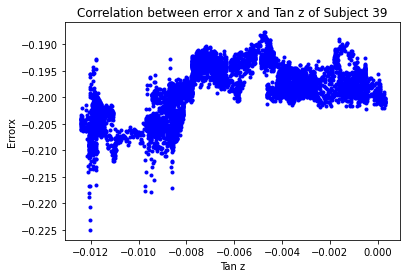

[[1.         0.55152841]
 [0.55152841 1.        ]]


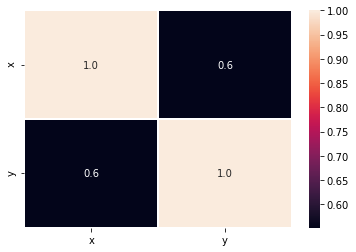

75.85
[ 1.32064406e-06  7.70183879e-04  9.47374020e-04 ... -1.73715057e-04
 -1.73725011e-04 -1.73739318e-04]


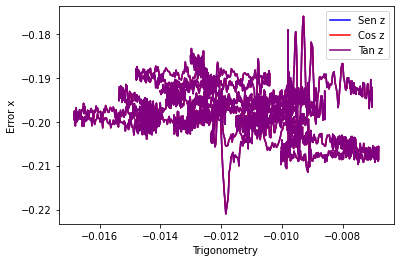

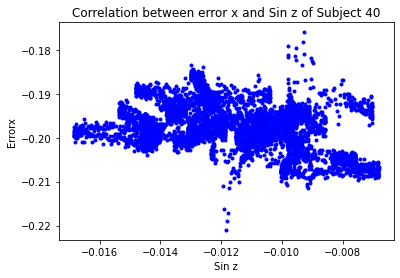

[[ 1.        -0.2779398]
 [-0.2779398  1.       ]]


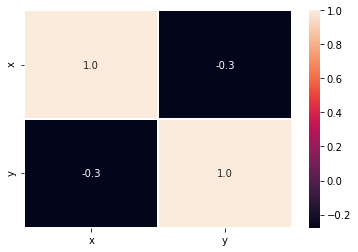

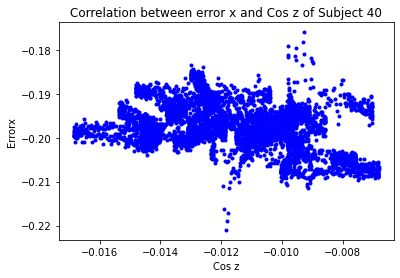

[[ 1.        -0.2779398]
 [-0.2779398  1.       ]]


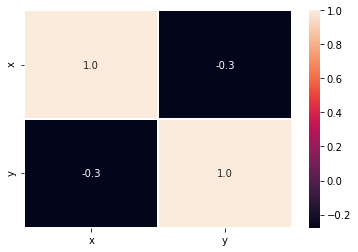

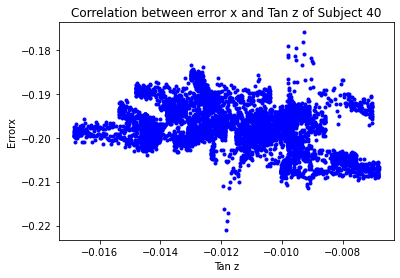

[[ 1.         -0.27792929]
 [-0.27792929  1.        ]]


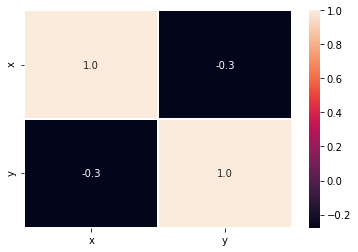

75.85
[ 8.91113432e-06 -2.22366067e-03  9.17484196e-06 ... -1.19976798e-03
 -1.19981300e-03 -1.19989033e-03]


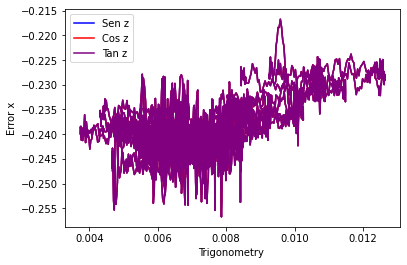

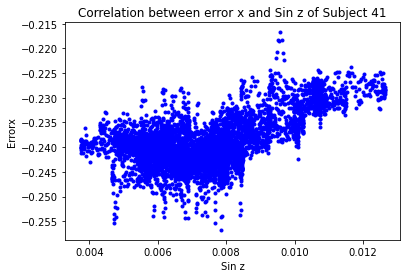

[[1.         0.59895716]
 [0.59895716 1.        ]]


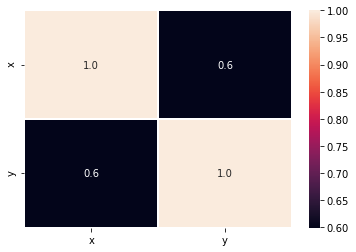

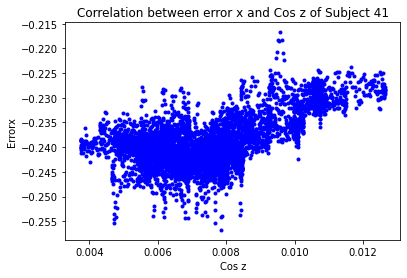

[[1.         0.59895716]
 [0.59895716 1.        ]]


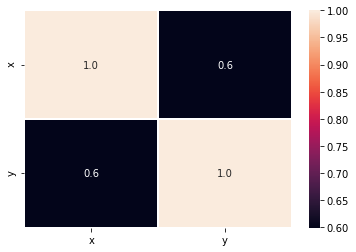

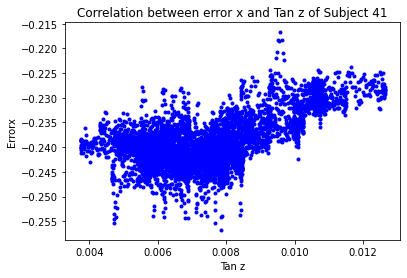

[[1.         0.59896671]
 [0.59896671 1.        ]]


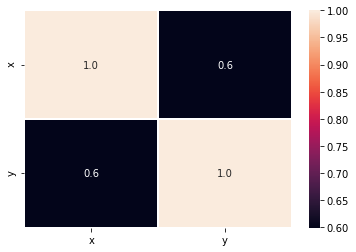

75.85
[-0.00096911  0.00052354 -0.00071761 ... -0.00090305 -0.00090313
 -0.00090324]


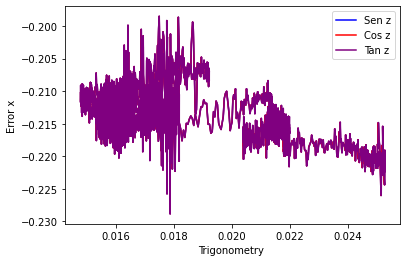

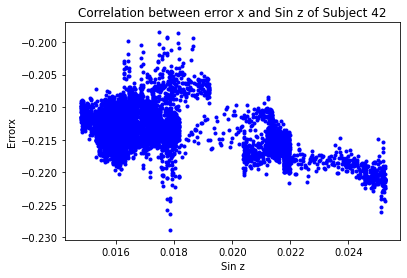

[[ 1.         -0.49569656]
 [-0.49569656  1.        ]]


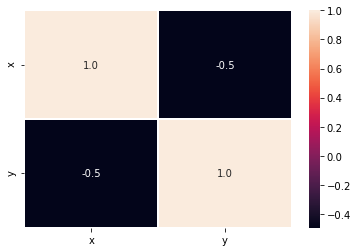

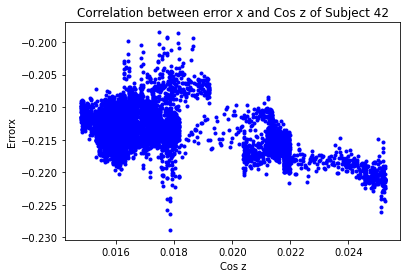

[[ 1.         -0.49569656]
 [-0.49569656  1.        ]]


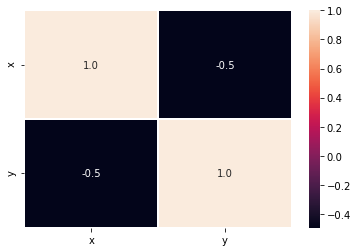

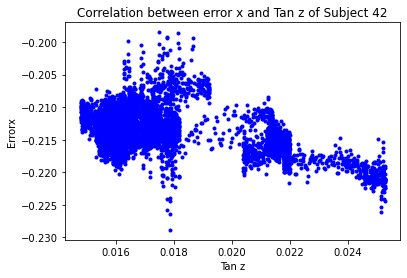

[[ 1.         -0.49571671]
 [-0.49571671  1.        ]]


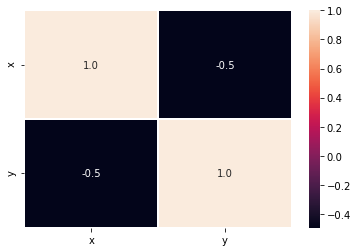

75.85
[-2.89992441e-04  7.13955756e-04  5.71243687e-04 ... -2.73884065e-06
 -2.73848917e-06 -2.73799807e-06]


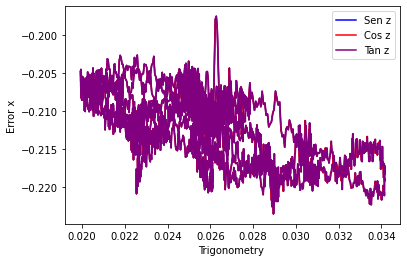

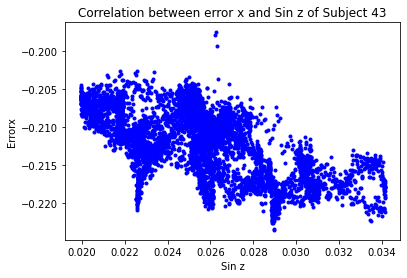

[[ 1.         -0.58881731]
 [-0.58881731  1.        ]]


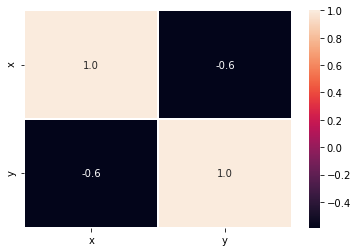

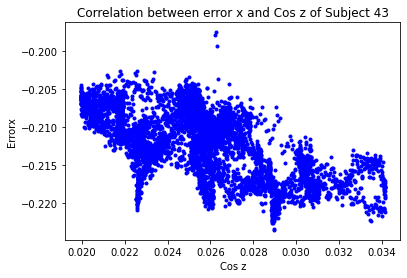

[[ 1.         -0.58881731]
 [-0.58881731  1.        ]]


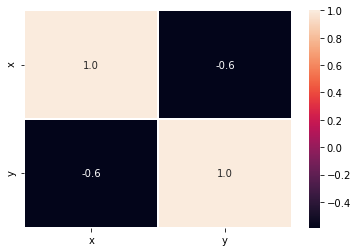

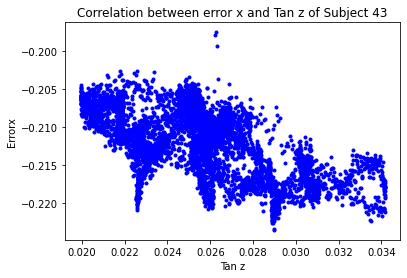

[[ 1.         -0.58882556]
 [-0.58882556  1.        ]]


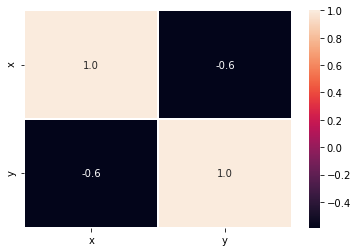

75.85
[ 0.00015061 -0.00055425 -0.00055553 ...  0.0005984   0.00059822
  0.00059797]


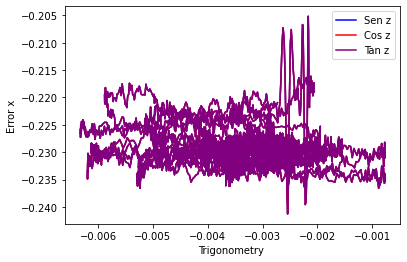

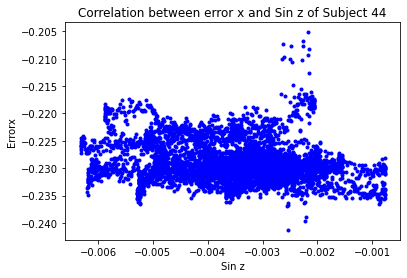

[[ 1.         -0.18531856]
 [-0.18531856  1.        ]]


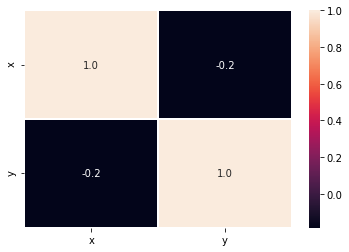

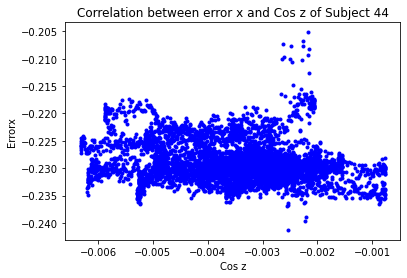

[[ 1.         -0.18531856]
 [-0.18531856  1.        ]]


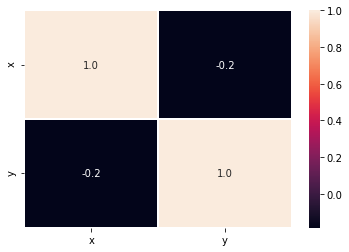

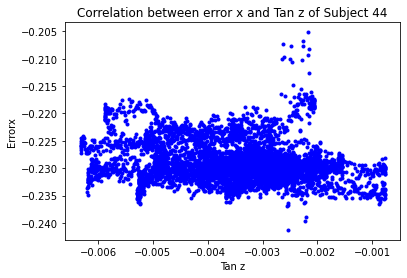

[[ 1.         -0.18531832]
 [-0.18531832  1.        ]]


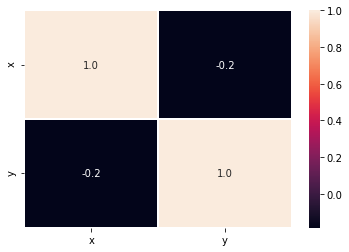

75.85
[-2.17702345e-02 -6.16317339e-03  3.05174706e-03 ...  9.05307372e-07
  9.05431200e-07  9.05572802e-07]


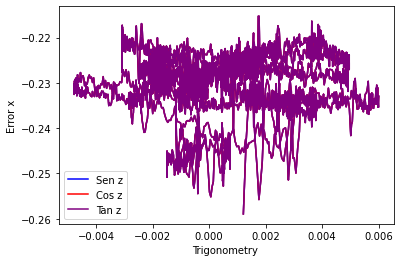

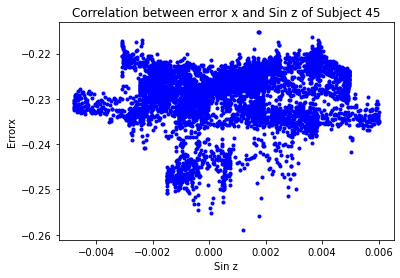

[[1.        0.1044407]
 [0.1044407 1.       ]]


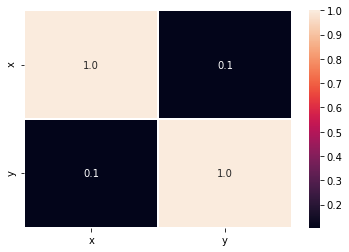

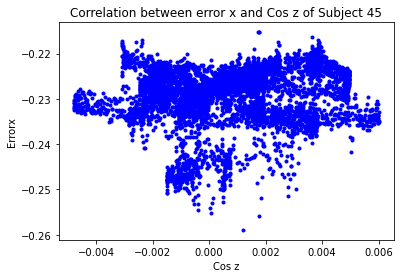

[[1.        0.1044407]
 [0.1044407 1.       ]]


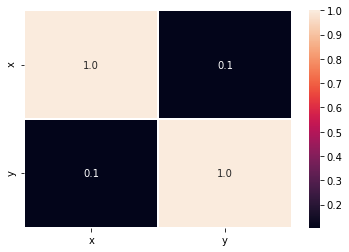

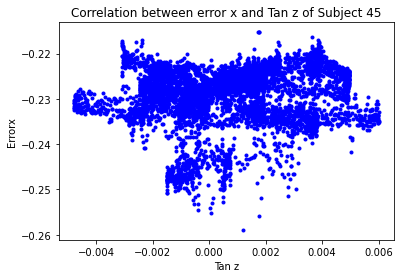

[[1.         0.10444051]
 [0.10444051 1.        ]]


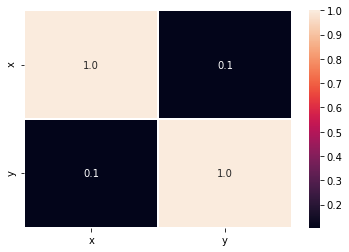

75.85
[-0.00172322 -0.00077161 -0.00137303 ...  0.00015119  0.00015117
  0.00015115]


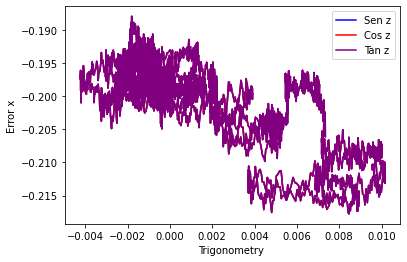

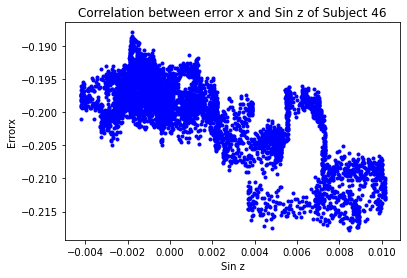

[[ 1.         -0.75089218]
 [-0.75089218  1.        ]]


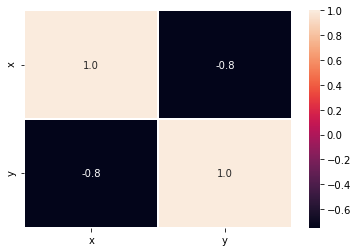

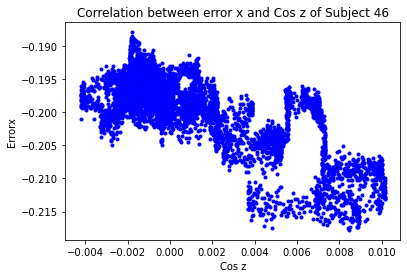

[[ 1.         -0.75089218]
 [-0.75089218  1.        ]]


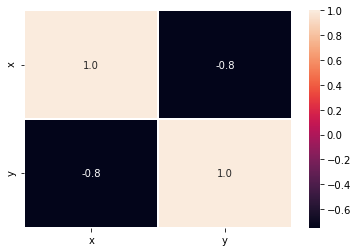

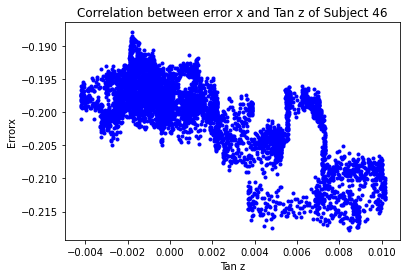

[[ 1.         -0.75089357]
 [-0.75089357  1.        ]]


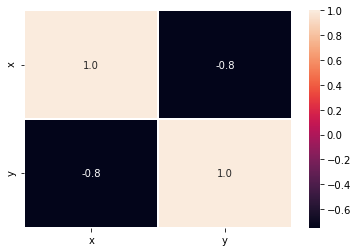

75.85
[ 3.78320705e-06 -2.25276870e-04  6.59448210e-04 ... -1.02632765e-03
 -1.02651370e-03 -1.02678752e-03]


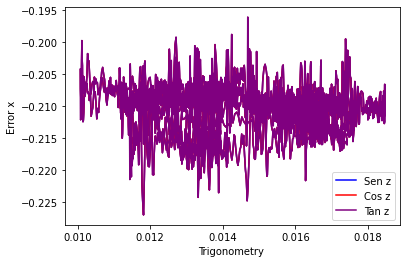

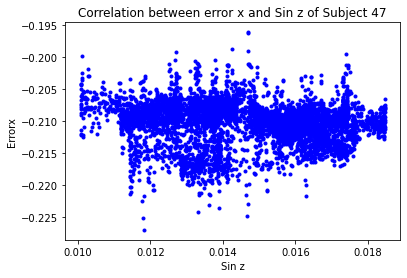

[[ 1.         -0.10194112]
 [-0.10194112  1.        ]]


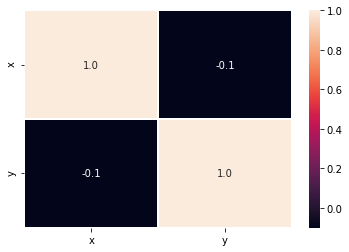

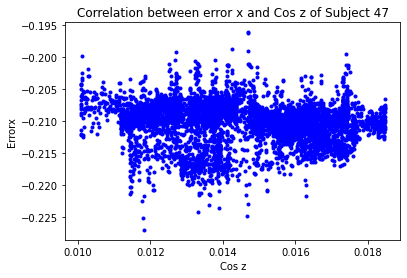

[[ 1.         -0.10194112]
 [-0.10194112  1.        ]]


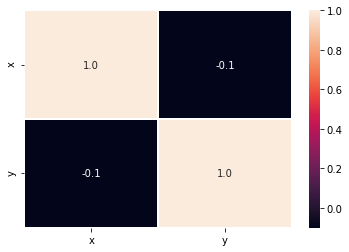

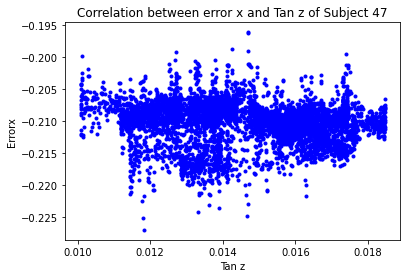

[[ 1.         -0.10193825]
 [-0.10193825  1.        ]]


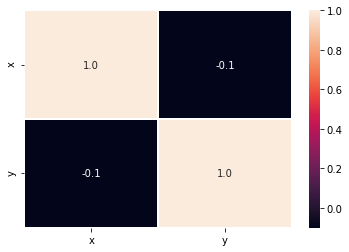

61.05
[-0.0024744  -0.0006725  -0.00294638 ... -0.00236074 -0.0023621
 -0.00236406]


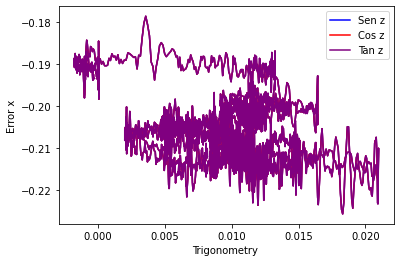

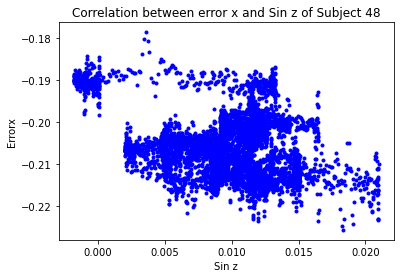

[[ 1.         -0.34027665]
 [-0.34027665  1.        ]]


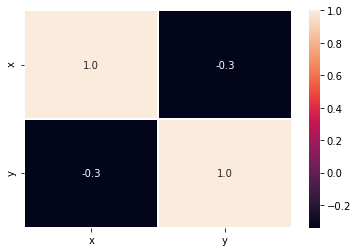

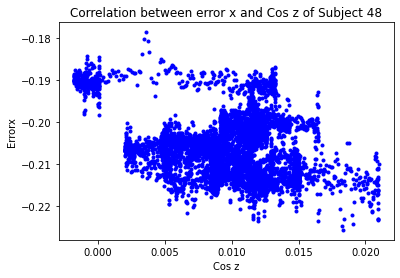

[[ 1.         -0.34027665]
 [-0.34027665  1.        ]]


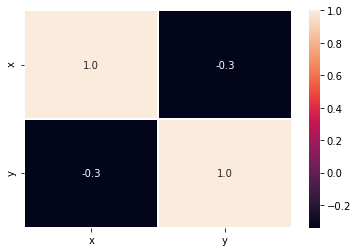

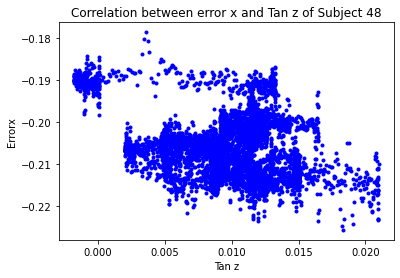

[[ 1.         -0.34026689]
 [-0.34026689  1.        ]]


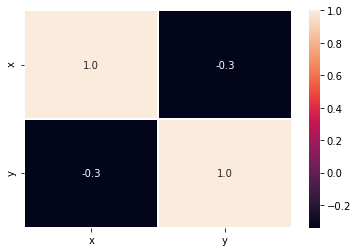

61.05
[ 0.00190906 -0.00064453  0.00046651 ... -0.00208508 -0.00208443
 -0.0020835 ]


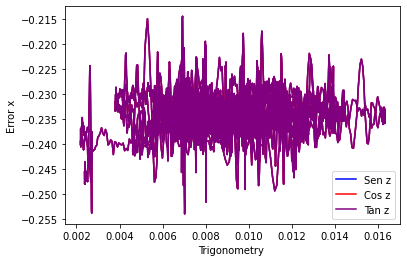

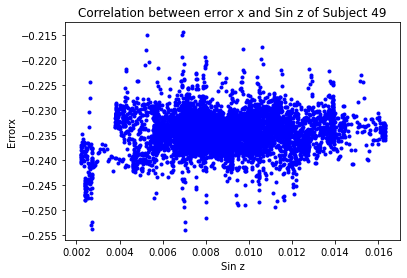

[[1.         0.11687298]
 [0.11687298 1.        ]]


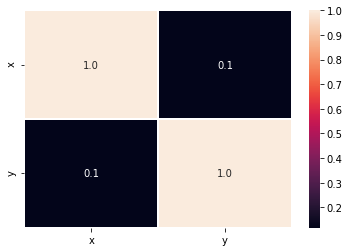

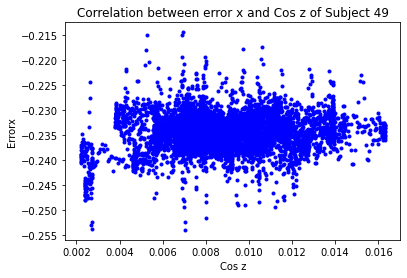

[[1.         0.11687298]
 [0.11687298 1.        ]]


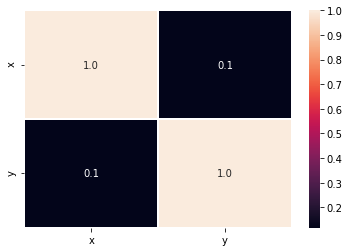

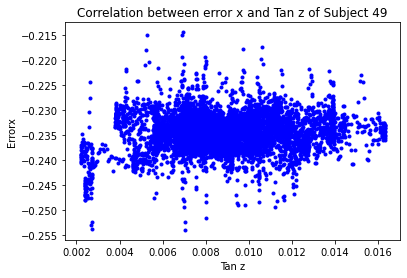

[[1.         0.11686965]
 [0.11686965 1.        ]]


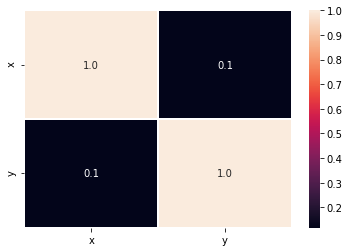

In [13]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    tanx=np.tan(angulox)
    tanz=np.tan(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    print(COPXmatrix)
    plt.figure()
    #plt.plot(t[30:],matrizangx,color='red')
    plt.plot(sinz[30:],errorx,color='blue',label='Sen z')
    plt.plot(cosz[30:],errorx,color='red',label='Cos z')
    plt.plot(tanz[30:],errorx,color='purple',label='Tan z')
    plt.xlabel("Trigonometry ")
    plt.ylabel("Error x")
    plt.legend()
    plt.show()
    data={'x':sinz[30:],
         'y': errorx
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Sin z")
    plt.ylabel("Errorx")
    plt.title("Correlation between error x and Sin z of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(sinz[30:],errorx)
    print(r)
    plt.figure()
    data={'x':sinz[30:],
         'y': errorx
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    data={'x':cosz[30:],
         'y': errorx
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Cos z")
    plt.ylabel("Errorx")
    plt.title("Correlation between error x and Cos z of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(cosz[30:],errorx)
    print(r)
    plt.figure()
    data={'x':cosz[30:],
         'y': errorx
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    data={'x':tanz[30:],
         'y': errorx
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Tan z")
    plt.ylabel("Errorx")
    plt.title("Correlation between error x and Tan z of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(tanz[30:],errorx)
    print(r)
    plt.figure()
    data={'x':tanz[30:],
         'y': errorx
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    

## Correlation Between errorx and first and second derivatives in x

74.3
[-0.00062795 -0.00183479  0.00101439 ...  0.00066651  0.00066671
  0.00066699]


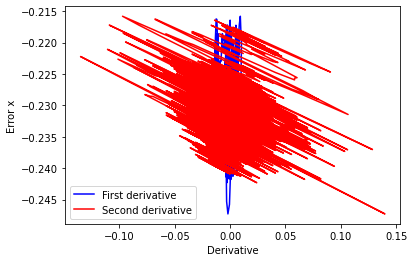

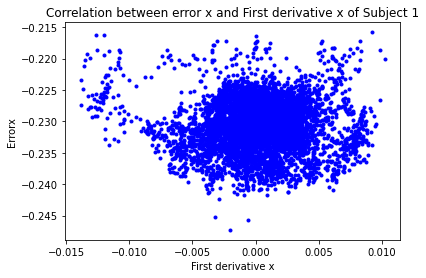

[[ 1.       -0.022251]
 [-0.022251  1.      ]]


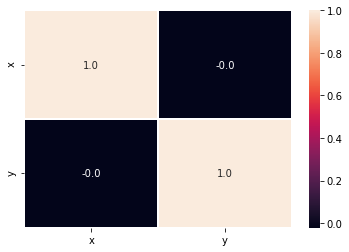

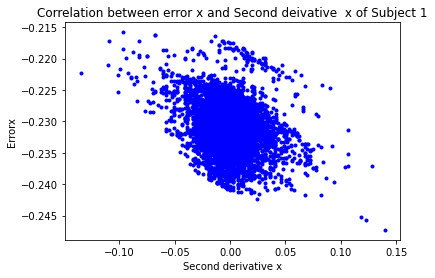

[[ 1.         -0.27252364]
 [-0.27252364  1.        ]]


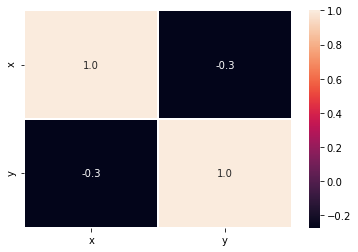

74.3
[ 0.00250586  0.00228543  0.00436475 ... -0.00020834 -0.00020832
 -0.00020829]


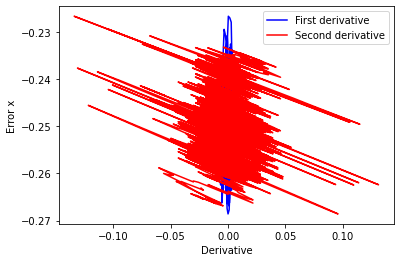

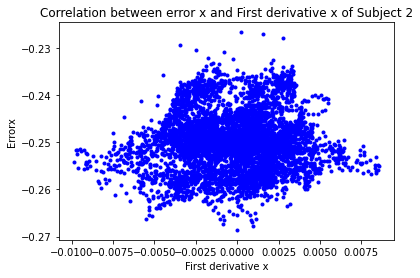

[[1.         0.06192429]
 [0.06192429 1.        ]]


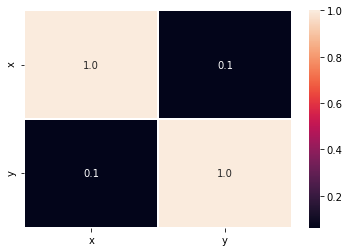

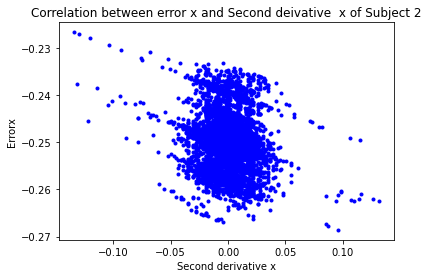

[[ 1.         -0.15481289]
 [-0.15481289  1.        ]]


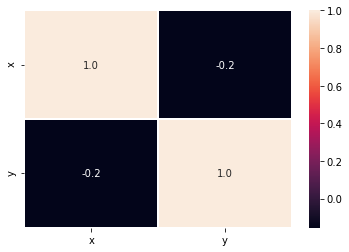

74.3
[-0.00114536  0.00023421 -0.00022916 ... -0.00162697 -0.00162677
 -0.00162653]


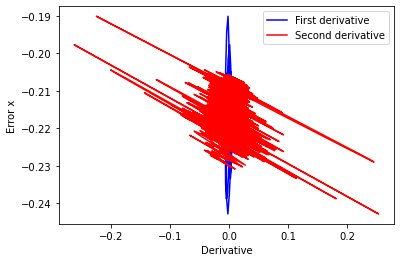

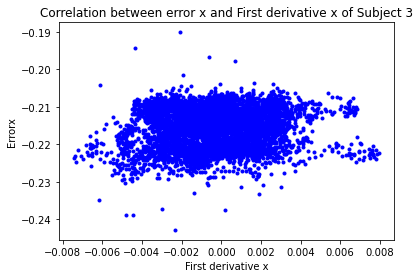

[[1.         0.07289969]
 [0.07289969 1.        ]]


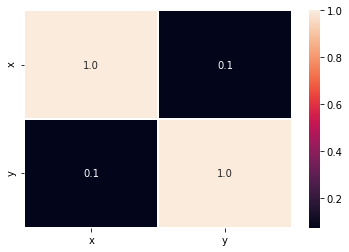

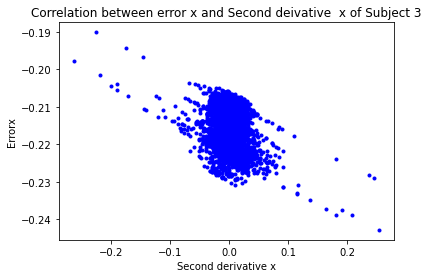

[[ 1.        -0.2658975]
 [-0.2658975  1.       ]]


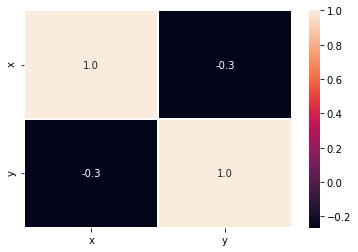

74.3
[ 0.00053299 -0.0008076  -0.00013609 ... -0.00062584 -0.00062579
 -0.00062574]


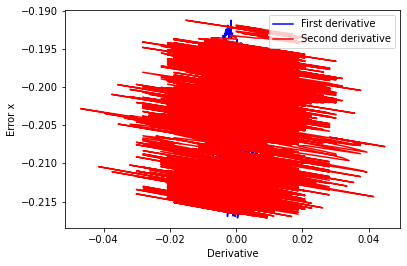

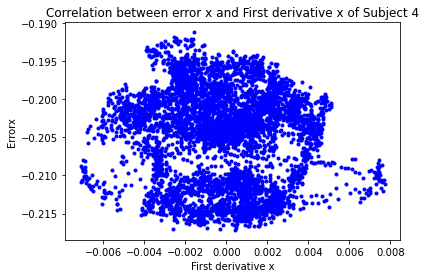

[[ 1.         -0.08197297]
 [-0.08197297  1.        ]]


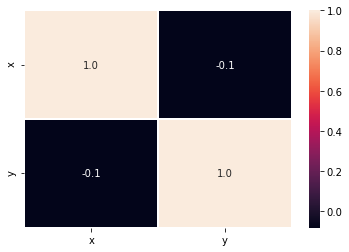

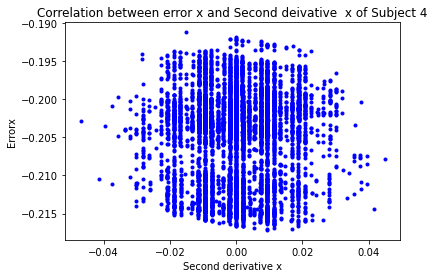

[[1.         0.02662074]
 [0.02662074 1.        ]]


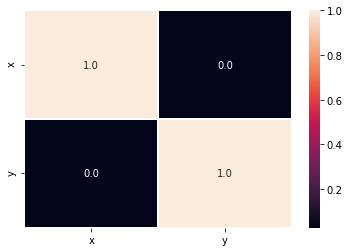

74.3
[-8.41091400e-04  1.24201421e-03  3.49235426e-03 ...  2.52872664e-06
  2.52844447e-06  2.52807104e-06]


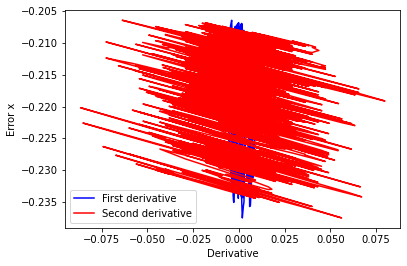

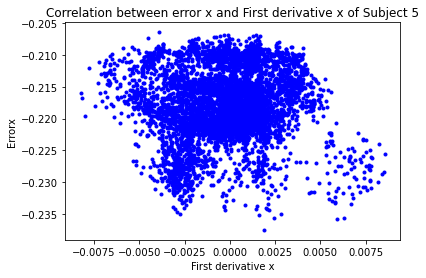

[[1.        0.0301532]
 [0.0301532 1.       ]]


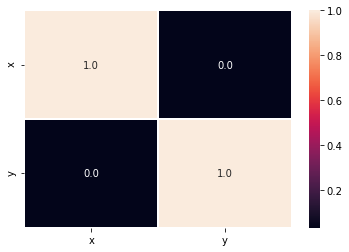

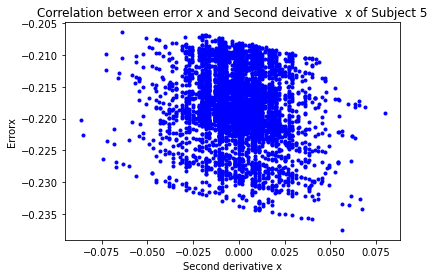

[[ 1.         -0.14207025]
 [-0.14207025  1.        ]]


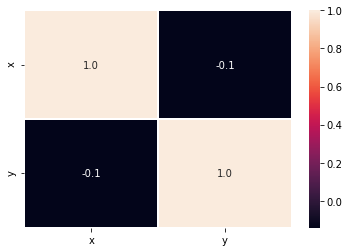

74.3
[ 0.00020194  0.00162995  0.00040663 ... -0.00056806 -0.00056801
 -0.00056795]


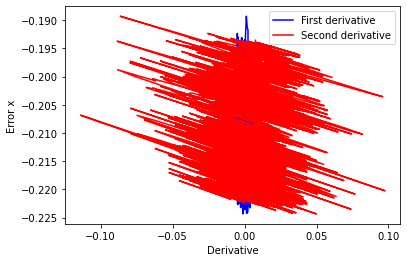

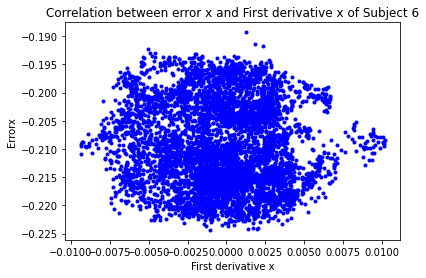

[[ 1.         -0.07467498]
 [-0.07467498  1.        ]]


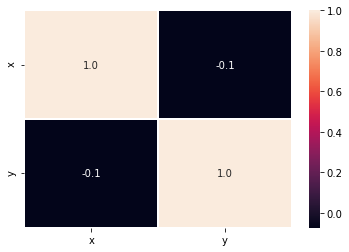

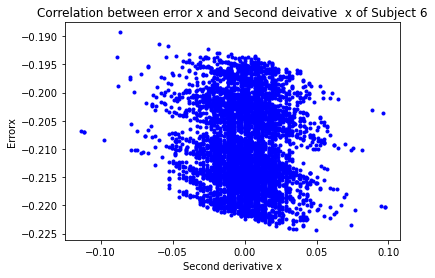

[[ 1.         -0.10862686]
 [-0.10862686  1.        ]]


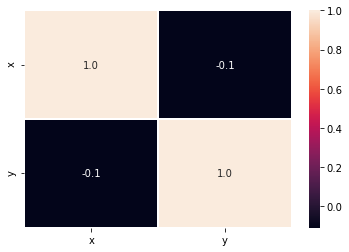

74.3
[ 0.00042813  0.002284    0.00165237 ... -0.00125035 -0.00125038
 -0.00125042]


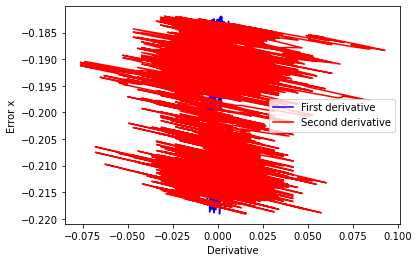

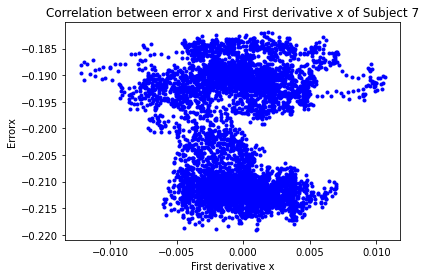

[[ 1.         -0.03193008]
 [-0.03193008  1.        ]]


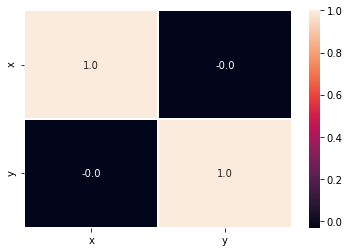

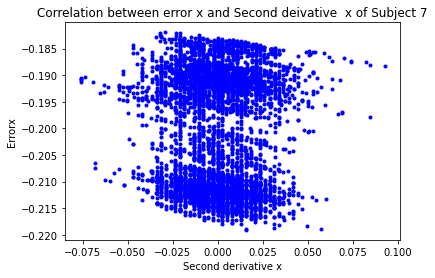

[[ 1.         -0.02794594]
 [-0.02794594  1.        ]]


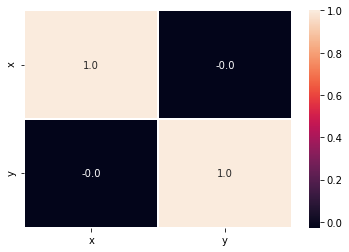

74.3
[ 2.85924872e-04  2.20309765e-07 -1.40623847e-04 ...  6.79396742e-04
  6.79389463e-04  6.79374813e-04]


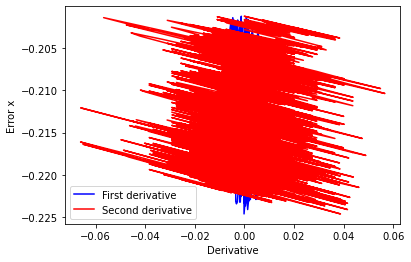

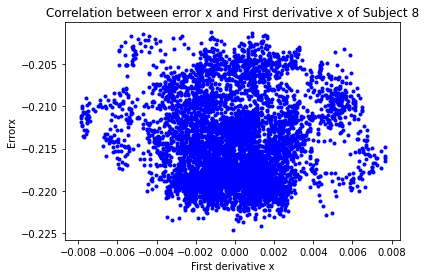

[[ 1.         -0.01871911]
 [-0.01871911  1.        ]]


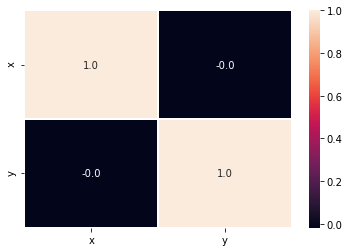

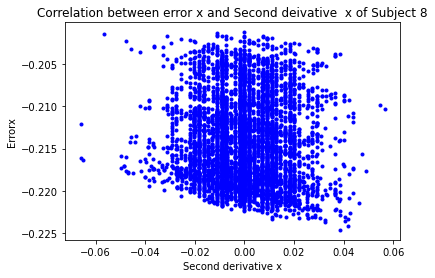

[[ 1.         -0.06556301]
 [-0.06556301  1.        ]]


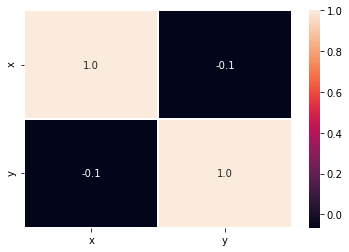

74.3
[-9.94463860e-04 -8.05185257e-04  8.43084681e-07 ...  8.34291748e-04
  8.34275595e-04  8.34246105e-04]


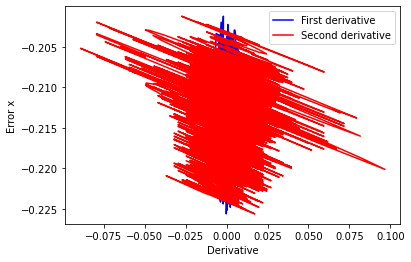

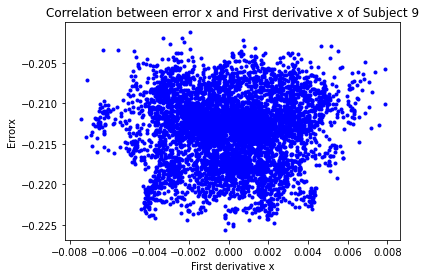

[[1.         0.01591828]
 [0.01591828 1.        ]]


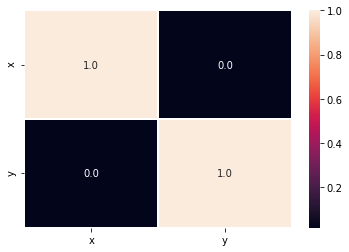

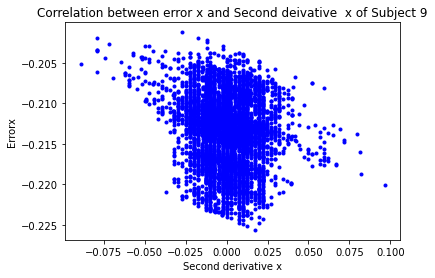

[[ 1.        -0.1528894]
 [-0.1528894  1.       ]]


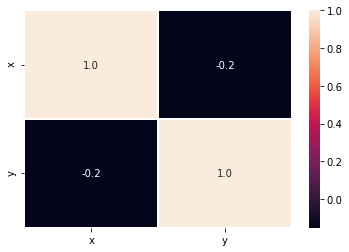

74.3
[-4.86232280e-06  7.03859861e-04  6.96670113e-04 ... -2.48830933e-04
 -2.48851854e-04 -2.48881818e-04]


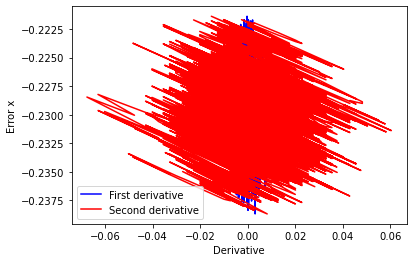

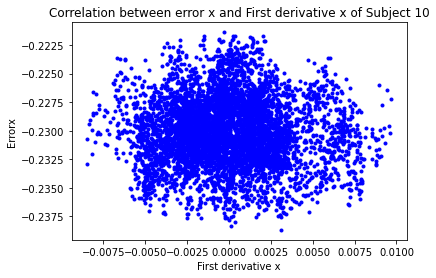

[[ 1.         -0.02563996]
 [-0.02563996  1.        ]]


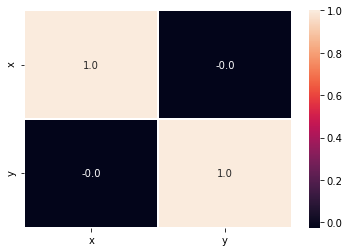

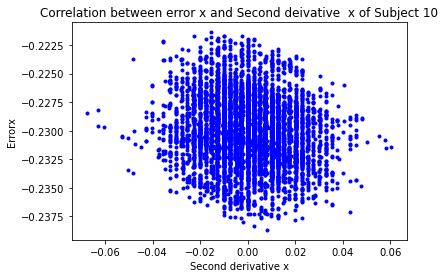

[[ 1.        -0.1407452]
 [-0.1407452  1.       ]]


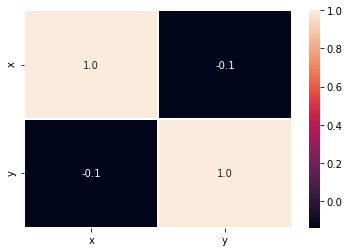

74.3
[ 0.00043958  0.00587328  0.00570288 ... -0.00068528 -0.00068542
 -0.00068562]


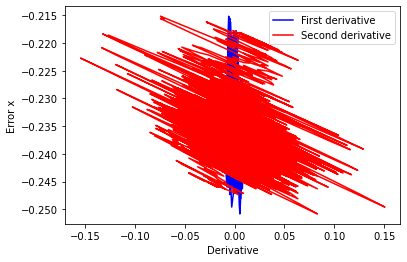

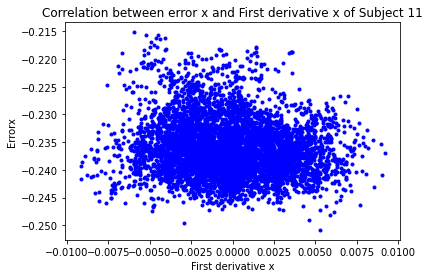

[[ 1.         -0.13247663]
 [-0.13247663  1.        ]]


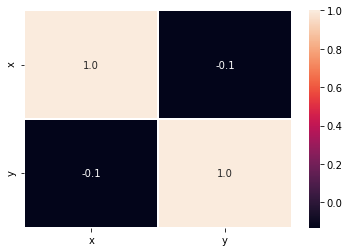

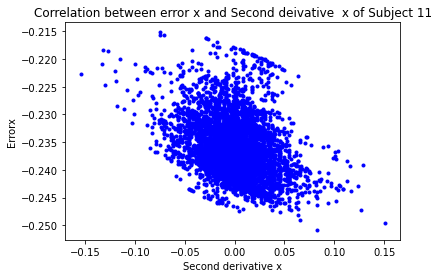

[[ 1.         -0.30880865]
 [-0.30880865  1.        ]]


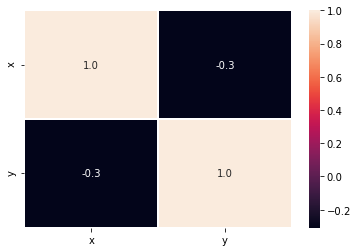

126.3
[-1.57732491e-06  9.04061315e-04  1.13748604e-03 ... -2.04883131e-04
 -2.04841728e-04 -2.04784523e-04]


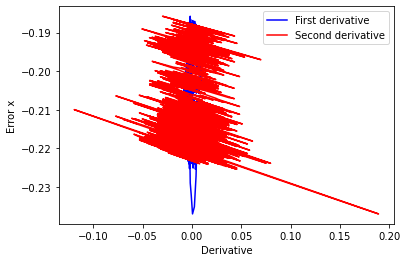

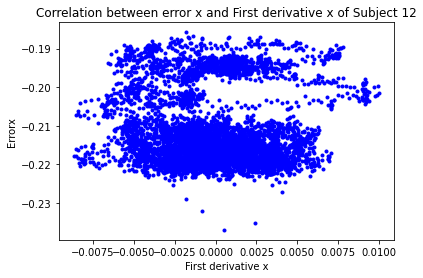

[[ 1.         -0.03569826]
 [-0.03569826  1.        ]]


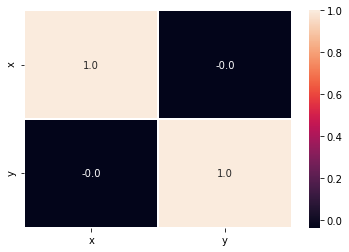

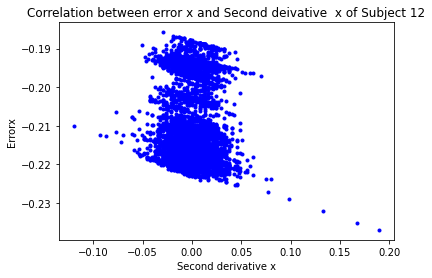

[[ 1.         -0.07009438]
 [-0.07009438  1.        ]]


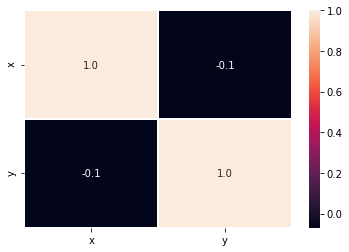

126.3
[ 9.31819792e-07 -1.18878976e-03  6.22089316e-04 ...  9.90683862e-04
  9.90626557e-04  9.90535387e-04]


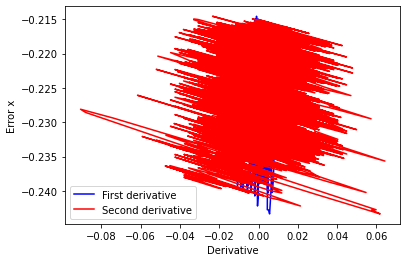

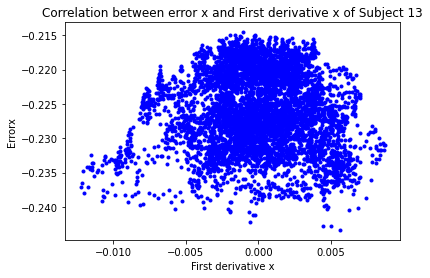

[[ 1.         -0.00558354]
 [-0.00558354  1.        ]]


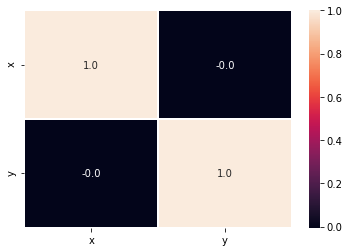

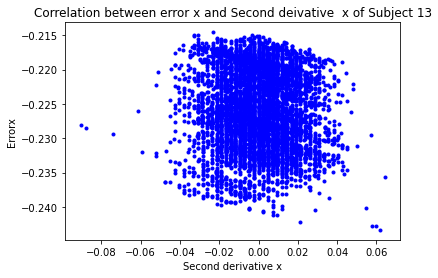

[[ 1.        -0.0341704]
 [-0.0341704  1.       ]]


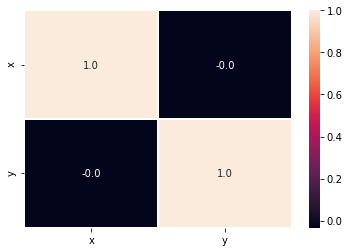

126.3
[0.00200588 0.00143426 0.00162029 ... 0.00074051 0.00074047 0.00074042]


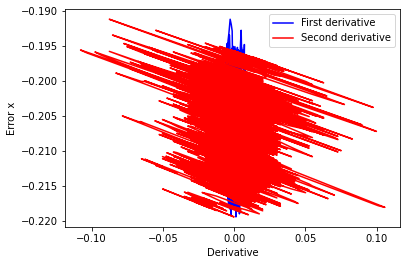

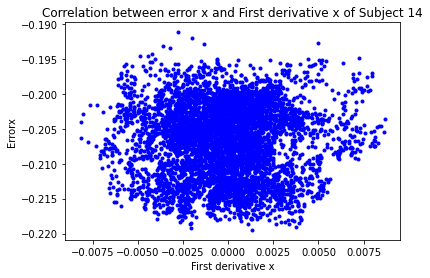

[[1.         0.02704858]
 [0.02704858 1.        ]]


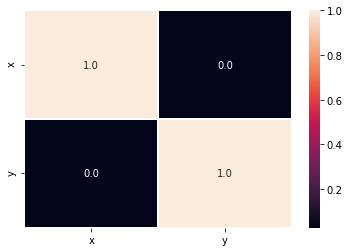

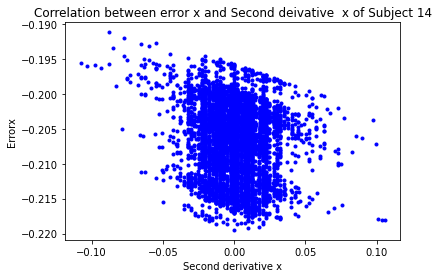

[[ 1.        -0.1292552]
 [-0.1292552  1.       ]]


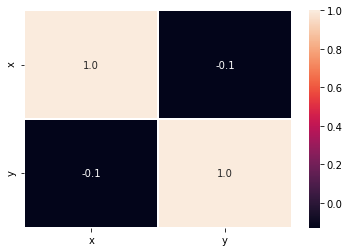

126.3
[-2.26522963e-04 -1.65036030e-04  2.25142887e-03 ...  2.77190723e-08
  2.77198876e-08  2.77208353e-08]


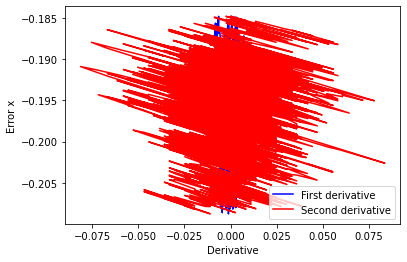

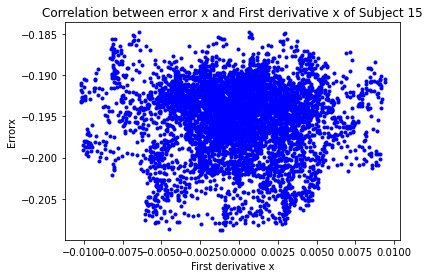

[[ 1.         -0.01987141]
 [-0.01987141  1.        ]]


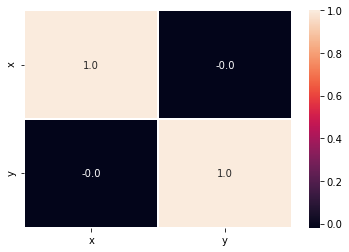

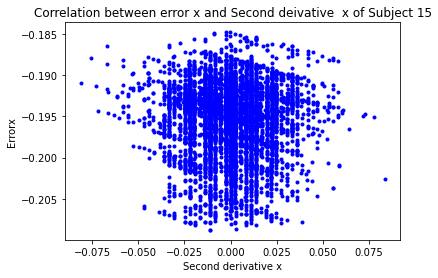

[[ 1.        -0.0063312]
 [-0.0063312  1.       ]]


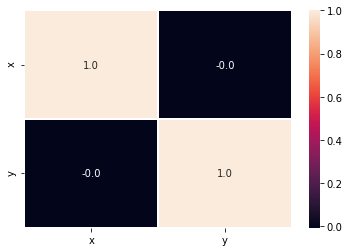

126.3
[-2.33845776e-04 -2.32789918e-04 -2.33842259e-04 ...  4.03384392e-06
  4.03347395e-06  4.03296088e-06]


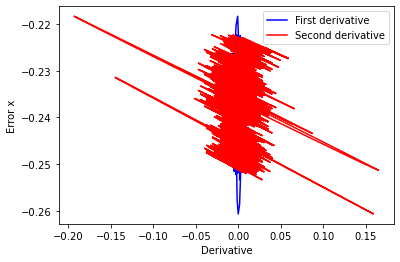

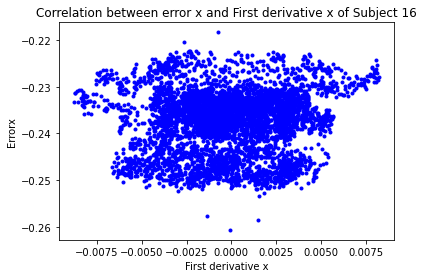

[[1.         0.06716486]
 [0.06716486 1.        ]]


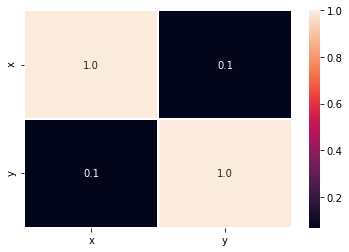

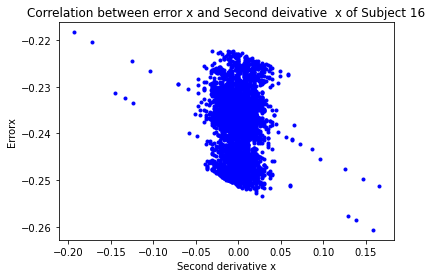

[[ 1.         -0.08688092]
 [-0.08688092  1.        ]]


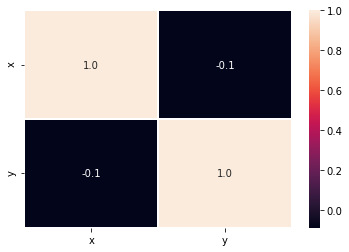

126.3
[ 3.38936963e-06  1.51466815e-04 -6.95949657e-04 ... -4.86398730e-04
 -4.86534091e-04 -4.86716271e-04]


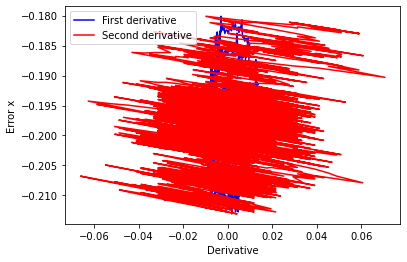

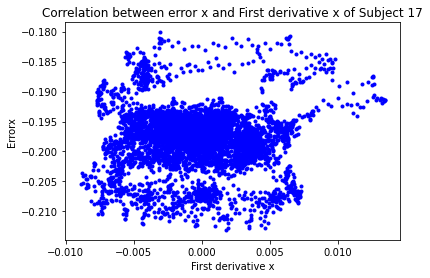

[[ 1.         -0.00392715]
 [-0.00392715  1.        ]]


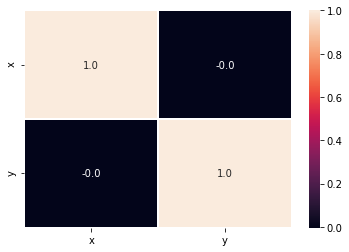

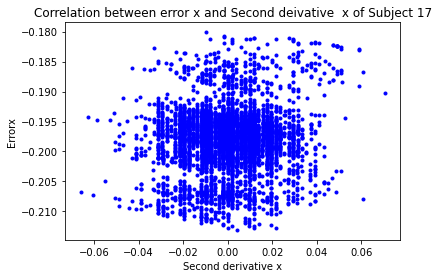

[[1.         0.10583618]
 [0.10583618 1.        ]]


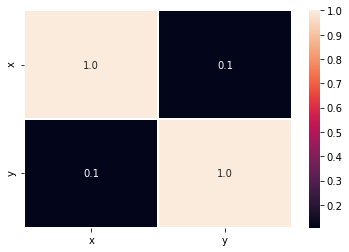

126.3
[ 0.00111058  0.00088068  0.00112563 ... -0.00086259 -0.00086261
 -0.00086264]


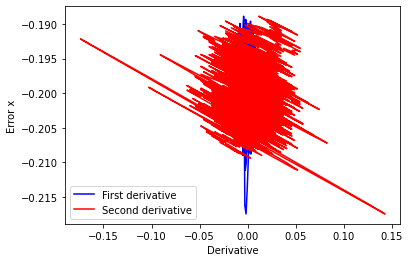

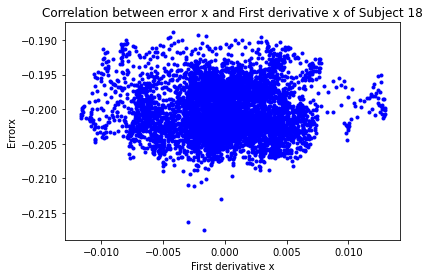

[[ 1.        -0.0112949]
 [-0.0112949  1.       ]]


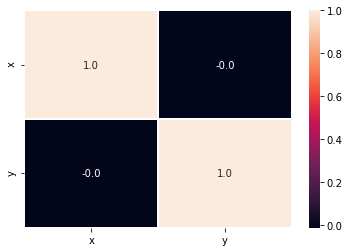

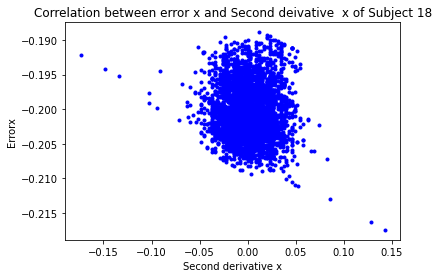

[[ 1.         -0.05159904]
 [-0.05159904  1.        ]]


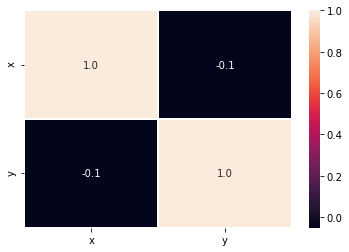

126.3
[ 0.00251436  0.00224008  0.00421654 ... -0.00039767 -0.00039775
 -0.00039786]


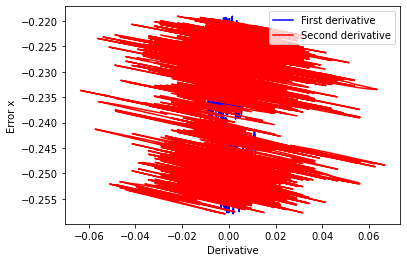

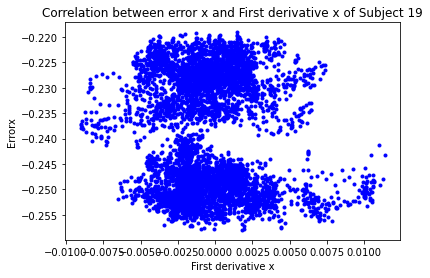

[[ 1.         -0.06332698]
 [-0.06332698  1.        ]]


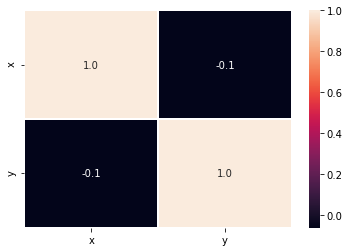

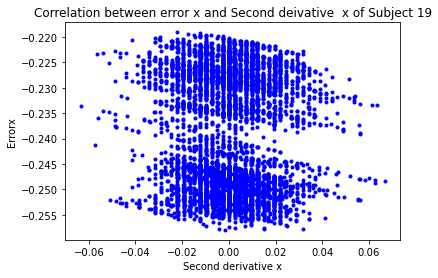

[[ 1.         -0.04194641]
 [-0.04194641  1.        ]]


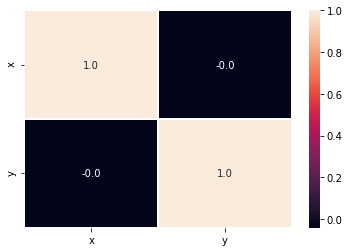

126.3
[-0.00114876 -0.00068501 -0.00022313 ...  0.00021031  0.0002103
  0.00021028]


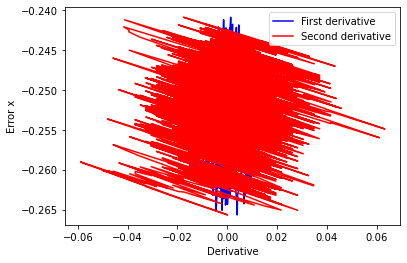

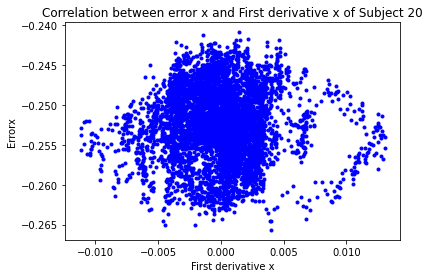

[[ 1.         -0.00903981]
 [-0.00903981  1.        ]]


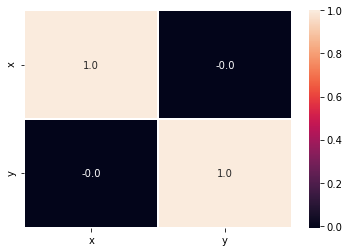

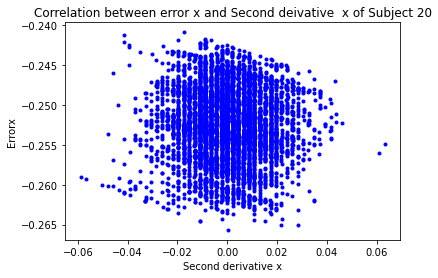

[[ 1.         -0.01807361]
 [-0.01807361  1.        ]]


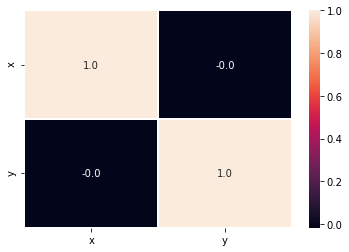

126.3
[ 0.00015677  0.00087944  0.00144457 ... -0.0002993  -0.00029929
 -0.00029928]


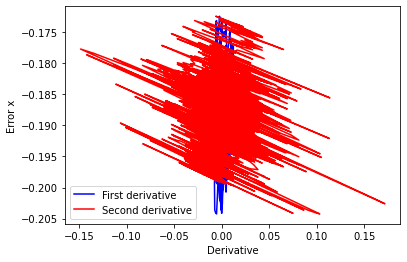

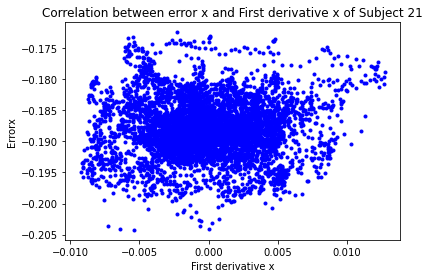

[[1.         0.02080563]
 [0.02080563 1.        ]]


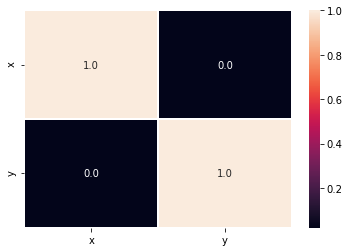

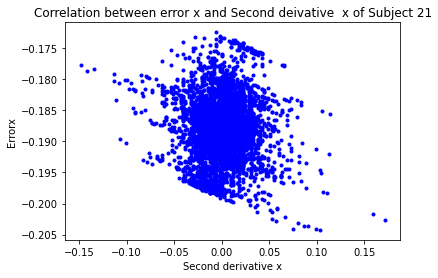

[[ 1.         -0.07954389]
 [-0.07954389  1.        ]]


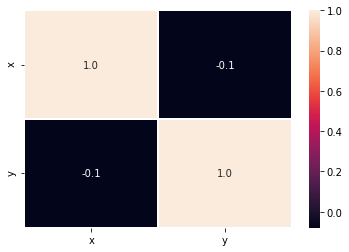

126.3
[ 2.02365423e-03  8.97753611e-04  2.02382804e-03 ... -2.98725578e-06
 -2.98778049e-06 -2.98870067e-06]


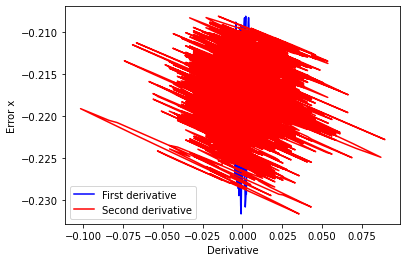

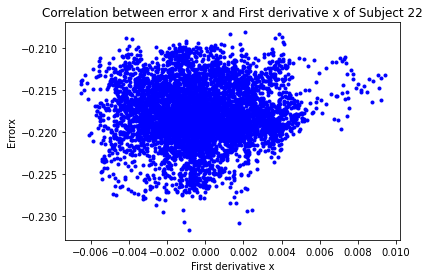

[[1.         0.03496686]
 [0.03496686 1.        ]]


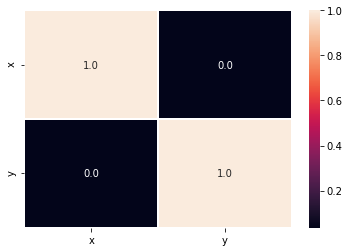

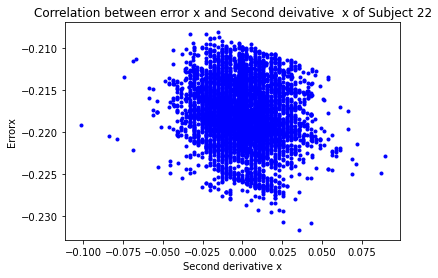

[[ 1.         -0.14443332]
 [-0.14443332  1.        ]]


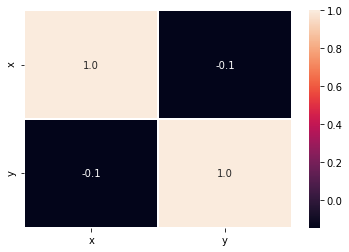

126.3
[-0.00142235 -0.00099119 -0.00142234 ...  0.00078366  0.00078364
  0.0007836 ]


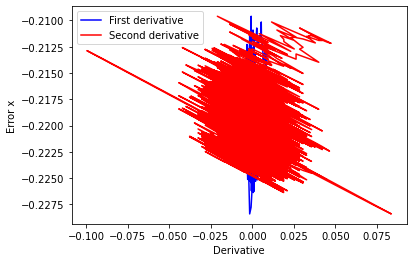

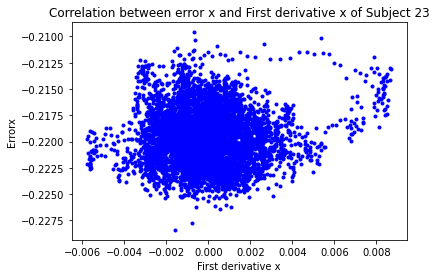

[[1.        0.0292291]
 [0.0292291 1.       ]]


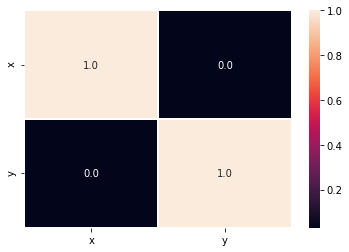

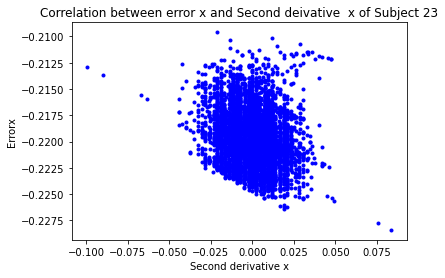

[[ 1.         -0.18918362]
 [-0.18918362  1.        ]]


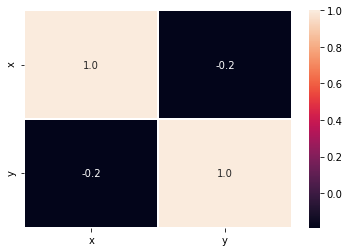

52.9
[0.00037378 0.00178077 0.00196912 ... 0.00041847 0.00041832 0.00041811]


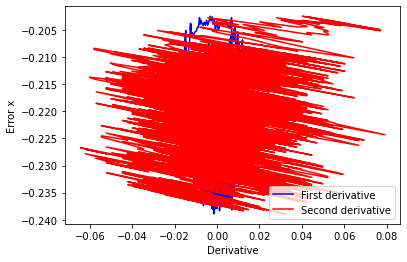

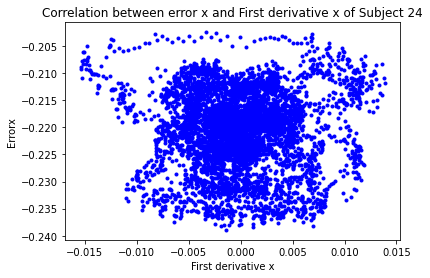

[[ 1.         -0.00555905]
 [-0.00555905  1.        ]]


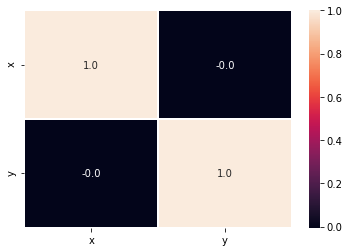

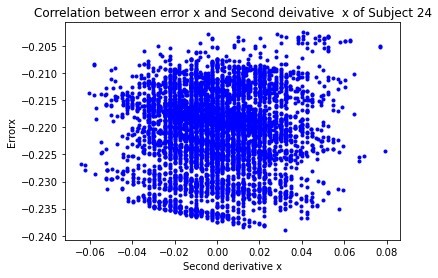

[[1.         0.03386621]
 [0.03386621 1.        ]]


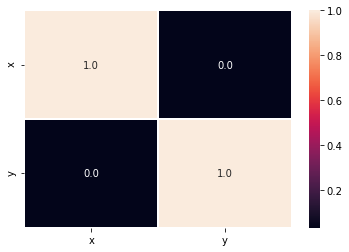

52.9
[2.20048971e-03 3.16095813e-03 2.90296228e-03 ... 2.76927244e-08
 2.76928517e-08 2.76930553e-08]


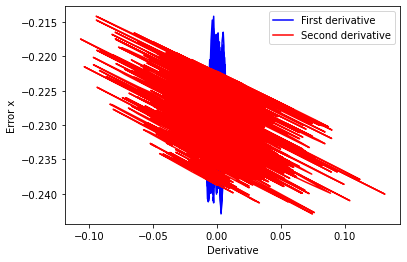

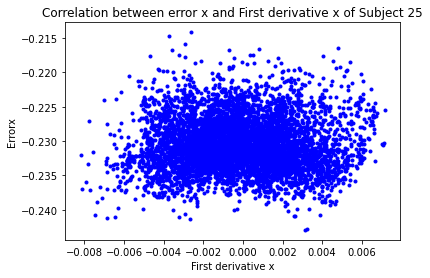

[[ 1.         -0.01575399]
 [-0.01575399  1.        ]]


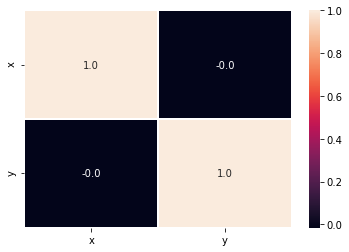

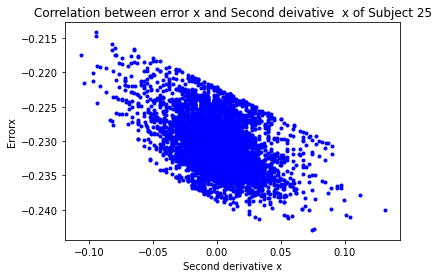

[[ 1.         -0.43817878]
 [-0.43817878  1.        ]]


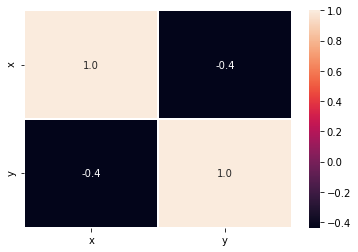

52.9
[0.00262089 0.00111268 0.00370495 ... 0.00123841 0.00123839 0.00123836]


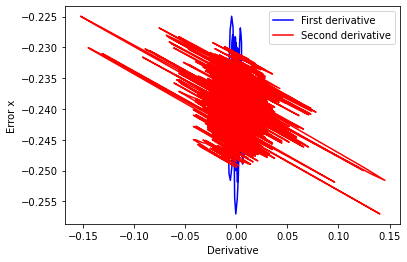

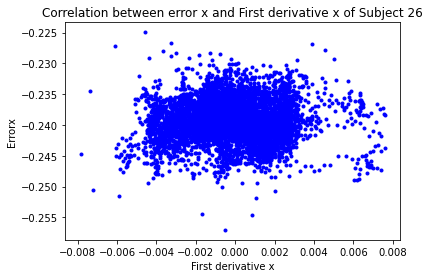

[[1.         0.01244366]
 [0.01244366 1.        ]]


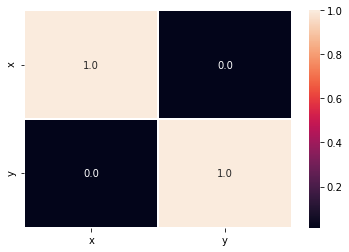

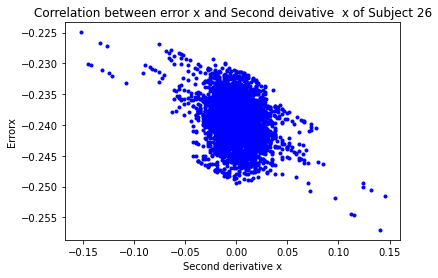

[[ 1.         -0.31411595]
 [-0.31411595  1.        ]]


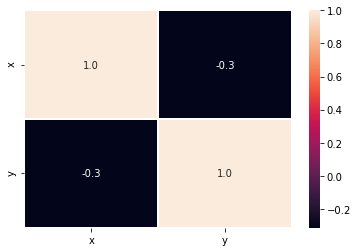

52.9
[ 0.00103392 -0.00028314  0.00205582 ...  0.00023084  0.00023085
  0.00023087]


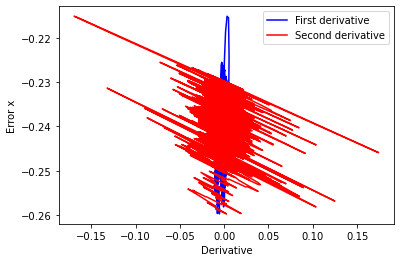

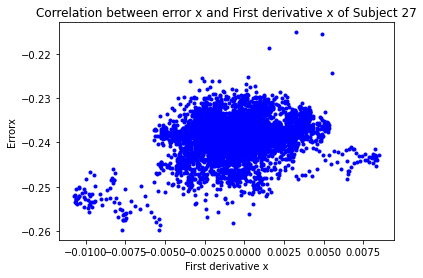

[[1.         0.25726785]
 [0.25726785 1.        ]]


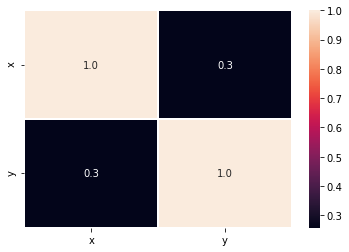

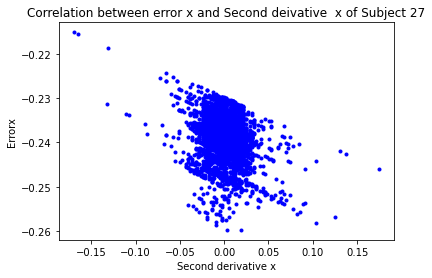

[[ 1.         -0.24160431]
 [-0.24160431  1.        ]]


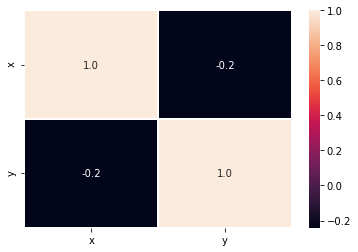

52.9
[-0.00130157 -0.00130383 -0.00161987 ...  0.00070539  0.00070535
  0.00070529]


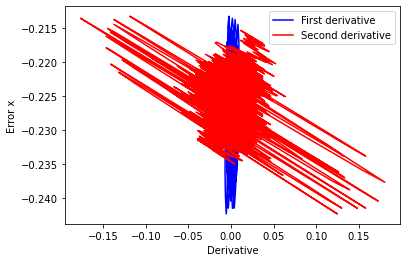

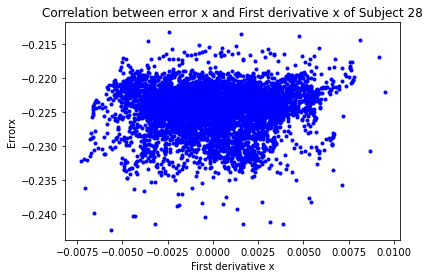

[[1.         0.02488063]
 [0.02488063 1.        ]]


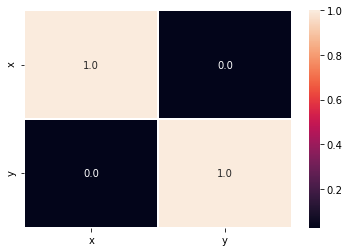

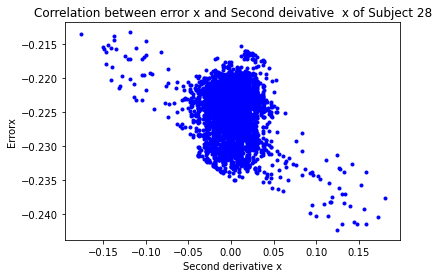

[[ 1.        -0.2441112]
 [-0.2441112  1.       ]]


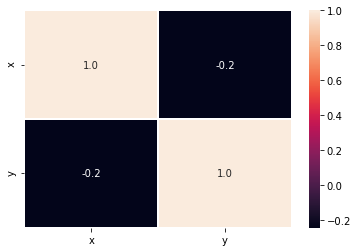

52.9
[ 0.00080459  0.00080411  0.00080364 ... -0.00152081 -0.00152133
 -0.00152207]


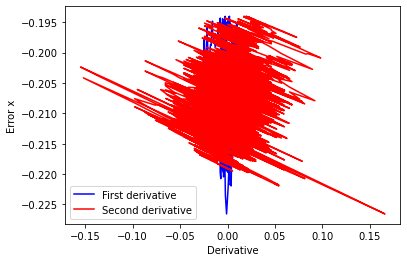

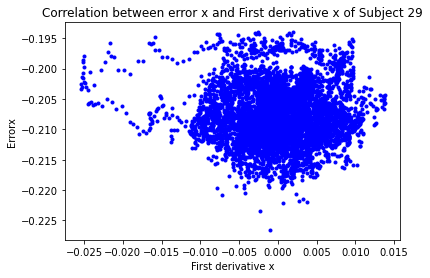

[[ 1.         -0.00287154]
 [-0.00287154  1.        ]]


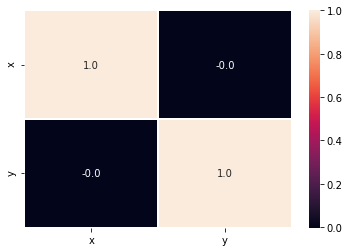

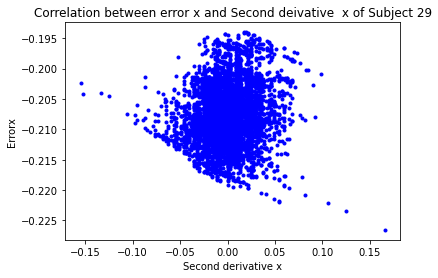

[[1.         0.10715446]
 [0.10715446 1.        ]]


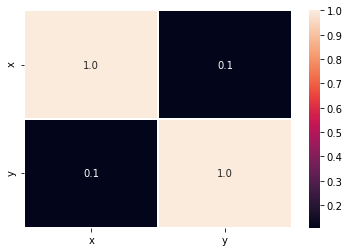

52.9
[ 1.33152377e-03 -3.17222877e-07  1.63082518e-03 ...  9.81761181e-04
  9.81690504e-04  9.81578524e-04]


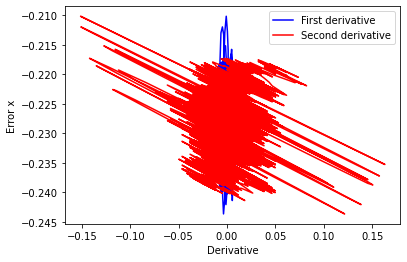

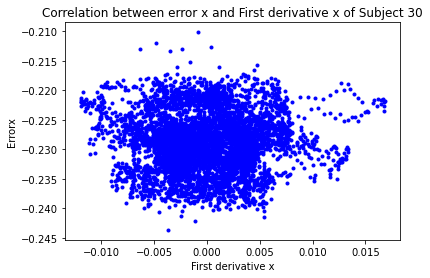

[[1.         0.01301982]
 [0.01301982 1.        ]]


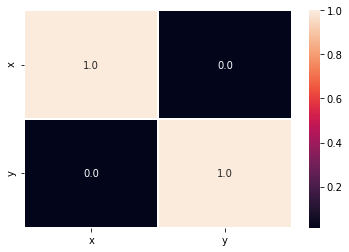

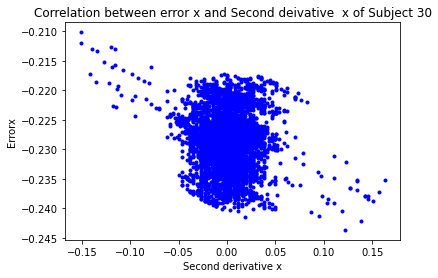

[[ 1.         -0.09995316]
 [-0.09995316  1.        ]]


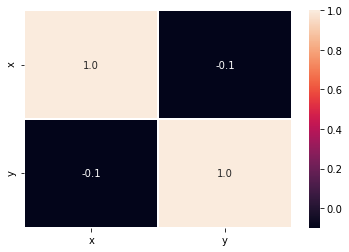

52.9
[-0.00460512 -0.00441523 -0.00380602 ...  0.00139619  0.00139644
  0.00139676]


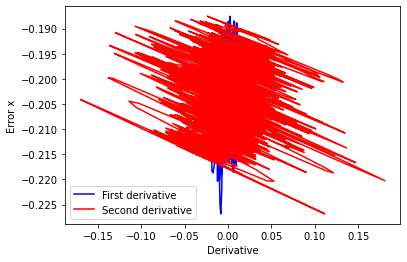

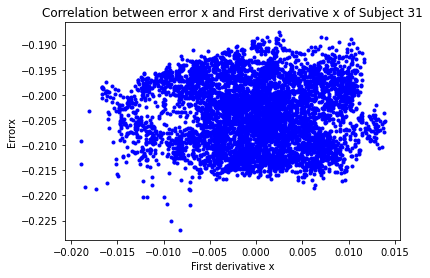

[[ 1.         -0.01241188]
 [-0.01241188  1.        ]]


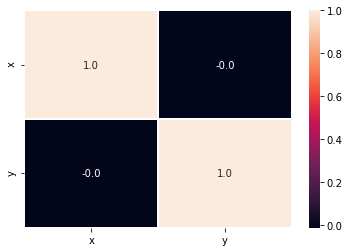

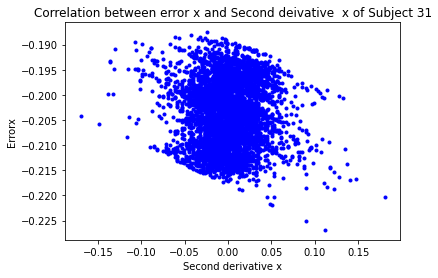

[[ 1.         -0.03392007]
 [-0.03392007  1.        ]]


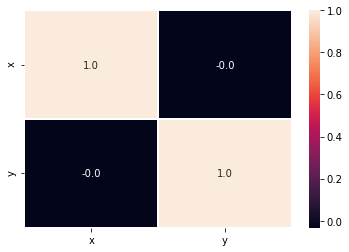

52.9
[ 0.00096849 -0.00023811 -0.00066757 ... -0.00183837 -0.00183851
 -0.00183874]


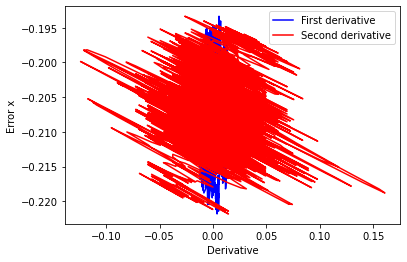

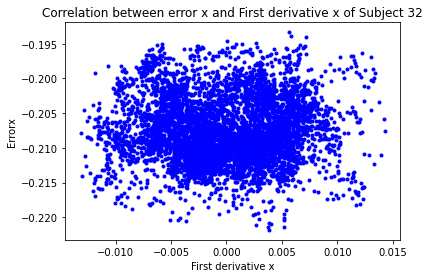

[[1.         0.00490298]
 [0.00490298 1.        ]]


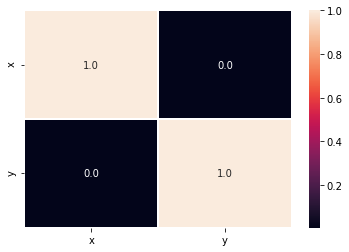

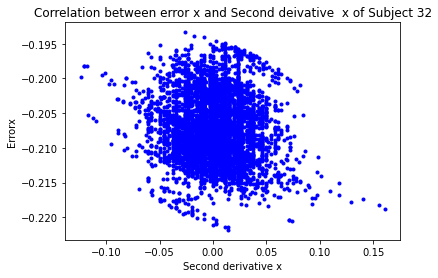

[[ 1.         -0.08087448]
 [-0.08087448  1.        ]]


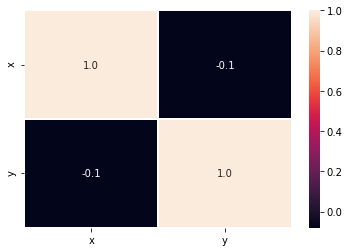

52.9
[-0.00069392  0.00068588 -0.00046576 ... -0.00020688 -0.00020688
 -0.00020687]


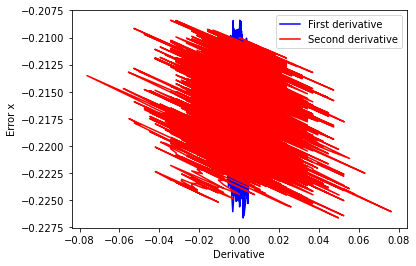

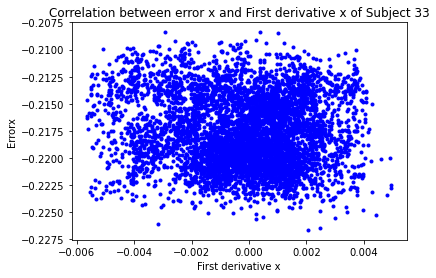

[[ 1.         -0.08143494]
 [-0.08143494  1.        ]]


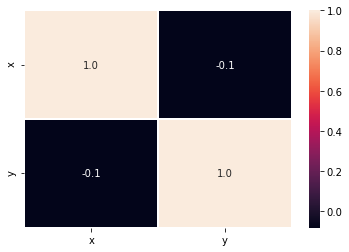

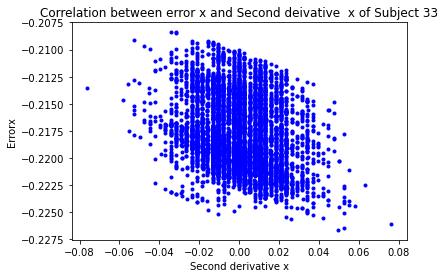

[[ 1.         -0.27096094]
 [-0.27096094  1.        ]]


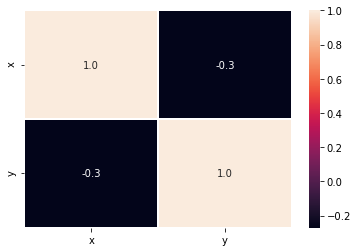

52.9
[-0.01178569 -0.01096075 -0.00434326 ...  0.00168401  0.00168443
  0.001685  ]


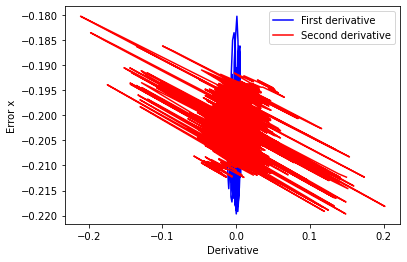

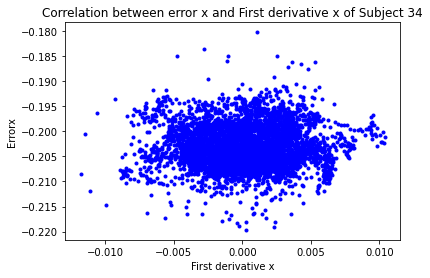

[[1.         0.03003134]
 [0.03003134 1.        ]]


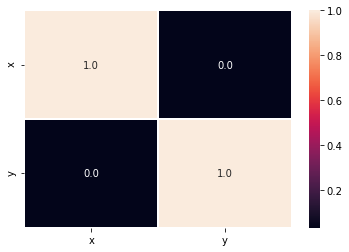

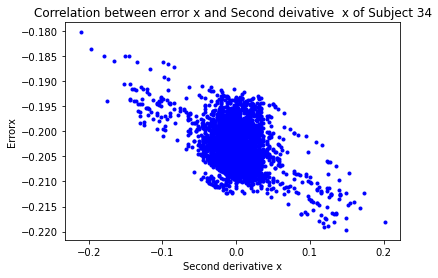

[[ 1.        -0.3658283]
 [-0.3658283  1.       ]]


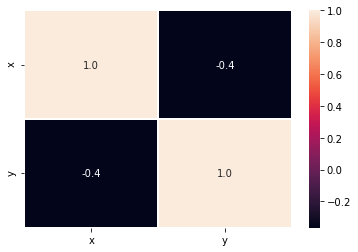

52.9
[ 3.29540281e-04  1.38905677e-07  2.55830973e-03 ... -4.53703589e-06
 -4.53710854e-06 -4.53723315e-06]


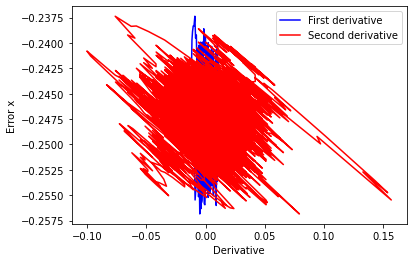

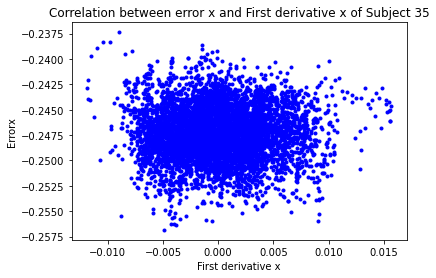

[[ 1.         -0.01407537]
 [-0.01407537  1.        ]]


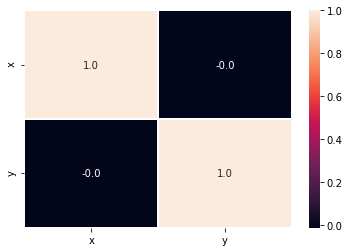

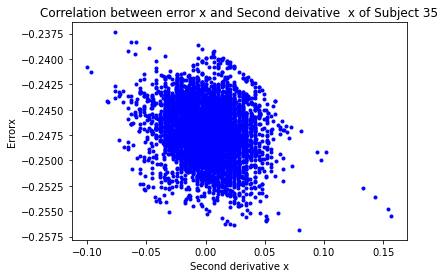

[[ 1.         -0.18419891]
 [-0.18419891  1.        ]]


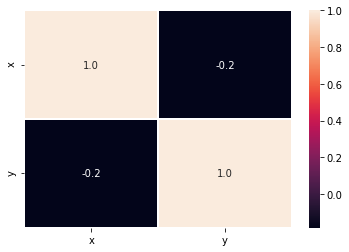

75.85
[-0.00759797 -0.00330673  0.00386649 ...  0.00191159  0.0019116
  0.00191159]


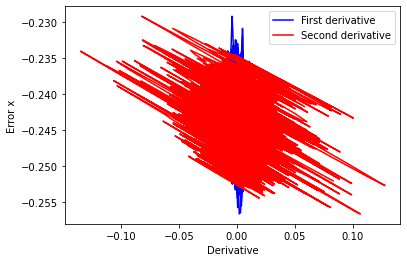

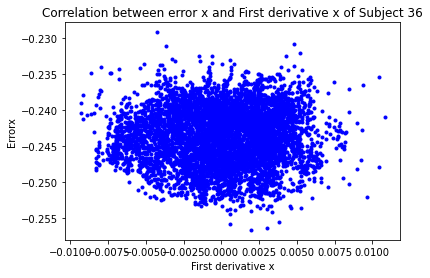

[[1.         0.00788823]
 [0.00788823 1.        ]]


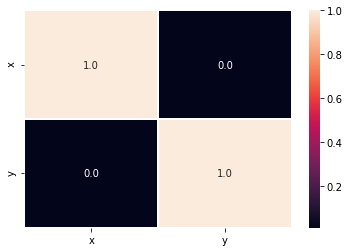

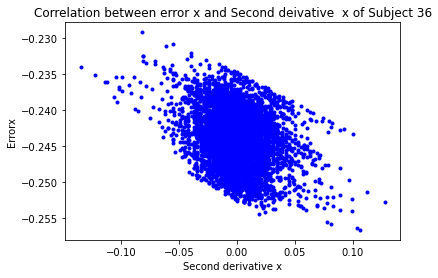

[[ 1.         -0.28182355]
 [-0.28182355  1.        ]]


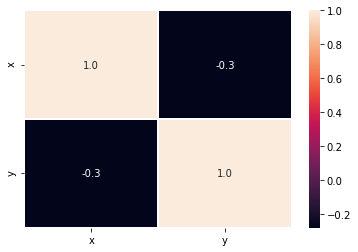

75.85
[ 0.00114163  0.004138    0.00206866 ... -0.00156783 -0.00156747
 -0.00156698]


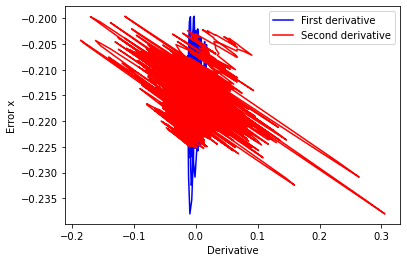

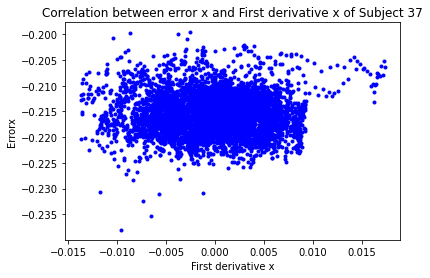

[[ 1.         -0.01079855]
 [-0.01079855  1.        ]]


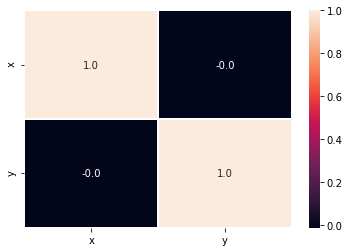

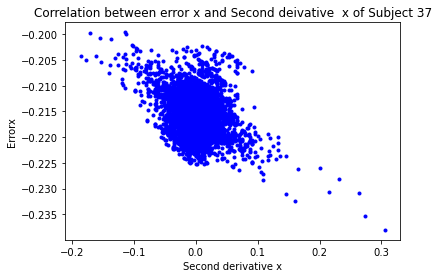

[[ 1.         -0.30412164]
 [-0.30412164  1.        ]]


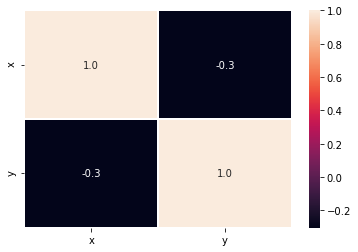

75.85
[-0.00098419 -0.00098931 -0.00125243 ...  0.00238367  0.0023837
  0.0023837 ]


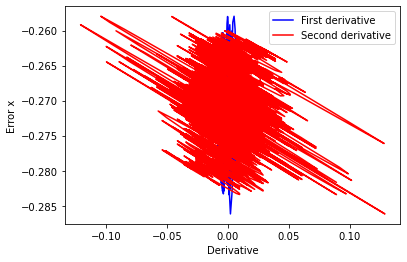

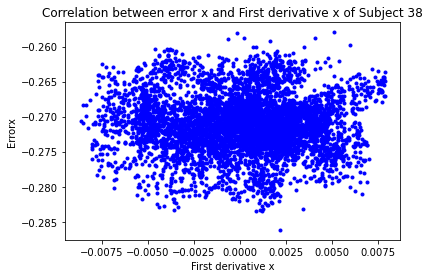

[[ 1.      -0.02298]
 [-0.02298  1.     ]]


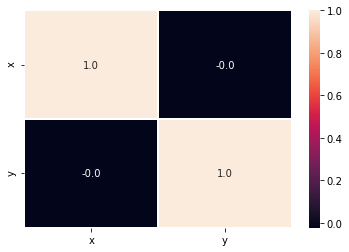

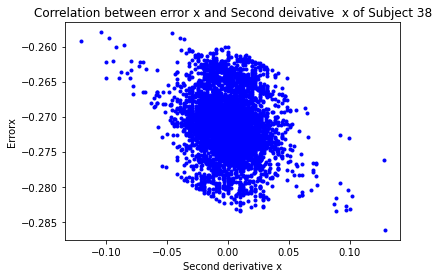

[[ 1.         -0.19285297]
 [-0.19285297  1.        ]]


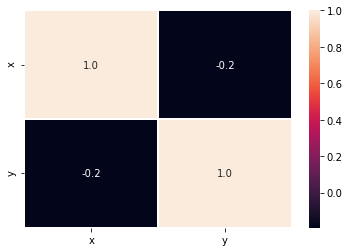

75.85
[-0.00160655 -0.00056865 -0.00018943 ...  0.0008693   0.00086929
  0.00086927]


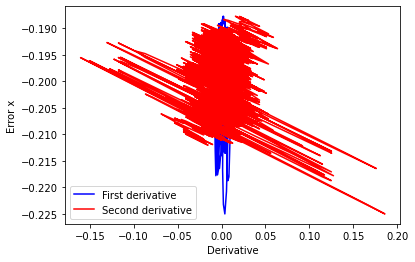

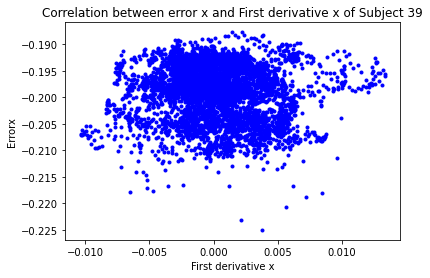

[[ 1.         -0.07011508]
 [-0.07011508  1.        ]]


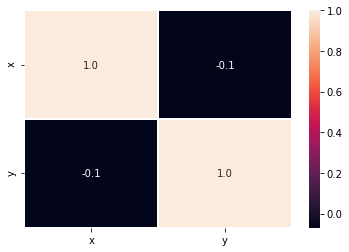

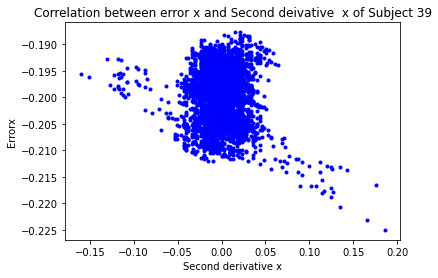

[[ 1.         -0.09004289]
 [-0.09004289  1.        ]]


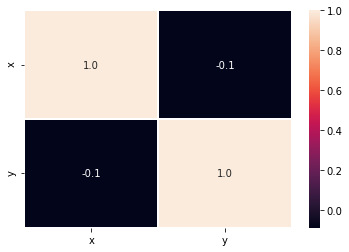

75.85
[ 1.32064406e-06  7.70183879e-04  9.47374020e-04 ... -1.73715057e-04
 -1.73725011e-04 -1.73739318e-04]


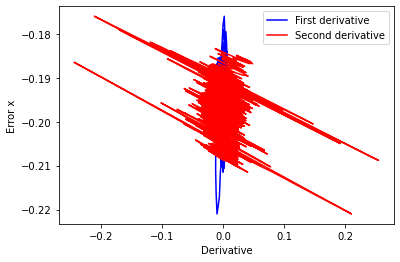

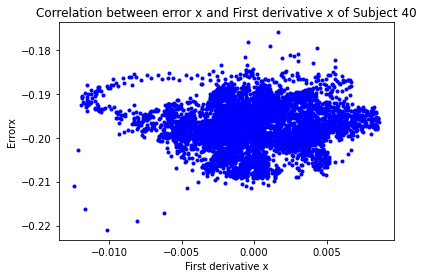

[[1.         0.00996987]
 [0.00996987 1.        ]]


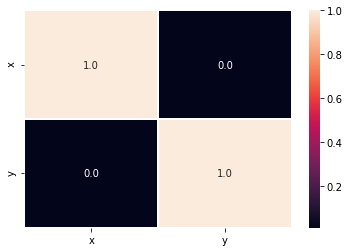

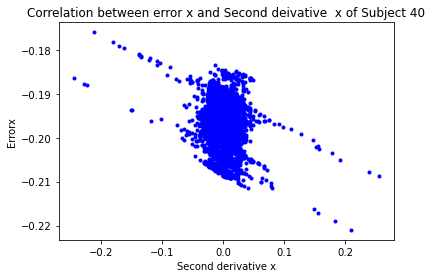

[[ 1.         -0.15502268]
 [-0.15502268  1.        ]]


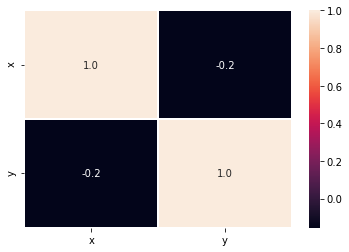

75.85
[ 8.91113432e-06 -2.22366067e-03  9.17484196e-06 ... -1.19976798e-03
 -1.19981300e-03 -1.19989033e-03]


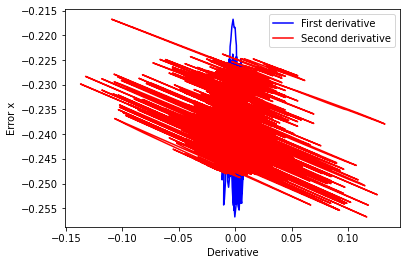

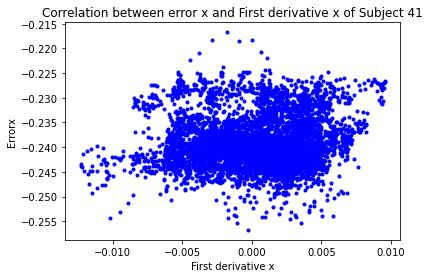

[[1.         0.08794366]
 [0.08794366 1.        ]]


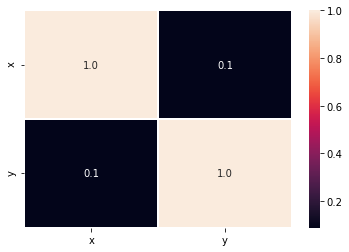

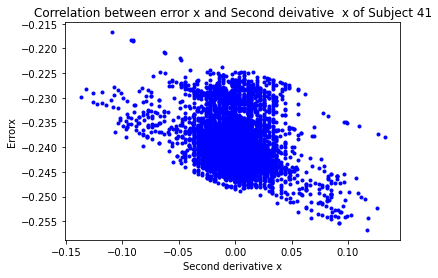

[[ 1.        -0.3165795]
 [-0.3165795  1.       ]]


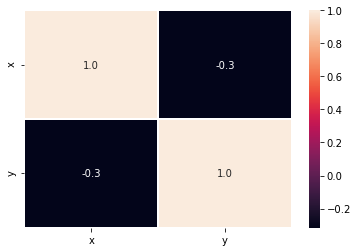

75.85
[-0.00096911  0.00052354 -0.00071761 ... -0.00090305 -0.00090313
 -0.00090324]


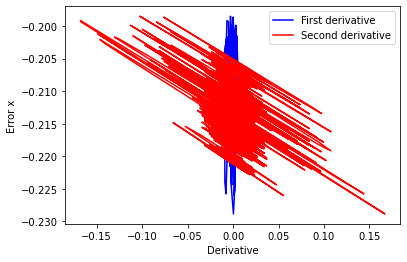

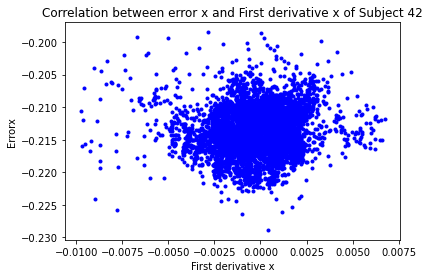

[[1.         0.06931615]
 [0.06931615 1.        ]]


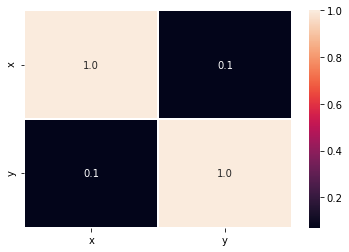

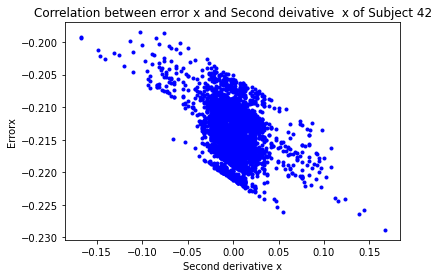

[[ 1.         -0.41643693]
 [-0.41643693  1.        ]]


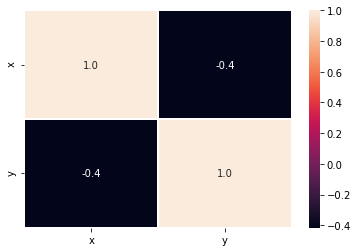

75.85
[-2.89992441e-04  7.13955756e-04  5.71243687e-04 ... -2.73884065e-06
 -2.73848917e-06 -2.73799807e-06]


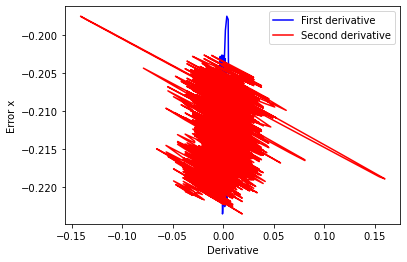

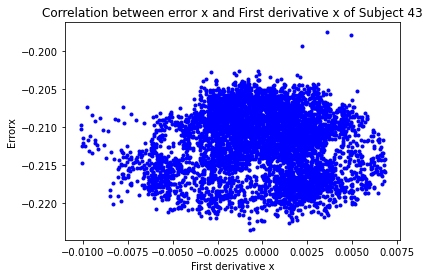

[[ 1.         -0.01539633]
 [-0.01539633  1.        ]]


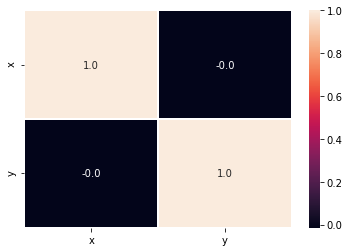

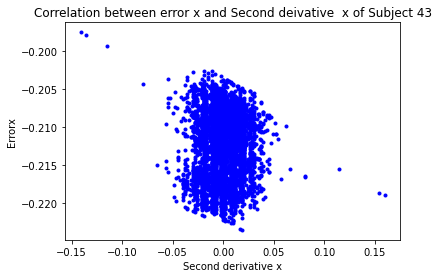

[[ 1.         -0.02838381]
 [-0.02838381  1.        ]]


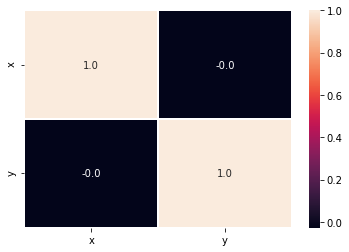

75.85
[ 0.00015061 -0.00055425 -0.00055553 ...  0.0005984   0.00059822
  0.00059797]


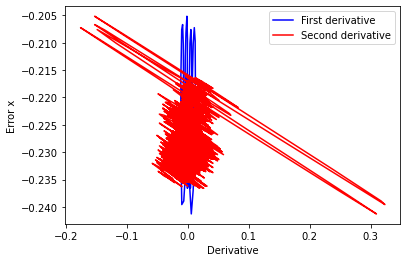

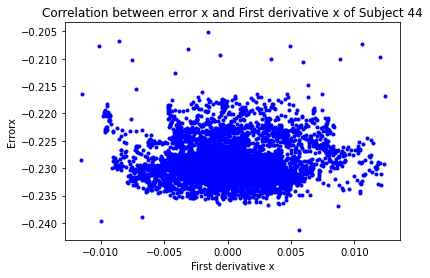

[[ 1.         -0.00891422]
 [-0.00891422  1.        ]]


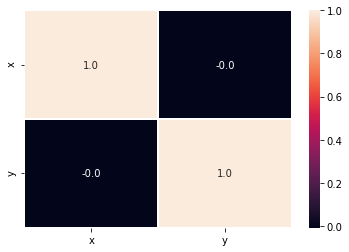

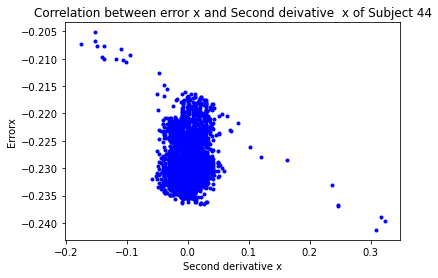

[[ 1.         -0.02861986]
 [-0.02861986  1.        ]]


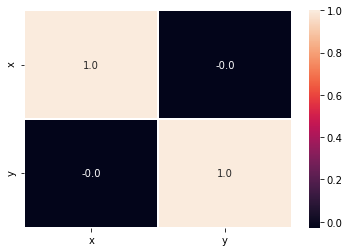

75.85
[-2.17702345e-02 -6.16317339e-03  3.05174706e-03 ...  9.05307372e-07
  9.05431200e-07  9.05572802e-07]


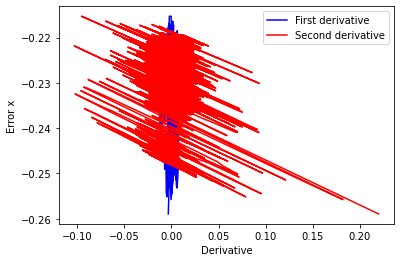

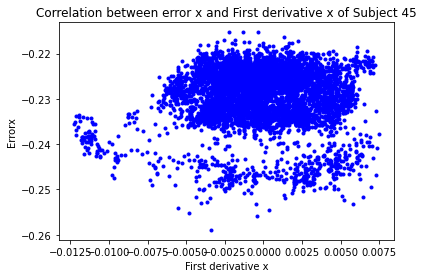

[[1.         0.02547504]
 [0.02547504 1.        ]]


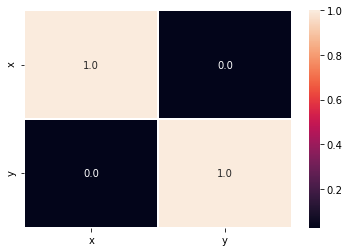

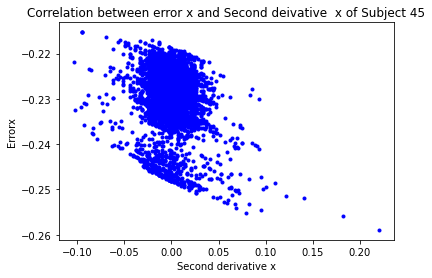

[[ 1.         -0.17701754]
 [-0.17701754  1.        ]]


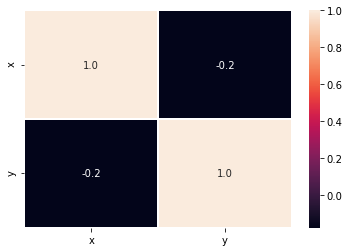

75.85
[-0.00172322 -0.00077161 -0.00137303 ...  0.00015119  0.00015117
  0.00015115]


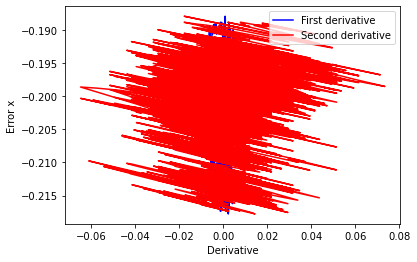

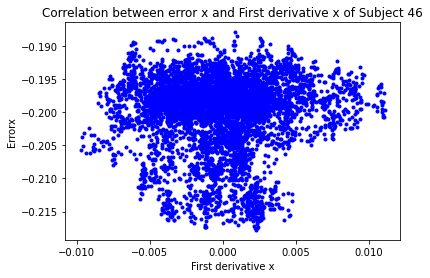

[[1.         0.01469448]
 [0.01469448 1.        ]]


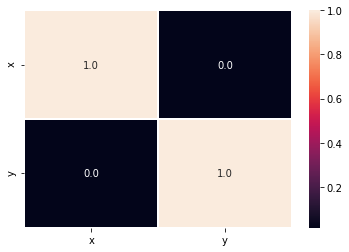

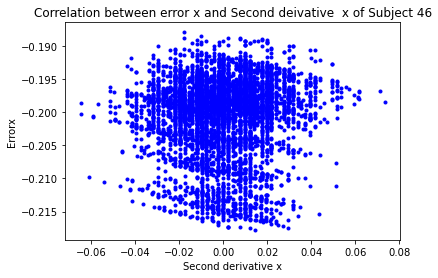

[[1.         0.04261259]
 [0.04261259 1.        ]]


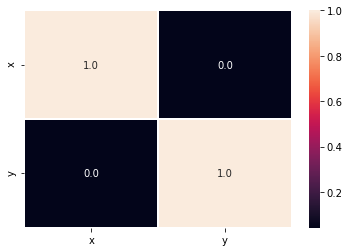

75.85
[ 3.78320705e-06 -2.25276870e-04  6.59448210e-04 ... -1.02632765e-03
 -1.02651370e-03 -1.02678752e-03]


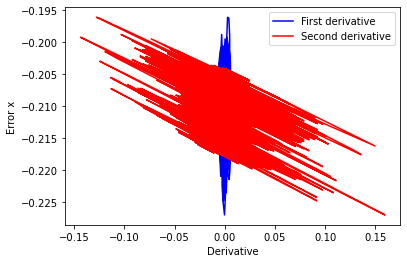

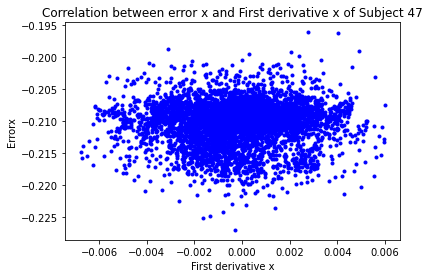

[[1.         0.03547655]
 [0.03547655 1.        ]]


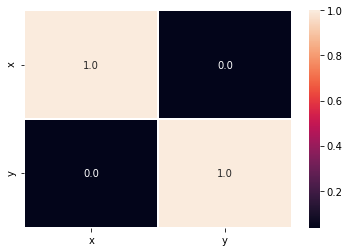

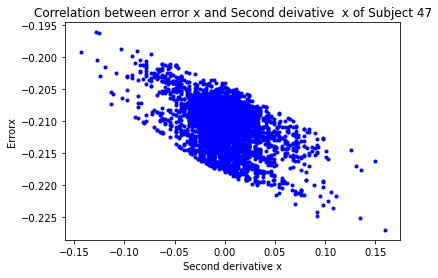

[[ 1.         -0.47808561]
 [-0.47808561  1.        ]]


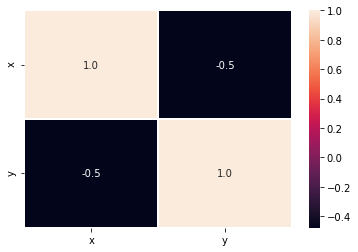

61.05
[-0.0024744  -0.0006725  -0.00294638 ... -0.00236074 -0.0023621
 -0.00236406]


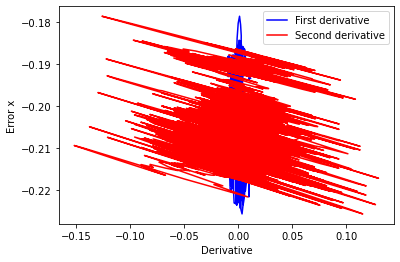

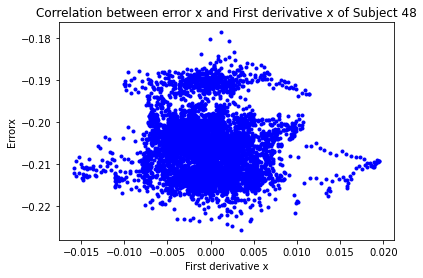

[[ 1.         -0.05701479]
 [-0.05701479  1.        ]]


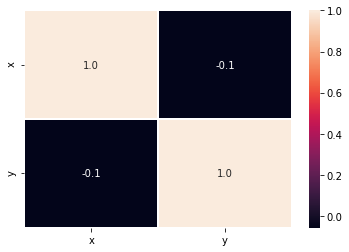

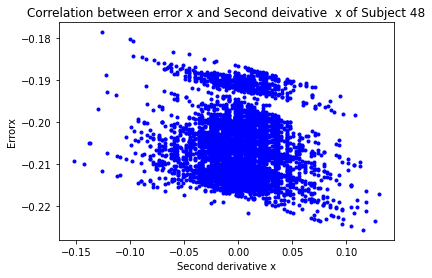

[[ 1.         -0.13062294]
 [-0.13062294  1.        ]]


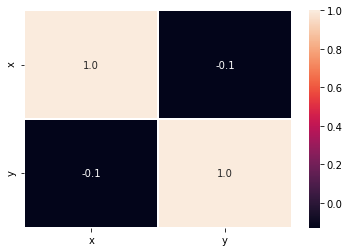

61.05
[ 0.00190906 -0.00064453  0.00046651 ... -0.00208508 -0.00208443
 -0.0020835 ]


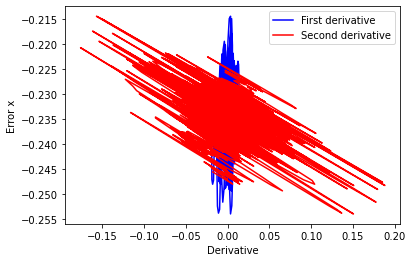

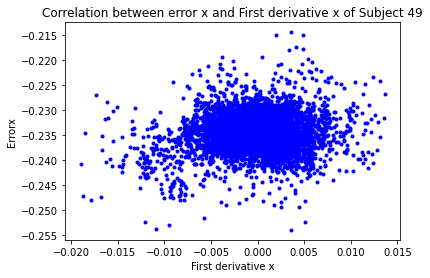

[[1.         0.11942995]
 [0.11942995 1.        ]]


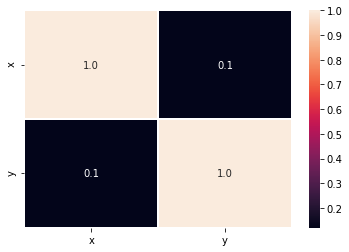

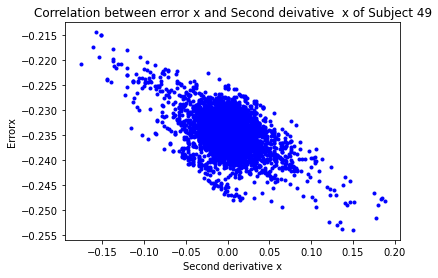

[[ 1.         -0.47863942]
 [-0.47863942  1.        ]]


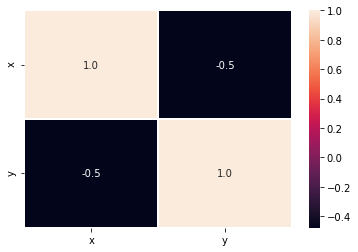

In [14]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    tanx=np.tan(angulox)
    tanz=np.tan(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    print(COPXmatrix)
    plt.figure()
    #plt.plot(t[30:],matrizangx,color='red')
    plt.plot(d1x,errorx,color='blue',label='First derivative')
    plt.plot(d2x,errorx,color='red',label='Second derivative')
    plt.xlabel("Derivative")
    plt.ylabel("Error x")
    plt.legend()
    plt.show()
    data={'x':d1x,
         'y': errorx,
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("First derivative x")
    plt.ylabel("Errorx")
    plt.title("Correlation between error x and First derivative x of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(d1x,errorx)
    print(r)
    plt.figure()
    data={'x':d1x,
         'y': errorx,
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    data={'x':d2x,
         'y': errorx,
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Second derivative x")
    plt.ylabel("Errorx")
    plt.title("Correlation between error x and Second deivative  x of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(d2x,errorx)
    print(r)
    plt.figure()
    data={'x':d2x,
         'y': errorx,
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    

## Correlation between errorx amnd first and second derivatives in z

74.3
[-0.00062795 -0.00183479  0.00101439 ...  0.00066651  0.00066671
  0.00066699]


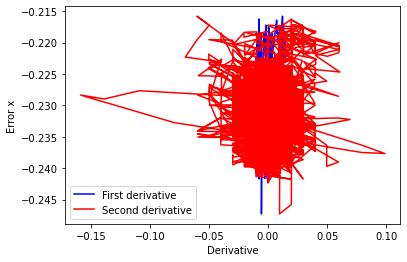

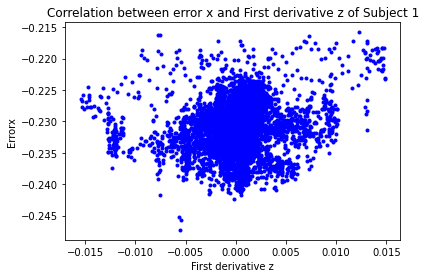

[[1.         0.18448872]
 [0.18448872 1.        ]]


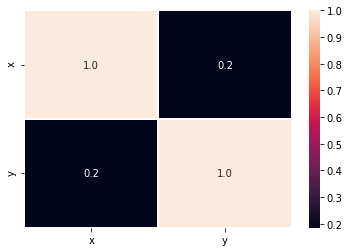

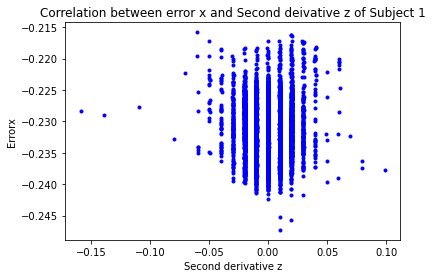

[[ 1.         -0.01728868]
 [-0.01728868  1.        ]]


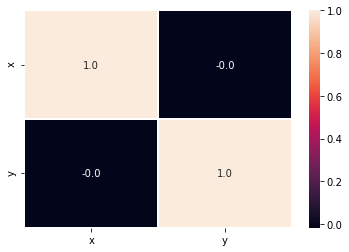

74.3
[ 0.00250586  0.00228543  0.00436475 ... -0.00020834 -0.00020832
 -0.00020829]


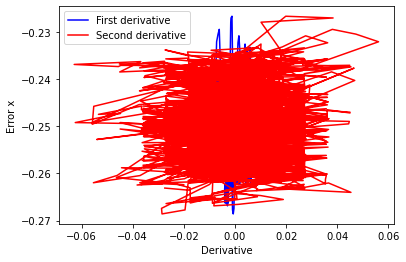

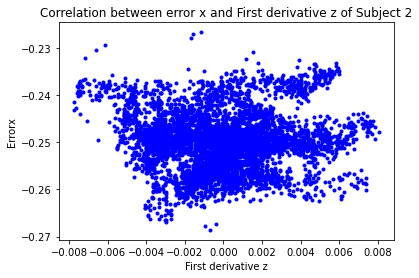

[[ 1.        -0.0040228]
 [-0.0040228  1.       ]]


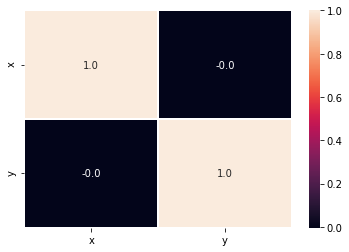

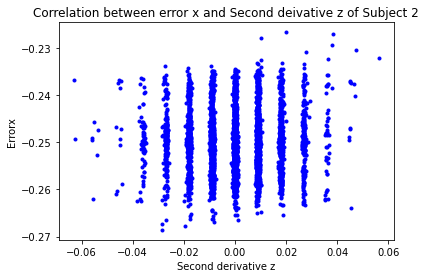

[[1.         0.02523754]
 [0.02523754 1.        ]]


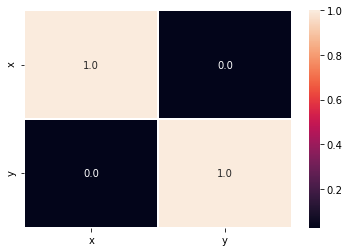

74.3
[-0.00114536  0.00023421 -0.00022916 ... -0.00162697 -0.00162677
 -0.00162653]


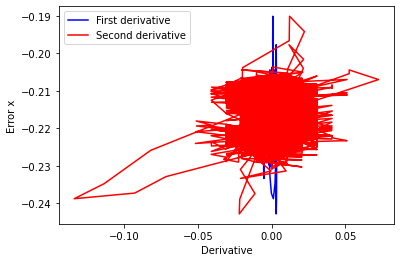

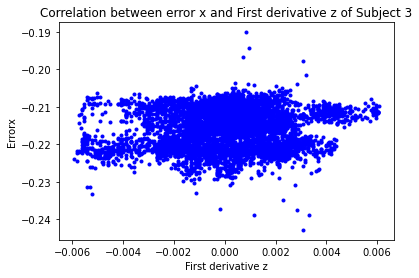

[[1.         0.11548595]
 [0.11548595 1.        ]]


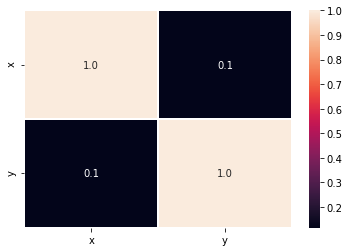

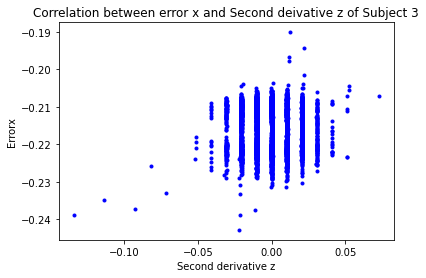

[[1.         0.03778981]
 [0.03778981 1.        ]]


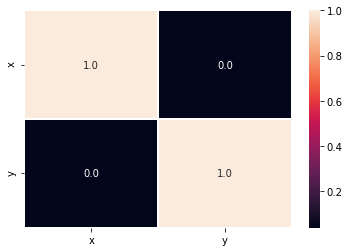

74.3
[ 0.00053299 -0.0008076  -0.00013609 ... -0.00062584 -0.00062579
 -0.00062574]


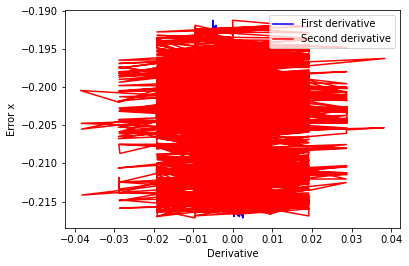

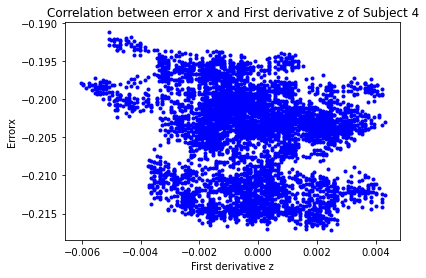

[[ 1.         -0.19347965]
 [-0.19347965  1.        ]]


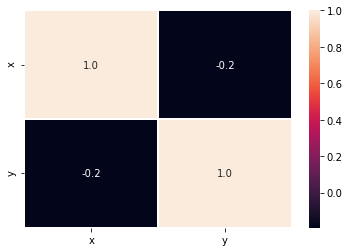

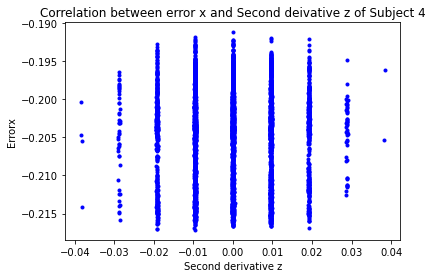

[[1.         0.00782953]
 [0.00782953 1.        ]]


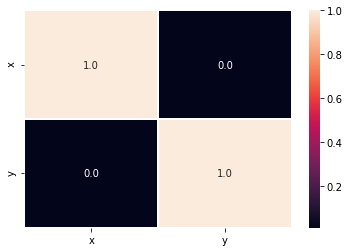

74.3
[-8.41091400e-04  1.24201421e-03  3.49235426e-03 ...  2.52872664e-06
  2.52844447e-06  2.52807104e-06]


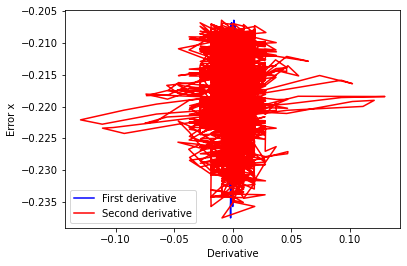

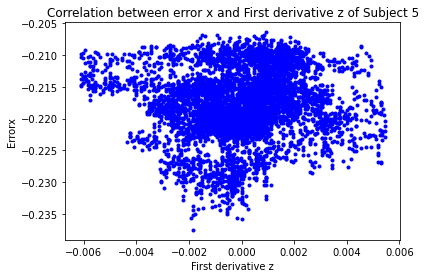

[[1.         0.05526553]
 [0.05526553 1.        ]]


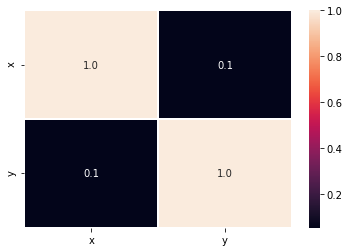

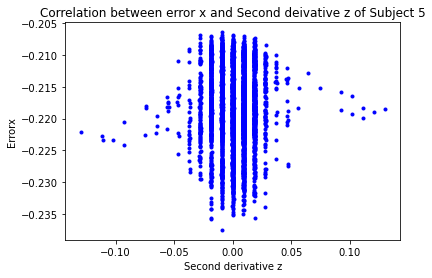

[[1.         0.00139177]
 [0.00139177 1.        ]]


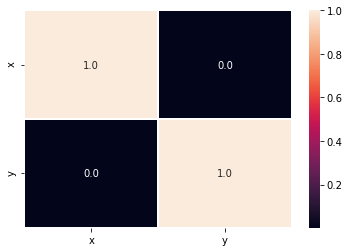

74.3
[ 0.00020194  0.00162995  0.00040663 ... -0.00056806 -0.00056801
 -0.00056795]


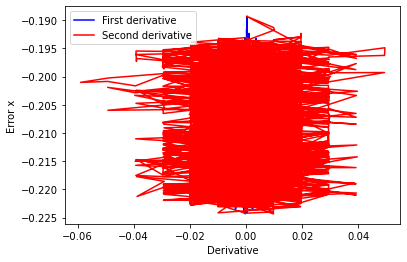

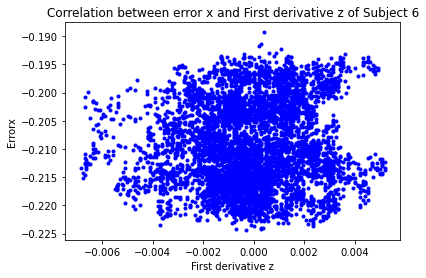

[[1.         0.06417142]
 [0.06417142 1.        ]]


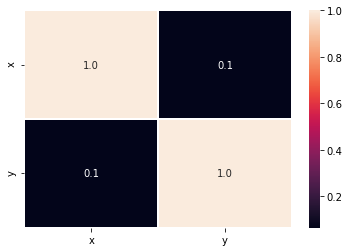

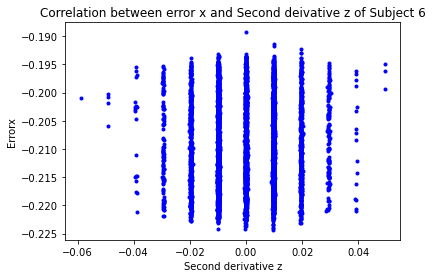

[[1.         0.00846434]
 [0.00846434 1.        ]]


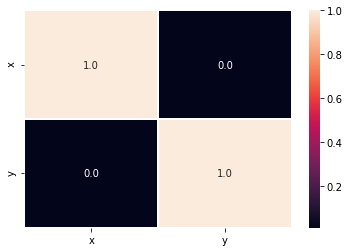

74.3
[ 0.00042813  0.002284    0.00165237 ... -0.00125035 -0.00125038
 -0.00125042]


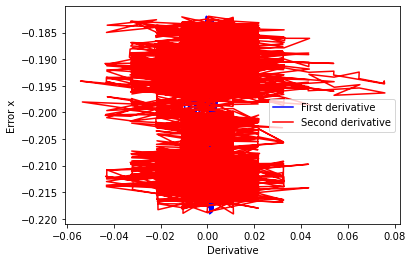

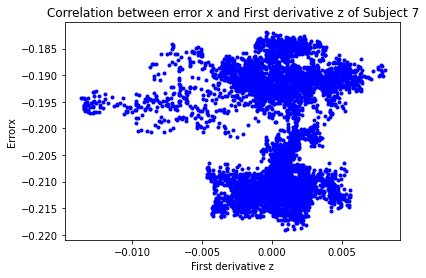

[[1.         0.03829485]
 [0.03829485 1.        ]]


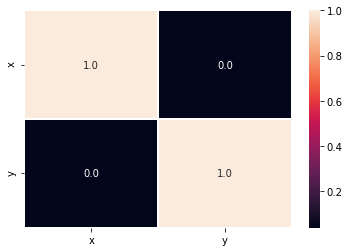

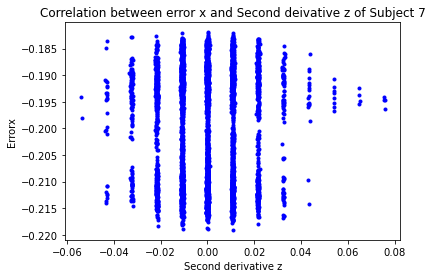

[[1.         0.00307347]
 [0.00307347 1.        ]]


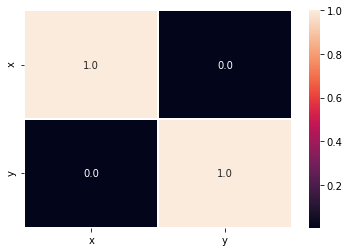

74.3
[ 2.85924872e-04  2.20309765e-07 -1.40623847e-04 ...  6.79396742e-04
  6.79389463e-04  6.79374813e-04]


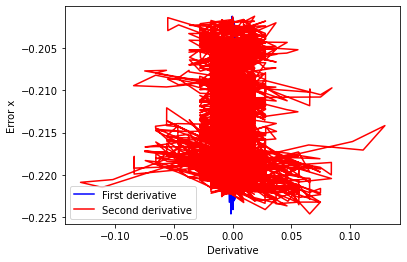

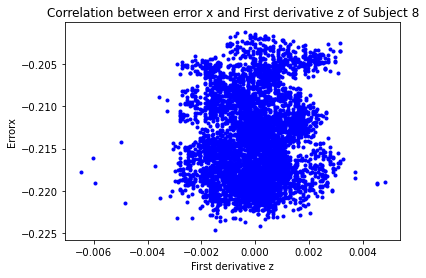

[[1.         0.06246428]
 [0.06246428 1.        ]]


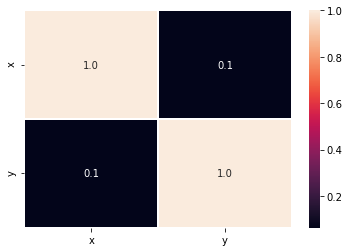

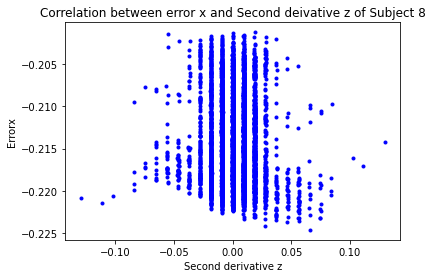

[[ 1.         -0.05513625]
 [-0.05513625  1.        ]]


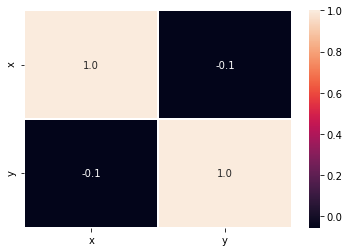

74.3
[-9.94463860e-04 -8.05185257e-04  8.43084681e-07 ...  8.34291748e-04
  8.34275595e-04  8.34246105e-04]


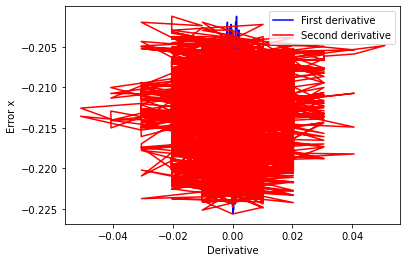

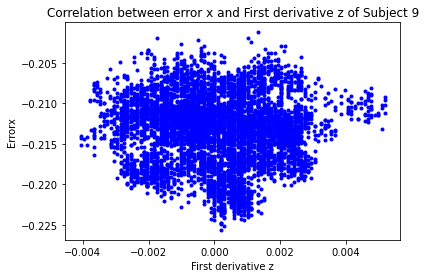

[[ 1.       -0.062142]
 [-0.062142  1.      ]]


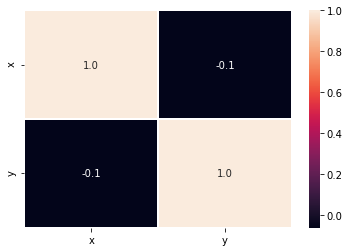

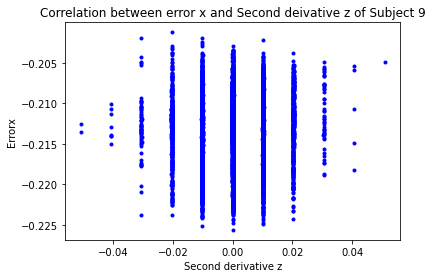

[[1.         0.02315269]
 [0.02315269 1.        ]]


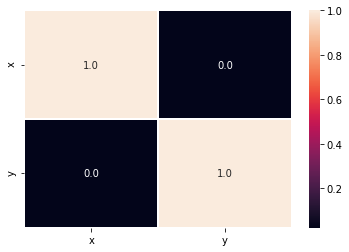

74.3
[-4.86232280e-06  7.03859861e-04  6.96670113e-04 ... -2.48830933e-04
 -2.48851854e-04 -2.48881818e-04]


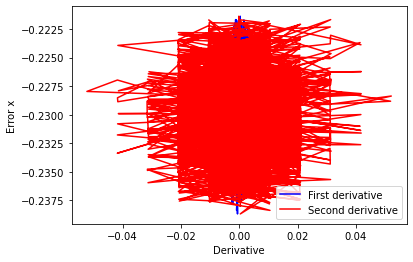

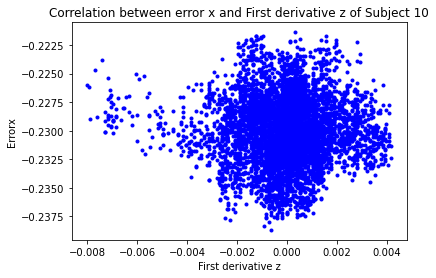

[[ 1.         -0.00528687]
 [-0.00528687  1.        ]]


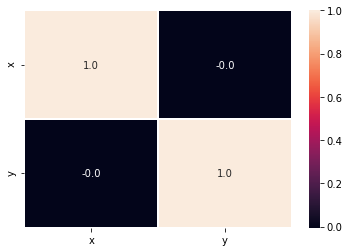

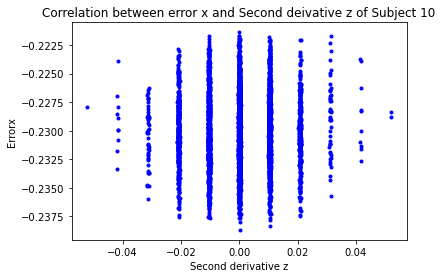

[[1.         0.03442145]
 [0.03442145 1.        ]]


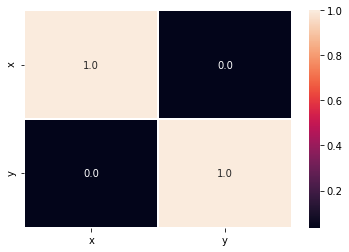

74.3
[ 0.00043958  0.00587328  0.00570288 ... -0.00068528 -0.00068542
 -0.00068562]


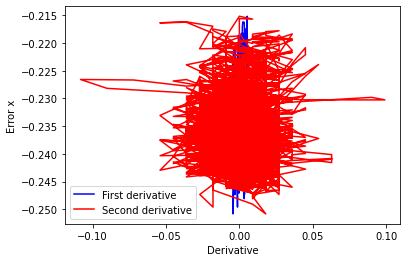

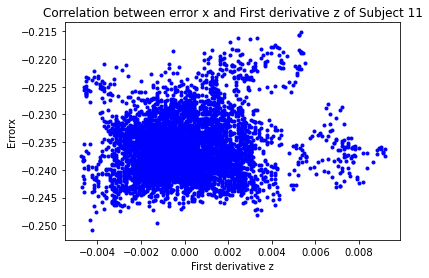

[[1.         0.07832758]
 [0.07832758 1.        ]]


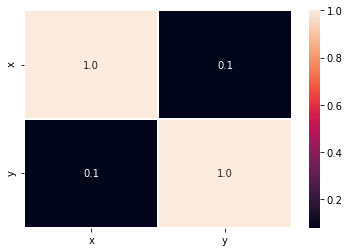

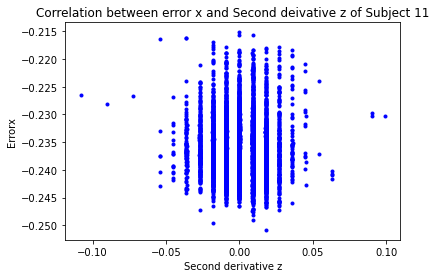

[[ 1.         -0.03333109]
 [-0.03333109  1.        ]]


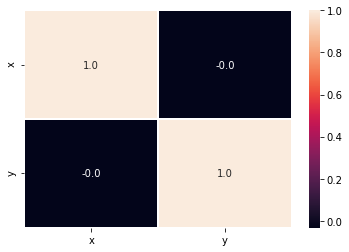

126.3
[-1.57732491e-06  9.04061315e-04  1.13748604e-03 ... -2.04883131e-04
 -2.04841728e-04 -2.04784523e-04]


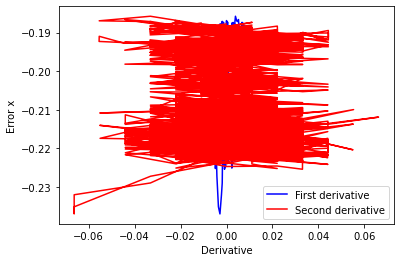

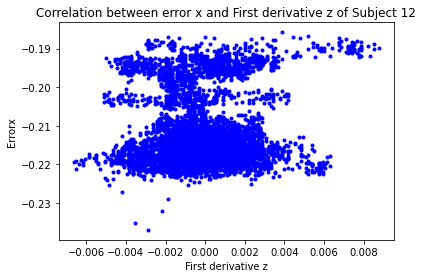

[[1.         0.08529566]
 [0.08529566 1.        ]]


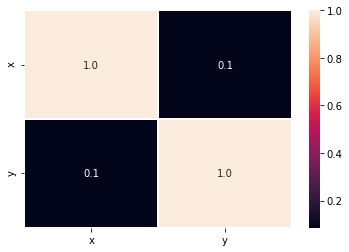

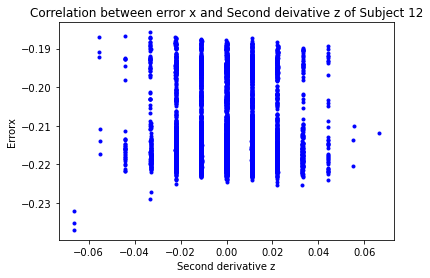

[[ 1.         -0.00741936]
 [-0.00741936  1.        ]]


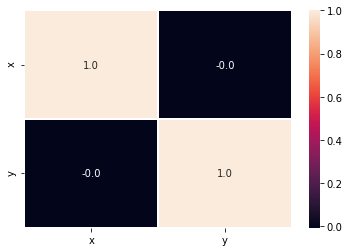

126.3
[ 9.31819792e-07 -1.18878976e-03  6.22089316e-04 ...  9.90683862e-04
  9.90626557e-04  9.90535387e-04]


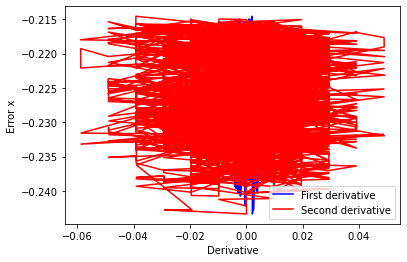

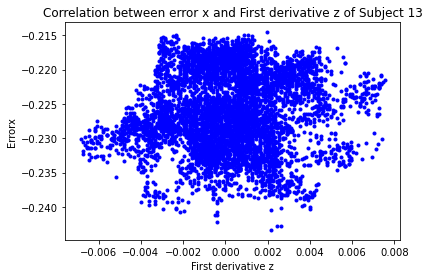

[[1.         0.06333673]
 [0.06333673 1.        ]]


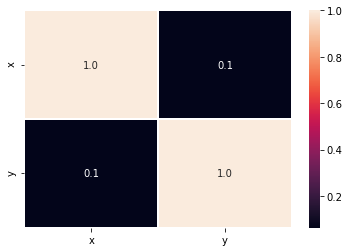

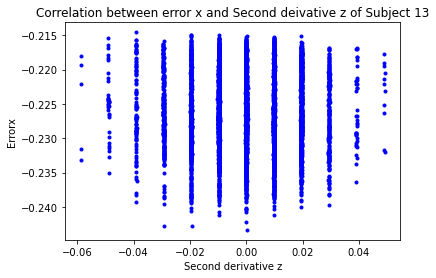

[[1.         0.00780267]
 [0.00780267 1.        ]]


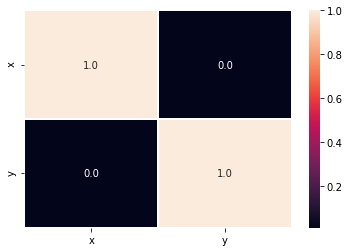

126.3
[0.00200588 0.00143426 0.00162029 ... 0.00074051 0.00074047 0.00074042]


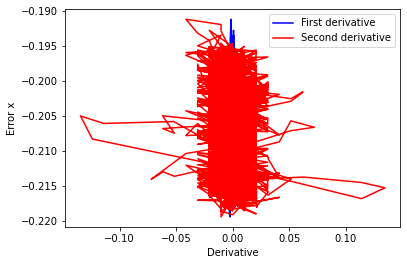

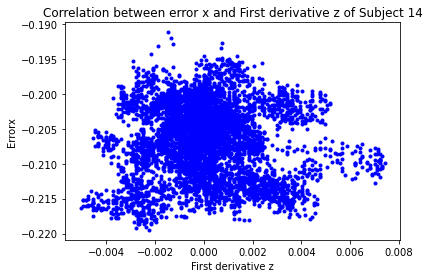

[[ 1.         -0.03860957]
 [-0.03860957  1.        ]]


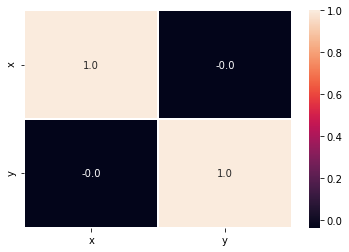

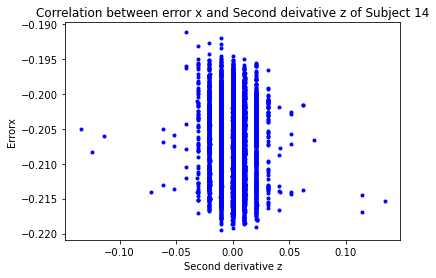

[[ 1.         -0.04741554]
 [-0.04741554  1.        ]]


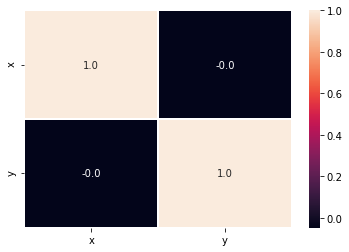

126.3
[-2.26522963e-04 -1.65036030e-04  2.25142887e-03 ...  2.77190723e-08
  2.77198876e-08  2.77208353e-08]


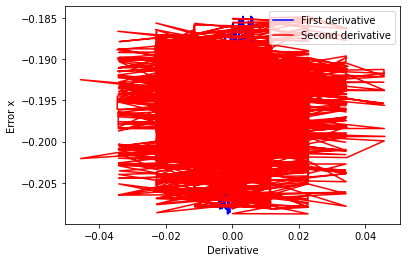

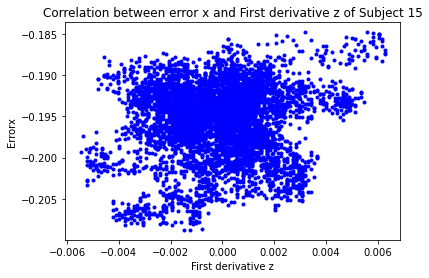

[[1.         0.10821637]
 [0.10821637 1.        ]]


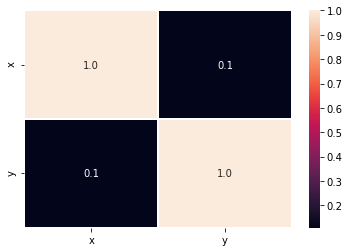

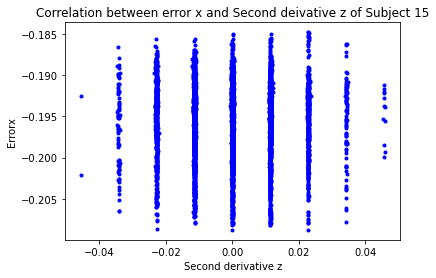

[[1.         0.00609796]
 [0.00609796 1.        ]]


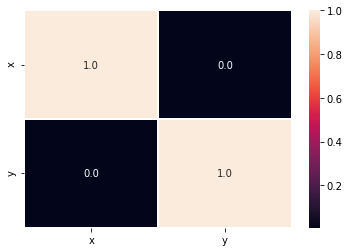

126.3
[-2.33845776e-04 -2.32789918e-04 -2.33842259e-04 ...  4.03384392e-06
  4.03347395e-06  4.03296088e-06]


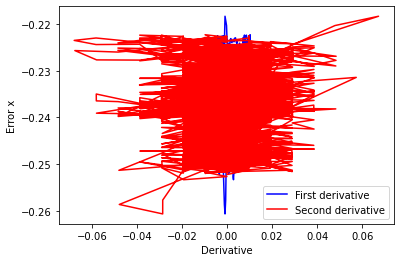

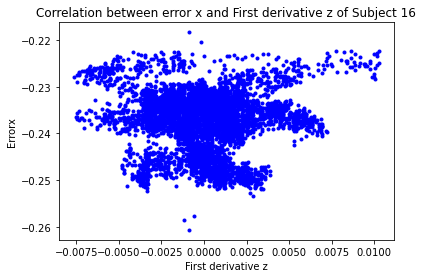

[[ 1.         -0.01544941]
 [-0.01544941  1.        ]]


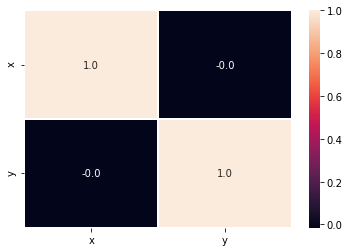

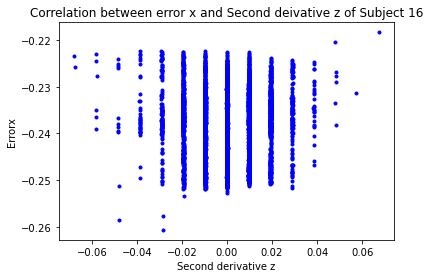

[[1.         0.00108607]
 [0.00108607 1.        ]]


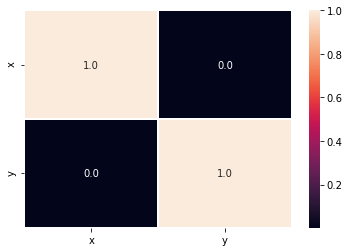

126.3
[ 3.38936963e-06  1.51466815e-04 -6.95949657e-04 ... -4.86398730e-04
 -4.86534091e-04 -4.86716271e-04]


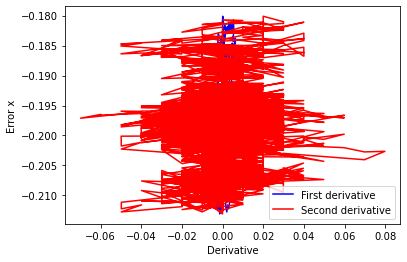

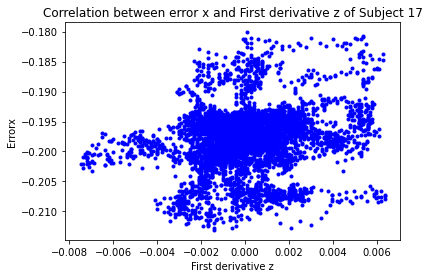

[[1.         0.17963825]
 [0.17963825 1.        ]]


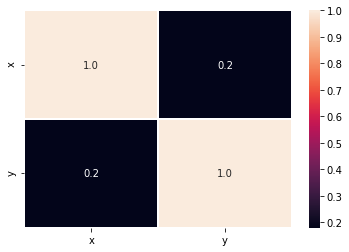

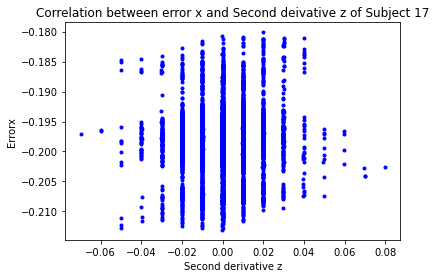

[[1.         0.05838031]
 [0.05838031 1.        ]]


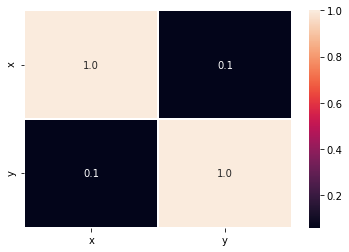

126.3
[ 0.00111058  0.00088068  0.00112563 ... -0.00086259 -0.00086261
 -0.00086264]


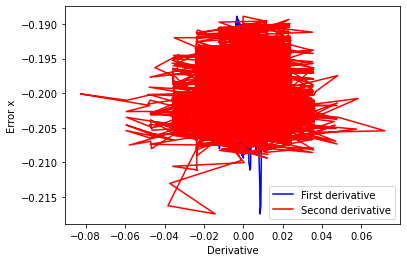

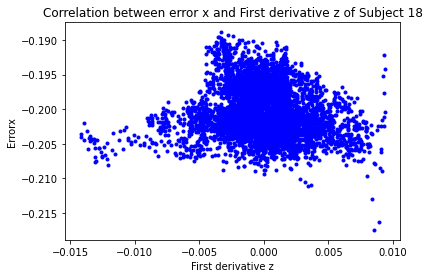

[[ 1.         -0.10898395]
 [-0.10898395  1.        ]]


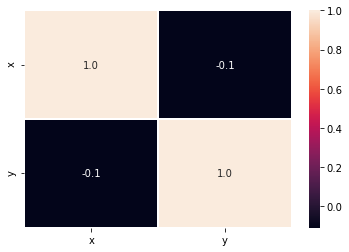

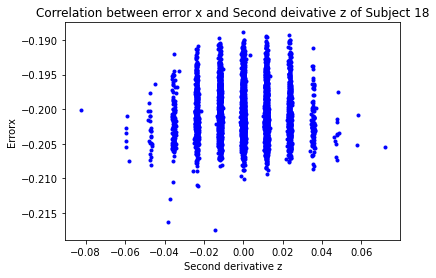

[[1.         0.02400603]
 [0.02400603 1.        ]]


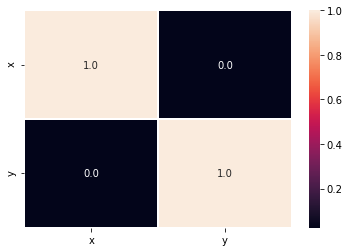

126.3
[ 0.00251436  0.00224008  0.00421654 ... -0.00039767 -0.00039775
 -0.00039786]


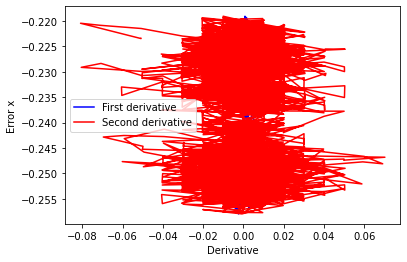

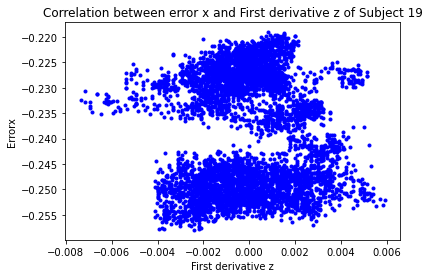

[[1.         0.00800258]
 [0.00800258 1.        ]]


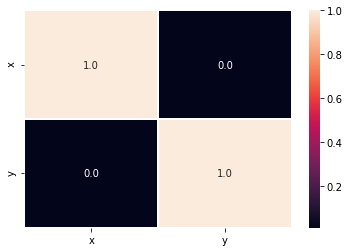

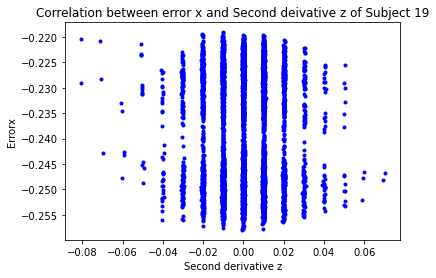

[[ 1.         -0.01240245]
 [-0.01240245  1.        ]]


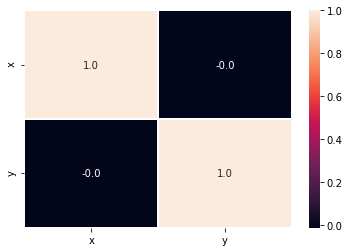

126.3
[-0.00114876 -0.00068501 -0.00022313 ...  0.00021031  0.0002103
  0.00021028]


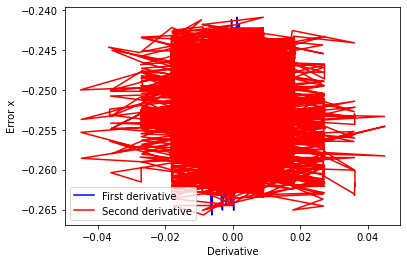

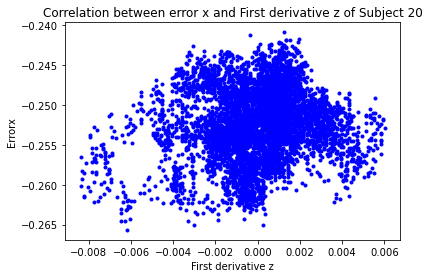

[[1.         0.13283661]
 [0.13283661 1.        ]]


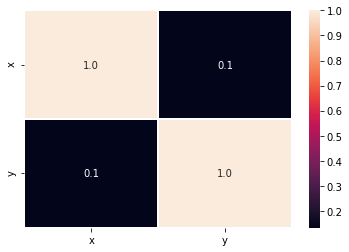

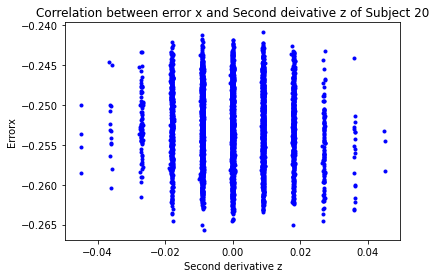

[[ 1.         -0.05190211]
 [-0.05190211  1.        ]]


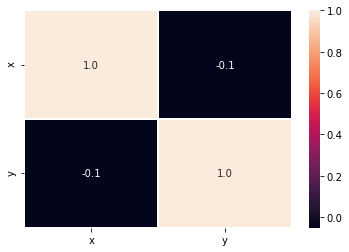

126.3
[ 0.00015677  0.00087944  0.00144457 ... -0.0002993  -0.00029929
 -0.00029928]


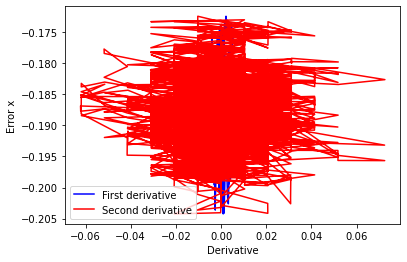

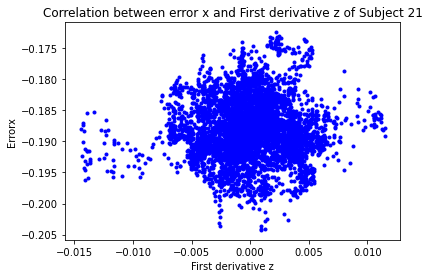

[[1.         0.02358272]
 [0.02358272 1.        ]]


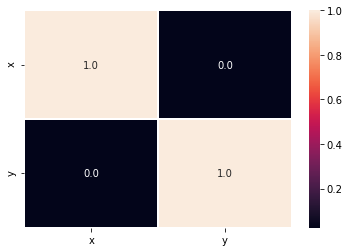

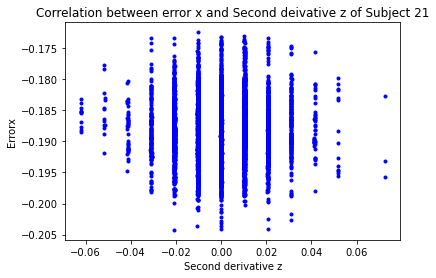

[[ 1.         -0.00754355]
 [-0.00754355  1.        ]]


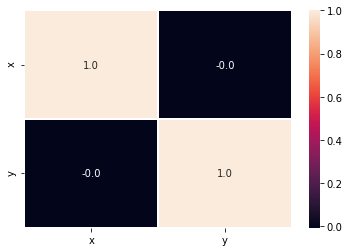

126.3
[ 2.02365423e-03  8.97753611e-04  2.02382804e-03 ... -2.98725578e-06
 -2.98778049e-06 -2.98870067e-06]


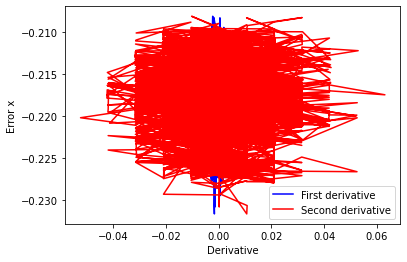

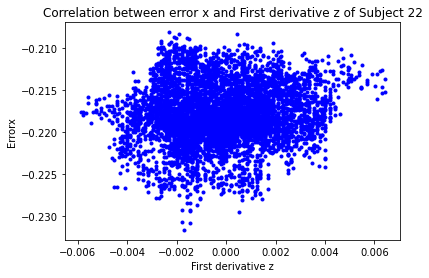

[[1.        0.1035595]
 [0.1035595 1.       ]]


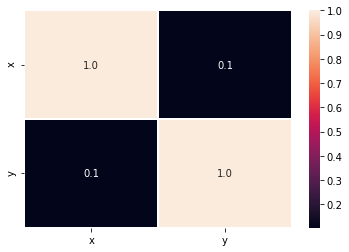

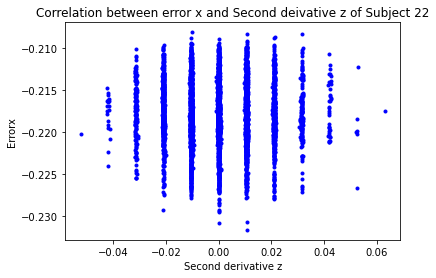

[[ 1.         -0.02054785]
 [-0.02054785  1.        ]]


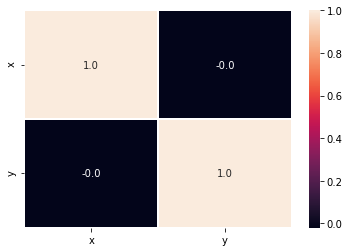

126.3
[-0.00142235 -0.00099119 -0.00142234 ...  0.00078366  0.00078364
  0.0007836 ]


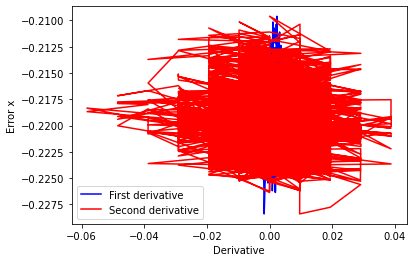

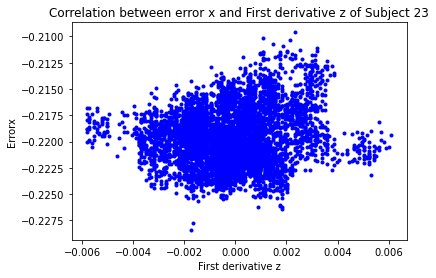

[[1.         0.13835936]
 [0.13835936 1.        ]]


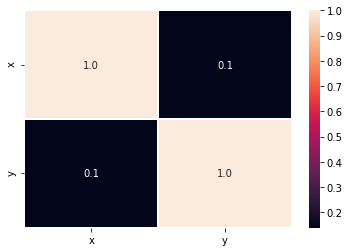

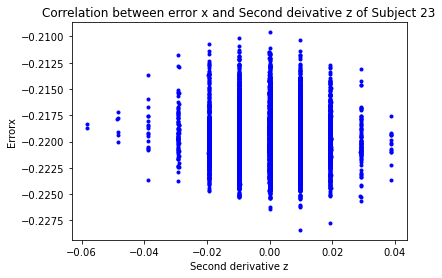

[[ 1.         -0.04756518]
 [-0.04756518  1.        ]]


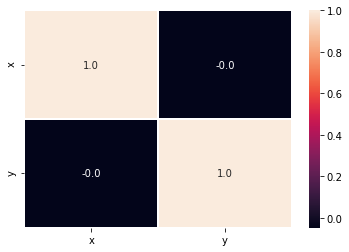

52.9
[0.00037378 0.00178077 0.00196912 ... 0.00041847 0.00041832 0.00041811]


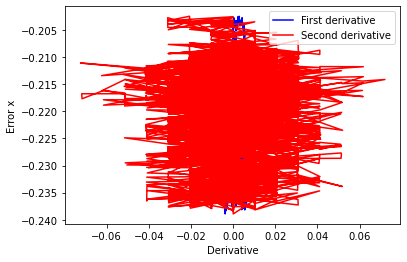

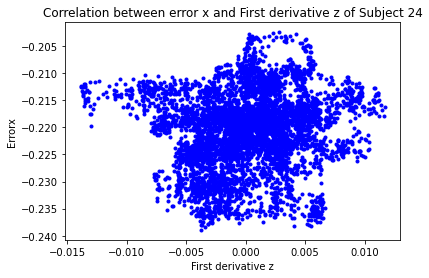

[[1.         0.12002121]
 [0.12002121 1.        ]]


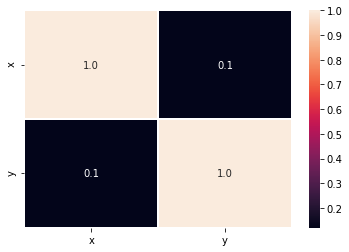

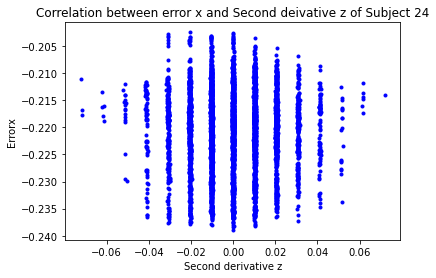

[[1.         0.01306671]
 [0.01306671 1.        ]]


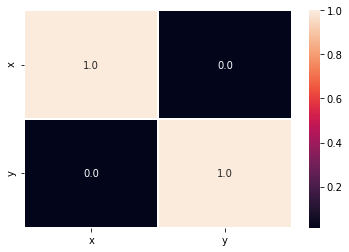

52.9
[2.20048971e-03 3.16095813e-03 2.90296228e-03 ... 2.76927244e-08
 2.76928517e-08 2.76930553e-08]


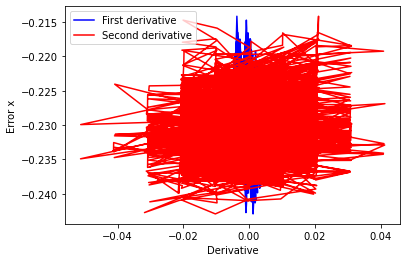

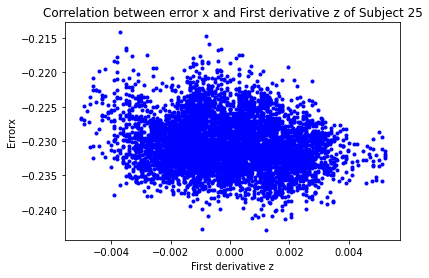

[[ 1.         -0.16294441]
 [-0.16294441  1.        ]]


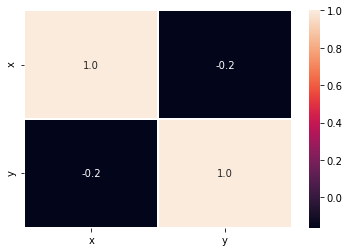

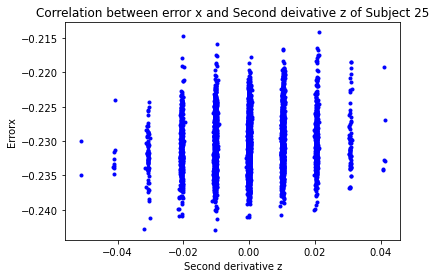

[[1.         0.08905756]
 [0.08905756 1.        ]]


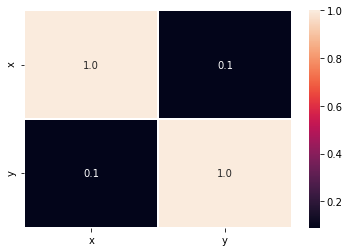

52.9
[0.00262089 0.00111268 0.00370495 ... 0.00123841 0.00123839 0.00123836]


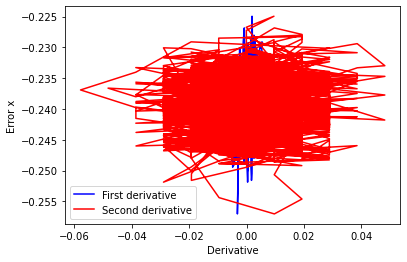

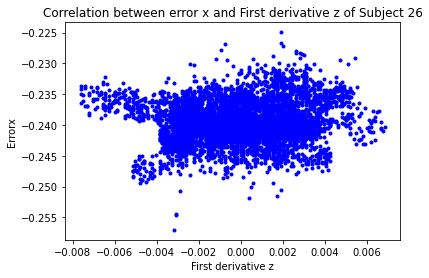

[[1.         0.08978532]
 [0.08978532 1.        ]]


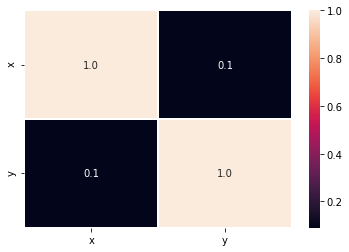

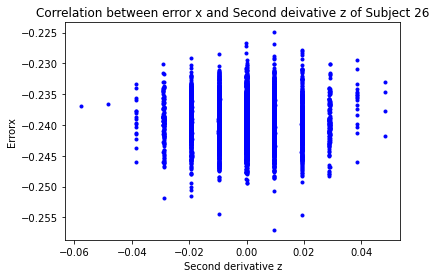

[[ 1.         -0.01488521]
 [-0.01488521  1.        ]]


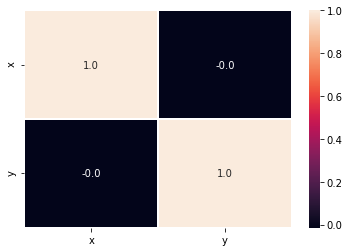

52.9
[ 0.00103392 -0.00028314  0.00205582 ...  0.00023084  0.00023085
  0.00023087]


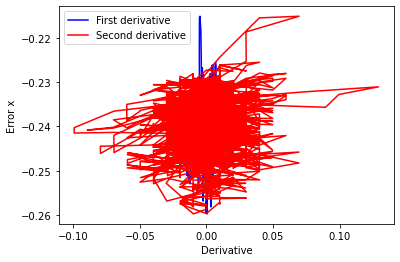

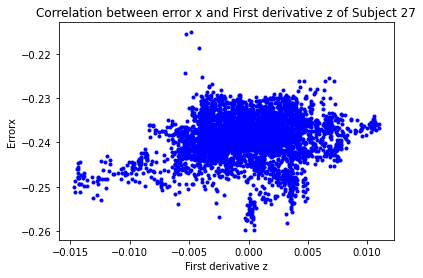

[[1.        0.1538172]
 [0.1538172 1.       ]]


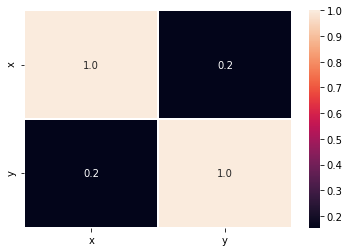

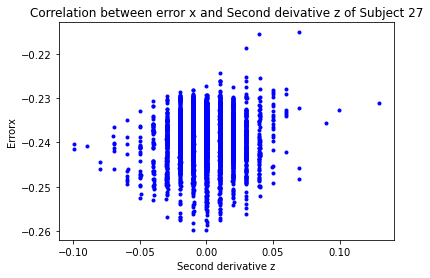

[[1.        0.0478446]
 [0.0478446 1.       ]]


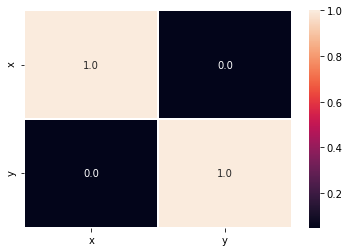

52.9
[-0.00130157 -0.00130383 -0.00161987 ...  0.00070539  0.00070535
  0.00070529]


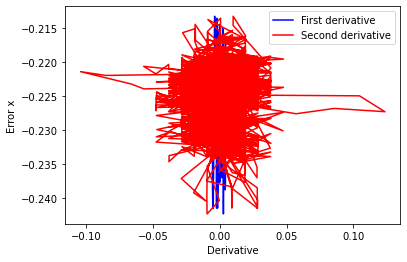

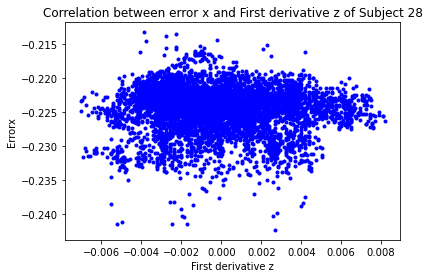

[[ 1.         -0.02850396]
 [-0.02850396  1.        ]]


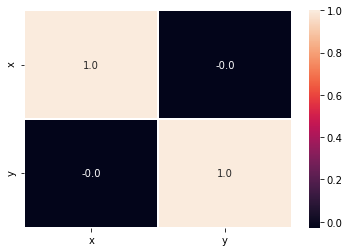

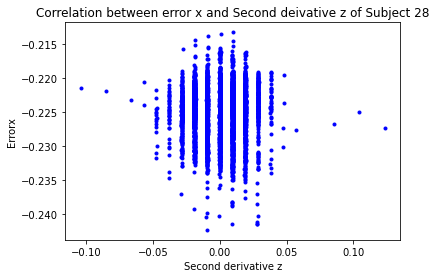

[[1.         0.00819997]
 [0.00819997 1.        ]]


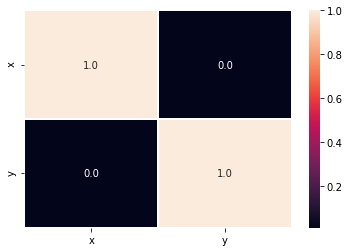

52.9
[ 0.00080459  0.00080411  0.00080364 ... -0.00152081 -0.00152133
 -0.00152207]


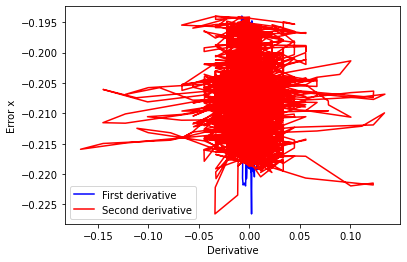

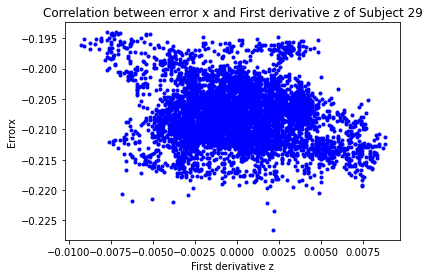

[[ 1.         -0.16874755]
 [-0.16874755  1.        ]]


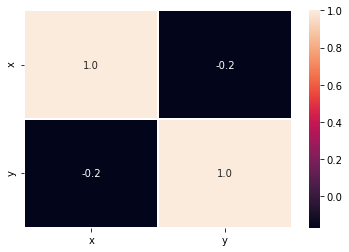

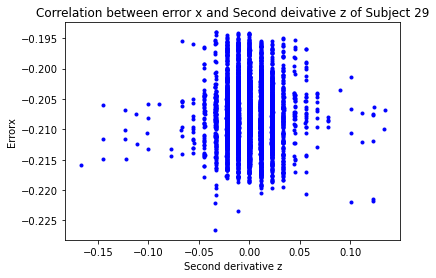

[[ 1.         -0.01578444]
 [-0.01578444  1.        ]]


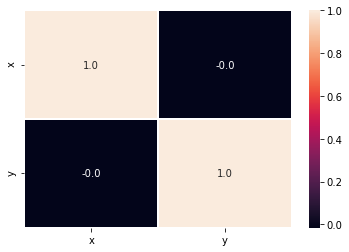

52.9
[ 1.33152377e-03 -3.17222877e-07  1.63082518e-03 ...  9.81761181e-04
  9.81690504e-04  9.81578524e-04]


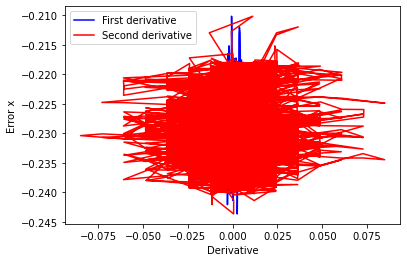

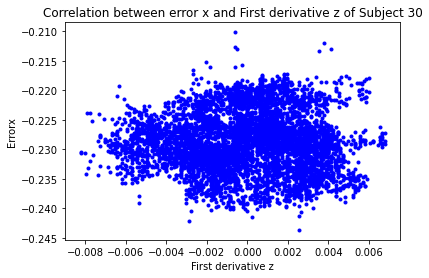

[[ 1.        -0.0039278]
 [-0.0039278  1.       ]]


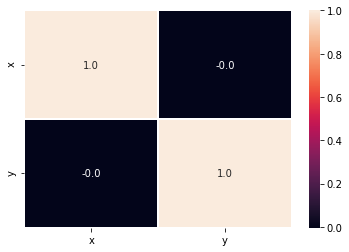

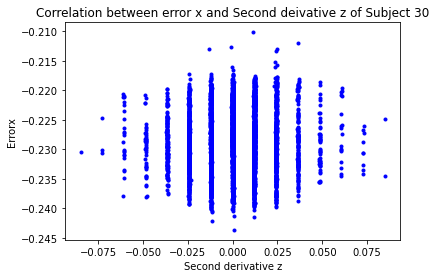

[[1.         0.01078315]
 [0.01078315 1.        ]]


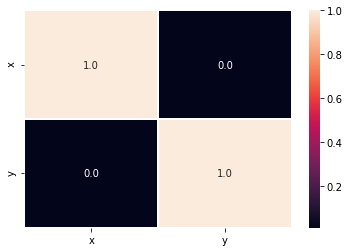

52.9
[-0.00460512 -0.00441523 -0.00380602 ...  0.00139619  0.00139644
  0.00139676]


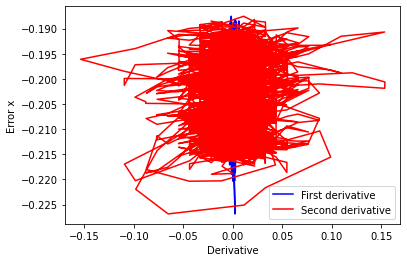

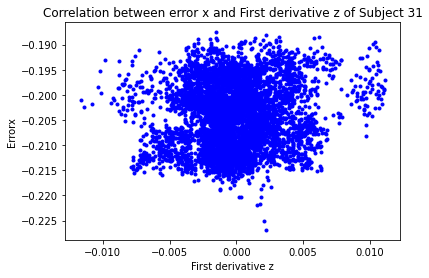

[[1.         0.09916883]
 [0.09916883 1.        ]]


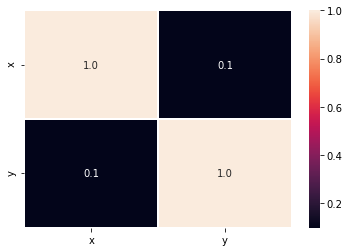

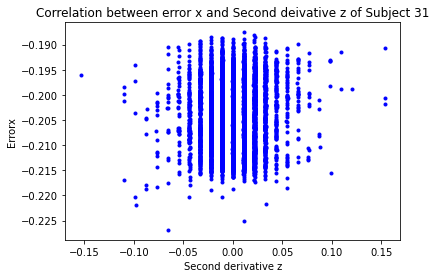

[[1.        0.0437287]
 [0.0437287 1.       ]]


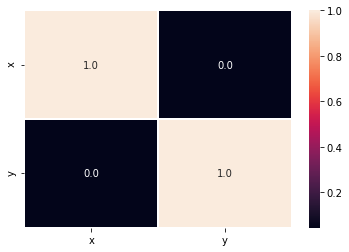

52.9
[ 0.00096849 -0.00023811 -0.00066757 ... -0.00183837 -0.00183851
 -0.00183874]


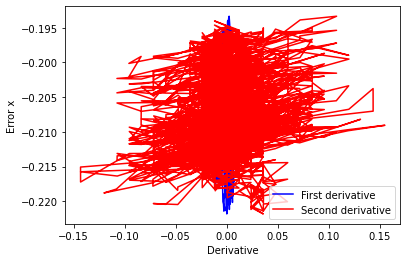

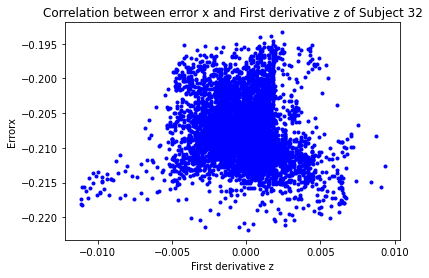

[[ 1.         -0.10368579]
 [-0.10368579  1.        ]]


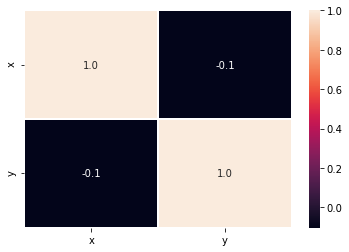

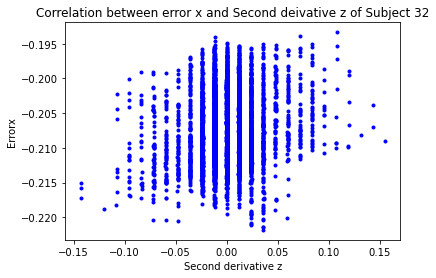

[[1.         0.14053129]
 [0.14053129 1.        ]]


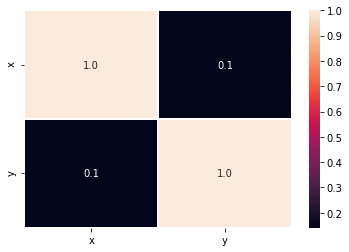

52.9
[-0.00069392  0.00068588 -0.00046576 ... -0.00020688 -0.00020688
 -0.00020687]


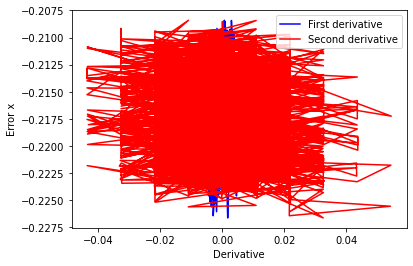

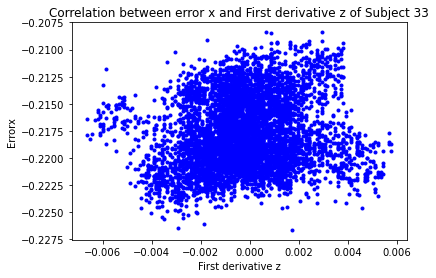

[[1.         0.12958447]
 [0.12958447 1.        ]]


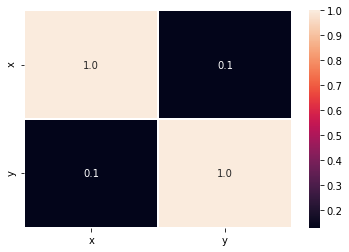

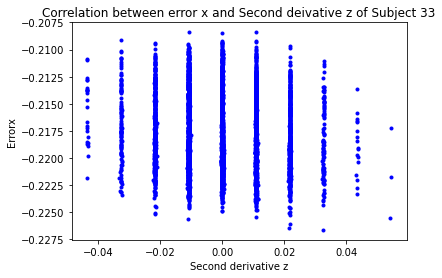

[[ 1.         -0.08098915]
 [-0.08098915  1.        ]]


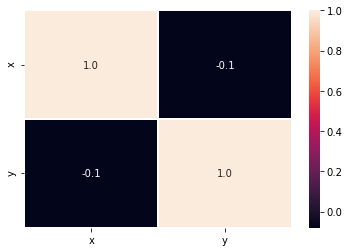

52.9
[-0.01178569 -0.01096075 -0.00434326 ...  0.00168401  0.00168443
  0.001685  ]


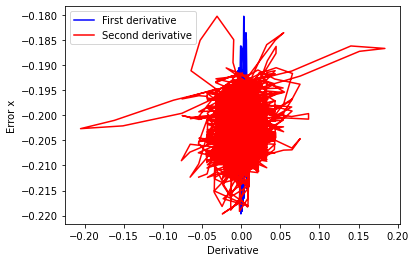

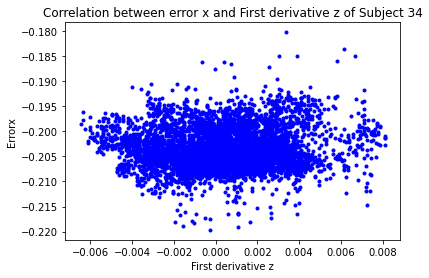

[[1.         0.07095529]
 [0.07095529 1.        ]]


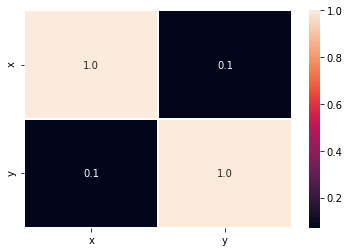

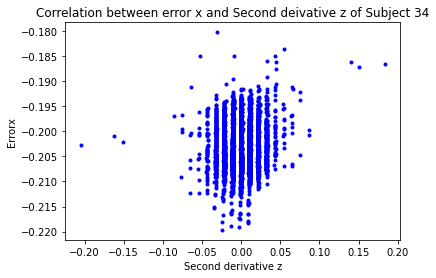

[[1.         0.10067793]
 [0.10067793 1.        ]]


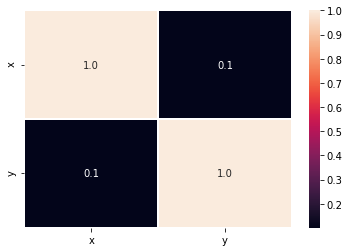

52.9
[ 3.29540281e-04  1.38905677e-07  2.55830973e-03 ... -4.53703589e-06
 -4.53710854e-06 -4.53723315e-06]


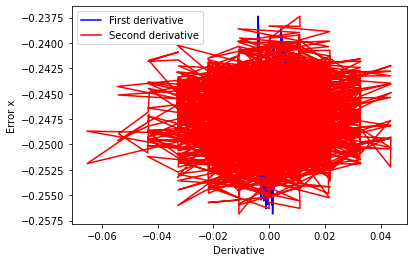

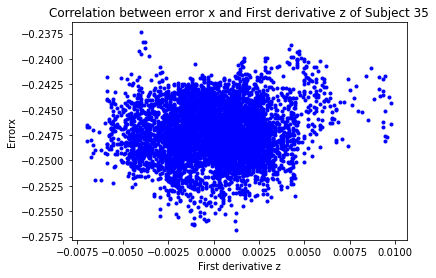

[[1.         0.08467516]
 [0.08467516 1.        ]]


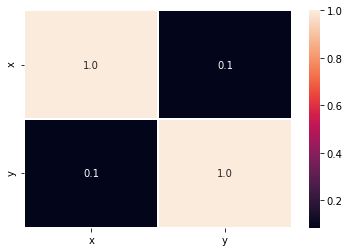

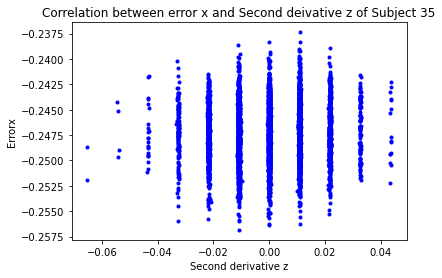

[[1.         0.04382811]
 [0.04382811 1.        ]]


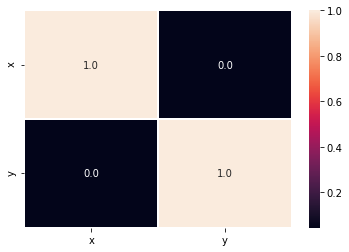

75.85
[-0.00759797 -0.00330673  0.00386649 ...  0.00191159  0.0019116
  0.00191159]


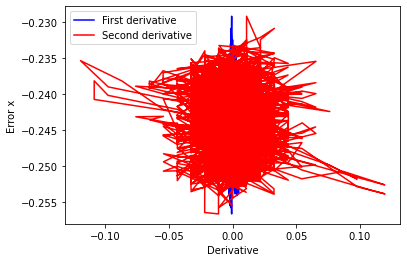

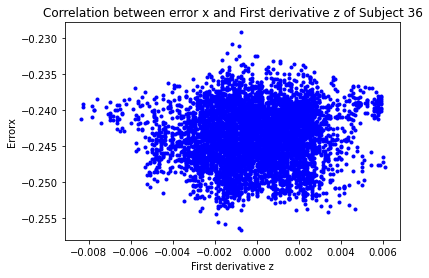

[[1.         0.05011249]
 [0.05011249 1.        ]]


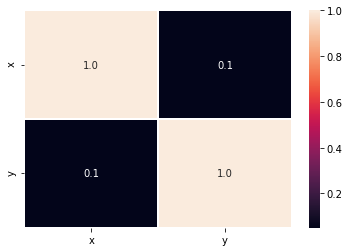

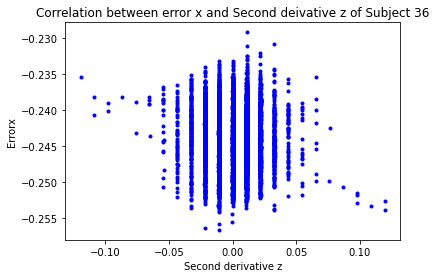

[[ 1.         -0.04685757]
 [-0.04685757  1.        ]]


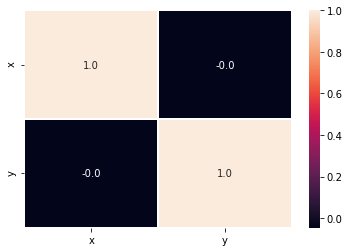

75.85
[ 0.00114163  0.004138    0.00206866 ... -0.00156783 -0.00156747
 -0.00156698]


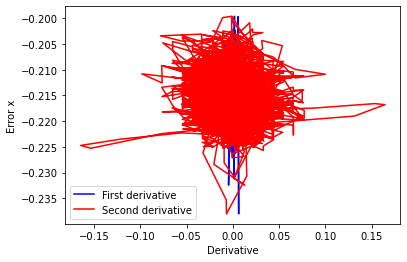

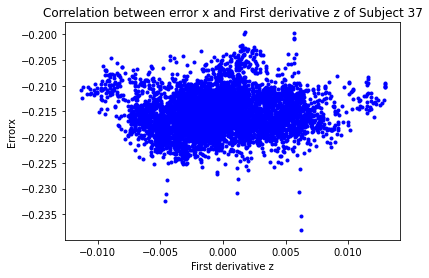

[[1.         0.08519548]
 [0.08519548 1.        ]]


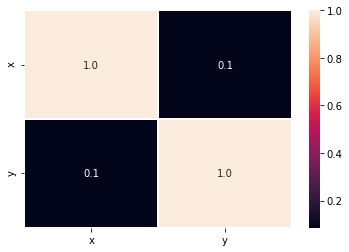

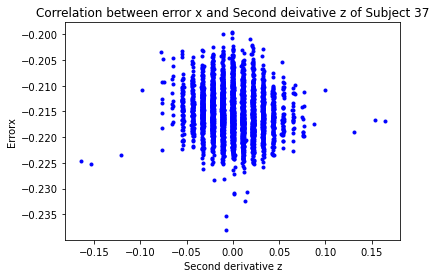

[[ 1.         -0.11226816]
 [-0.11226816  1.        ]]


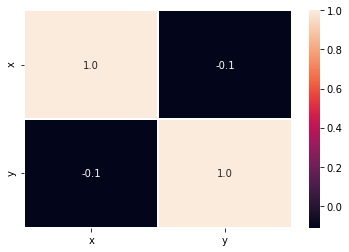

75.85
[-0.00098419 -0.00098931 -0.00125243 ...  0.00238367  0.0023837
  0.0023837 ]


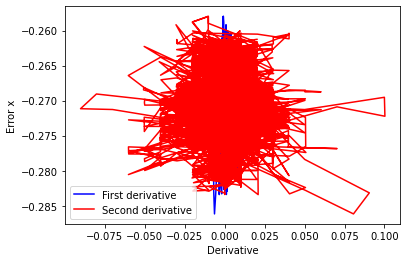

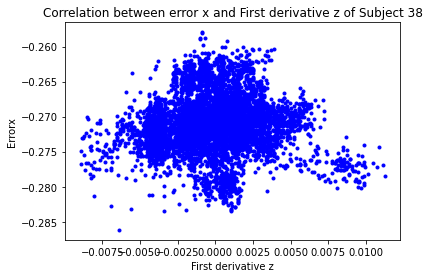

[[1.         0.02381339]
 [0.02381339 1.        ]]


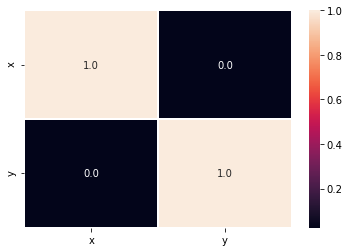

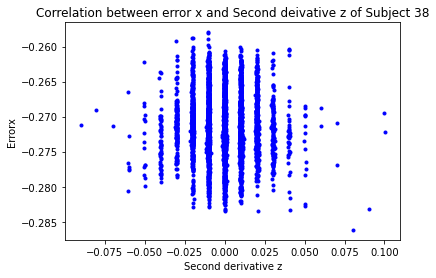

[[ 1.         -0.00367962]
 [-0.00367962  1.        ]]


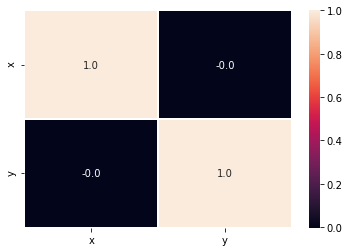

75.85
[-0.00160655 -0.00056865 -0.00018943 ...  0.0008693   0.00086929
  0.00086927]


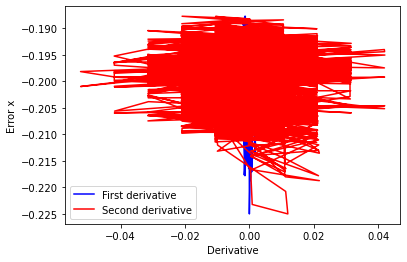

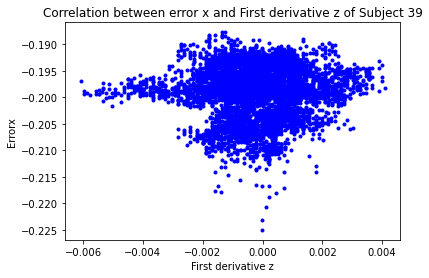

[[1.         0.04211604]
 [0.04211604 1.        ]]


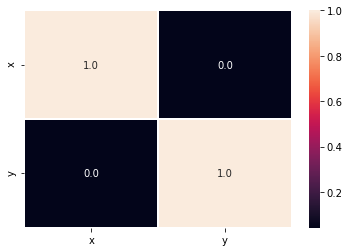

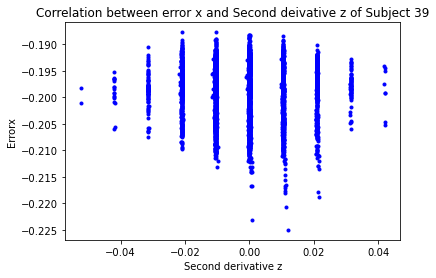

[[ 1.         -0.01118956]
 [-0.01118956  1.        ]]


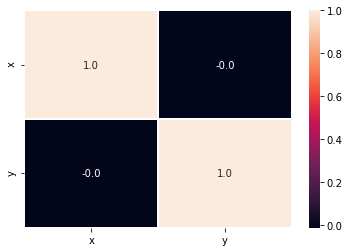

75.85
[ 1.32064406e-06  7.70183879e-04  9.47374020e-04 ... -1.73715057e-04
 -1.73725011e-04 -1.73739318e-04]


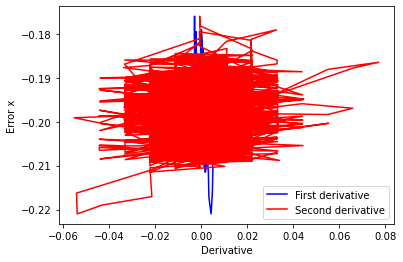

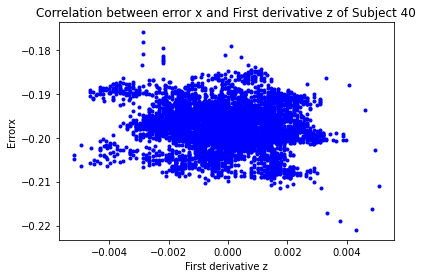

[[ 1.         -0.13696646]
 [-0.13696646  1.        ]]


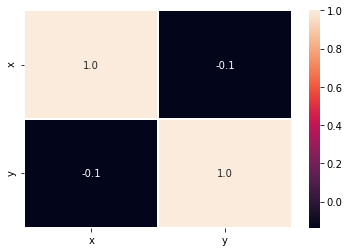

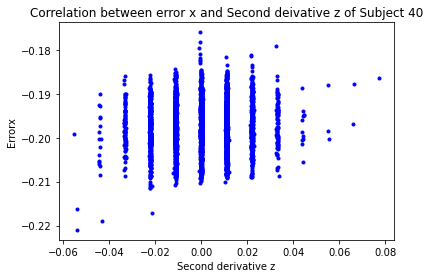

[[1.         0.04475443]
 [0.04475443 1.        ]]


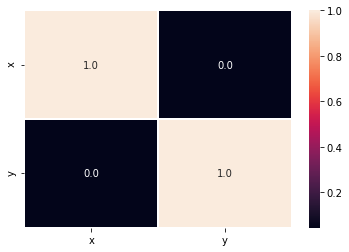

75.85
[ 8.91113432e-06 -2.22366067e-03  9.17484196e-06 ... -1.19976798e-03
 -1.19981300e-03 -1.19989033e-03]


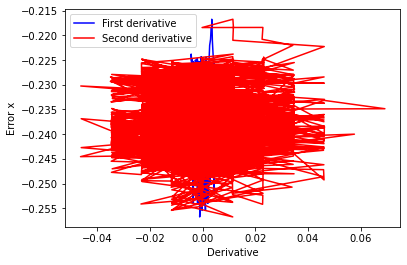

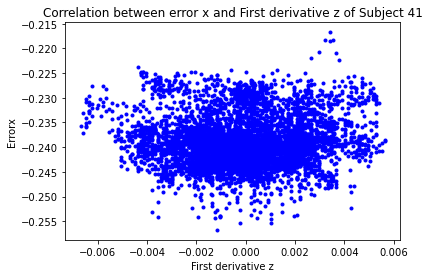

[[1.         0.03118118]
 [0.03118118 1.        ]]


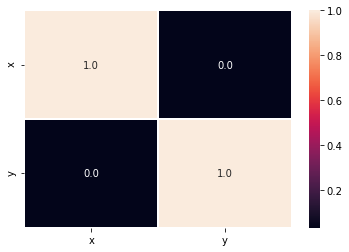

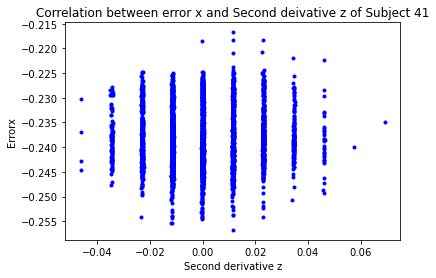

[[1.         0.01300191]
 [0.01300191 1.        ]]


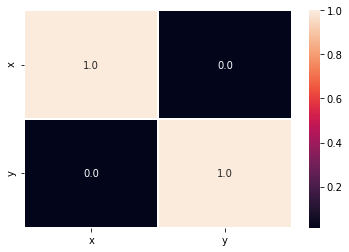

75.85
[-0.00096911  0.00052354 -0.00071761 ... -0.00090305 -0.00090313
 -0.00090324]


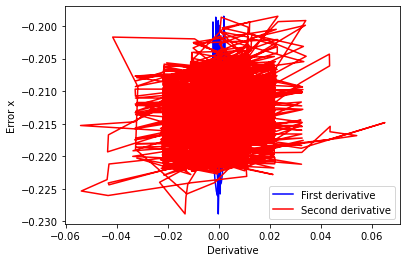

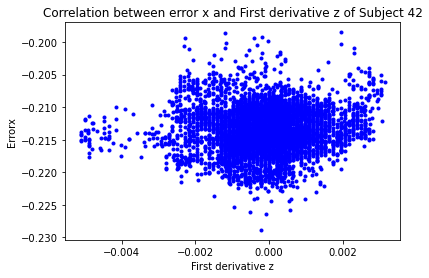

[[1.         0.07932432]
 [0.07932432 1.        ]]


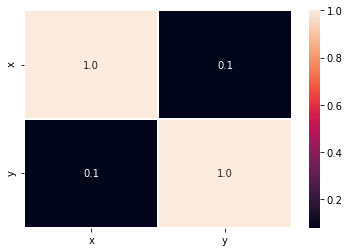

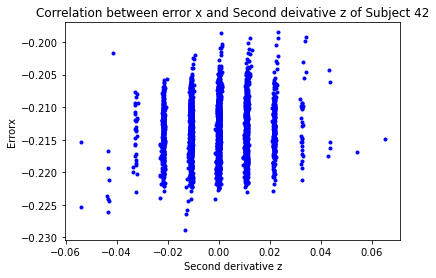

[[1.         0.08346617]
 [0.08346617 1.        ]]


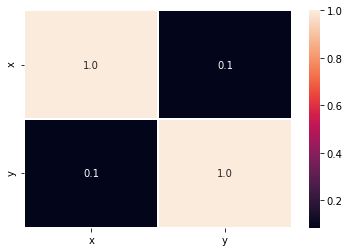

75.85
[-2.89992441e-04  7.13955756e-04  5.71243687e-04 ... -2.73884065e-06
 -2.73848917e-06 -2.73799807e-06]


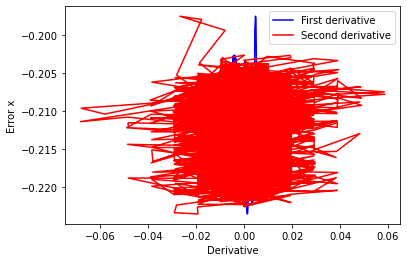

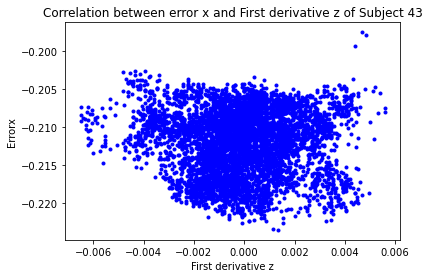

[[ 1.         -0.02162554]
 [-0.02162554  1.        ]]


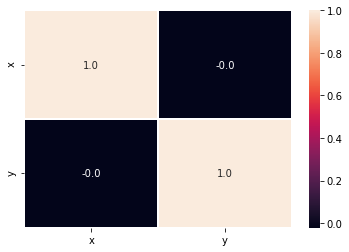

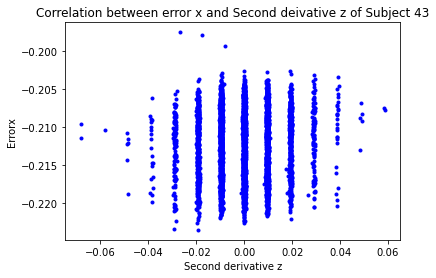

[[1.         0.07704572]
 [0.07704572 1.        ]]


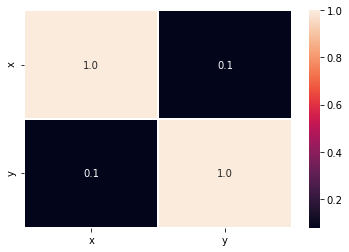

75.85
[ 0.00015061 -0.00055425 -0.00055553 ...  0.0005984   0.00059822
  0.00059797]


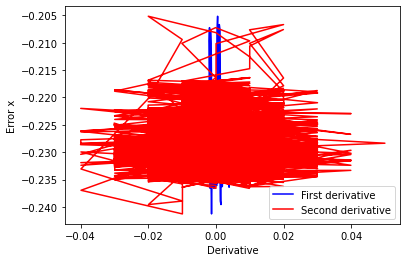

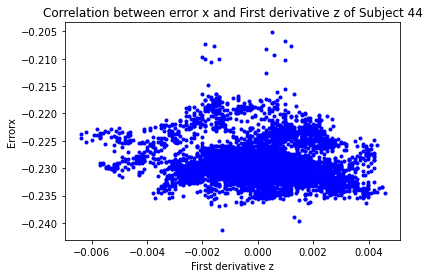

[[ 1.         -0.12423678]
 [-0.12423678  1.        ]]


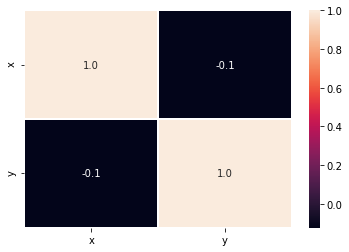

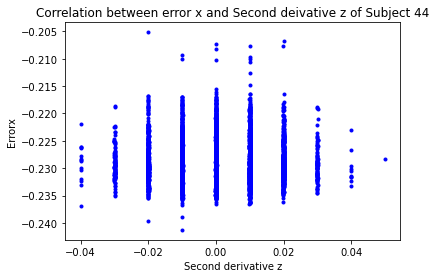

[[ 1.0000000e+00 -2.1124955e-04]
 [-2.1124955e-04  1.0000000e+00]]


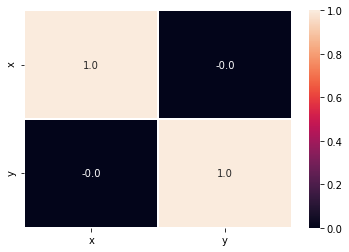

75.85
[-2.17702345e-02 -6.16317339e-03  3.05174706e-03 ...  9.05307372e-07
  9.05431200e-07  9.05572802e-07]


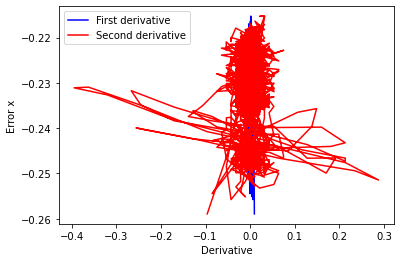

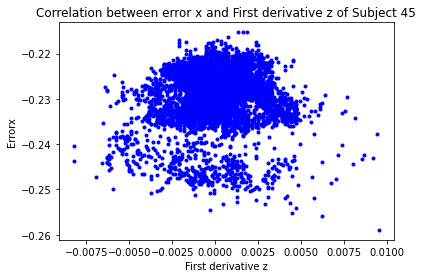

[[1.         0.05512611]
 [0.05512611 1.        ]]


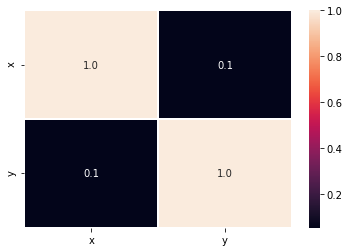

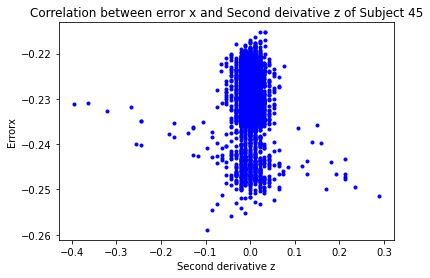

[[ 1.         -0.01930639]
 [-0.01930639  1.        ]]


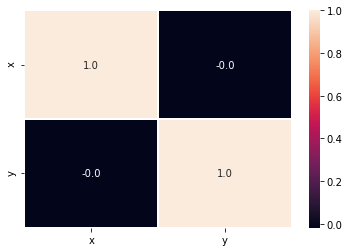

75.85
[-0.00172322 -0.00077161 -0.00137303 ...  0.00015119  0.00015117
  0.00015115]


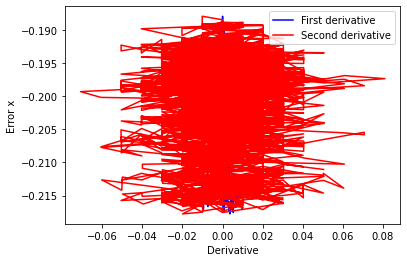

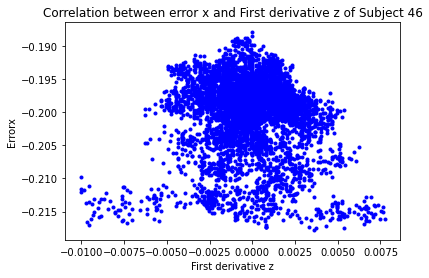

[[ 1.         -0.04887409]
 [-0.04887409  1.        ]]


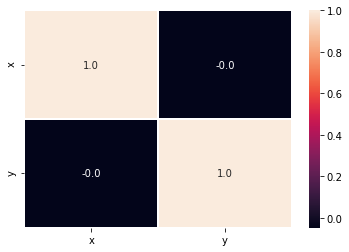

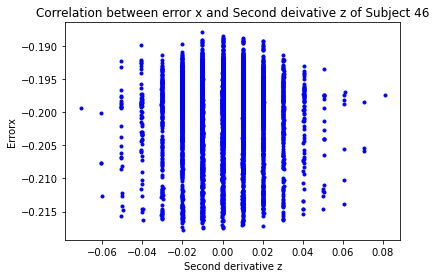

[[1.00000000e+00 7.08553892e-04]
 [7.08553892e-04 1.00000000e+00]]


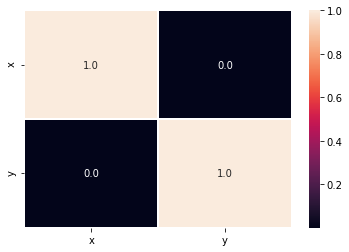

75.85
[ 3.78320705e-06 -2.25276870e-04  6.59448210e-04 ... -1.02632765e-03
 -1.02651370e-03 -1.02678752e-03]


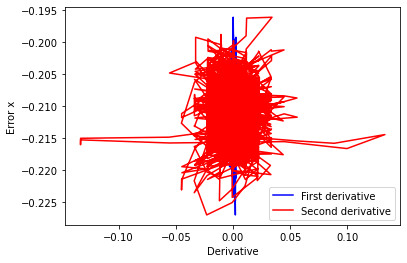

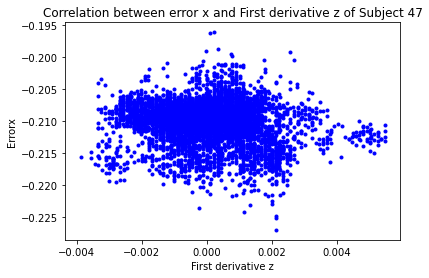

[[ 1.         -0.13271567]
 [-0.13271567  1.        ]]


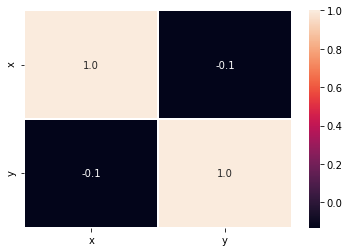

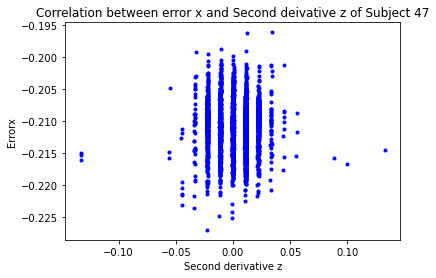

[[ 1.        -0.0036415]
 [-0.0036415  1.       ]]


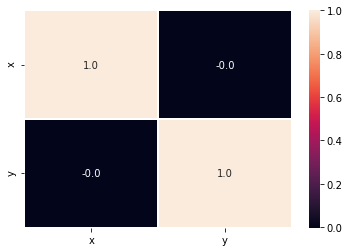

61.05
[-0.0024744  -0.0006725  -0.00294638 ... -0.00236074 -0.0023621
 -0.00236406]


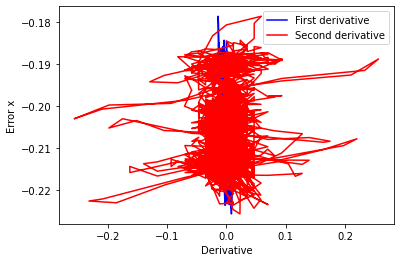

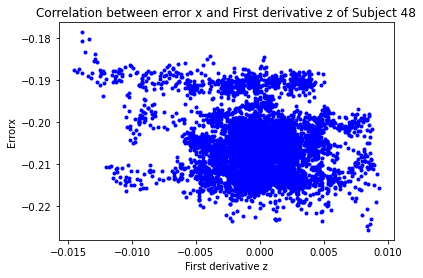

[[ 1.         -0.15181977]
 [-0.15181977  1.        ]]


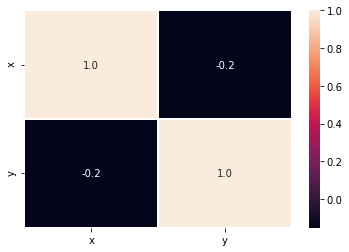

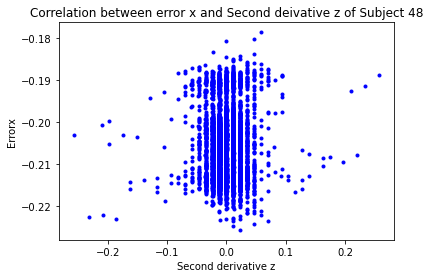

[[1.         0.01167277]
 [0.01167277 1.        ]]


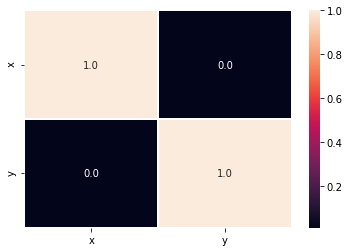

61.05
[ 0.00190906 -0.00064453  0.00046651 ... -0.00208508 -0.00208443
 -0.0020835 ]


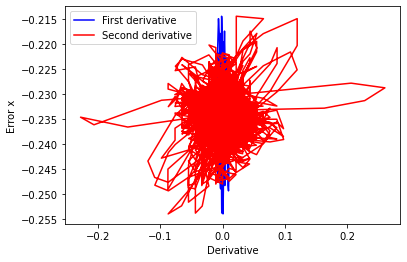

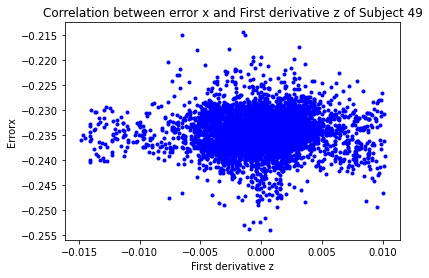

[[1.         0.01658867]
 [0.01658867 1.        ]]


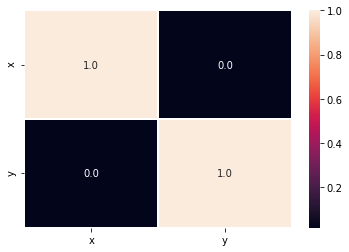

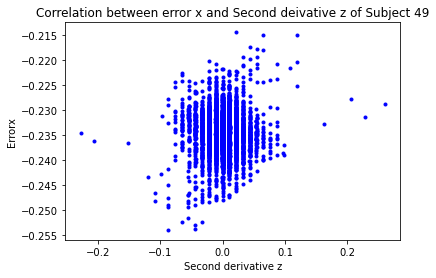

[[1.        0.0333668]
 [0.0333668 1.       ]]


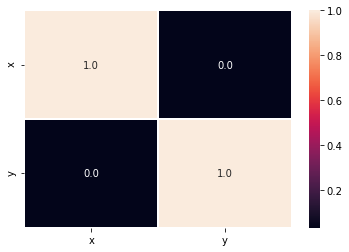

In [15]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    tanx=np.tan(angulox)
    tanz=np.tan(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    print(COPXmatrix)
    plt.figure()
    #plt.plot(t[30:],matrizangx,color='red')
    plt.plot(d1z,errorx,color='blue',label='First derivative')
    plt.plot(d2z,errorx,color='red',label='Second derivative')
    plt.xlabel("Derivative")
    plt.ylabel("Error x")
    plt.legend()
    plt.show()
    data={'x':d1z,
         'y': errorx
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("First derivative z")
    plt.ylabel("Errorx")
    plt.title("Correlation between error x and First derivative z of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(d1z,errorx)
    print(r)
    plt.figure()
    data={'x':d1z,
         'y': errorx
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    data={'x':d2z,
         'y': errorx
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Second derivative z")
    plt.ylabel("Errorx")
    plt.title("Correlation between error x and Second deivative z of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(d2z,errorx)
    print(r)
    plt.figure()
    data={'x':d2z,
         'y': errorx
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    

## Correlation between errorx and Jb

74.3
[-0.00062795 -0.00183479  0.00101439 ...  0.00066651  0.00066671
  0.00066699]


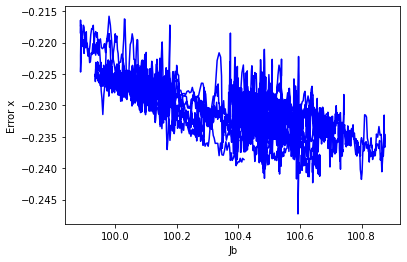

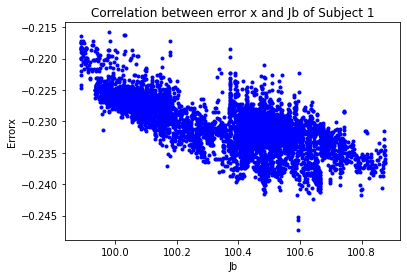

[[ 1.        -0.7286683]
 [-0.7286683  1.       ]]


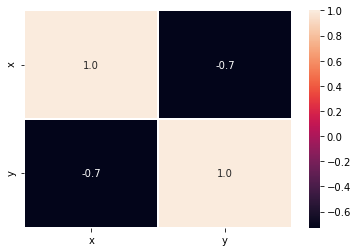

74.3
[ 0.00250586  0.00228543  0.00436475 ... -0.00020834 -0.00020832
 -0.00020829]


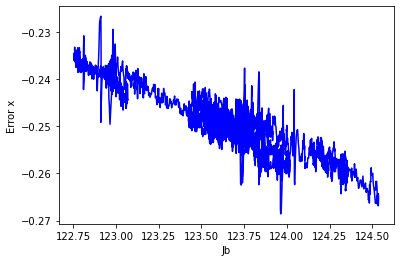

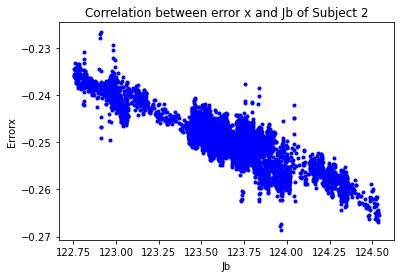

[[ 1.         -0.89252312]
 [-0.89252312  1.        ]]


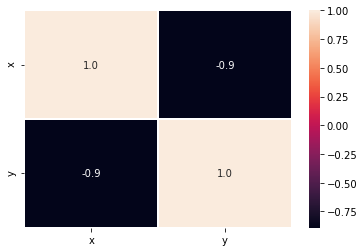

74.3
[-0.00114536  0.00023421 -0.00022916 ... -0.00162697 -0.00162677
 -0.00162653]


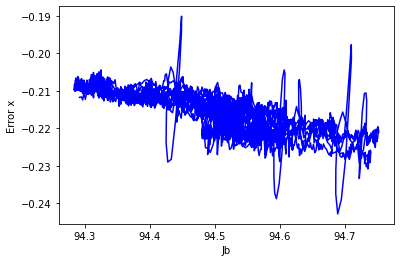

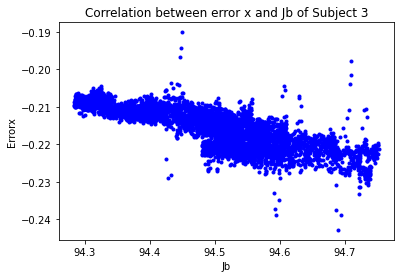

[[ 1.         -0.79728281]
 [-0.79728281  1.        ]]


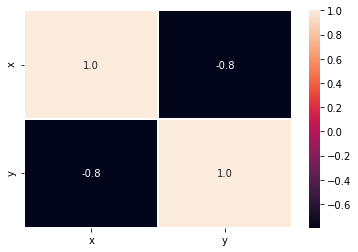

74.3
[ 0.00053299 -0.0008076  -0.00013609 ... -0.00062584 -0.00062579
 -0.00062574]


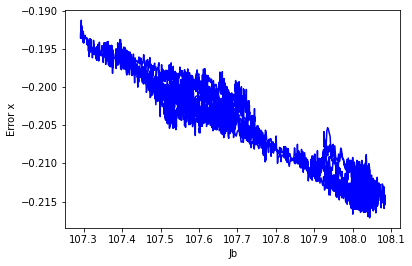

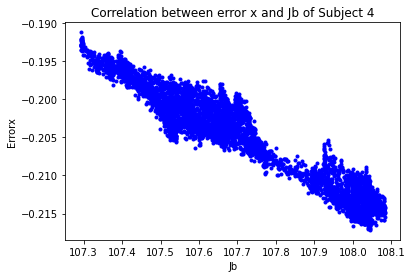

[[ 1.         -0.95472933]
 [-0.95472933  1.        ]]


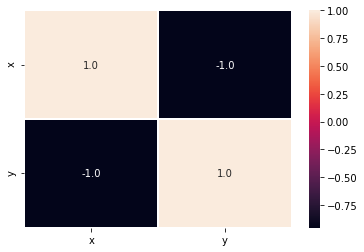

74.3
[-8.41091400e-04  1.24201421e-03  3.49235426e-03 ...  2.52872664e-06
  2.52844447e-06  2.52807104e-06]


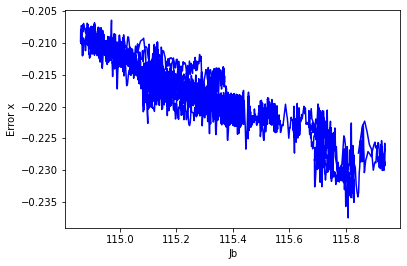

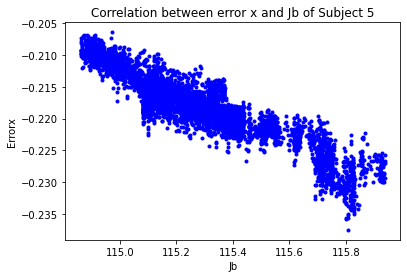

[[ 1.        -0.9265752]
 [-0.9265752  1.       ]]


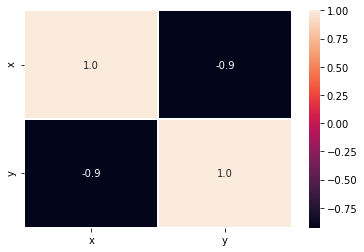

74.3
[ 0.00020194  0.00162995  0.00040663 ... -0.00056806 -0.00056801
 -0.00056795]


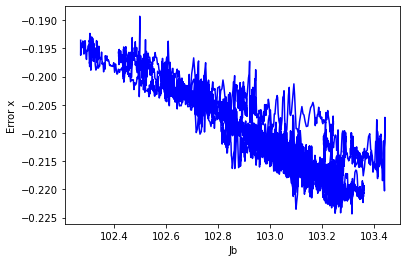

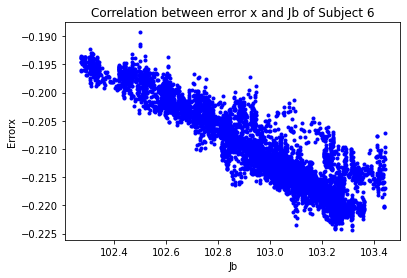

[[ 1.         -0.91797157]
 [-0.91797157  1.        ]]


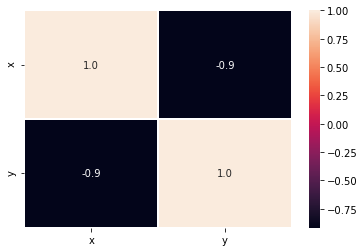

74.3
[ 0.00042813  0.002284    0.00165237 ... -0.00125035 -0.00125038
 -0.00125042]


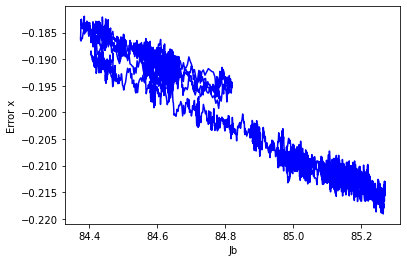

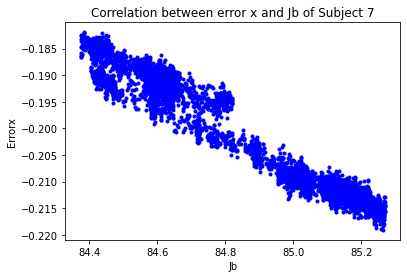

[[ 1.         -0.97467185]
 [-0.97467185  1.        ]]


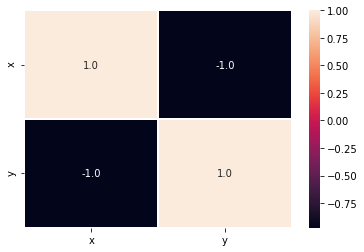

74.3
[ 2.85924872e-04  2.20309765e-07 -1.40623847e-04 ...  6.79396742e-04
  6.79389463e-04  6.79374813e-04]


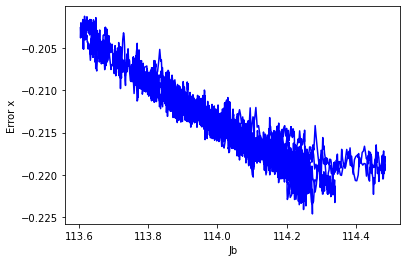

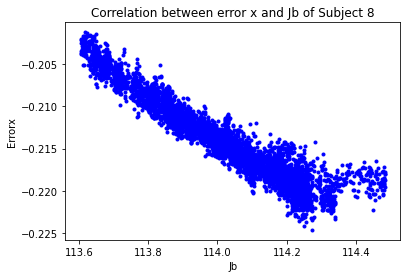

[[ 1.         -0.95388563]
 [-0.95388563  1.        ]]


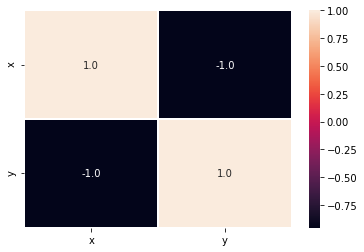

74.3
[-9.94463860e-04 -8.05185257e-04  8.43084681e-07 ...  8.34291748e-04
  8.34275595e-04  8.34246105e-04]


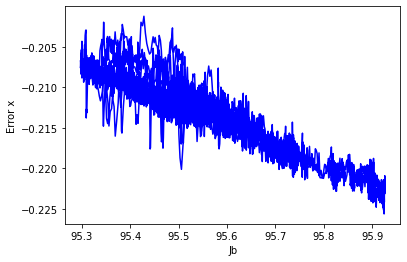

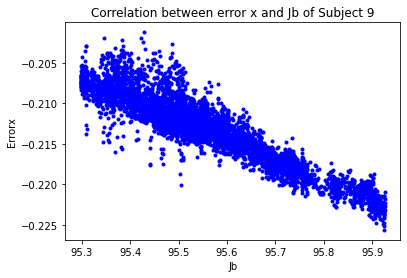

[[ 1.         -0.92442104]
 [-0.92442104  1.        ]]


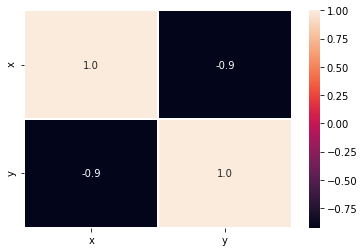

74.3
[-4.86232280e-06  7.03859861e-04  6.96670113e-04 ... -2.48830933e-04
 -2.48851854e-04 -2.48881818e-04]


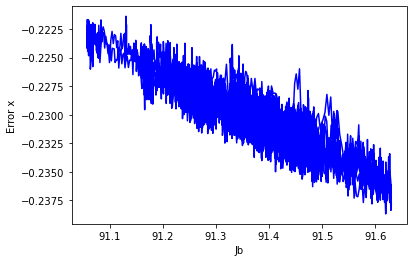

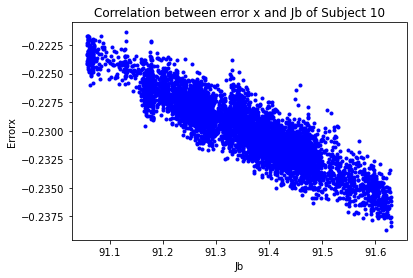

[[ 1.         -0.89863493]
 [-0.89863493  1.        ]]


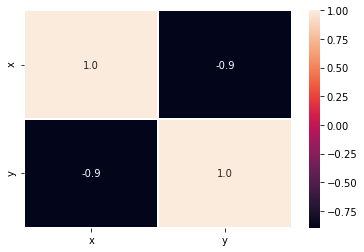

74.3
[ 0.00043958  0.00587328  0.00570288 ... -0.00068528 -0.00068542
 -0.00068562]


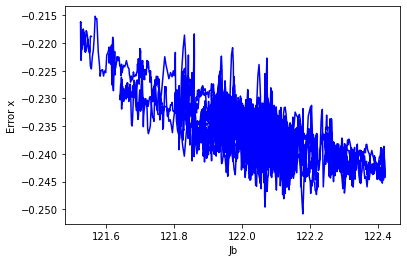

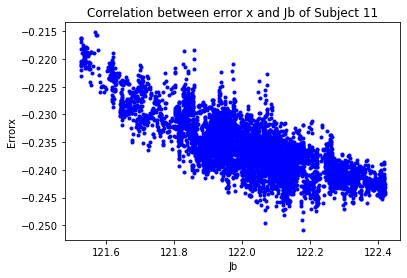

[[ 1.         -0.77551503]
 [-0.77551503  1.        ]]


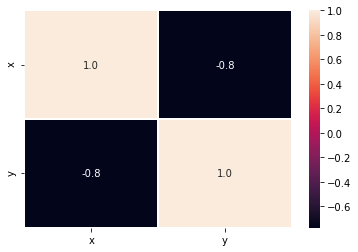

126.3
[-1.57732491e-06  9.04061315e-04  1.13748604e-03 ... -2.04883131e-04
 -2.04841728e-04 -2.04784523e-04]


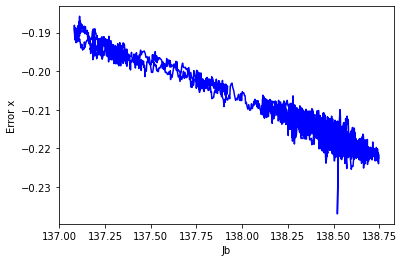

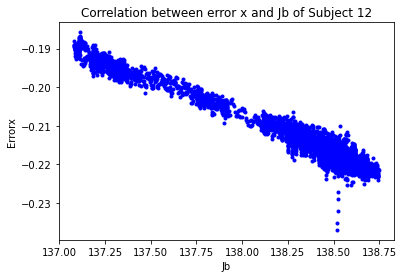

[[ 1.         -0.98108859]
 [-0.98108859  1.        ]]


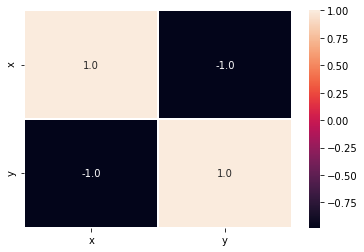

126.3
[ 9.31819792e-07 -1.18878976e-03  6.22089316e-04 ...  9.90683862e-04
  9.90626557e-04  9.90535387e-04]


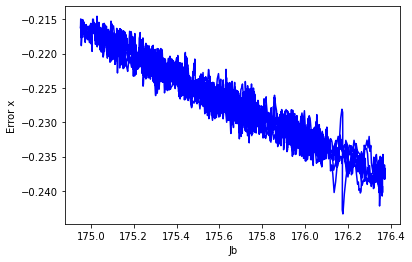

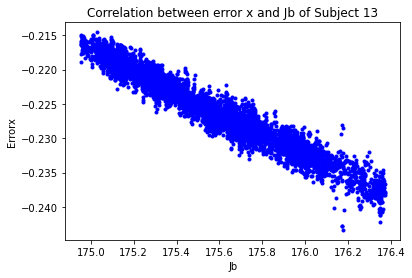

[[ 1.        -0.9704924]
 [-0.9704924  1.       ]]


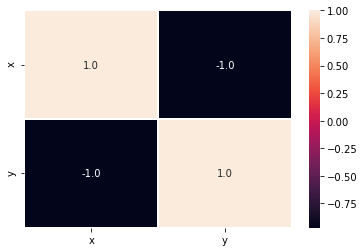

126.3
[0.00200588 0.00143426 0.00162029 ... 0.00074051 0.00074047 0.00074042]


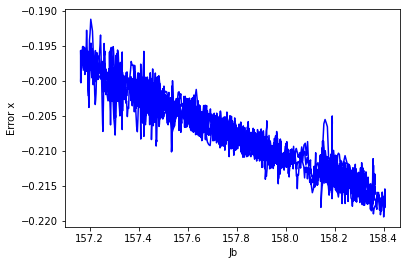

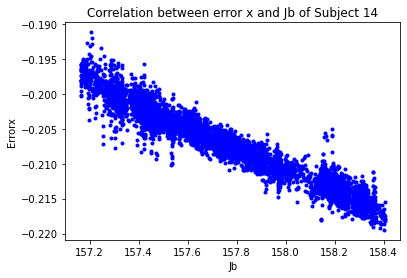

[[ 1.         -0.96183689]
 [-0.96183689  1.        ]]


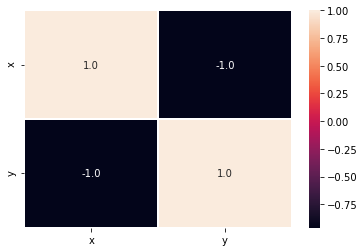

126.3
[-2.26522963e-04 -1.65036030e-04  2.25142887e-03 ...  2.77190723e-08
  2.77198876e-08  2.77208353e-08]


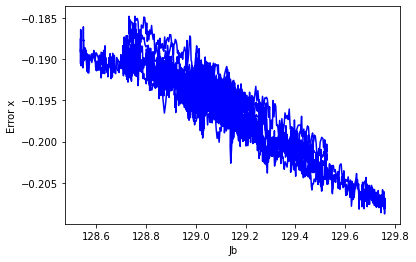

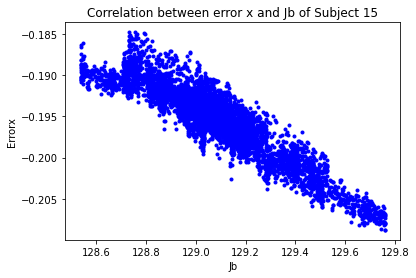

[[ 1.         -0.91559972]
 [-0.91559972  1.        ]]


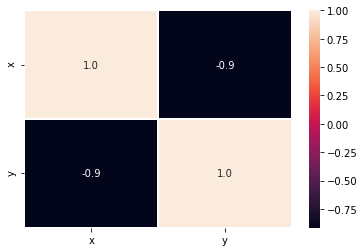

126.3
[-2.33845776e-04 -2.32789918e-04 -2.33842259e-04 ...  4.03384392e-06
  4.03347395e-06  4.03296088e-06]


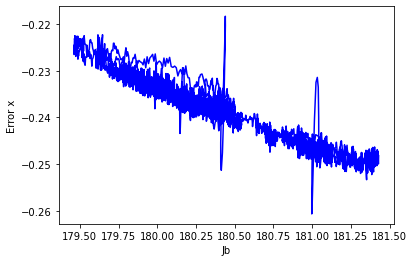

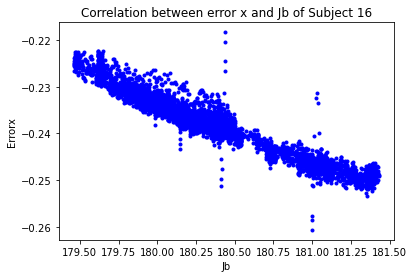

[[ 1.         -0.95893654]
 [-0.95893654  1.        ]]


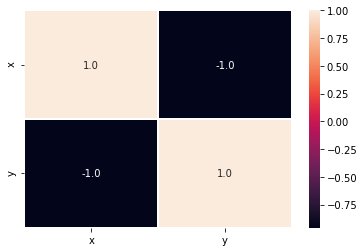

126.3
[ 3.38936963e-06  1.51466815e-04 -6.95949657e-04 ... -4.86398730e-04
 -4.86534091e-04 -4.86716271e-04]


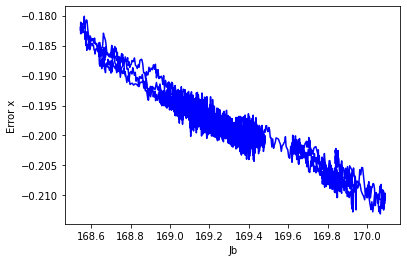

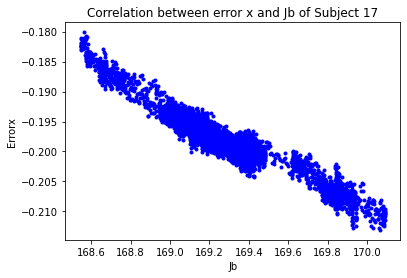

[[ 1.         -0.95614852]
 [-0.95614852  1.        ]]


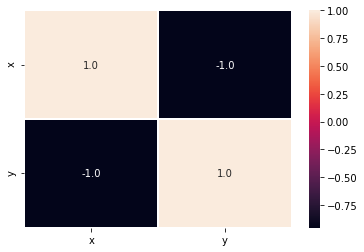

126.3
[ 0.00111058  0.00088068  0.00112563 ... -0.00086259 -0.00086261
 -0.00086264]


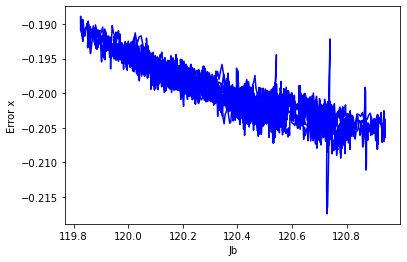

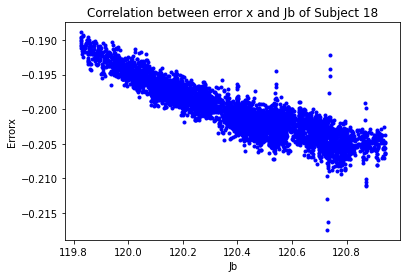

[[ 1.         -0.90769824]
 [-0.90769824  1.        ]]


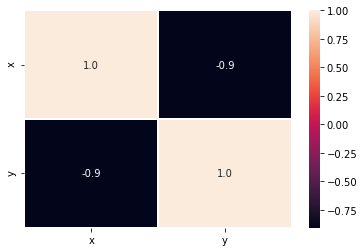

126.3
[ 0.00251436  0.00224008  0.00421654 ... -0.00039767 -0.00039775
 -0.00039786]


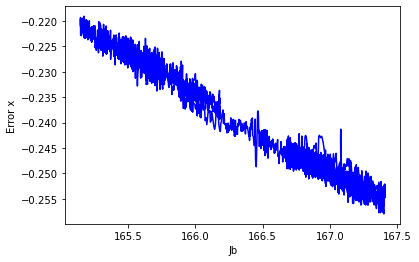

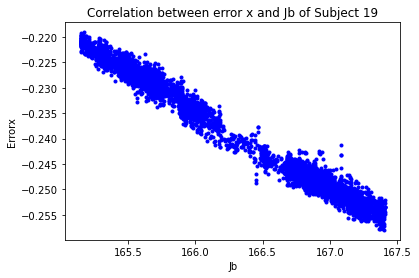

[[ 1.         -0.99159432]
 [-0.99159432  1.        ]]


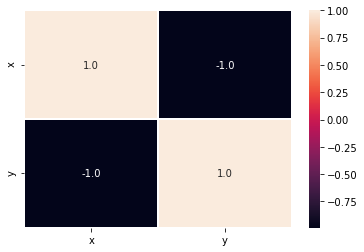

126.3
[-0.00114876 -0.00068501 -0.00022313 ...  0.00021031  0.0002103
  0.00021028]


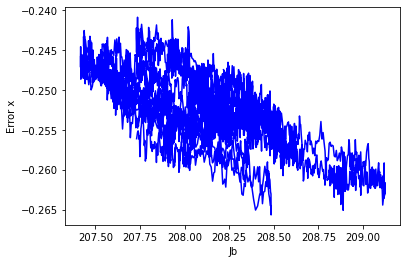

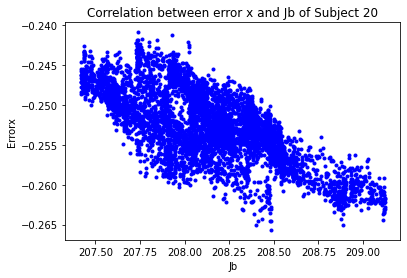

[[ 1.         -0.70881182]
 [-0.70881182  1.        ]]


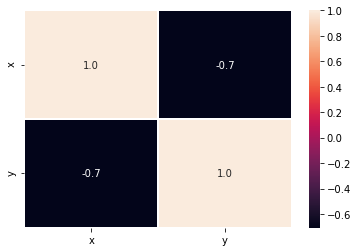

126.3
[ 0.00015677  0.00087944  0.00144457 ... -0.0002993  -0.00029929
 -0.00029928]


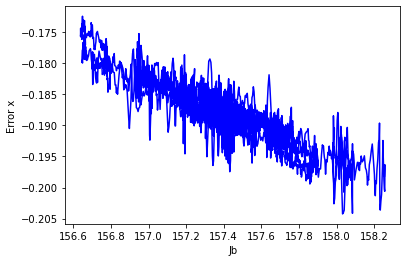

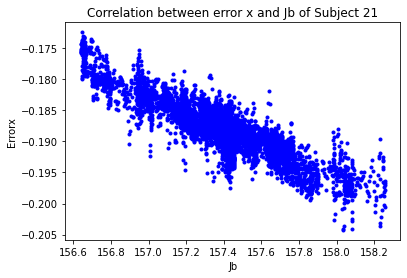

[[ 1.         -0.88956786]
 [-0.88956786  1.        ]]


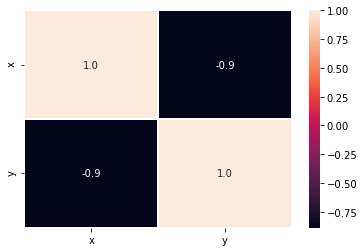

126.3
[ 2.02365423e-03  8.97753611e-04  2.02382804e-03 ... -2.98725578e-06
 -2.98778049e-06 -2.98870067e-06]


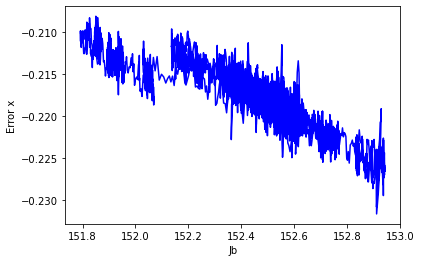

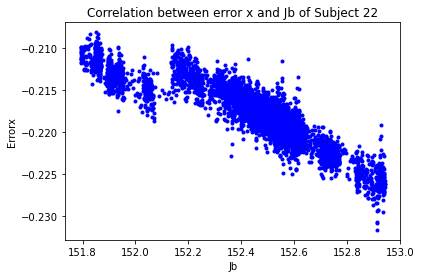

[[ 1.         -0.88260428]
 [-0.88260428  1.        ]]


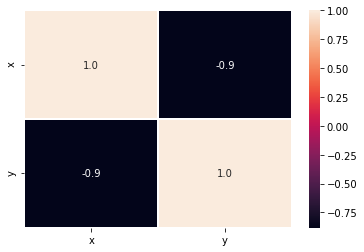

126.3
[-0.00142235 -0.00099119 -0.00142234 ...  0.00078366  0.00078364
  0.0007836 ]


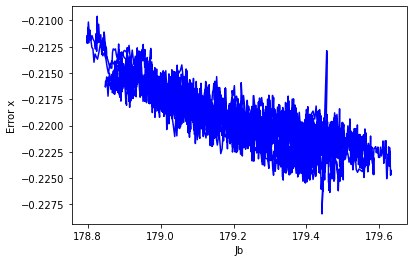

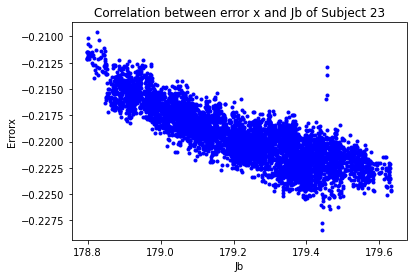

[[ 1.         -0.83644311]
 [-0.83644311  1.        ]]


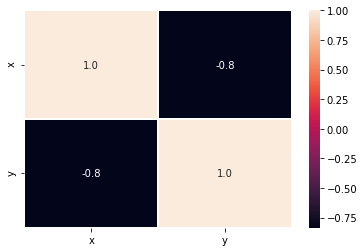

52.9
[0.00037378 0.00178077 0.00196912 ... 0.00041847 0.00041832 0.00041811]


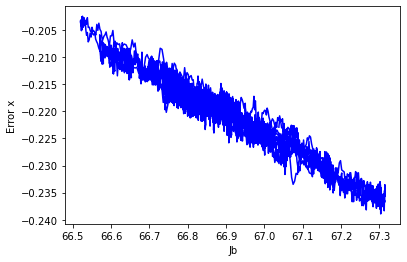

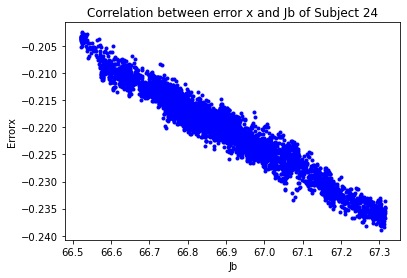

[[ 1.        -0.9736573]
 [-0.9736573  1.       ]]


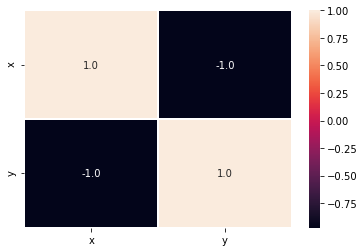

52.9
[2.20048971e-03 3.16095813e-03 2.90296228e-03 ... 2.76927244e-08
 2.76928517e-08 2.76930553e-08]


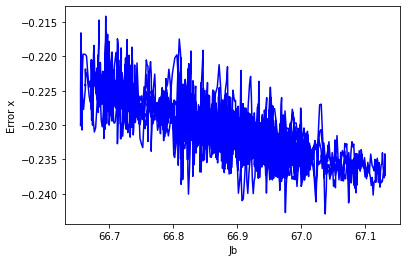

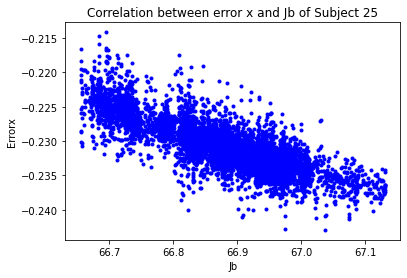

[[ 1.         -0.81341494]
 [-0.81341494  1.        ]]


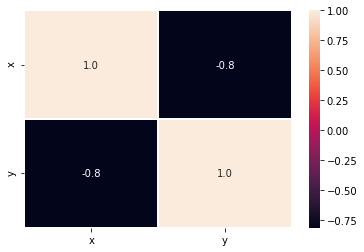

52.9
[0.00262089 0.00111268 0.00370495 ... 0.00123841 0.00123839 0.00123836]


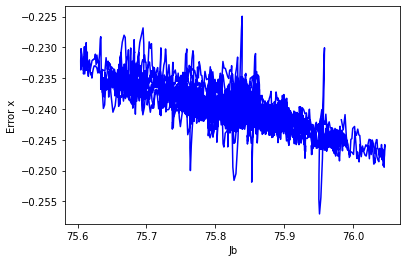

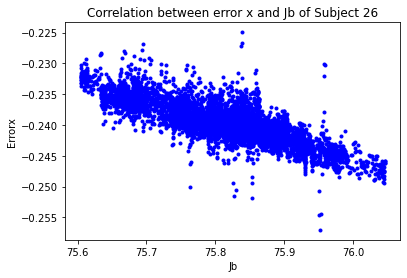

[[ 1.         -0.79779866]
 [-0.79779866  1.        ]]


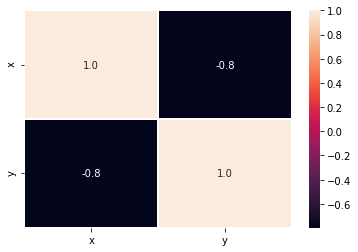

52.9
[ 0.00103392 -0.00028314  0.00205582 ...  0.00023084  0.00023085
  0.00023087]


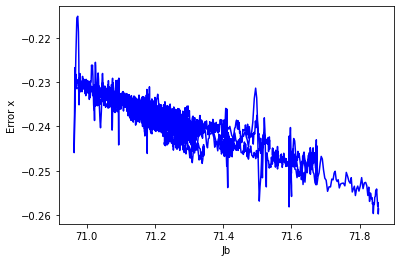

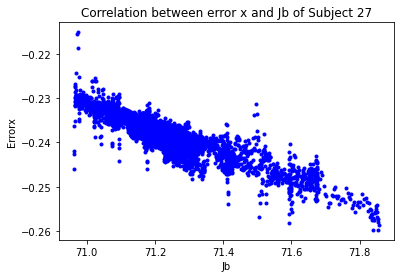

[[ 1.         -0.89486272]
 [-0.89486272  1.        ]]


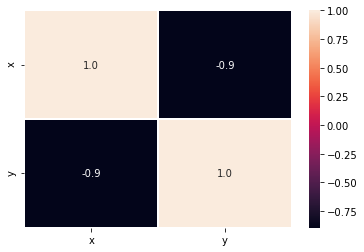

52.9
[-0.00130157 -0.00130383 -0.00161987 ...  0.00070539  0.00070535
  0.00070529]


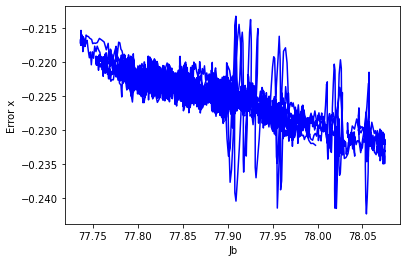

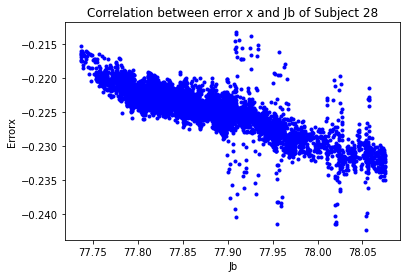

[[ 1.         -0.84525853]
 [-0.84525853  1.        ]]


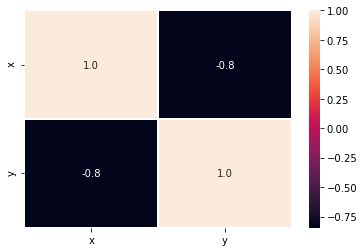

52.9
[ 0.00080459  0.00080411  0.00080364 ... -0.00152081 -0.00152133
 -0.00152207]


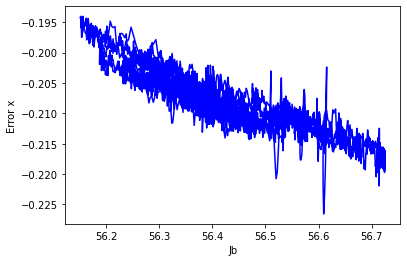

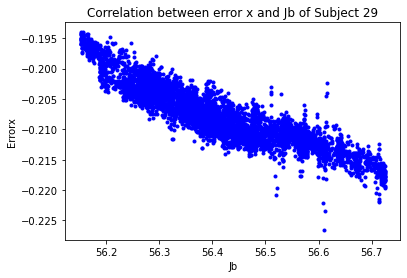

[[ 1.         -0.90319983]
 [-0.90319983  1.        ]]


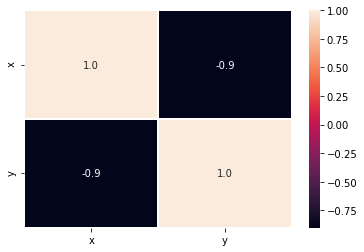

52.9
[ 1.33152377e-03 -3.17222877e-07  1.63082518e-03 ...  9.81761181e-04
  9.81690504e-04  9.81578524e-04]


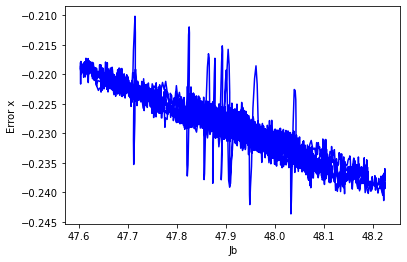

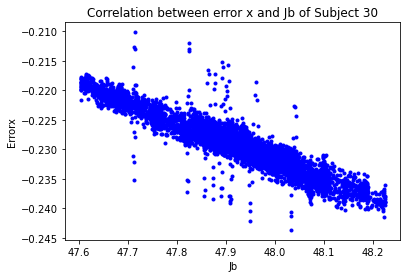

[[ 1.         -0.93645775]
 [-0.93645775  1.        ]]


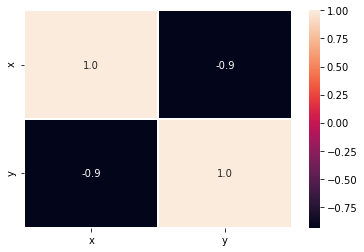

52.9
[-0.00460512 -0.00441523 -0.00380602 ...  0.00139619  0.00139644
  0.00139676]


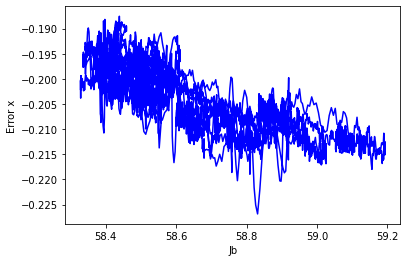

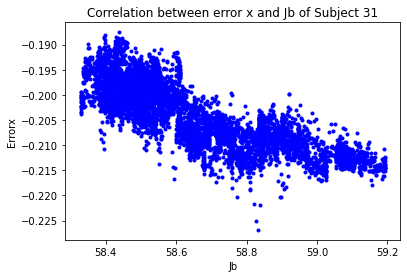

[[ 1.         -0.80169332]
 [-0.80169332  1.        ]]


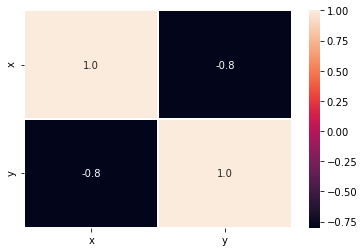

52.9
[ 0.00096849 -0.00023811 -0.00066757 ... -0.00183837 -0.00183851
 -0.00183874]


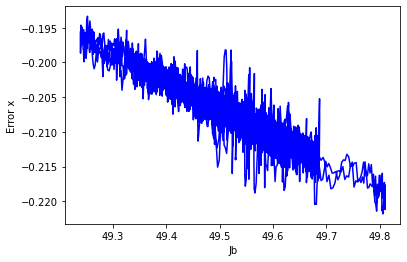

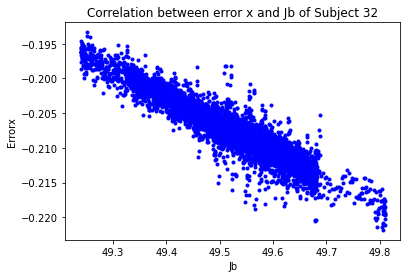

[[ 1.         -0.93746789]
 [-0.93746789  1.        ]]


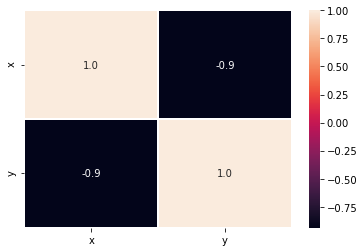

52.9
[-0.00069392  0.00068588 -0.00046576 ... -0.00020688 -0.00020688
 -0.00020687]


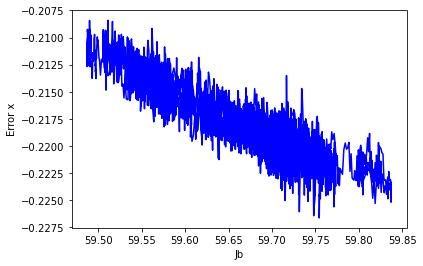

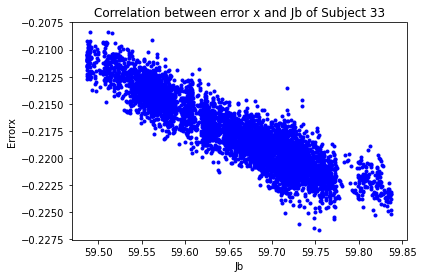

[[ 1.         -0.91579004]
 [-0.91579004  1.        ]]


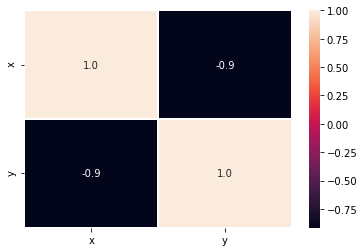

52.9
[-0.01178569 -0.01096075 -0.00434326 ...  0.00168401  0.00168443
  0.001685  ]


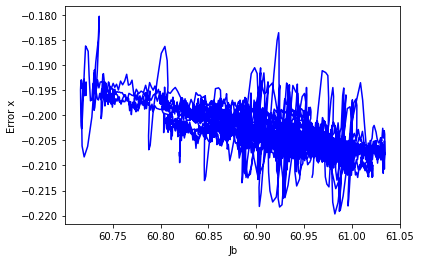

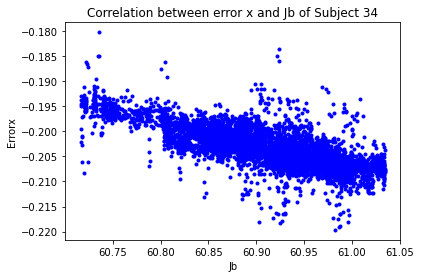

[[ 1.         -0.74592072]
 [-0.74592072  1.        ]]


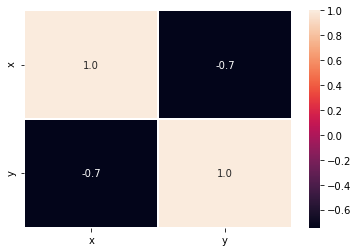

52.9
[ 3.29540281e-04  1.38905677e-07  2.55830973e-03 ... -4.53703589e-06
 -4.53710854e-06 -4.53723315e-06]


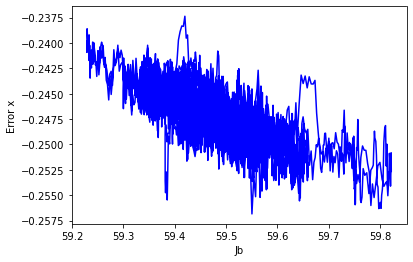

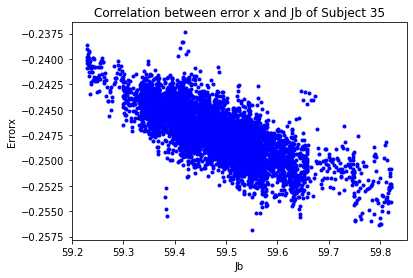

[[ 1.         -0.75330929]
 [-0.75330929  1.        ]]


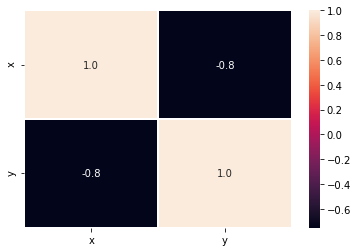

75.85
[-0.00759797 -0.00330673  0.00386649 ...  0.00191159  0.0019116
  0.00191159]


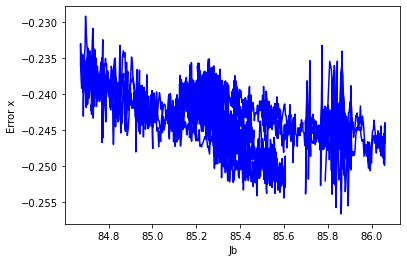

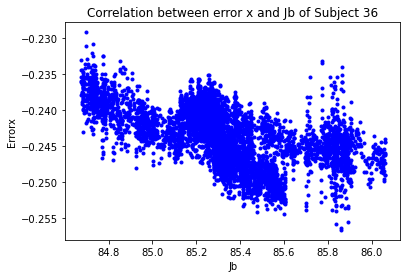

[[ 1.         -0.57538612]
 [-0.57538612  1.        ]]


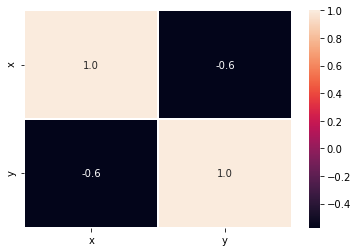

75.85
[ 0.00114163  0.004138    0.00206866 ... -0.00156783 -0.00156747
 -0.00156698]


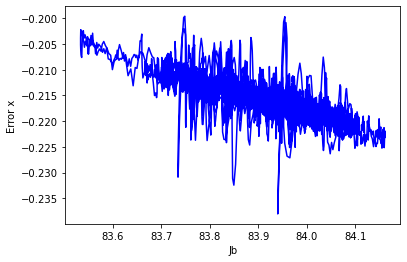

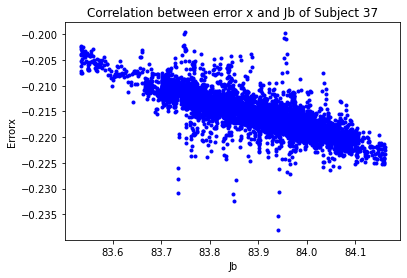

[[ 1.         -0.80131227]
 [-0.80131227  1.        ]]


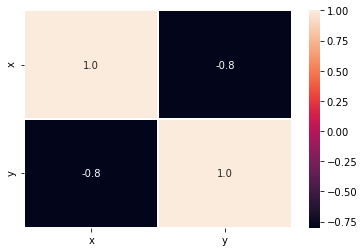

75.85
[-0.00098419 -0.00098931 -0.00125243 ...  0.00238367  0.0023837
  0.0023837 ]


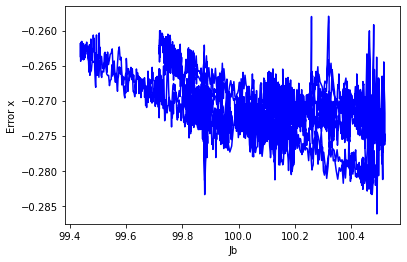

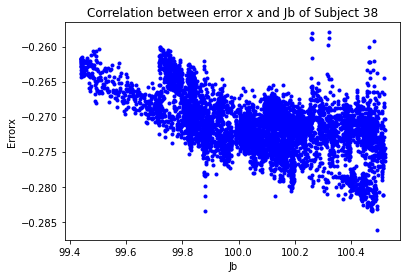

[[ 1.         -0.55182227]
 [-0.55182227  1.        ]]


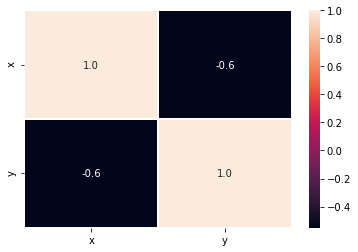

75.85
[-0.00160655 -0.00056865 -0.00018943 ...  0.0008693   0.00086929
  0.00086927]


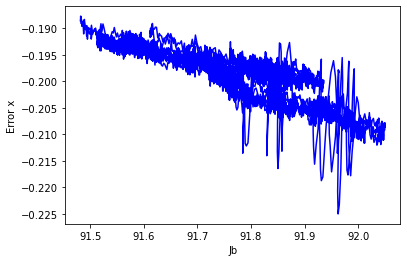

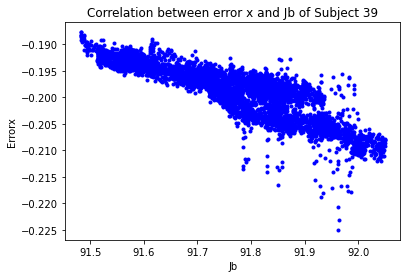

[[ 1.         -0.86133091]
 [-0.86133091  1.        ]]


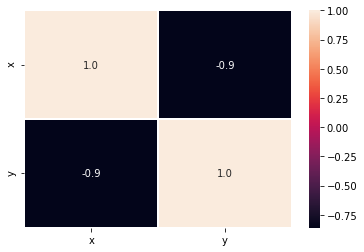

75.85
[ 1.32064406e-06  7.70183879e-04  9.47374020e-04 ... -1.73715057e-04
 -1.73725011e-04 -1.73739318e-04]


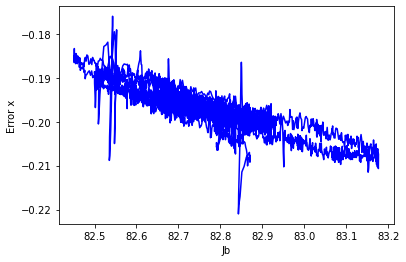

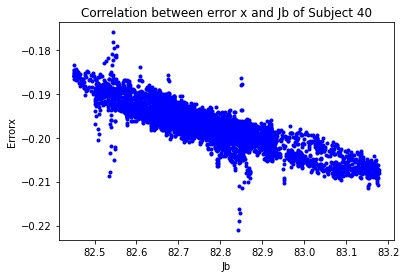

[[ 1.         -0.87952887]
 [-0.87952887  1.        ]]


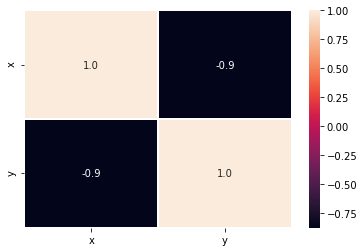

75.85
[ 8.91113432e-06 -2.22366067e-03  9.17484196e-06 ... -1.19976798e-03
 -1.19981300e-03 -1.19989033e-03]


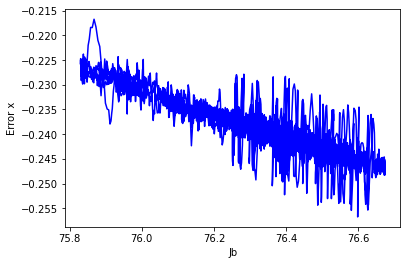

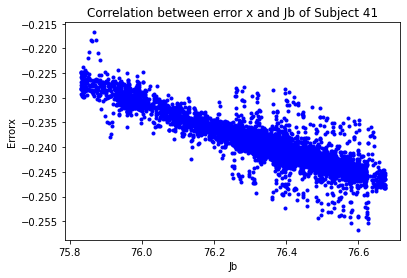

[[ 1.         -0.90181313]
 [-0.90181313  1.        ]]


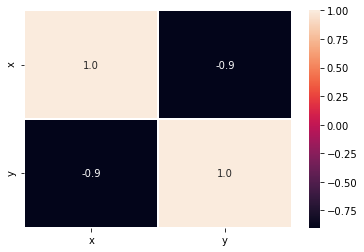

75.85
[-0.00096911  0.00052354 -0.00071761 ... -0.00090305 -0.00090313
 -0.00090324]


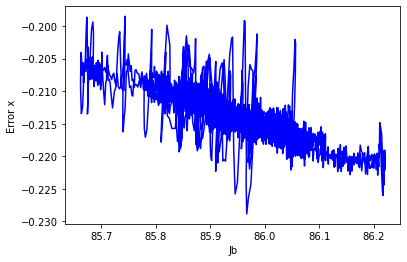

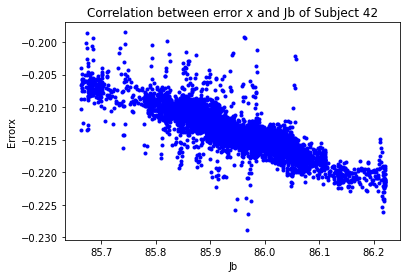

[[ 1.        -0.8465023]
 [-0.8465023  1.       ]]


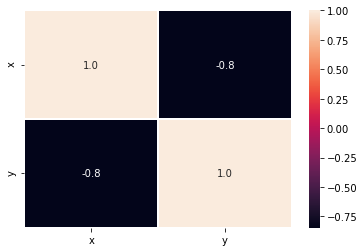

75.85
[-2.89992441e-04  7.13955756e-04  5.71243687e-04 ... -2.73884065e-06
 -2.73848917e-06 -2.73799807e-06]


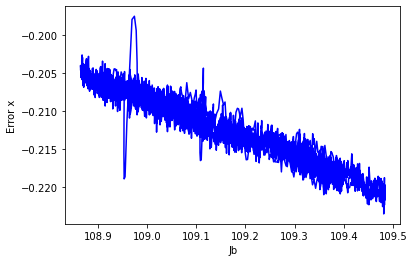

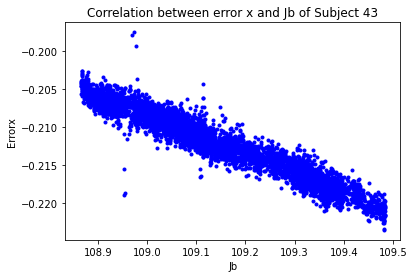

[[ 1.         -0.96314797]
 [-0.96314797  1.        ]]


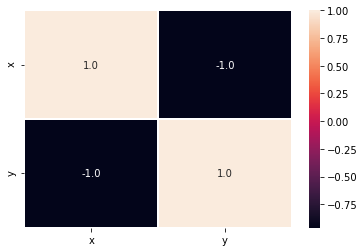

75.85
[ 0.00015061 -0.00055425 -0.00055553 ...  0.0005984   0.00059822
  0.00059797]


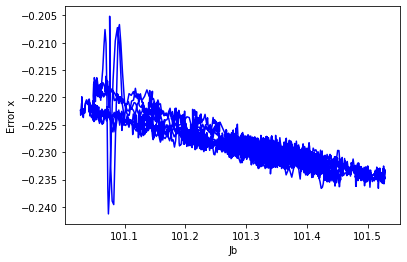

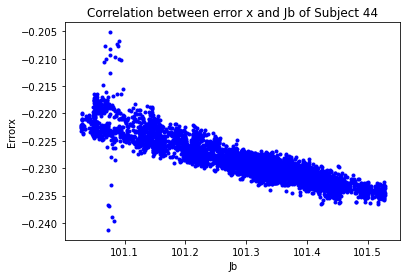

[[ 1.        -0.8900022]
 [-0.8900022  1.       ]]


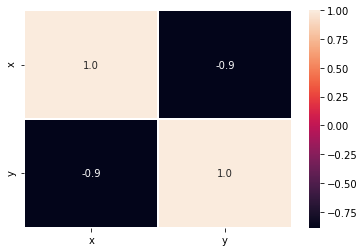

75.85
[-2.17702345e-02 -6.16317339e-03  3.05174706e-03 ...  9.05307372e-07
  9.05431200e-07  9.05572802e-07]


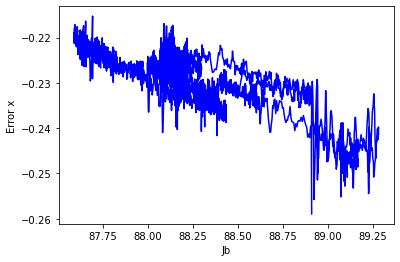

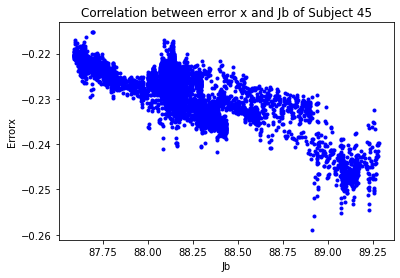

[[ 1.         -0.84590389]
 [-0.84590389  1.        ]]


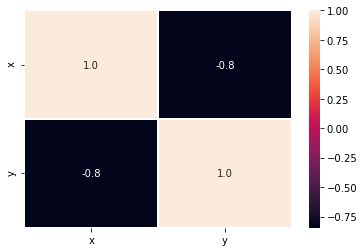

75.85
[-0.00172322 -0.00077161 -0.00137303 ...  0.00015119  0.00015117
  0.00015115]


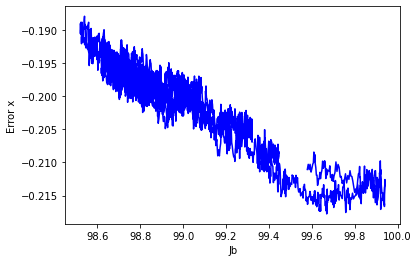

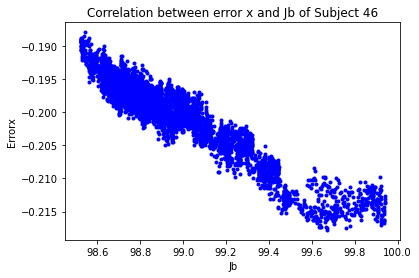

[[ 1.         -0.94282078]
 [-0.94282078  1.        ]]


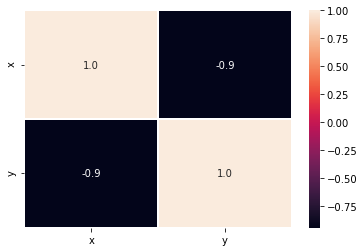

75.85
[ 3.78320705e-06 -2.25276870e-04  6.59448210e-04 ... -1.02632765e-03
 -1.02651370e-03 -1.02678752e-03]


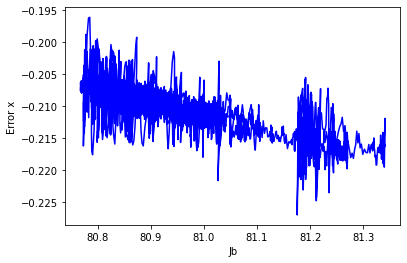

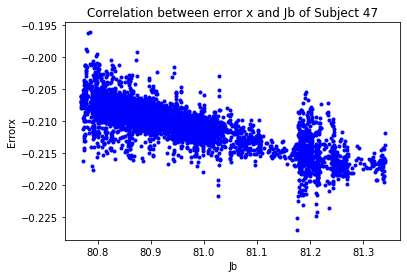

[[ 1.         -0.79372947]
 [-0.79372947  1.        ]]


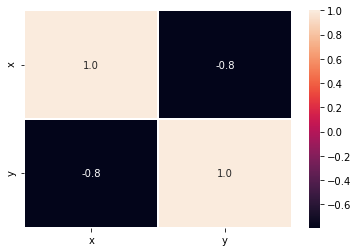

61.05
[-0.0024744  -0.0006725  -0.00294638 ... -0.00236074 -0.0023621
 -0.00236406]


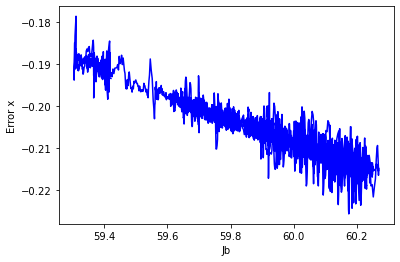

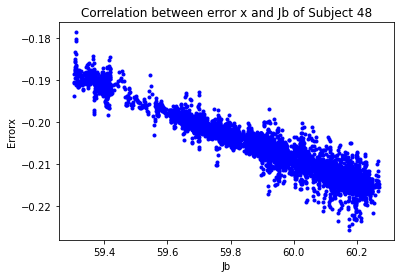

[[ 1.         -0.96108068]
 [-0.96108068  1.        ]]


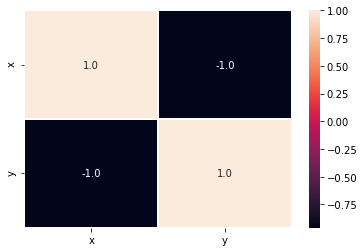

61.05
[ 0.00190906 -0.00064453  0.00046651 ... -0.00208508 -0.00208443
 -0.0020835 ]


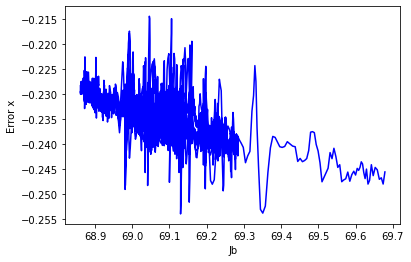

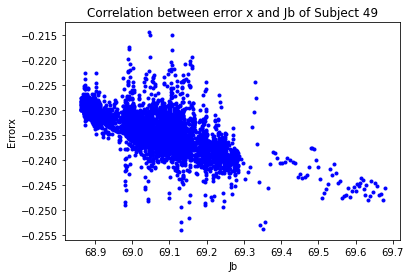

[[ 1.         -0.63214957]
 [-0.63214957  1.        ]]


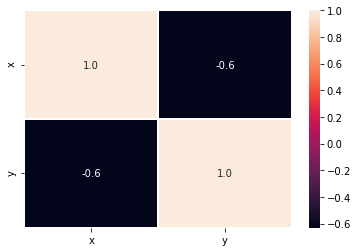

In [16]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    tanx=np.tan(angulox)
    tanz=np.tan(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    print(COPXmatrix)
    plt.figure()
    #plt.plot(t[30:],matrizangx,color='red')
    plt.plot(Jb,errorx,color='blue')
    plt.xlabel("Jb")
    plt.ylabel("Error x")
    plt.show()
    data={'x':Jb,
         'y': errorx
         }
    df=pd.DataFrame(data)
    #ax=sns.lmplot(x=matrizangx, y=errorx, data= df)
    #ax
    plt.plot('x','y','bo',data= df, marker='.')
    plt.xlabel("Jb")
    plt.ylabel("Errorx")
    plt.title("Correlation between error x and Jb of Subject {}".format(s))
    plt.show()
    r=np.corrcoef(Jb,errorx)
    print(r)
    plt.figure()
    data={'x':Jb,
         'y': errorx
         }
    df=pd.DataFrame(data)
    correlation=df.corr()
    plot=sns.heatmap(correlation,annot= True, fmt='.1f',linewidths=.6)
    plt.show()
    

## Histogram

74.3


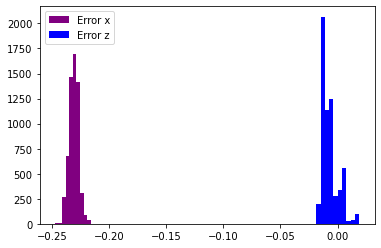

74.3


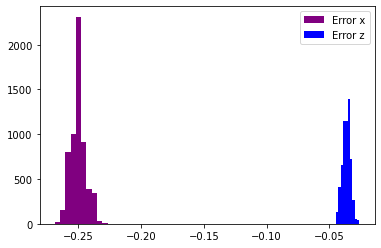

74.3


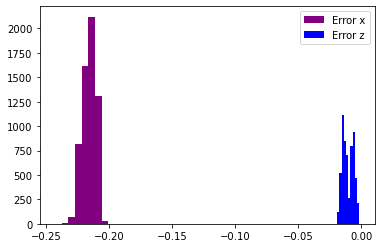

74.3


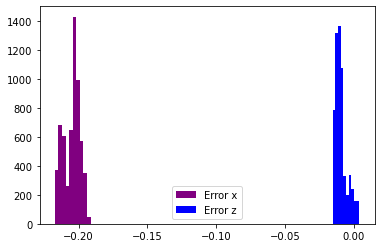

74.3


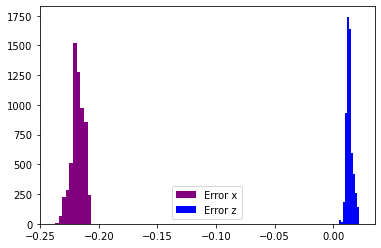

74.3


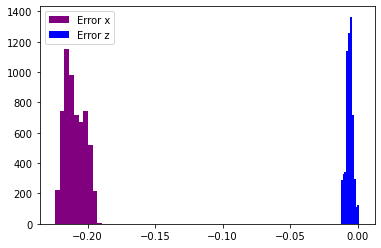

74.3


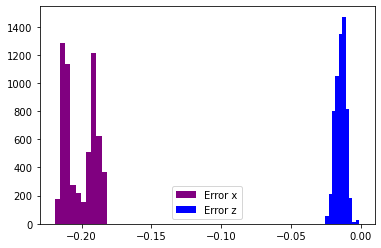

74.3


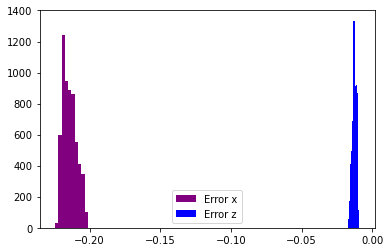

74.3


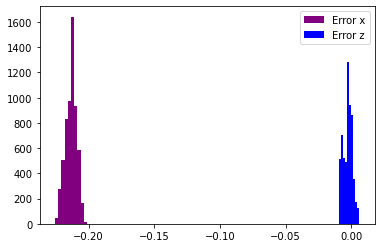

74.3


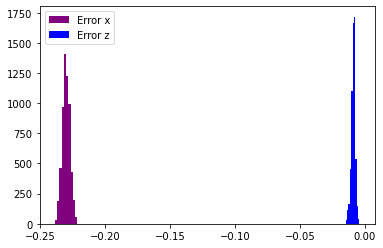

74.3


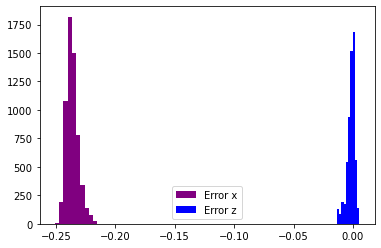

126.3


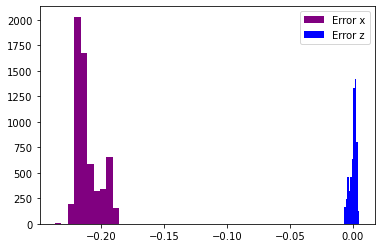

126.3


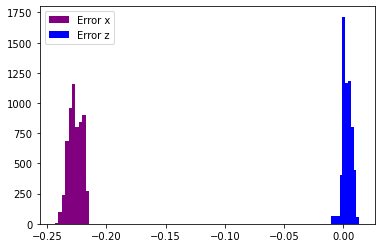

126.3


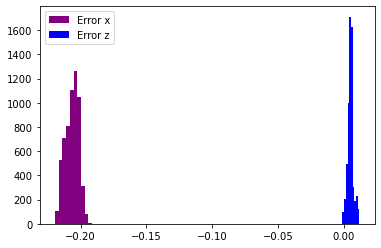

126.3


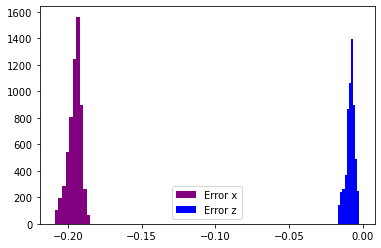

126.3


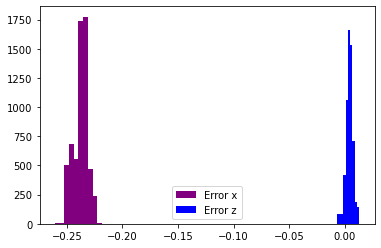

126.3


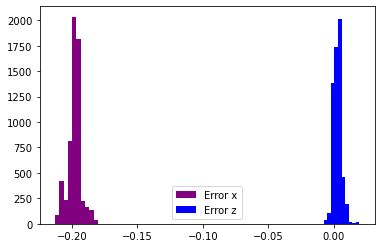

126.3


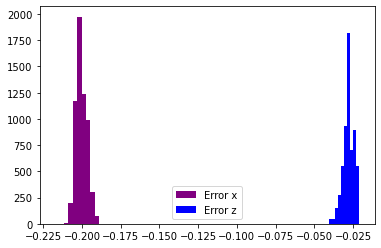

126.3


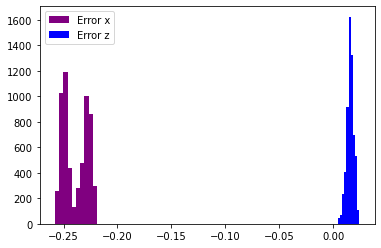

126.3


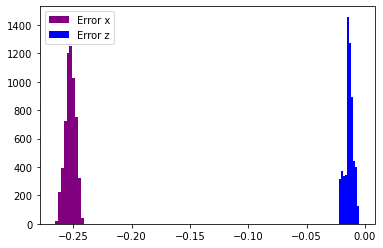

126.3


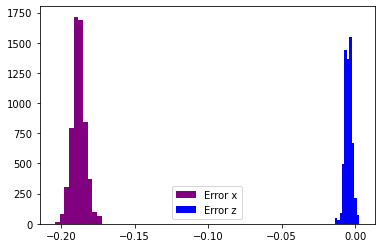

126.3


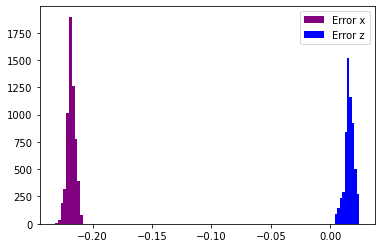

126.3


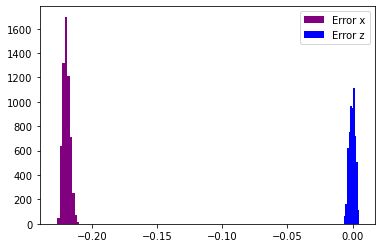

52.9


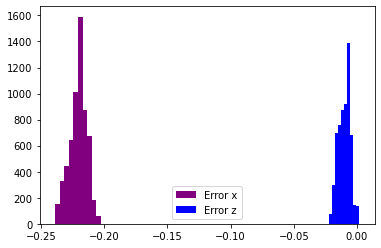

52.9


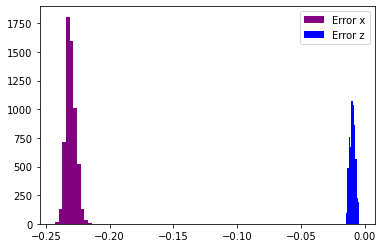

52.9


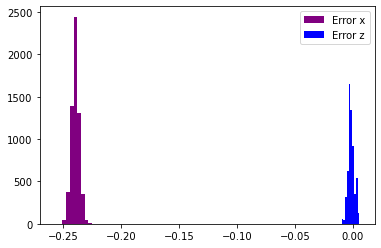

52.9


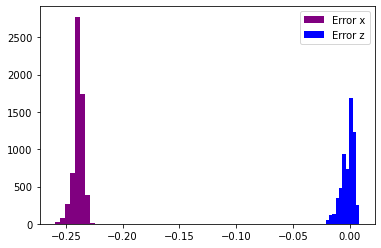

52.9


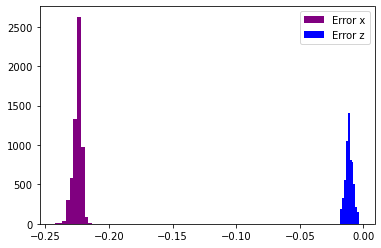

52.9


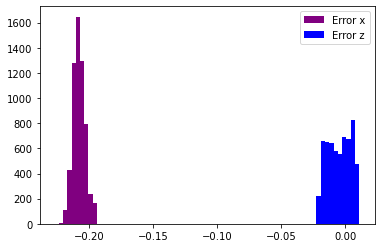

52.9


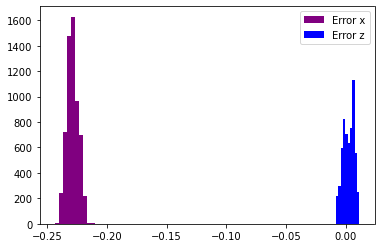

52.9


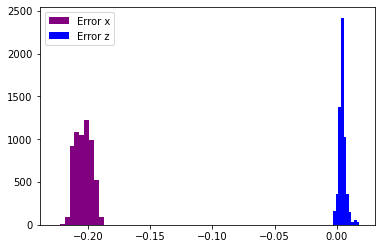

52.9


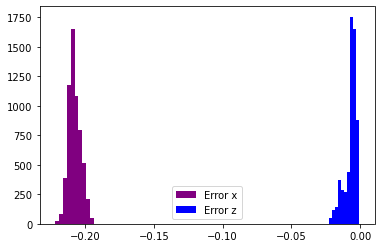

52.9


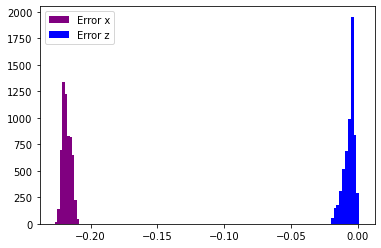

52.9


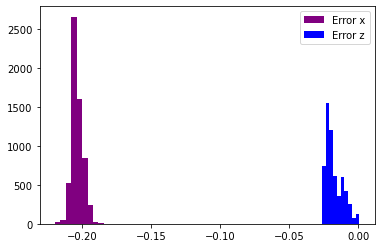

52.9


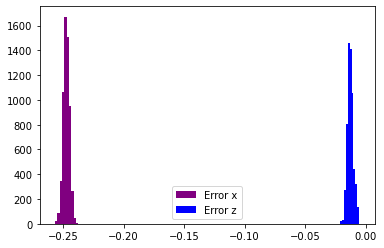

75.85


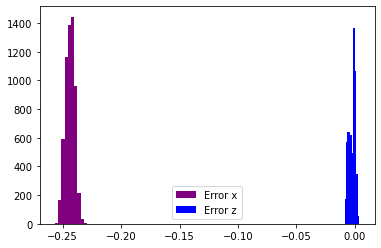

75.85


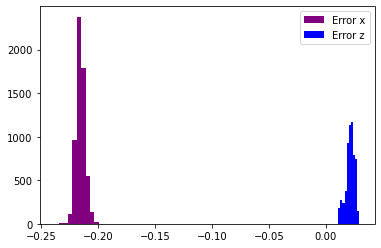

75.85


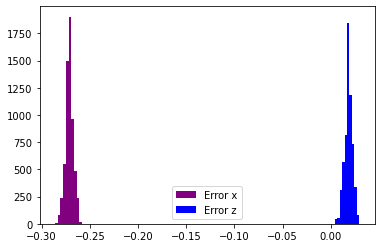

75.85


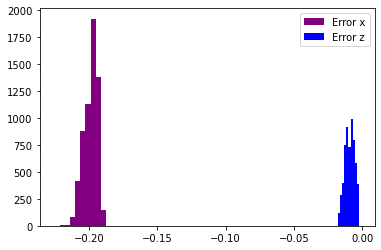

75.85


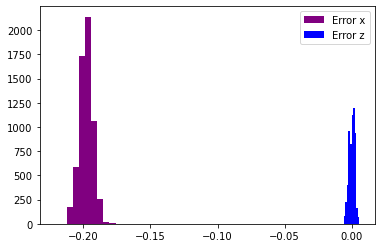

75.85


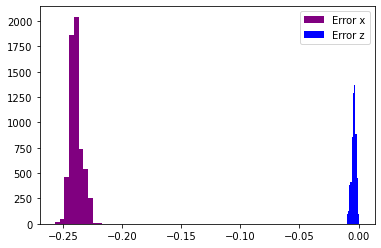

75.85


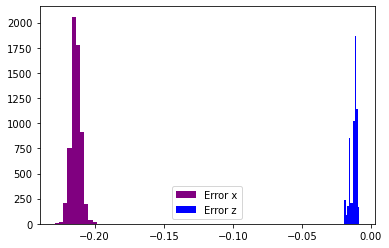

75.85


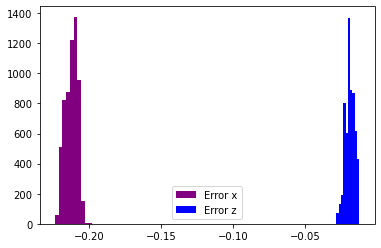

75.85


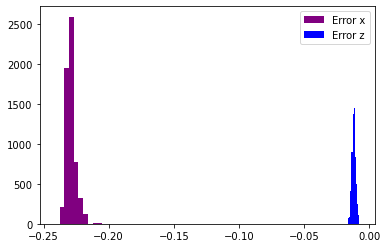

75.85


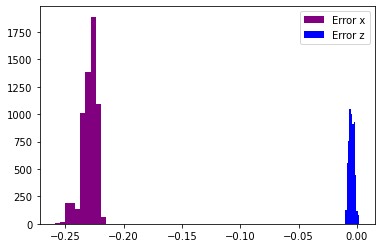

75.85


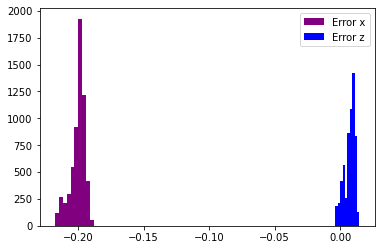

75.85


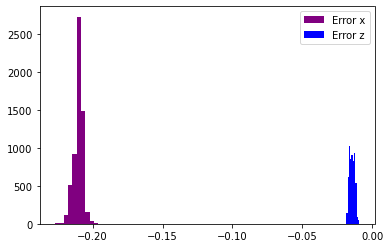

61.05


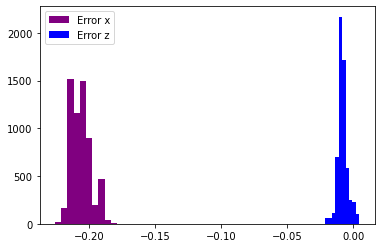

61.05


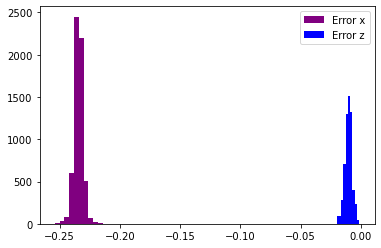

In [17]:
import pandas as pd 
import seaborn as sns
for s in range (1,50):
    a=PDSinfo[PDSinfo['Subject']==s].index.tolist()[2]
    fname_grf = os.path.join(path2, PDSinfo.Trial[a] + 'grf' + '.txt') 
    fname_mkr = os.path.join(path2, PDSinfo.Trial[a] + 'mkr' + '.txt')
    grf = pd.read_csv(fname_grf, delimiter='\t', header=0, engine='c')
    mkr = pd.read_csv(fname_mkr, delimiter='\t', header=0, engine='c')
    COGX=mkr['COG_X']
    COGY=mkr['COG_Y']
    COGZ=mkr['COG_Z']
    mass=PDSinfo['Mass']
    d=(COGX**2+COGY**2+COGZ**2)**0.5
    angulox = np.arcsin(COGX/d)
    anguloz= np.arcsin(COGZ/d)
    sinx=np.sin(angulox)
    sinz=np.sin(anguloz)
    cosx=np.sin(angulox)
    cosz=np.sin(anguloz)
    tanx=np.tan(angulox)
    tanz=np.tan(anguloz)
    matrizangx=np.array(angulox[30:])
    matrizangz=np.array(anguloz[30:])
    Jb=(4/3)*(mass[s])*((d[30:])**2)
    t=grf['Time']
    dt=t[1]-t[0]
    d1x=np.zeros(len(matrizangx))
    d1z=np.zeros(len(matrizangz))
    for i in range(0, len(matrizangx)-1):
        next=i+1
        d1x[i]=(matrizangx[next]-matrizangx[i])/dt
        d1z[i]=(matrizangz[next]-matrizangz[i])/dt
    d1x[-1]=d1x[-2]
    d1z[-1]=d1z[-2]
    d2x=np.zeros(len(d1x))
    d2z=np.zeros(len(d1z))
    for i in range(0, len(d1x)-1):
        next=i+1
        d2x[i]=(d1x[next]-d1x[i])/dt
        d2z[i]=(d1z[next]-d1z[i])/dt
    d2x[-1]=d2x[-3]
    d2x[-2]=d2x[-3]
    d2z[-1]=d2z[-3]
    d2z[-2]=d2z[-3]
    COPX=((d[30:])*(sinx[30:])+Jb*(1/((mass[s])*9.8)))*((sinx[30:])*((d1x)**2)-(cosx[30:])*(d2x))
    COPZ=((d[30:])*(sinz[30:])+Jb*(1/((mass[s])*9.8)))*((sinz[30:])*((d1z)**2)-(cosz[30:])*(d2z))
    print(mass[s])
    COPXreal=grf['COPNET_X']
    COPZreal=grf['COPNET_Z']
    COPXmatrix=np.array(COPX)
    COPXrealmatrix=np.array(COPXreal[30:])
    COPZmatrix=np.array(COPZ)
    COPZrealmatrix=np.array(COPZreal[30:])
    errorx=np.subtract(COPXmatrix,COPXrealmatrix)
    errorz=np.subtract(COPZmatrix,COPZrealmatrix)
    plt.figure()
    histx=plt.hist(errorx,color='purple',label='Error x')
    histz=plt.hist(errorz,color='blue',label='Error z')
    plt.legend()
    plt.show()